<a href="https://colab.research.google.com/github/arpanbiswas52/iMFBO_Ising/blob/main/iBO_notebook_IsingModelv2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **non-interractive and interractive Multi-fidelity Bayesian optimization**
Jan, 2024

-- Notebook prepared by **Arpan Biswas**

-- Structured GP is developed by **Maxim Ziatdinov** in GPax Python library, expanded to multi-fidelity structred GP by **Arpan Biswas**

-- Here we want to learn the (unknown) functional form of heat capacity over 60x60 Ising model, given the (known) low fidelity cheaper and partially accurate functional form or data from 20x20 Ising model- A multifidleity apporach


In [1]:
!pip install -q git+https://github.com/ziatdinovmax/gpax.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 312.7/312.7 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 371.0/371.0 kB 12.0 MB/s eta 0:00:00


In [2]:
import gpax
import numpy as np
import matplotlib.pyplot as plt
from numpy.random import rand

from tqdm import tqdm

gpax.utils.enable_x64()  # enable double precision

from typing import Union, Dict, Callable

import math

import jax.numpy as jnp
from jax import jit
from gpax.kernels import RBFKernel, MaternKernel

import jax
import numpyro

import time


In [3]:
#@title square model
class IsingSim():

  """This class performs Ising model simulations on a 2D grid. Interaction parameters are given by a matrix at each lattice site.
  Field dependence is not supported at this time but will be in due course. The simulator outputs configurations after equlibrium
  as well as the trajectories, if specifically requested.
  Inputs:
    - N : (integer) - Size of lattice will be N^2. Only 2D square lattice is supported at this stage.
    - J_mat: (numpy matrix of shape(5,5)) - entries being floats for interaction parameters. Self-interaction (middle element of matrix)=0.
    - T: (float) - Reduced temperature for simulation
    - save_trajectories: (Boolean) - whether to save trajectories, or only final state. Default False.
    - eqSteps: (integer) number of Monte-Carlo steps for equlibration before simulation starts. Default 750. AKA 'burn-in'.
    - mcSteps: (integer) number of Monte-Carlo for simulation. Default 750.
  Outputs: Several outputs are available, including trajectories (if called), configurations (i.e., the 2D states) and configurations histograms.
  These can be obtained by calling methods self.configurations(), self.histograms() and self.trajectories()"""

  def __init__(self, N = 40, J_mat = None, T = 2.7, save_trajectories = False,
               eqSteps = 750, mcSteps = 750):
    self.N = N

    #If no J matrix is provided we default to isotropic J interaction with NN with value 0.5
    if np.array(J_mat).all() == None:
      J_mat = np.zeros((5,5))
      J_mat[1,2] = J_mat[2,1] = J_mat[2,3] = J_mat[3,2] = 0.5 #Defaulting to 0.5 for NN, all others zeroed out.

    self.J_mat = J_mat

    self.save_trajectories = save_trajectories
    self.eqSteps = eqSteps
    self.mcSteps = mcSteps
    self.config = self.initialState(random = False)
    self.T = T

  def initialState(self, random = False):
    ''' Generates a lattice with spin configurations drawn randomly [-1 or 1] if random=True
    Else, the lattice is generated with all sites = 1 '''

    if random==True: state = 2*np.random.randint(2, size=(self.N,self.N))-1
    else: state = np.ones([self.N,self.N])

    return state

  def mcmove(self, config):
    '''Monte Carlo move using Metropolis algorithm '''

    M = 5 #neighborhood size (M^2). Do not change!
    beta = 1.0/self.T

    for i in range(self.N):
      for j in range(self.N):
        J_mat = self.J_mat
        cost = 0.0
        s =  np.copy(config[i, j])

        for p in range(-int(M/2), int(M/2)+1, 1):
          for q in range(-int(M/2), int(M/2)+1, 1):
            cost += 2 * J_mat[int(M/2)+p, int(M/2)+q] * config[(i+p)%self.N,(j+q)%self.N] * config[i,j]

        if cost < 0:
          s *= -1
        elif rand() < np.exp(-cost*beta):
          s *= -1
        config[i, j] = s
    return config


  def calcEnergy(self, config):
    '''Returns the energy of the current configuration'''
    M = 5
    energy = 0.0
    for i in range(len(config)):
      for j in range(len(config)):
        J_mat = self.J_mat #otherwise, no

        s = config[i,j]
        for p in range(-int(M/2), int(M/2)+1, 1):
          for q in range(-int(M/2), int(M/2)+1, 1):
            energy += -J_mat[int(M/2)+p, int(M/2)+q] * config[(i+p)%self.N,(j+q)%self.N] * config[i,j]

    return energy/4.0


  def calcMag(self, config):
    '''Magnetization of a given configuration'''
    return np.sum(config)

  def calcAbsMag(self, config):
    ''' Absolute Magnetization of a given configuration'''
    return (np.abs(np.sum(config)))*1.0

  def performIsingSim(self):

    E1, M1, E2, M2 = 0.0,0.0,0.0,0.0    #These are all the average properties of all MC steps used
    E_traj, M_traj = np.zeros(self.mcSteps), np.zeros(self.mcSteps)

    config = np.copy(self.config)
    T = self.T
    if self.save_trajectories: config_mat = np.zeros([self.mcSteps,self.N,self.N])   #Saving all the configurations


    print('\n---Performing Equlibration---\n')
    for i in tqdm(range(self.eqSteps)):
        config = self.mcmove(config)

    print('\n---Finished...\n----Performing MC Moves----\n')
    for j in tqdm(range(self.mcSteps)):
        config = self.mcmove(config)
        Ene, Mag = self.calcEnergy(config), self.calcAbsMag(config)
        E_traj[j] = self.calcEnergy(config)/(self.N*self.N)
        M_traj[j] = self.calcAbsMag(config)/(self.N*self.N)

        E1 = E1 + Ene
        M1 = M1 + Mag
        M2 = M2 + Mag * Mag
        E2 = E2 + Ene * Ene

        if self.save_trajectories: config_mat[j] = config

    print('Completed. Saving')
    Energy = E1 / (self.mcSteps * self.N * self.N)
    Magnetization = M1 / (self.mcSteps * self.N * self.N)
    n1, n2  = 1.0/(self.mcSteps*self.N*self.N), 1.0/(self.mcSteps*self.mcSteps*self.N*self.N)
    iT = 1.0/self.T
    iT2 = iT*iT
    SpecificHeat = (n1*E2 - n2*E1*E1)*iT2
    Susceptibility = (n1*M2 - n2*M1*M1)*iT
    # SpecificHeat = (E2 / self.mcSteps - E1 * E1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T * self.T)
    # Susceptibility = (M2 / self.mcSteps - M1 * M1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T)

    self.config = config


    if self.save_trajectories:
      results_dict = {'config': config_mat, 'Energy': Energy, 'Magnetization': Magnetization,
      'SpecificHeat': SpecificHeat, 'Susceptibility': Susceptibility, 'E_traj': E_traj,
      'M_traj': M_traj,
      }
    else:
      results_dict = {'Energy': Energy, 'Magnetization': Magnetization,
      'SpecificHeat': SpecificHeat, 'Susceptibility': Susceptibility,
      'E_traj': E_traj, 'M_traj': M_traj,}

    self.results = results_dict

    return 'Completed simulation'

In [4]:
#@title Triangular Ising model
import numpy as np
from numpy.random import rand
import matplotlib.pyplot as plt
from tqdm import tqdm
from matplotlib import colors
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection


class Tri_IsingSim():

  """This class performs Ising model simulations on a 2D grid. Interaction parameters are given by a matrix at each lattice site.
  Field dependence is not supported at this time but will be in due course. The simulator outputs configurations after equlibrium
  as well as the trajectories, if specifically requested.
  Inputs:
    - N : (integer) - Size of lattice will be N^2 : 2D triangular lattice
    - J_mat: (numpy matrix of shape(3,5)) - entries being floats for interaction parameters. Self-interaction (middle element of matrix)=0.
              or: (list) of size(3,5) with each element belonging to scipy distribution from which to draw J value (for bond disorder)
    - T: (float) - Reduced temperature for simulation
    - save_trajectories: (Boolean) - whether to save trajectories, or only final state. Default False.
    - eqSteps: (integer) number of Monte-Carlo steps for equlibration before simulation starts. Default 750. AKA 'burn-in'.
    - mcSteps: (integer) number of Monte-Carlo for simulation. Default 750.
  Outputs: Several outputs are available, including trajectories (if called), configurations (i.e., the 2D states) and configurations histograms.
  These can be obtained by calling methods self.configurations(), self.histograms() and self.trajectories()"""

  def __init__(self, N = 40, J_mat = None, T = 2.7, save_trajectories = False,
               eqSteps = 750, mcSteps = 750, prop = 0.5):
    self.N = N
    self.prop = prop
    #If no J matrix is provided we default to isotropic J interaction with NN with value 0.5
    if (J_mat).all == None:
      J_mat = np.zeros((3,5))
      J_mat[0,1] = J_mat[0,3] = J_mat[1,0] = J_mat[1,4] = J_mat[2,1] = J_mat[2,3] = 0.5 #Defaulting to 0.5 for NN, all others zeroed out.

    self.J_mat = J_mat
    self.save_trajectories = save_trajectories
    self.eqSteps = eqSteps
    self.mcSteps = mcSteps
    self.config = self.initialState()
    self.T = T

  def initialState(self):
    ''' Generates a lattice with spin configurations drawn randomly [-1 or 1] if random=True
    Else, the lattice is generated with all sites = 1
    Can do better, remove probability and see how you can include numbers'''

    state = np.random.choice([1, -1], size = ([self.N,2*self.N]), p=[self.prop, 1-self.prop])

    for i in range(0,self.N,2):
      for j in range(0,2*self.N,2):
        state[i,j] = 0

    for i in range(1,self.N,2):
      for j in range(1,2*self.N,2):
        state[i,j] = 0


    return state

  def EmptySite(self, row_1, col_1, spin_1, config):
    #You can do better, this takes a lot of time because of intermittent zeros
    row_2, col_2 = row_1, col_1
    spin_2 = spin_1
    while (spin_2*spin_1 != -1.0):
        row_2, col_2     = np.random.randint(0, self.N), np.random.randint(0, 2*self.N)
        spin_2 = config[row_2, col_2]

    return row_2, col_2

  def mcmove(self):
    '''Monte Carlo move using Metropolis algorithm '''
    M = 3 #check whether you can obtain this from J_mat
    T = 5
    beta = 1.0/self.T
    config = self.config
    config_1 = np.where(config == -1, 0.0, config)

    for i in range(self.N):
      for j in range(2*self.N):
        row_1, col_1 = np.random.randint(0, self.N), np.random.randint(0, 2*self.N)
        spin_1 = config[row_1, col_1]

        if(spin_1):
          J_mat = self.J_mat
          row_2, col_2 = np.random.randint(0, self.N), np.random.randint(0, 2*self.N)
          spin_2   = config[row_2, col_2]

          if (spin_2*spin_1 != -1.0):
            (row_2, col_2) = self.EmptySite(row_1, col_1, spin_1, config)
            spin_2 = config[row_2, col_2]

          ini_ene_1, ini_ene_2, fin_ene_1, fin_ene_2 = 0.0,0.0,0.0,0.0

          if spin_1 == 1.0:
              for p in range(-int(M/2), int(M/2)+1, 1):
                for q in range(-int(T/2), int(T/2)+1, 1):
                  ini_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_1
                  ini_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_2
                  fin_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_2
                  fin_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_1

          if spin_1 == -1.0:
              for p in range(-int(M/2), int(M/2)+1, 1):
                for q in range(-int(T/2), int(T/2)+1, 1):
                  ini_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_1
                  ini_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_2
                  fin_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_2
                  fin_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_1

          cost = (fin_ene_1 + fin_ene_2) - (ini_ene_1 + ini_ene_2)
          if cost < 0 or (rand() < np.exp(-cost*beta)):
            spin_1 *= -1
            spin_2 *= -1
          config[row_1, col_1], config[row_2, col_2] = spin_1, spin_2

      self.config = config
    return None


  def calcEnergy(self):
    '''Returns the energy of the current configuration'''
    config = self.config
    config_1 = np.where(config == -1, 0.0, config)
    M = 3
    T = 5
    energy = 0.0
    for i in range(self.N):
      for j in range(2*self.N):

        J_mat = self.J_mat #otherwise, no

        s = config[i,j]
        if (s):
            if s == 1.0:
                for p in range(-int(M/2), int(M/2)+1, 1):
                    for q in range(-int(T/2), int(T/2)+1, 1):
                        energy += -J_mat[int(M/2)+p, int(T/2)+q] * config[(i+p)%self.N,(j+q)%(2*self.N)] * config[i,j]

            if s == -1.0:
                for p in range(-int(M/2), int(M/2)+1, 1):
                    for q in range(-int(T/2), int(T/2)+1, 1):
                        energy += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(i+p)%self.N,(j+q)%(2*self.N)] * config[i,j]
    return energy/4.0


  def calcMag(self):
    '''Magnetization of a given configuration'''
    return float(np.nansum(self.config))

  def calcAbsMag(self):
    ''' Absolute Magnetization of a given configuration'''
    return float(np.abs(np.nansum(self.config)))

  def performIsingSim(self):

    E1, E2 = 0.0,0.0   #These are all the average properties of all MC steps used
    E_traj = np.zeros(self.mcSteps)
    if self.save_trajectories: config_mat = np.zeros([self.mcSteps,self.N,2*self.N])   #Saving all the configurations

    print('\n---Performing Equlibration---\n')
    for i in tqdm(range(self.eqSteps)):
        self.mcmove()

    print('\n---Finished...\n----Performing MC Moves----\n')
    for j in tqdm(range(self.mcSteps)):
        self.mcmove()
        Ene = self.calcEnergy()
        E_traj[j] = Ene/(self.N*self.N)


        E1 = E1 + Ene
        E2 = E2 + Ene * Ene

        if self.save_trajectories: config_mat[j] = self.config

    print('Completed. Saving')
    Energy = E1 / (self.mcSteps * self.N * self.N)
    n1, n2  = 1.0/(self.mcSteps*self.N*self.N), 1.0/(self.mcSteps*self.mcSteps*self.N*self.N)
    iT = 1.0/self.T
    iT2 = iT*iT
    SpecificHeat = (n1*E2 - n2*E1*E1)*iT2
    # SpecificHeat = (E2 / self.mcSteps - E1 * E1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T * self.T)
    # Susceptibility = (M2 / self.mcSteps - M1 * M1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T)




    if self.save_trajectories:
      results_dict = {'config': config_mat, 'Energy': Energy,
      'SpecificHeat': SpecificHeat,
      'E_traj': E_traj}
    else:
      results_dict = {'Energy': Energy, 'E_traj': E_traj,
      'SpecificHeat': SpecificHeat,
    }

    self.results = results_dict

  def plot_config(self, config, figsize = (7,7)):

    config_nozeros = np.zeros([self.N,self.N])
    k = 0
    for i in range(0,self.N):
      if i%2 == 0:
        for j in range(1,2*self.N,2):
            config_nozeros[np.unravel_index(k, config_nozeros.shape)] = config[i,j]
            k+=1
      else:
        for j in range(0,2*self.N,2):
            config_nozeros[np.unravel_index(k, config_nozeros.shape)] = config[i,j]
            k+=1

    x = np.linspace(0, 1, self.N)
    y = np.linspace(1, 0, self.N)
    X, Y = np.meshgrid(x, y)

    dx = np.diff(x)[0]
    dy = np.diff(y)[0]
    ds = np.sqrt(dx**2 +  dy**2)

    # example_data = np.random.choice([-1,1], size = (nx,ny))
    cmap = colors.ListedColormap(['blue', 'red'])
    bounds = [-1,0,1]
    norm = colors.BoundaryNorm(bounds, cmap.N)

    patches = []
    for i in x:
        for n, j in enumerate(y):
            if n%2:
                polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)
            else:
                polygon = mpatches.RegularPolygon([i, j], numVertices = 6, radius = 0.6*dx)
            patches.append(polygon)

    collection = PatchCollection(patches, cmap=cmap, norm=norm, alpha=1.0)

    fig, ax = plt.subplots(1,1, figsize = figsize)
    ax.add_collection(collection)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    collection.set_array(np.transpose(config_nozeros).ravel())

In [5]:

def fidelity_kernel_prior() -> Dict[str, jnp.ndarray]:
    length = numpyro.sample("k_length", numpyro.distributions.Uniform(0.01, 1))
    scale = numpyro.sample("k_scale", numpyro.distributions.Uniform(0.01, 1))
    delta = numpyro.sample("delta", numpyro.distributions.Uniform(0.01, 1))
    return {"k_length": length, "k_scale": scale, "delta": delta}


@jit
def fidelity_kernel(X: jnp.ndarray, Z: jnp.ndarray,
              params: Dict[str, jnp.ndarray],
              delta: int = 1, **kwargs: float) -> jnp.ndarray:
    """
    Radial basis function kernel
    Args:
        X: 2D vector with *(number of points, number of features+fidelity)* dimension
        Note: The last column of the X matrix is the fidelity space
        Z: 2D vector with *(number of points, number of features)* dimension
        params: Dictionary with kernel hyperparameters 'k_length' and 'k_scale'
        noise: optional noise vector with dimension (n,)
    Returns:
        Computed kernel matrix betwenen X and Z
    """

    X_data = X[:, :-1]  #data space
    X_fidelity = X[:, -1] #fidelity space
    Z_data = Z[:, :-1]
    Z_fidelity = jnp.reshape(Z[:, -1], (len(Z[:, -1]), 1)) #fidelity space

    fidelity_diff = params["delta"] * jnp.abs(jnp.subtract(X_fidelity, Z_fidelity))

    fidelity_kernel =  jnp.exp(-fidelity_diff)

    # Call the existing MaternKernel function to compute the spatial correlation
    spatial_correlation = MaternKernel(X_data, Z_data, params)

    #Multi-fidelity kernel

    K = jnp.multiply(spatial_correlation, fidelity_kernel.T)
    #jax.debug.print("K: {}", K.shape)
    return K

def fidelity_acqfun(models, Data, fidelity, cost_ratio, params, ieval, isnorm=False):
    """
    multifidelity acquisition function- EI based
    Args:
        models: Multi-fidelity krigging model
        Data: Unexplored data to evaluate for next sample selection in list with actual values and normalized values
        fidelity: fidelity values assigned of high and low fidelity models, in order from low to high
        cost_ratio: cost ratio between high and low fidelity models
        params: Params required for EI acq function
        ieval: All the current locations explored
        isnorm: If the data need to be normalized. Default is False

    Returns:
        array of acquisition function values, maximum acquistion value location and value
    """

    data_real = Data[0] # True data
    data_norm = Data[1] #Normalize data
    if isnorm == False:
        data = data_real
        # print(data)
    else:
        data = data_norm
        # print(data)

    gp_model = models
    X_test_hf = np.transpose(np.vstack([data[:int(data.shape[0]/2), 0], np.ones_like(data[:int(data.shape[0]/2), 0])*fidelity[0]]))
    X_test_lf = np.transpose(np.vstack([data[int(data.shape[0]/2):, 0], np.ones_like(data[int(data.shape[0]/2):, 0])*fidelity[1]]))
    X_test =np.vstack((X_test_hf, X_test_lf))
    # Compute HF acq
    HF_acq = gpax.acquisition.EI(params, gp_model, data[int(data.shape[0]/2):, :], maximize=True, noiseless=False)
    HF_acq = np.array(HF_acq)
    # Check for stability
    HF_acq[np.isnan(HF_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=HF_acq[np.isnan(HF_acq)==True].shape)*1e-3
    lf_acq = gpax.acquisition.EI(params, gp_model, data[:int(data.shape[0]/2), :], maximize=True, noiseless=False)
    lf_acq = np.array(lf_acq)
    # Check for stability
    lf_acq[np.isnan(lf_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=lf_acq[np.isnan(lf_acq)==True].shape)*1e-3

    LF_acq = np.absolute(HF_acq-lf_acq)
    mf_acq =np.hstack((LF_acq, HF_acq))
    mf_acq = np.array(mf_acq)
    print(mf_acq.shape)
    # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
    mf_acq[ieval] = 0
    # Compute MF acq
    MF_acq = (((X_test[:,1]-fidelity[0])/cost_ratio)*mf_acq) + ((fidelity[1]-X_test[:, 1])*mf_acq)

    maxacq_idx = MF_acq.argmax()
    maxacq_val = MF_acq.max()
    nextpt = data_real[maxacq_idx]

    # Optional- Print acq functions
    plt.plot(data_real[:int(data.shape[0]/2), 0], (mf_acq[int(data.shape[0]/2):]/cost_ratio), label="cost-adjusted HF acq", c="r")
    plt.plot(data_real[:int(data.shape[0]/2), 0], mf_acq[:int(data.shape[0]/2)], label="LF acq", c="b")
    plt.scatter(nextpt[0], maxacq_val, label="next point, f= "+ str(nextpt[1]), marker = 'X', c="g")
    plt.legend(loc="best")
    plt.xlabel("x")
    plt.ylabel("acq_func")
    plt.show()

    return MF_acq, maxacq_idx, maxacq_val



In [6]:
lb = 0
ub = 3
N_total = 201
bounds = np.array((lb, ub), dtype=float)
fidelities = np.array((0.95, 1.0))

xs = np.linspace(lb, ub, N_total)
xs_norm = (xs-lb)/(ub-lb)

# Start Analysis

- Lets load the data for 1D Square and triangle 20x20 Ising model simulation- low fidelity data

In [7]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [8]:
results_dict_square = np.load("/content/gdrive/MyDrive/Colab Notebooks/sMFBO/results_dict_square.npy", allow_pickle=True)
results_dict_square = dict(enumerate(results_dict_square.flatten(), 1))

results_dict_tri = np.load("/content/gdrive/MyDrive/Colab Notebooks/sMFBO/results_dict_tri.npy", allow_pickle=True)
results_dict_tri = dict(enumerate(results_dict_tri.flatten(), 1))

results_dict_sq_60 = np.load("/content/gdrive/MyDrive/Colab Notebooks/sMFBO/results_dict_sq_60.npy", allow_pickle=True)
results_dict_sq_60 = dict(enumerate(results_dict_sq_60.flatten(), 1))

In [ ]:
/content/gdrive/MyDrive/Colab Notebooks/sMFBO/results_dict_square.npy
!gdown https://drive.google.com/uc?id=15WdrsmIsAOSD5SaU5OMmdZAhucisKQHF
results_dict_square = np.load("results_dict_square.npy", allow_pickle=True)
results_dict_square = dict(enumerate(results_dict_square.flatten(), 1))

!gdown https://drive.google.com/uc?id=1qZy7vUJabHZLRInhZCkFUk2eYo3w9vB9
results_dict_tri = np.load("results_dict_tri.npy", allow_pickle=True)
results_dict_tri = dict(enumerate(results_dict_tri.flatten(), 1))

!gdown https://drive.google.com/uc?id=1x9e9o8usiQVvGNuD1_51h2G3hk5YMugt
results_dict_sq_60 = np.load("results_dict_sq_60.npy", allow_pickle=True)
results_dict_sq_60 = dict(enumerate(results_dict_sq_60.flatten(), 1))

In [9]:
approx_ys_tri = np.zeros(xs.shape[0])
approx_ys_sq = np.zeros(xs.shape[0])
true_ys_sq = np.zeros(xs.shape[0])
for i in range(0, xs.shape[0]):
    approx_ys_tri[i] = results_dict_tri[1][i]['sim']['SpecificHeat']
    approx_ys_sq[i] = results_dict_square[1][i]['sim']['SpecificHeat']
    true_ys_sq[i] = results_dict_sq_60[1][i]['sim']['SpecificHeat']


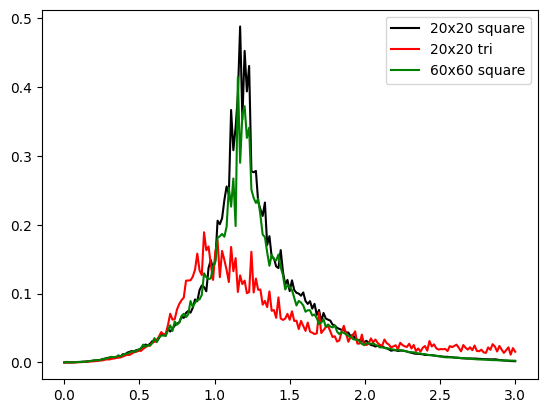

In [10]:
plt.plot(xs, approx_ys_sq, "k", label="20x20 square")
plt.plot(xs, approx_ys_tri, "r", label="20x20 tri")
plt.plot(xs, true_ys_sq, "g", label="60x60 square")
plt.legend(loc="best")

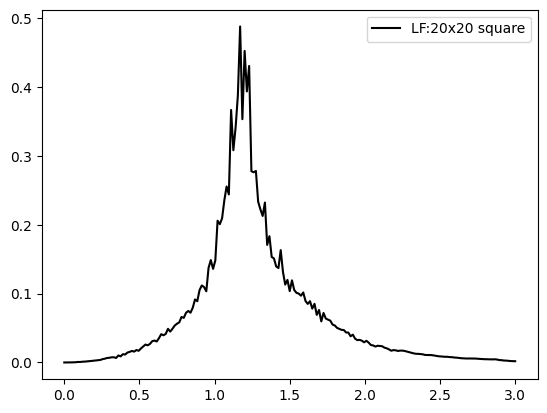

In [11]:
plt.plot(xs, approx_ys_sq, "k", label="LF:20x20 square")
#plt.plot(xs, true_ys_sq, "g", label="ground truth")
plt.legend(loc="best")

In [12]:
np.argmax(approx_ys_sq), np.argmax(approx_ys_tri)
xs[np.argmax(approx_ys_sq)], xs[np.argmax(approx_ys_tri)]

(1.17, 0.9299999999999999)

# Multi-fidelity Bayesian Optimization

Considering square low and high fid models -- Correct low fid model

Initial Sampling- 10 samples

In [ ]:
n = 10

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]))

<ipython-input-28-8de86ade8ab9>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:17<00:00, 29.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:49<00:00, 10.10it/s]


Completed. Saving
Time (s) to complete simulation 1: 66.60000944137573


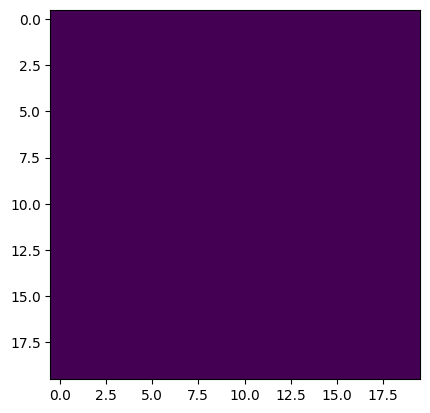

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [07:06<00:00,  1.17it/s]

Completed. Saving
Time (s) to complete simulation 2: 573.4843335151672


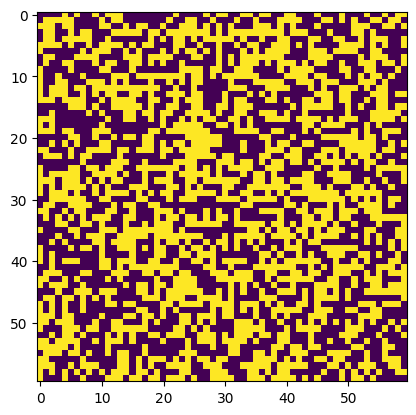

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 30.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:46<00:00, 10.68it/s]


Completed. Saving
Time (s) to complete simulation 3: 62.975717067718506


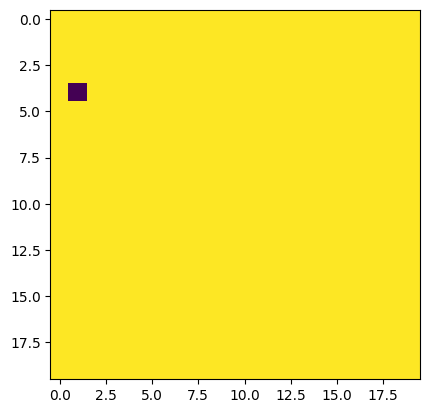

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 31.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:46<00:00, 10.65it/s]


Completed. Saving
Time (s) to complete simulation 4: 63.06074571609497


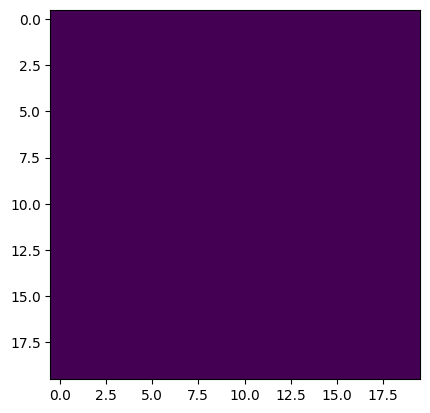

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:23<00:00,  3.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:56<00:00,  1.20it/s]

Completed. Saving
Time (s) to complete simulation 5: 559.1638526916504


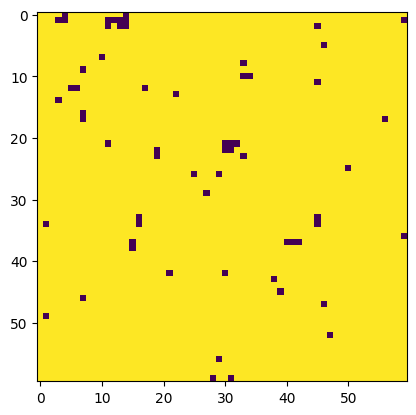

Evaluation 6 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:23<00:00,  3.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:52<00:00,  1.21it/s]

Completed. Saving
Time (s) to complete simulation 6: 556.4757454395294


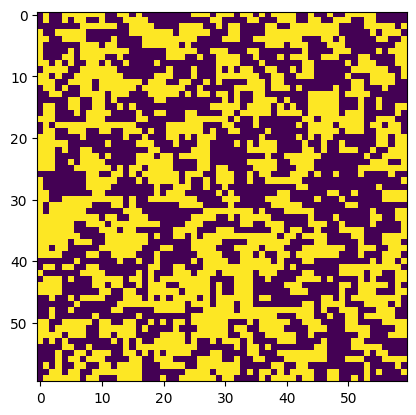

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 31.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:46<00:00, 10.67it/s]


Completed. Saving
Time (s) to complete simulation 7: 62.964715003967285


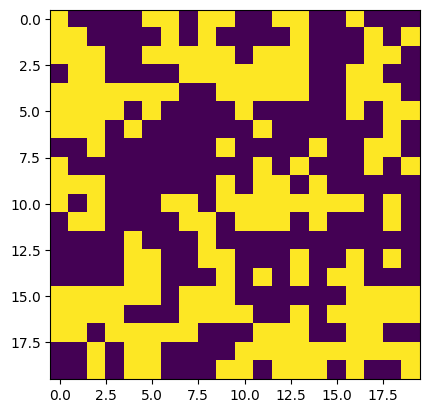

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:15<00:00, 31.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:46<00:00, 10.85it/s]


Completed. Saving
Time (s) to complete simulation 8: 61.84253287315369


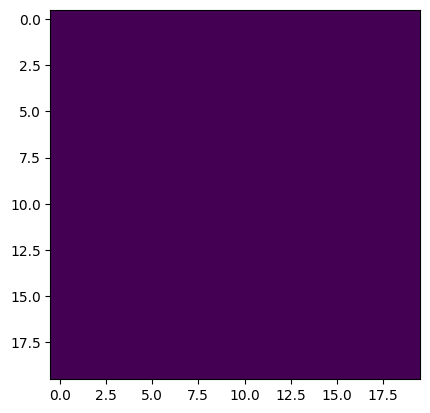

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:22<00:00,  3.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:56<00:00,  1.20it/s]

Completed. Saving
Time (s) to complete simulation 9: 559.2608535289764


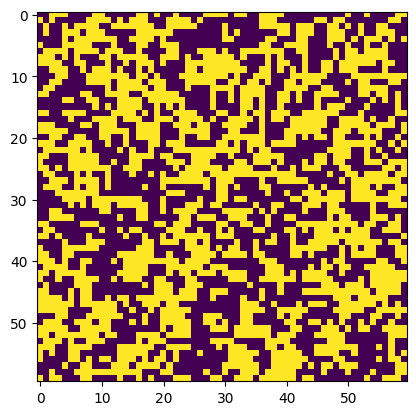

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 30.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:47<00:00, 10.64it/s]


Completed. Saving
Time (s) to complete simulation 10: 63.34011888504028


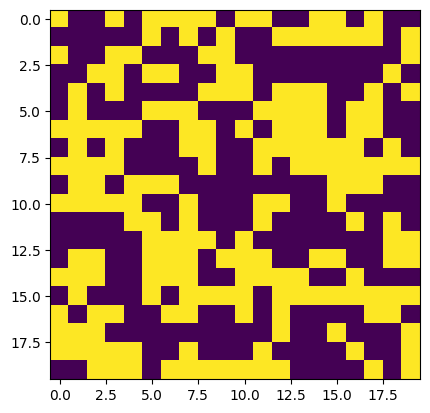

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

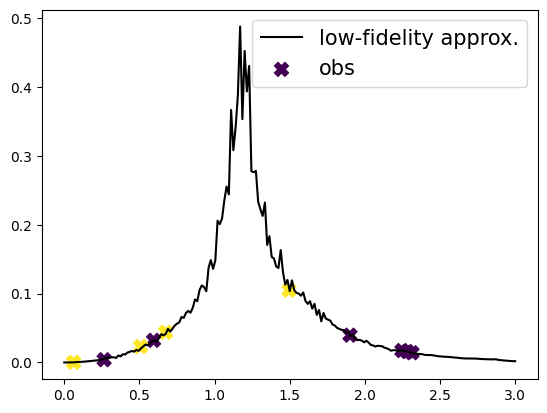

In [ ]:
plt.plot(xs, approx_ys_sq, "k", label="low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

Run BO- 35 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]),
 array([[0.01413402],
        [0.00025922],
        [0.03967774],
        [0.01734454],
        [0.10503485],
        [0.04375014],
        [0.0321721 ],
        [0.01583695],
        [0.02304033],
        [0.00402616]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 62.46it/s, 7 steps of size 2.70e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.46      0.29      0.46      0.01      0.89    375.32      1.00
  k_length      0.63      0.18      0.60      0.38      0.94    226.19      1.00
   k_scale      0.07      0.09      0.04      0.01      0.15    172.59      1.00
     noise      0.02      0.02      0.02      0.00      0.05    183.30      1.00



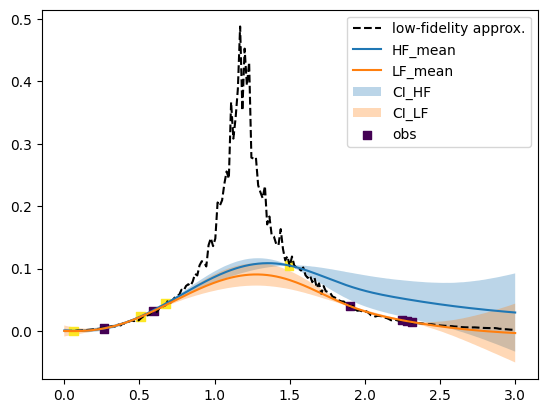

(402,)


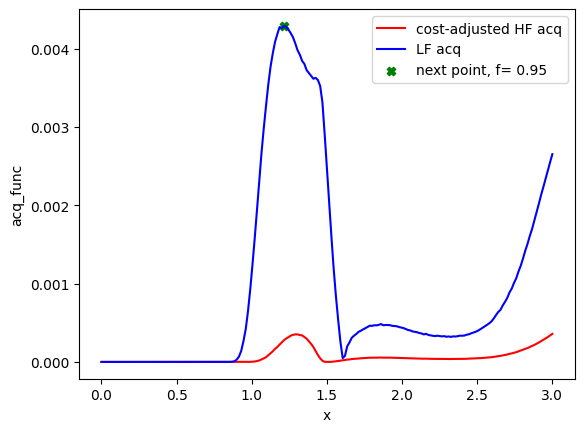

81
[1.215 0.95 ] 1.2149999999999999
Evaluation 11 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.68it/s]


Completed. Saving
Time (s) to complete simulation 2: 23.93194341659546


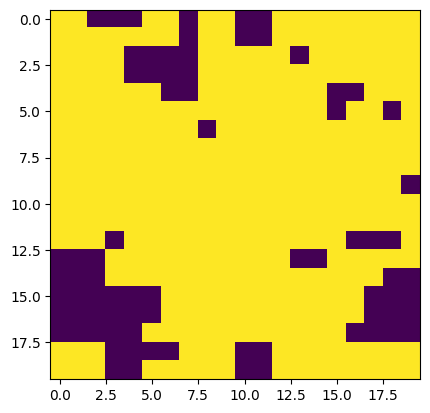

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:18<00:00, 54.49it/s, 5 steps of size 3.26e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.51      0.28      0.53      0.01      0.90    308.71      1.00
  k_length      0.23      0.10      0.21      0.09      0.38    140.05      1.00
   k_scale      0.17      0.20      0.09      0.01      0.43    180.59      1.00
     noise      0.03      0.02      0.02      0.00      0.05    248.37      1.00



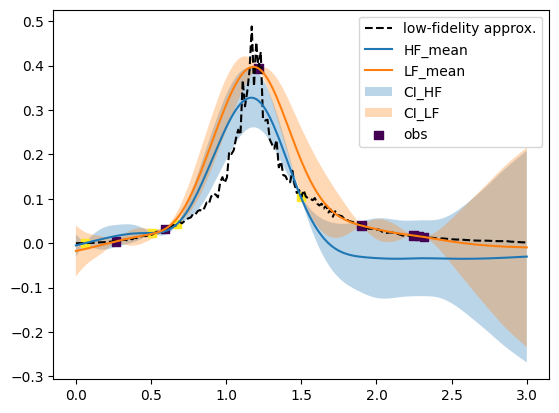

(402,)


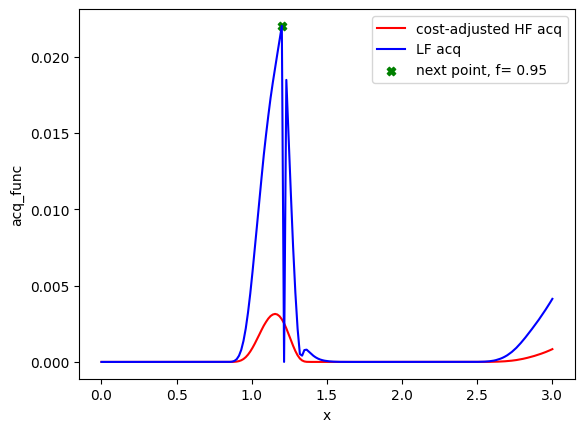

[81 80]
[1.2  0.95] 1.2
Evaluation 12 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.17it/s]


Completed. Saving
Time (s) to complete simulation 3: 24.38872456550598


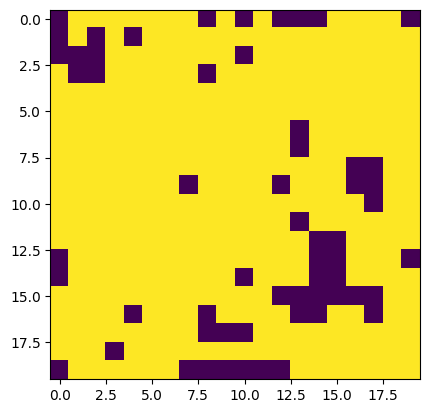

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:3


sample: 100%|██████████| 1000/1000 [00:17<00:00, 55.73it/s, 7 steps of size 3.46e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.45      0.28      0.44      0.01      0.85    402.13      1.00
  k_length      0.06      0.03      0.06      0.02      0.11    198.05      1.00
   k_scale      0.08      0.08      0.06      0.01      0.17    223.80      1.00
     noise      0.03      0.02      0.02      0.00      0.05    229.97      1.00



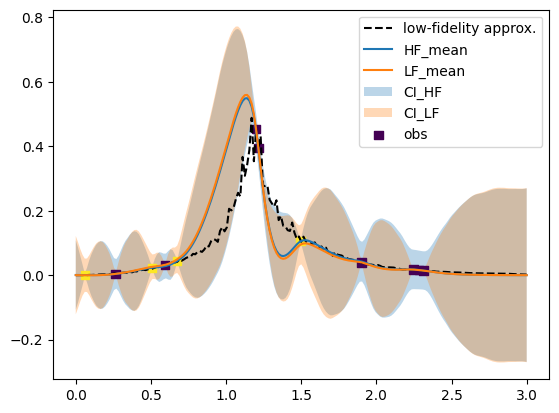

(402,)


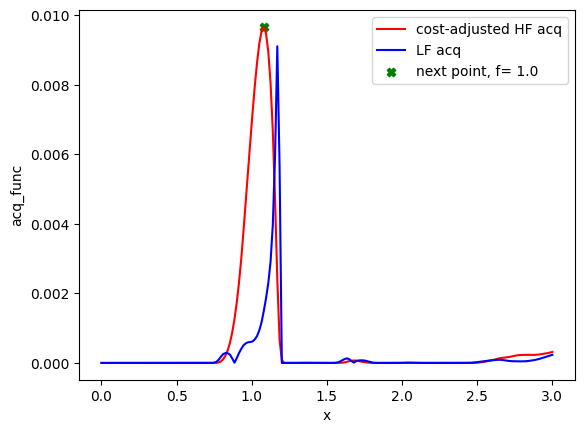

[ 81  80 273]
[1.08 1.  ] 1.08
Evaluation 13 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:35<00:00,  3.22it/s]

Completed. Saving
Time (s) to complete simulation 4: 214.7088224887848


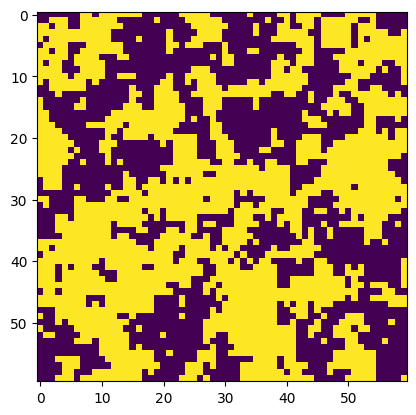

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:4


sample: 100%|██████████| 1000/1000 [00:17<00:00, 58.12it/s, 7 steps of size 4.92e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.51      0.28      0.50      0.12      1.00    526.45      1.00
  k_length      0.03      0.01      0.03      0.02      0.05    334.92      1.00
   k_scale      0.04      0.04      0.03      0.01      0.07    378.11      1.00
     noise      0.02      0.02      0.02      0.00      0.05    295.06      1.00



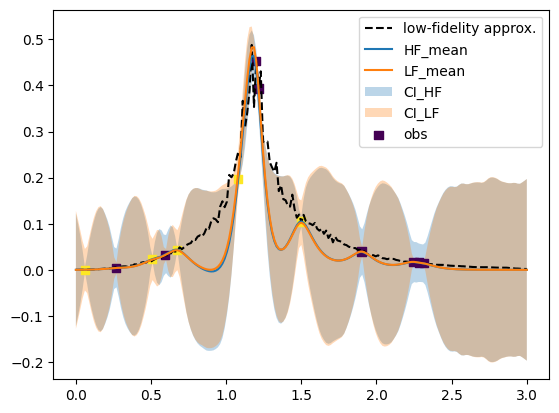

(402,)


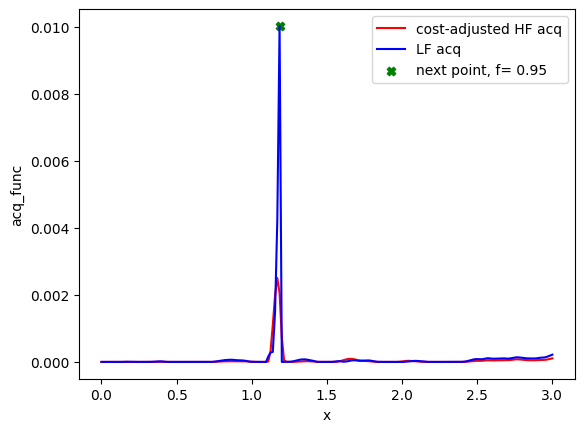

[ 81  80 273  79]
[1.185 0.95 ] 1.185
Evaluation 14 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.17it/s]


Completed. Saving
Time (s) to complete simulation 5: 24.43844175338745


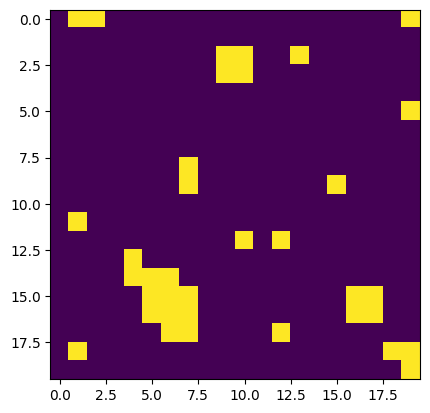

Step:5


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 60.38it/s, 7 steps of size 4.55e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.52      0.28      0.54      0.10      0.98    489.57      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    221.18      1.00
   k_scale      0.03      0.02      0.03      0.01      0.05    335.76      1.00
     noise      0.02      0.02      0.02      0.00      0.05    244.66      1.00



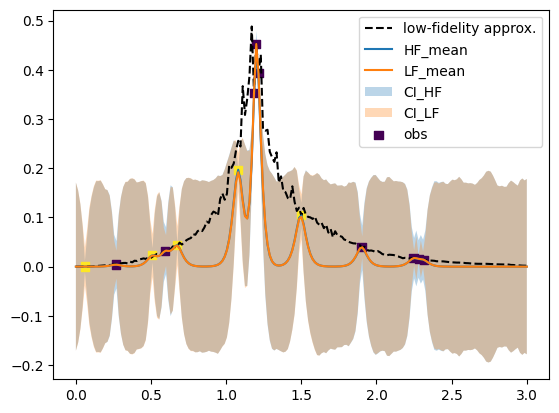

(402,)


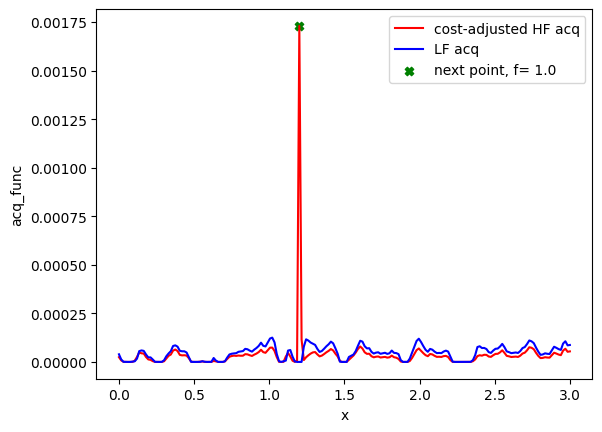

[ 81  80 273  79 281]
[1.2 1. ] 1.2
Evaluation 15 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.39it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:34<00:00,  3.23it/s]

Completed. Saving
Time (s) to complete simulation 6: 214.55460619926453


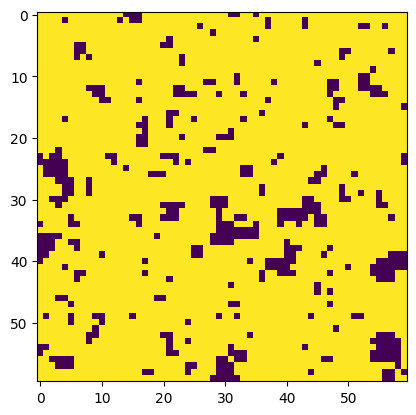

Step:6


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:18<00:00, 53.93it/s, 7 steps of size 3.70e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.72      0.19      0.74      0.44      1.00    226.09      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    293.38      1.00
   k_scale      0.04      0.02      0.03      0.02      0.07    282.05      1.00
     noise      0.02      0.02      0.02      0.00      0.05    308.48      1.00



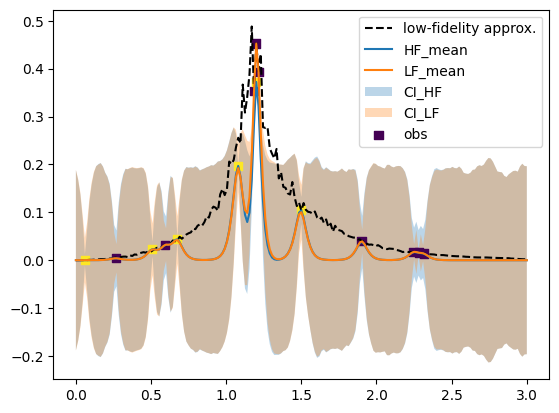

(402,)


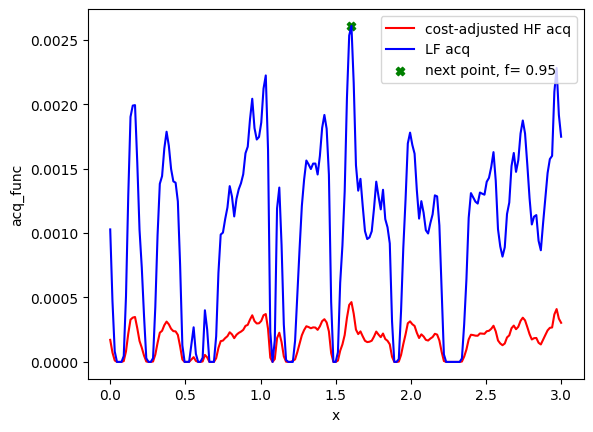

[ 81  80 273  79 281 107]
[1.605 0.95 ] 1.605
Evaluation 16 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.77it/s]


Completed. Saving
Time (s) to complete simulation 7: 23.93517518043518


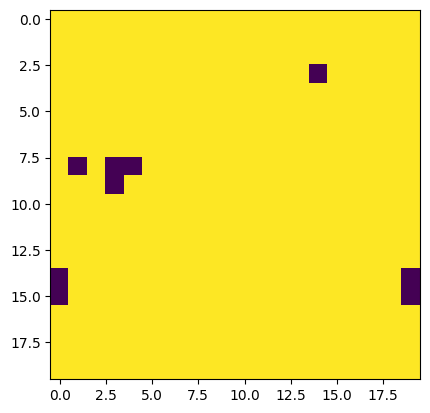

Step:7


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 102.29it/s, 7 steps of size 5.24e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.73      0.20      0.77      0.45      1.00    296.80      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    232.83      1.00
   k_scale      0.03      0.02      0.03      0.01      0.06    324.32      1.00
     noise      0.02      0.02      0.02      0.00      0.05    217.20      1.00



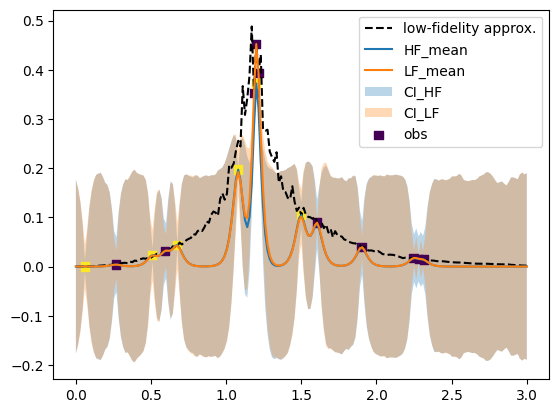

(402,)


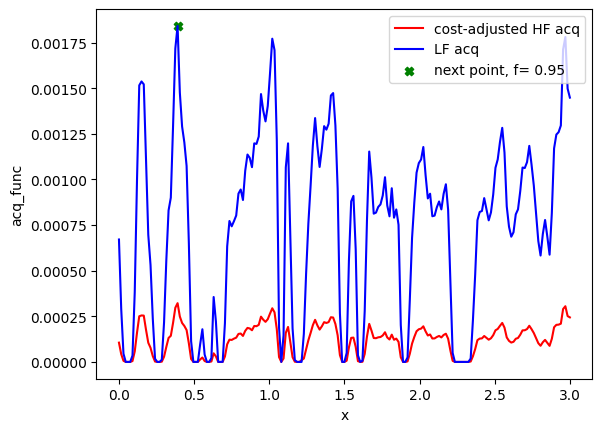

[ 81  80 273  79 281 107  26]
[0.39 0.95] 0.39
Evaluation 17 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.63it/s]


Completed. Saving
Time (s) to complete simulation 8: 24.990615367889404


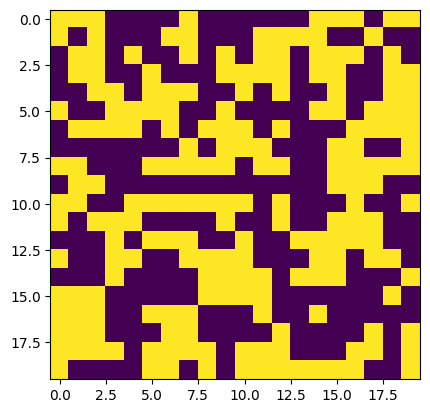

Step:8


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 47.42it/s, 7 steps of size 4.23e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.73      0.19      0.76      0.45      1.00    326.49      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    305.63      1.00
   k_scale      0.03      0.01      0.03      0.01      0.05    473.54      1.00
     noise      0.02      0.02      0.02      0.00      0.05    330.70      1.00



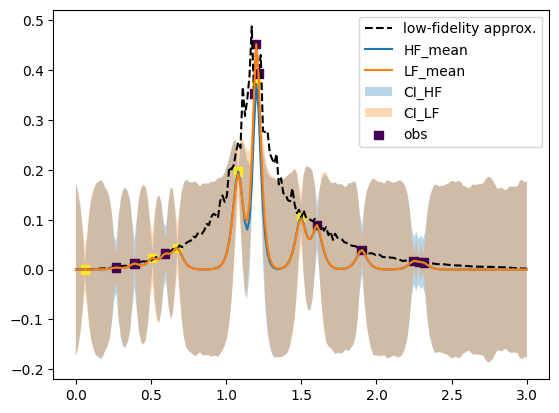

(402,)


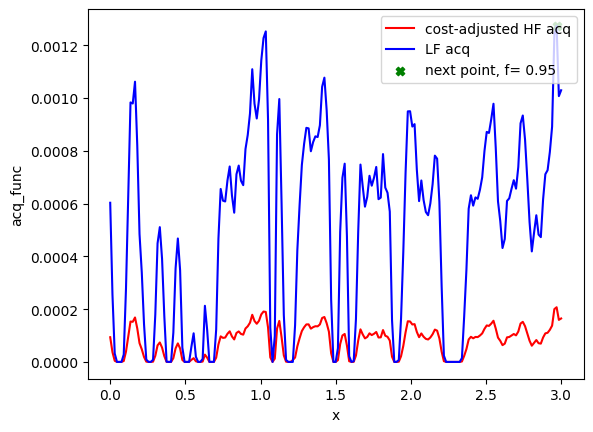

[ 81  80 273  79 281 107  26 198]
[2.97 0.95] 2.9699999999999998
Evaluation 18 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.85it/s]


Completed. Saving
Time (s) to complete simulation 9: 24.63434338569641


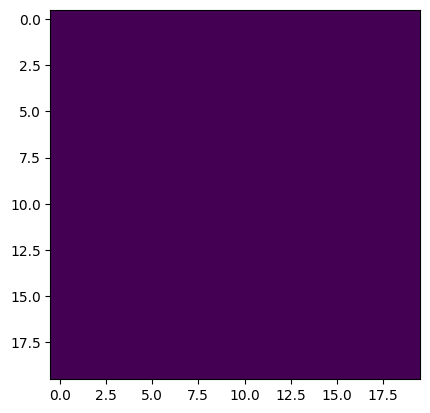

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:9


sample: 100%|██████████| 1000/1000 [00:24<00:00, 40.04it/s, 7 steps of size 3.97e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.73      0.18      0.77      0.45      1.00    296.38      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    364.80      1.00
   k_scale      0.03      0.01      0.03      0.01      0.04    290.14      1.00
     noise      0.02      0.02      0.02      0.00      0.05    395.02      1.00



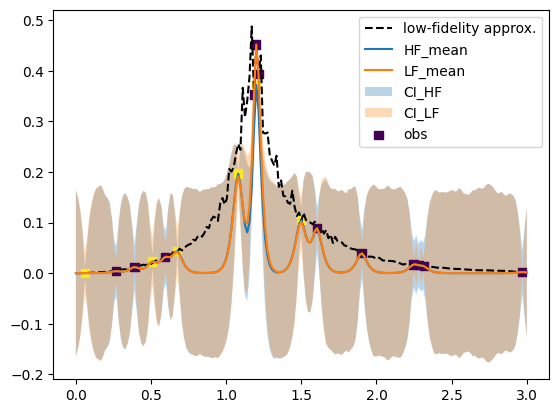

(402,)


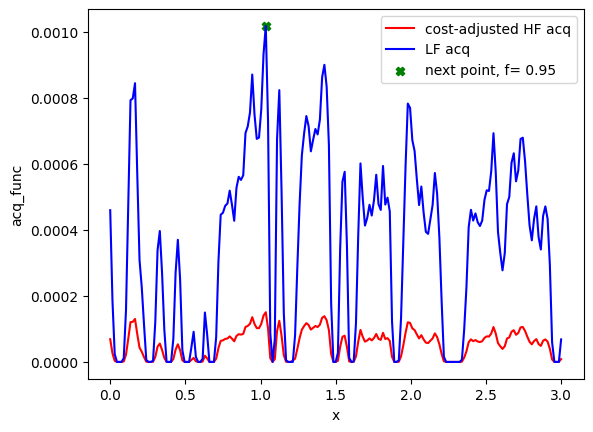

[ 81  80 273  79 281 107  26 198  69]
[1.035 0.95 ] 1.035
Evaluation 19 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.68it/s]


Completed. Saving
Time (s) to complete simulation 10: 25.051462650299072


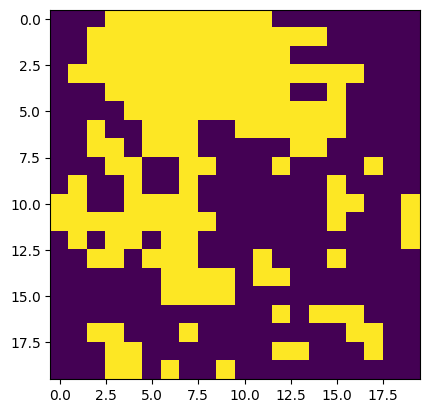

Step:10


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:22<00:00, 44.19it/s, 7 steps of size 4.60e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.19      0.80      0.46      1.00    295.14      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    251.27      1.00
   k_scale      0.03      0.01      0.02      0.01      0.04    493.55      1.00
     noise      0.02      0.02      0.02      0.00      0.05    249.60      1.00



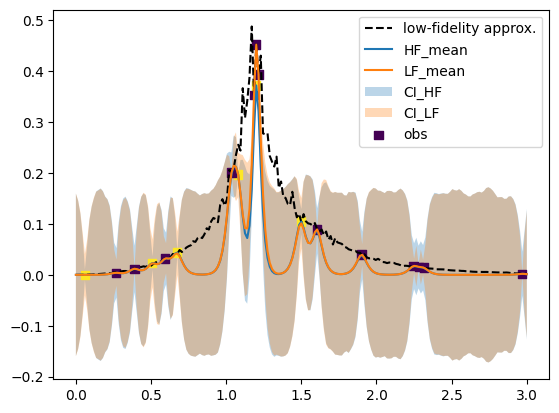

(402,)


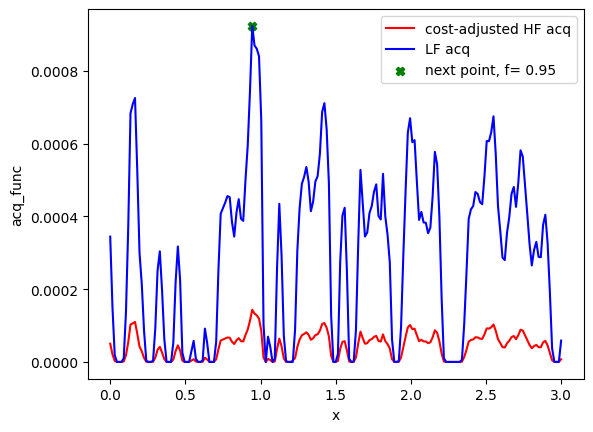

[ 81  80 273  79 281 107  26 198  69  63]
[0.945 0.95 ] 0.945
Evaluation 20 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.84it/s]


Completed. Saving
Time (s) to complete simulation 11: 24.935978651046753


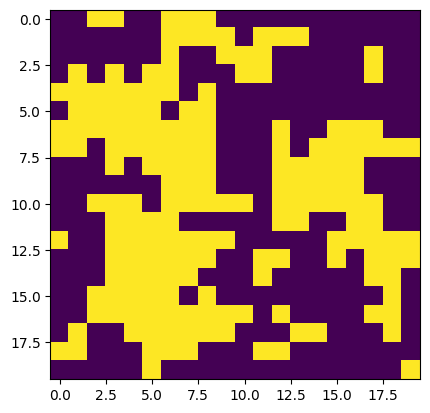

Step:11


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:22<00:00, 44.87it/s, 7 steps of size 4.95e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.19      0.79      0.47      1.00    370.24      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    239.19      1.00
   k_scale      0.03      0.01      0.02      0.01      0.04    442.18      1.00
     noise      0.02      0.02      0.02      0.00      0.05    419.04      1.00



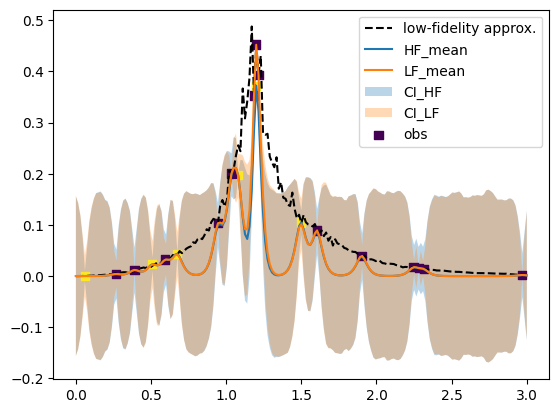

(402,)


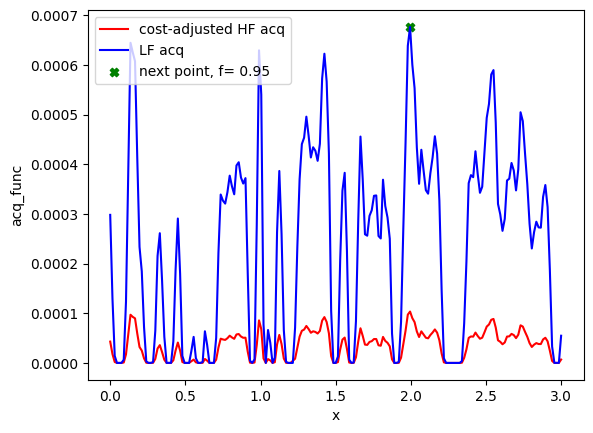

[ 81  80 273  79 281 107  26 198  69  63 133]
[1.995 0.95 ] 1.9949999999999999
Evaluation 21 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.86it/s]


Completed. Saving
Time (s) to complete simulation 12: 24.60998821258545


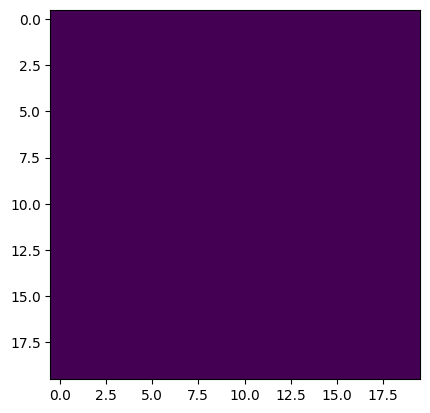

Step:12


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:29<00:00, 34.14it/s, 7 steps of size 3.96e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.74      0.17      0.77      0.48      1.00    264.60      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    439.37      1.00
   k_scale      0.02      0.01      0.02      0.01      0.04    331.59      1.00
     noise      0.02      0.02      0.02      0.00      0.05    235.62      1.00



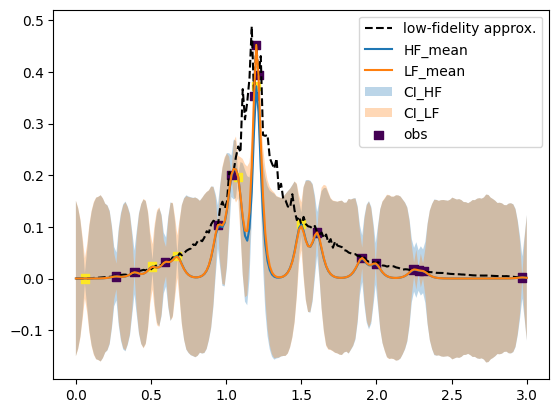

(402,)


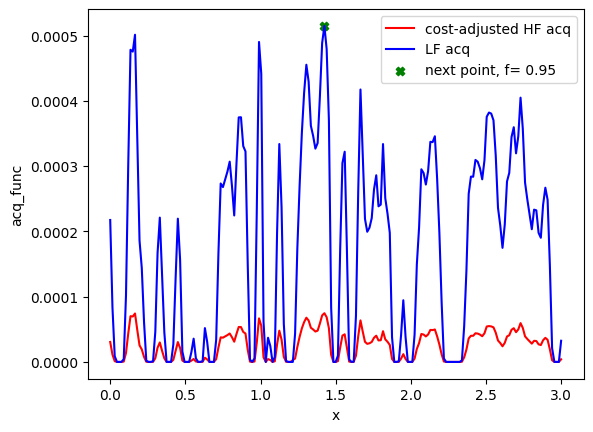

[ 81  80 273  79 281 107  26 198  69  63 133  95]
[1.425 0.95 ] 1.425
Evaluation 22 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.95it/s]


Completed. Saving
Time (s) to complete simulation 13: 24.60325026512146


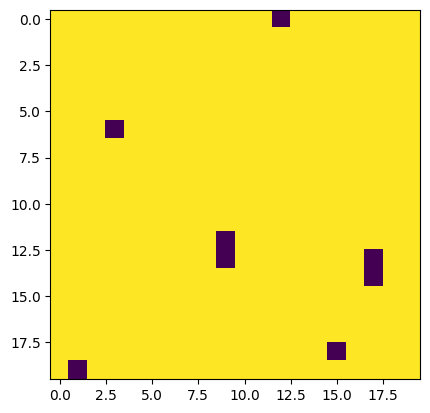

Step:13


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:27<00:00, 36.07it/s, 7 steps of size 3.66e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.18      0.78      0.49      1.00    340.08      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    206.04      1.00
   k_scale      0.02      0.01      0.02      0.01      0.04    382.59      1.00
     noise      0.02      0.02      0.02      0.00      0.05    257.49      1.00



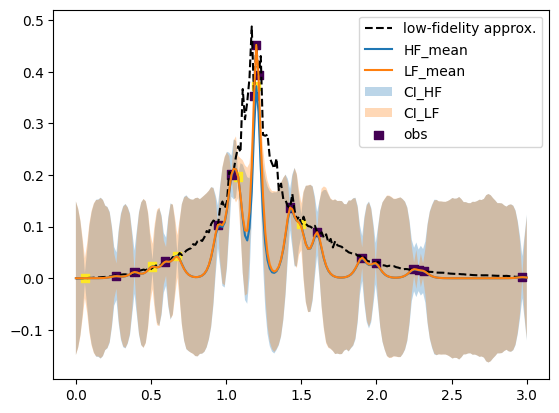

(402,)


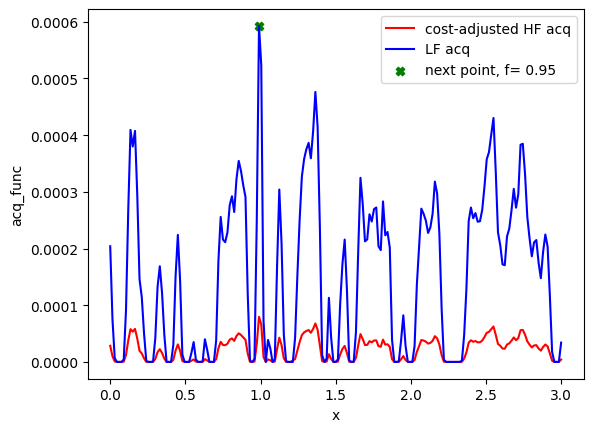

[ 81  80 273  79 281 107  26 198  69  63 133  95  66]
[0.99 0.95] 0.99
Evaluation 23 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.92it/s]


Completed. Saving
Time (s) to complete simulation 14: 24.740309715270996


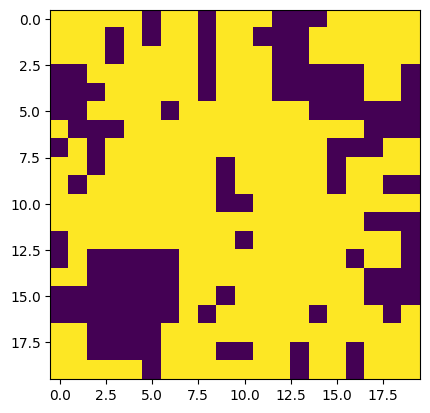

Step:14


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:30<00:00, 32.35it/s, 15 steps of size 3.37e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.74      0.18      0.77      0.48      1.00    336.80      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    238.01      1.01
   k_scale      0.02      0.01      0.02      0.01      0.03    344.14      1.00
     noise      0.02      0.02      0.02      0.00      0.05    124.26      1.00



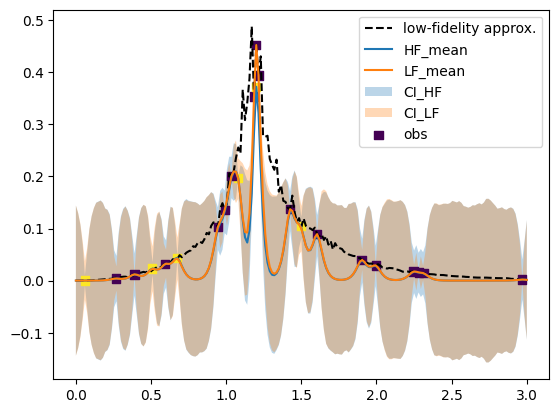

(402,)


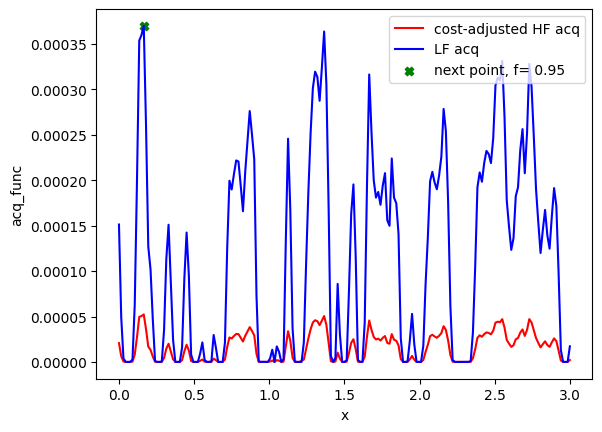

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11]
[0.165 0.95 ] 0.16499999999999998
Evaluation 24 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.36it/s]


Completed. Saving
Time (s) to complete simulation 15: 25.266683101654053


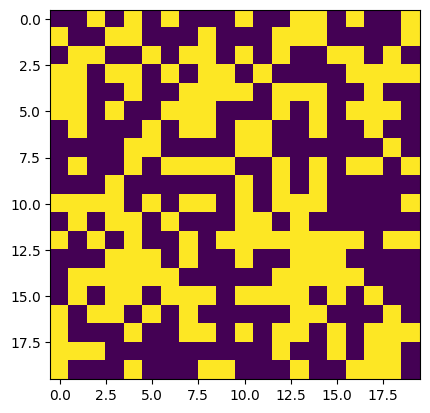

Step:15


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:31<00:00, 32.20it/s, 15 steps of size 3.83e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.80      0.50      1.00    332.11      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    284.67      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    384.20      1.00
     noise      0.02      0.02      0.02      0.00      0.05    331.89      1.00



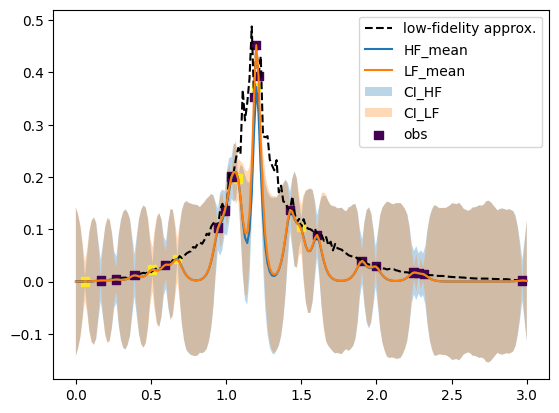

(402,)


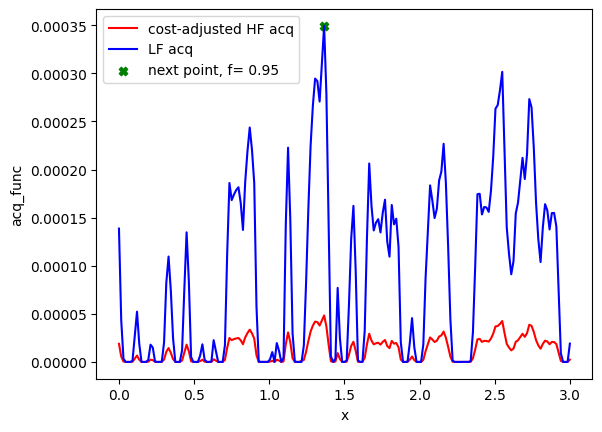

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91]
[1.365 0.95 ] 1.365
Evaluation 25 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.21it/s]


Completed. Saving
Time (s) to complete simulation 16: 24.54711651802063


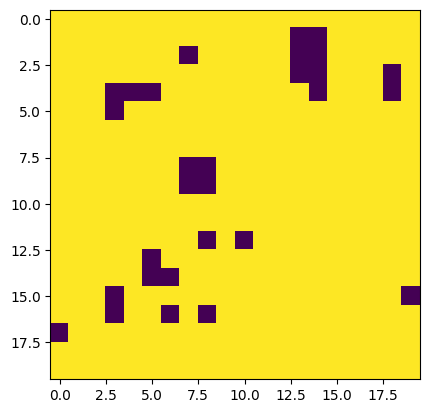

Step:16


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:31<00:00, 31.93it/s, 7 steps of size 3.78e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.18      0.79      0.48      1.00    259.65      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    334.04      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    421.73      1.00
     noise      0.02      0.02      0.02      0.00      0.05    350.30      1.00



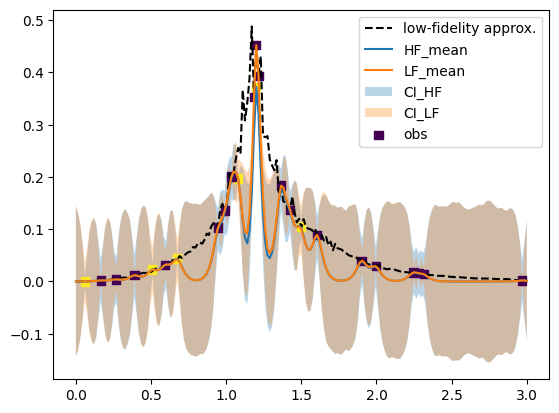

(402,)


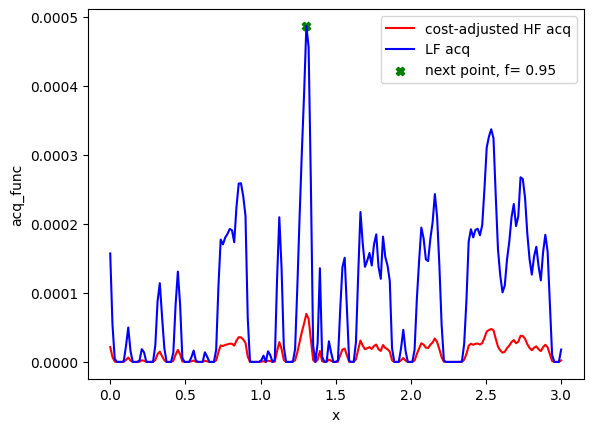

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87]
[1.305 0.95 ] 1.305
Evaluation 26 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.46it/s]


Completed. Saving
Time (s) to complete simulation 17: 24.377179384231567


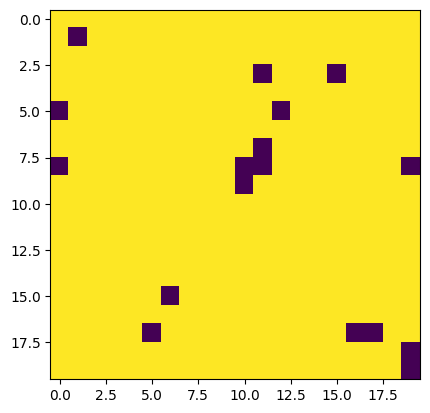

Step:17


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:33<00:00, 30.03it/s, 15 steps of size 3.76e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.17      0.77      0.48      0.99    344.41      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    287.83      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    337.63      1.00
     noise      0.02      0.02      0.02      0.00      0.05    291.90      1.00



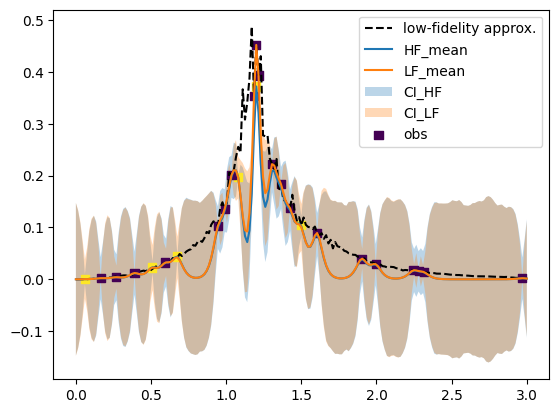

(402,)


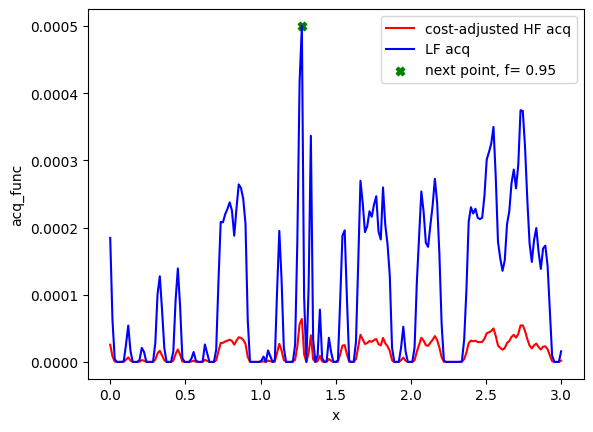

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85]
[1.275 0.95 ] 1.275
Evaluation 27 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.73it/s]


Completed. Saving
Time (s) to complete simulation 18: 24.656187772750854


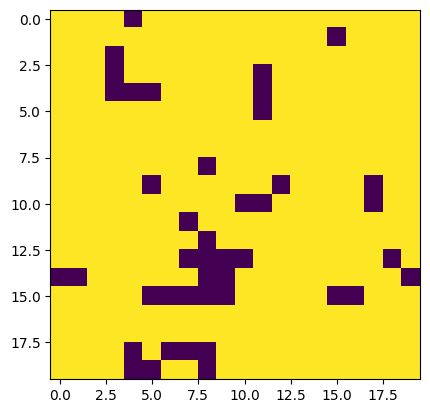

Step:18


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:44<00:00, 22.61it/s, 15 steps of size 2.50e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.78      0.51      0.99    242.24      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    201.03      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    338.54      1.00
     noise      0.02      0.02      0.02      0.00      0.05    223.63      1.00



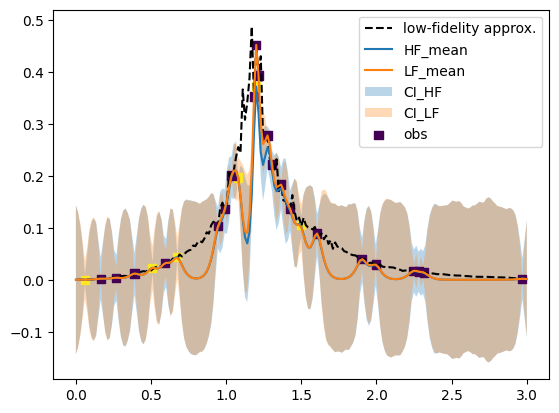

(402,)


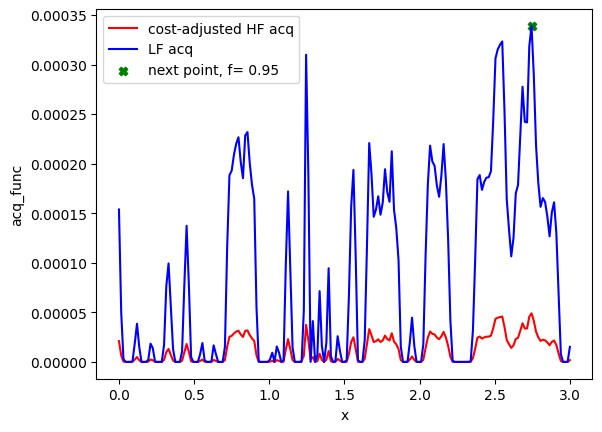

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183]
[2.745 0.95 ] 2.745
Evaluation 28 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.49it/s]


Completed. Saving
Time (s) to complete simulation 19: 24.193684816360474


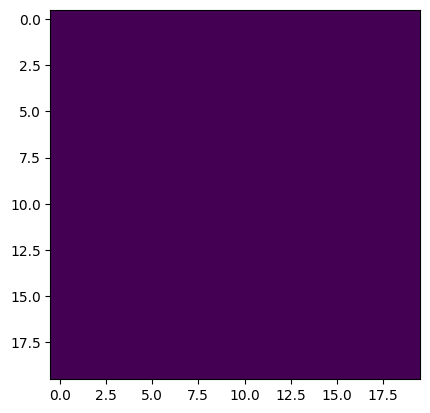

Step:19


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:37<00:00, 27.01it/s, 7 steps of size 5.04e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.80      0.52      1.00    508.01      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    295.77      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    398.47      1.00
     noise      0.02      0.02      0.02      0.00      0.05    294.96      1.00



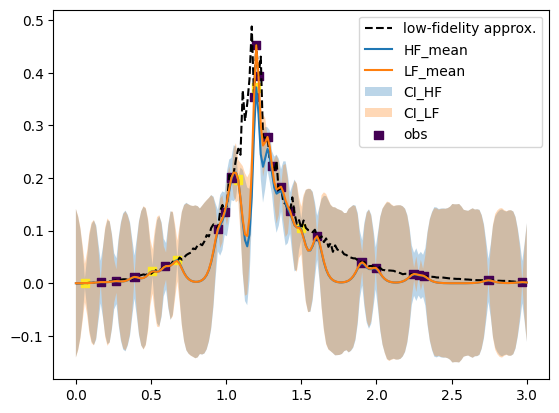

(402,)


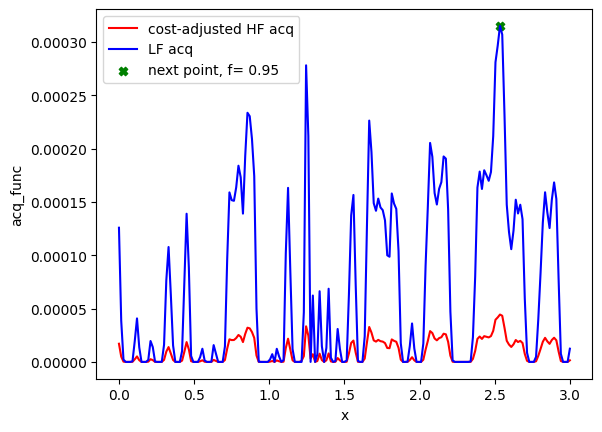

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169]
[2.535 0.95 ] 2.5349999999999997
Evaluation 29 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.97it/s]


Completed. Saving
Time (s) to complete simulation 20: 24.456443786621094


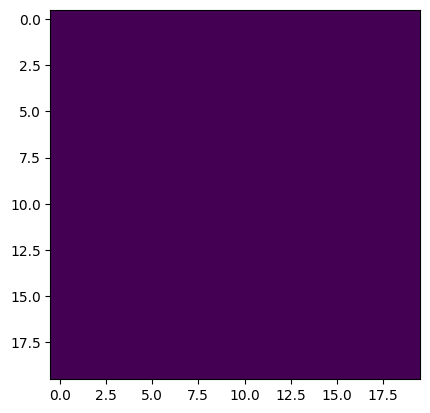

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:20


sample: 100%|██████████| 1000/1000 [00:37<00:00, 26.61it/s, 7 steps of size 4.27e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.80      0.51      1.00    492.47      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    189.01      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    292.00      1.00
     noise      0.02      0.02      0.02      0.00      0.05    280.40      1.00



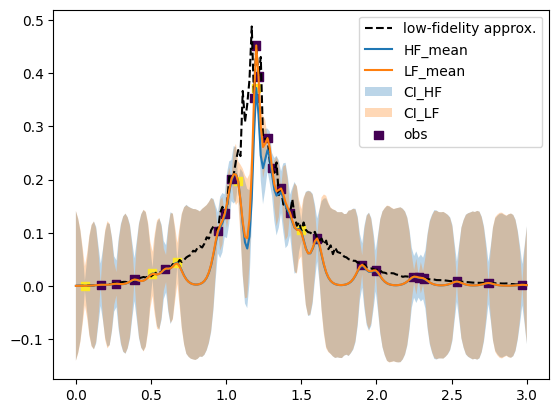

(402,)


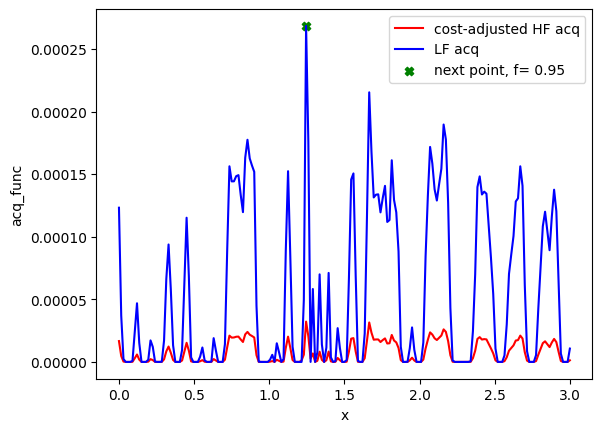

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83]
[1.245 0.95 ] 1.2449999999999999
Evaluation 30 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.08it/s]


Completed. Saving
Time (s) to complete simulation 21: 24.430583953857422


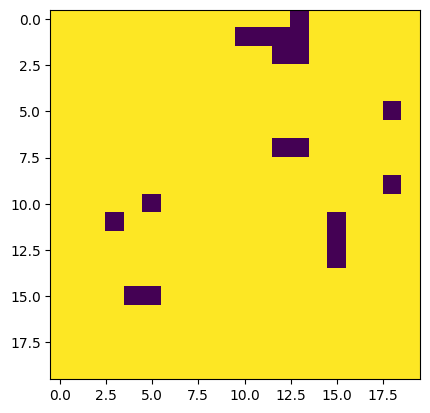

Step:21


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:38<00:00, 26.27it/s, 7 steps of size 4.53e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.79      0.51      1.00    362.47      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    477.46      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    388.35      1.00
     noise      0.02      0.02      0.02      0.00      0.05    259.99      1.00



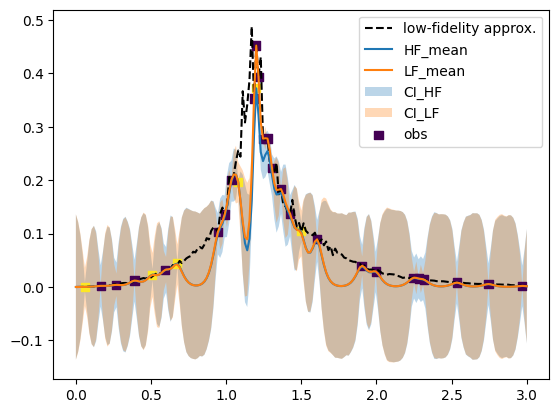

(402,)


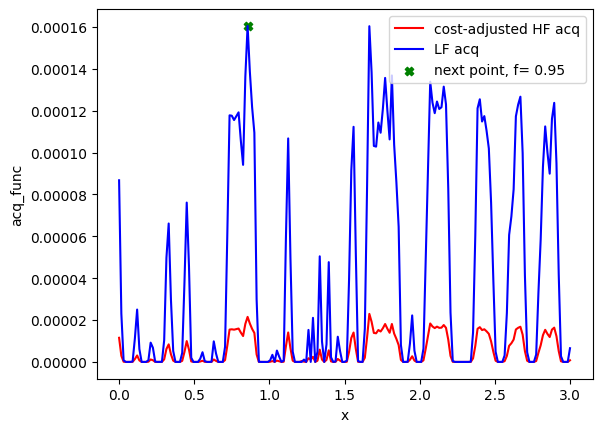

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57]
[0.855 0.95 ] 0.855
Evaluation 31 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.03it/s]


Completed. Saving
Time (s) to complete simulation 22: 24.739951848983765


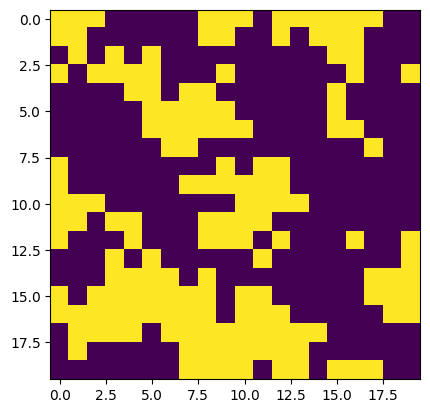

Step:22


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:38<00:00, 26.06it/s, 7 steps of size 4.64e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.18      0.79      0.50      1.00    511.43      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    219.82      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    377.34      1.00
     noise      0.02      0.02      0.02      0.00      0.05    303.46      1.00



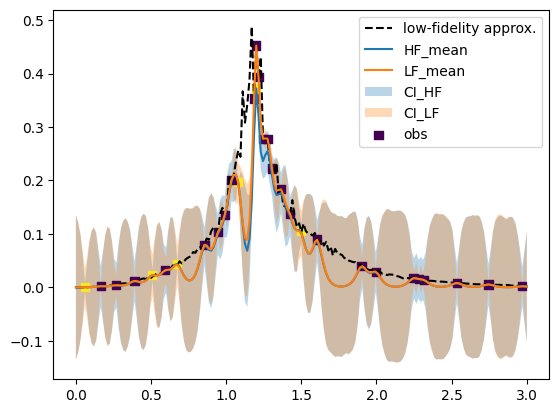

(402,)


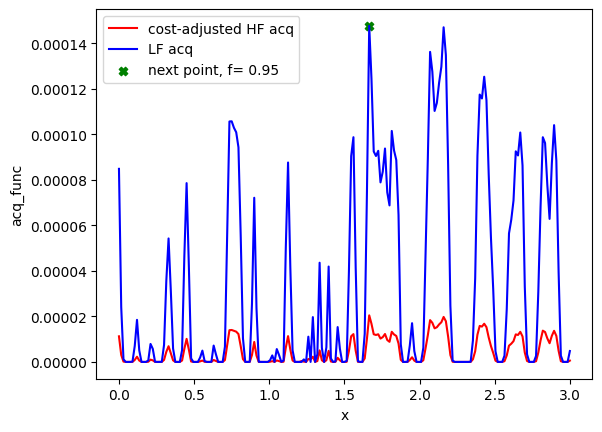

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111]
[1.665 0.95 ] 1.665
Evaluation 32 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.64it/s]


Completed. Saving
Time (s) to complete simulation 23: 24.147090196609497


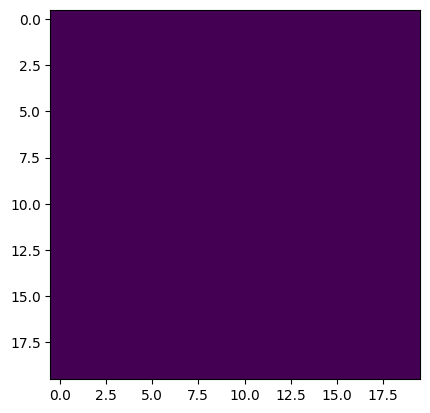

Step:23


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 85.53it/s, 15 steps of size 3.39e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.16      0.79      0.53      1.00    230.40      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    126.46      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    250.05      1.00
     noise      0.02      0.02      0.02      0.00      0.05    361.32      1.00



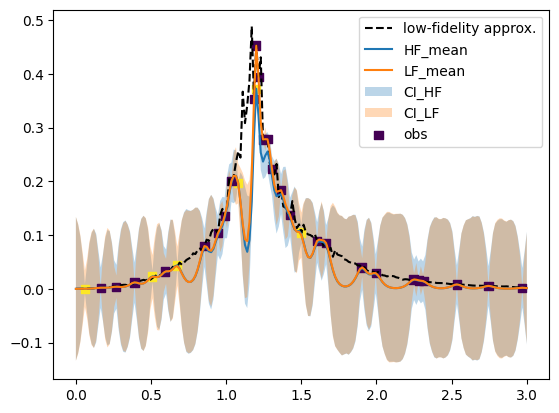

(402,)


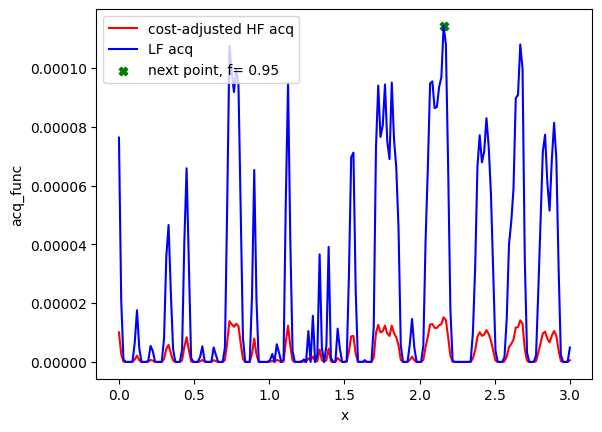

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144]
[2.16 0.95] 2.16
Evaluation 33 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.19it/s]


Completed. Saving
Time (s) to complete simulation 24: 24.20963478088379


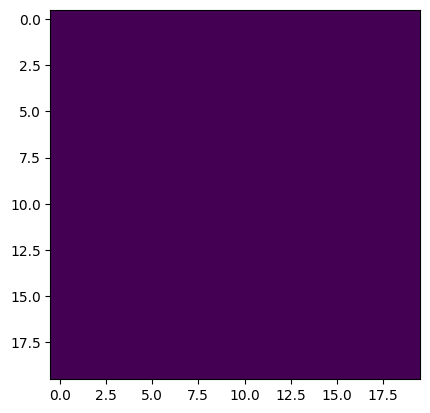

Step:24


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 77.53it/s, 7 steps of size 4.25e-01. acc. prob=0.94] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.17      0.81      0.52      1.00    312.55      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    219.77      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    390.88      1.00
     noise      0.02      0.02      0.02      0.00      0.05    145.11      1.01



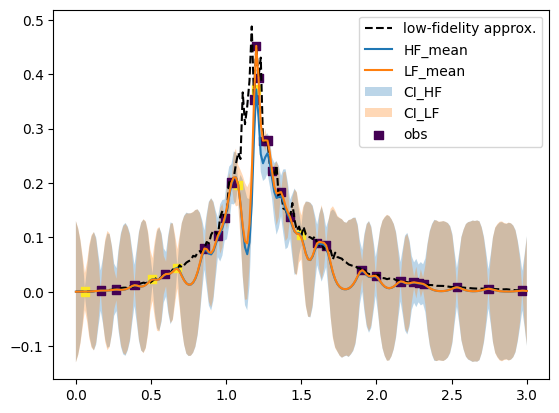

(402,)


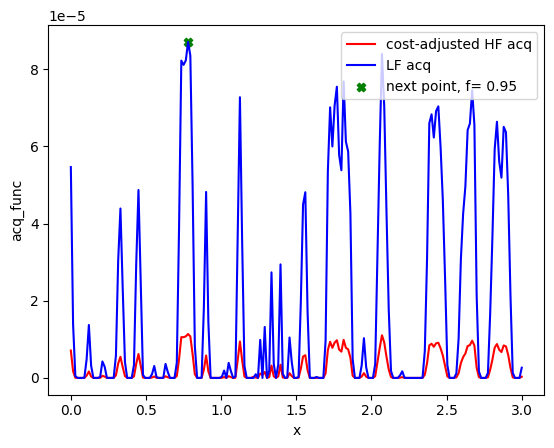

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52]
[0.78 0.95] 0.78
Evaluation 34 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.69it/s]


Completed. Saving
Time (s) to complete simulation 25: 24.999879121780396


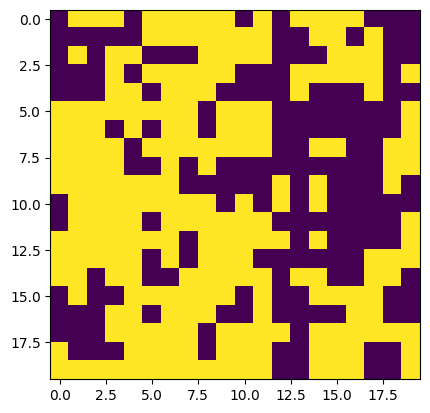

Step:25


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 84.33it/s, 7 steps of size 4.31e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.81      0.55      1.00    315.10      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    200.99      1.00
   k_scale      0.02      0.00      0.02      0.01      0.02    574.40      1.00
     noise      0.02      0.02      0.02      0.00      0.05    295.84      1.01



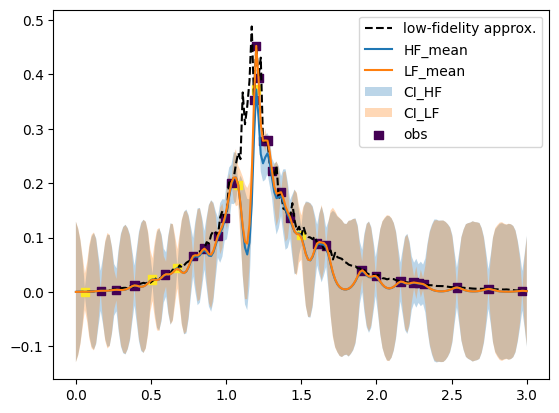

(402,)


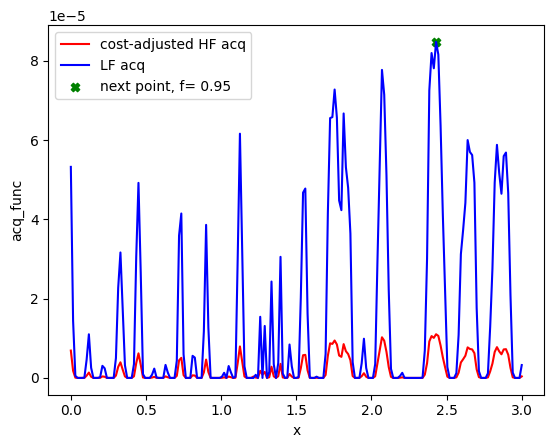

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162]
[2.43 0.95] 2.4299999999999997
Evaluation 35 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.81it/s]


Completed. Saving
Time (s) to complete simulation 26: 23.898842573165894


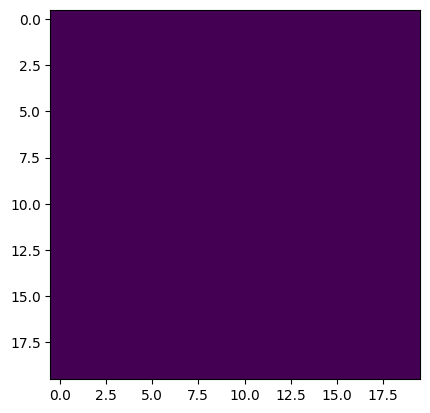

Step:26


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 84.65it/s, 7 steps of size 4.32e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.81      0.54      1.00    262.55      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    230.58      1.00
   k_scale      0.02      0.00      0.02      0.01      0.02    456.50      1.00
     noise      0.02      0.02      0.02      0.00      0.05    258.74      1.00



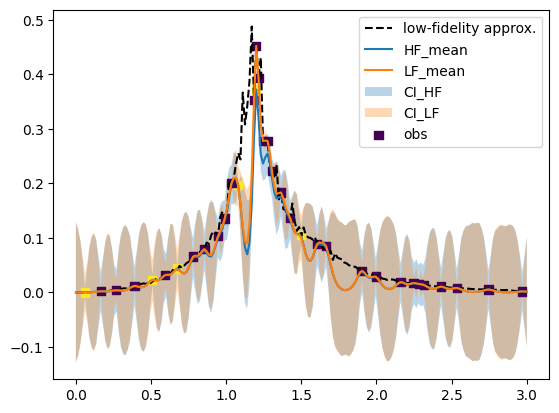

(402,)


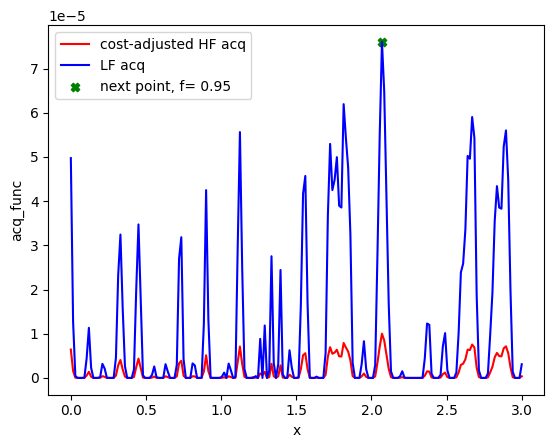

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138]
[2.07 0.95] 2.07
Evaluation 36 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.51it/s]


Completed. Saving
Time (s) to complete simulation 27: 24.11680579185486


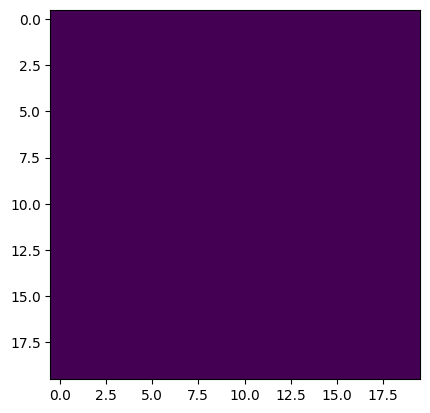

Step:27


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 90.88it/s, 7 steps of size 4.31e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.80      0.56      1.00    370.07      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    183.73      1.00
   k_scale      0.02      0.00      0.02      0.01      0.02    444.47      1.00
     noise      0.02      0.02      0.02      0.00      0.05    333.32      1.00



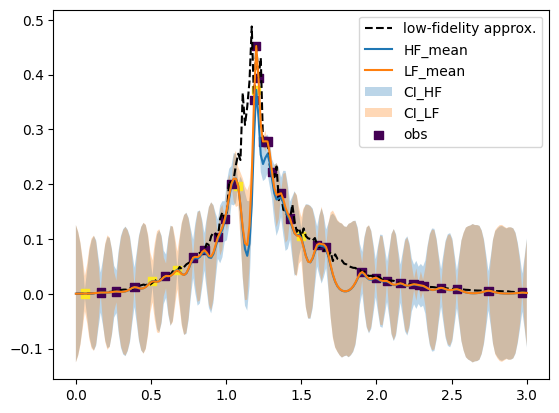

(402,)


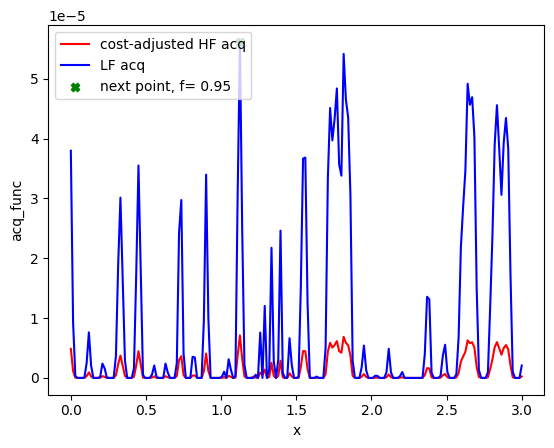

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75]
[1.125 0.95 ] 1.125
Evaluation 37 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.55it/s]


Completed. Saving
Time (s) to complete simulation 28: 24.384827852249146


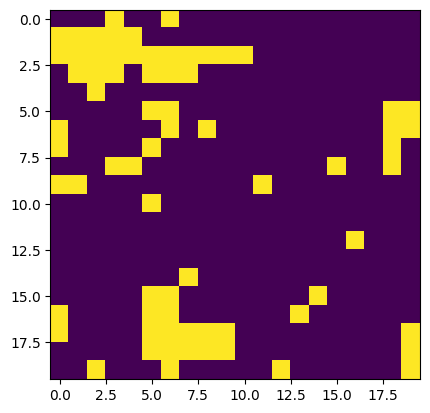

Step:28


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 90.43it/s, 7 steps of size 4.95e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.80      0.54      1.00    331.07      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    232.75      1.01
   k_scale      0.02      0.01      0.02      0.01      0.03    451.94      1.00
     noise      0.02      0.02      0.02      0.00      0.05    373.35      1.00



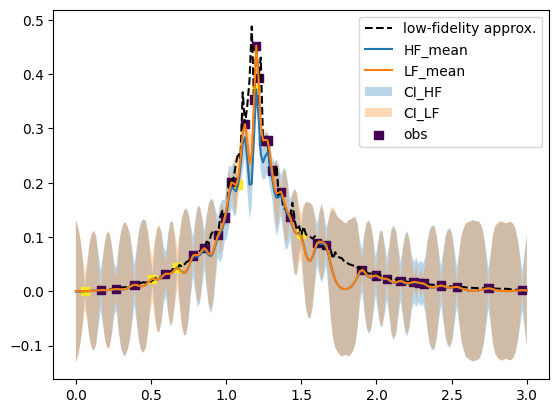

(402,)


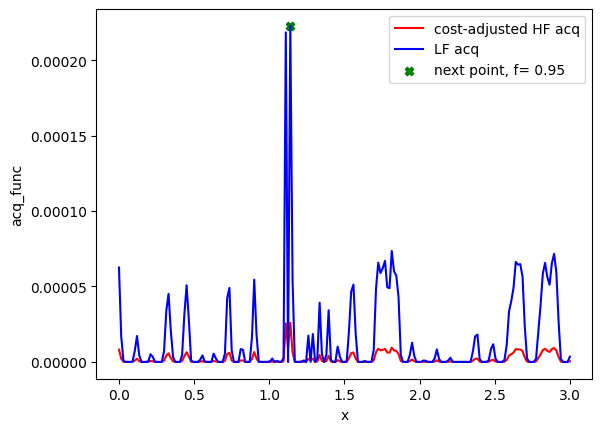

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76]
[1.14 0.95] 1.14
Evaluation 38 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.08it/s]


Completed. Saving
Time (s) to complete simulation 29: 24.621317863464355


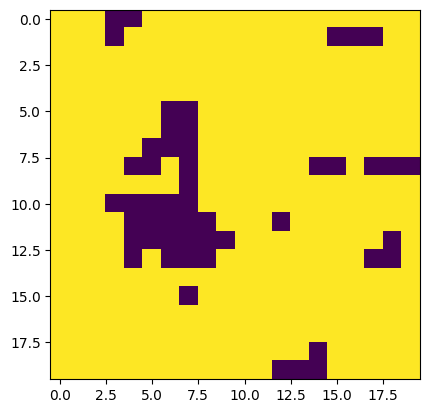

Step:29


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 90.28it/s, 7 steps of size 5.22e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.17      0.81      0.54      1.00    376.21      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    230.22      1.00
   k_scale      0.02      0.00      0.02      0.01      0.02    423.73      1.00
     noise      0.02      0.02      0.02      0.00      0.05    296.39      1.00



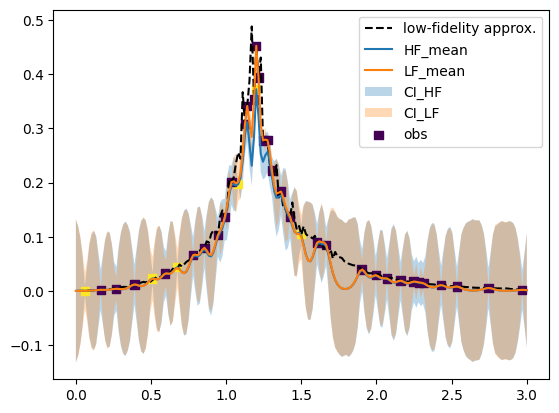

(402,)


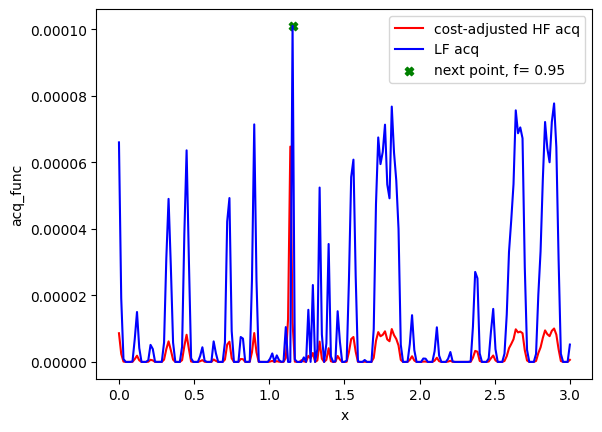

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77]
[1.155 0.95 ] 1.155
Evaluation 39 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.27it/s]


Completed. Saving
Time (s) to complete simulation 30: 25.252622842788696


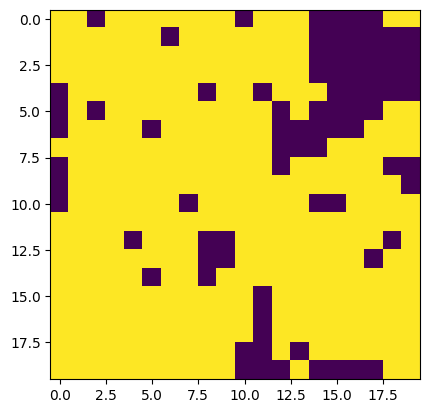

Step:30


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 80.54it/s, 7 steps of size 4.04e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.80      0.51      1.00    326.61      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    205.59      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    469.81      1.00
     noise      0.02      0.02      0.02      0.00      0.05    209.08      1.00



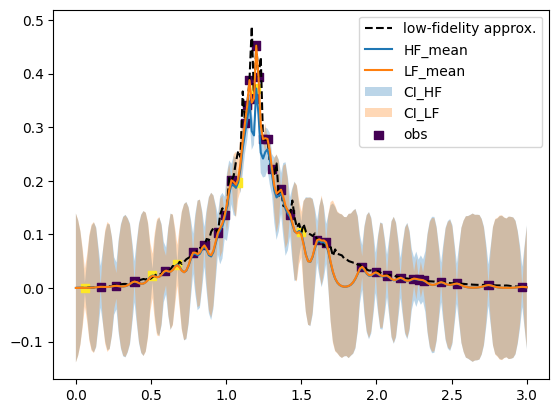

(402,)


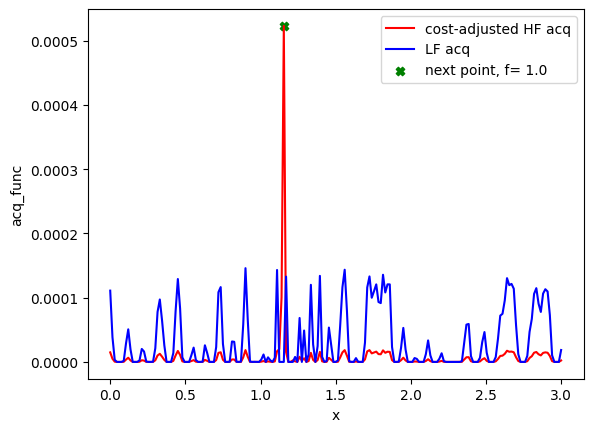

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77 278]
[1.155 1.   ] 1.155
Evaluation 40 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:36<00:00,  3.19it/s]

Completed. Saving
Time (s) to complete simulation 31: 218.14878296852112


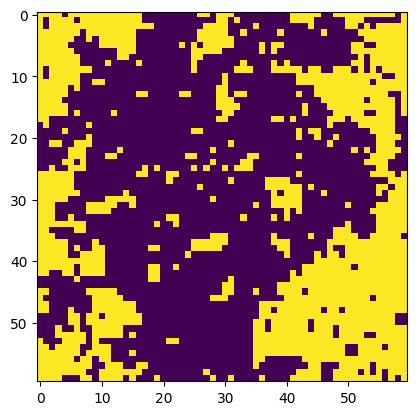

Step:31


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 84.84it/s, 7 steps of size 4.94e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.79      0.15      0.81      0.58      1.00    576.96      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    251.41      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    415.60      1.00
     noise      0.02      0.02      0.02      0.00      0.05    265.80      1.00



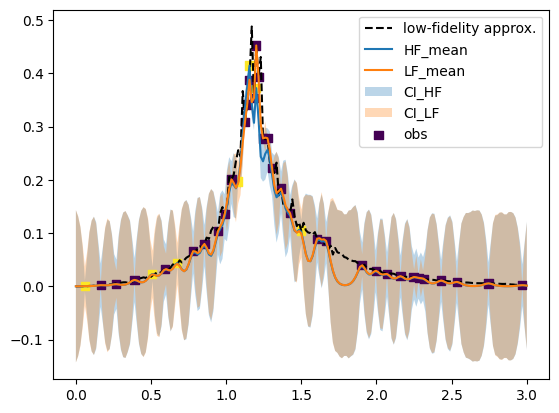

(402,)


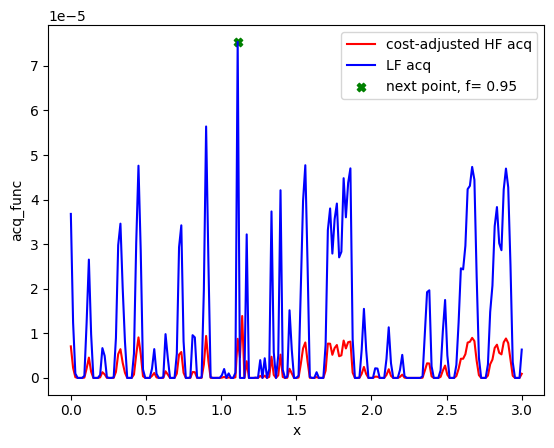

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77 278  74]
[1.11 0.95] 1.1099999999999999
Evaluation 41 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.50it/s]


Completed. Saving
Time (s) to complete simulation 32: 25.229847192764282


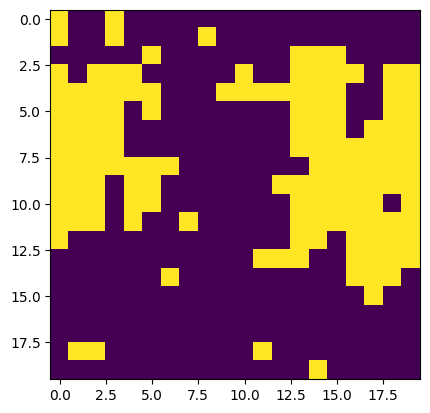

Step:32


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:13<00:00, 73.58it/s, 15 steps of size 3.32e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.80      0.54      1.00    426.01      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    261.50      1.01
   k_scale      0.02      0.01      0.02      0.01      0.03    351.15      1.00
     noise      0.02      0.02      0.02      0.00      0.05    187.23      1.00



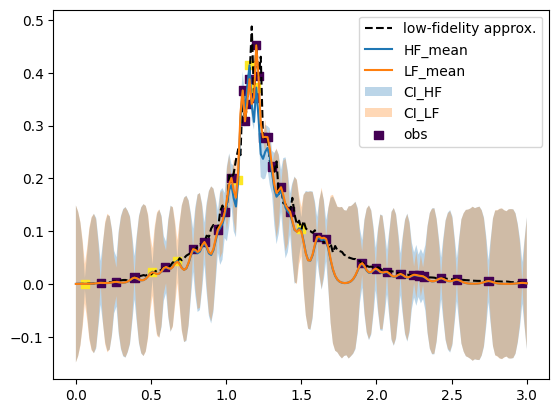

(402,)


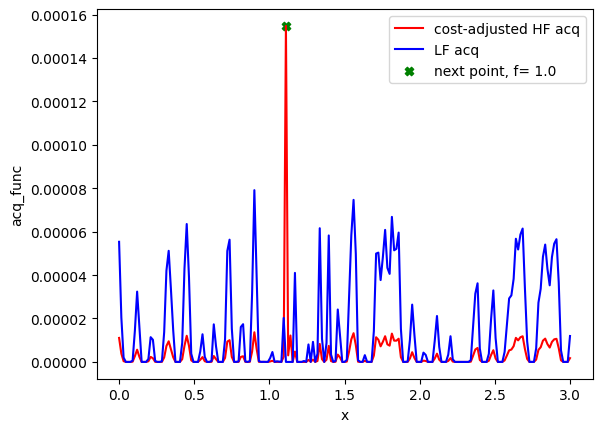

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77 278  74 275]
[1.11 1.  ] 1.1099999999999999
Evaluation 42 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:36<00:00,  3.19it/s]

Completed. Saving
Time (s) to complete simulation 33: 217.89375805854797


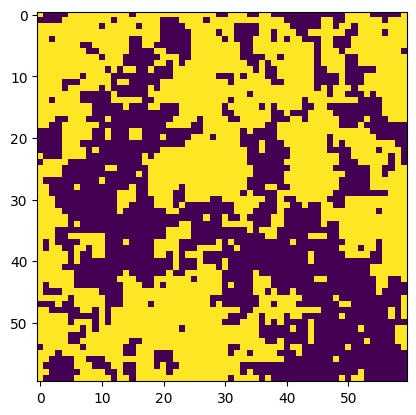

Step:33


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 78.27it/s, 7 steps of size 4.08e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.89      0.09      0.92      0.77      1.00    443.04      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    203.90      1.00
   k_scale      0.03      0.01      0.03      0.02      0.04    434.27      1.00
     noise      0.02      0.02      0.02      0.00      0.05    211.62      1.00



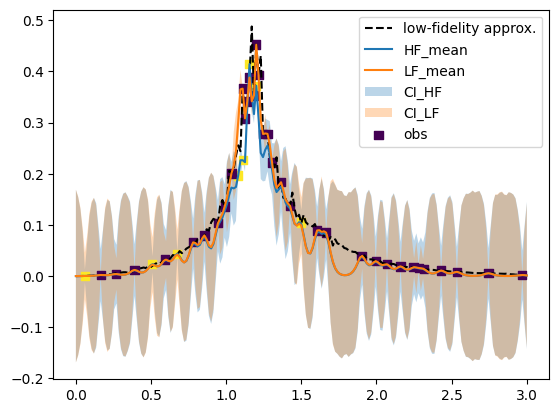

(402,)


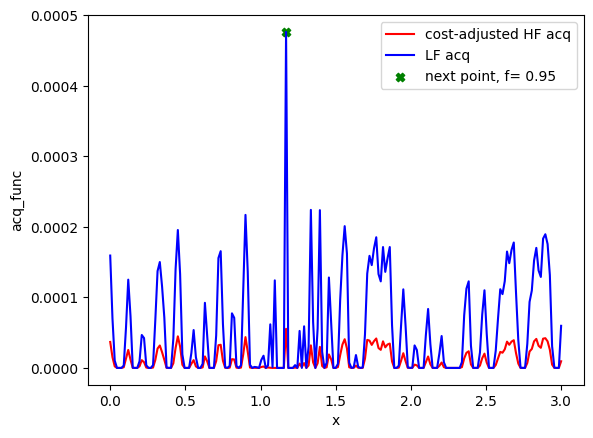

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77 278  74 275  78]
[1.17 0.95] 1.17
Evaluation 43 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.30it/s]


Completed. Saving
Time (s) to complete simulation 34: 25.351926803588867


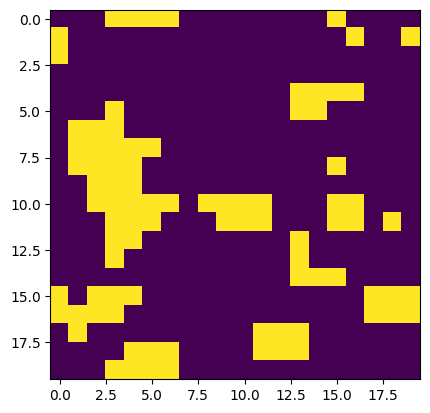

Step:34


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 81.55it/s, 7 steps of size 4.55e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.86      0.12      0.89      0.68      1.00    351.64      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    350.47      1.00
   k_scale      0.04      0.01      0.04      0.02      0.06    404.98      1.00
     noise      0.02      0.02      0.02      0.00      0.05    220.96      1.00



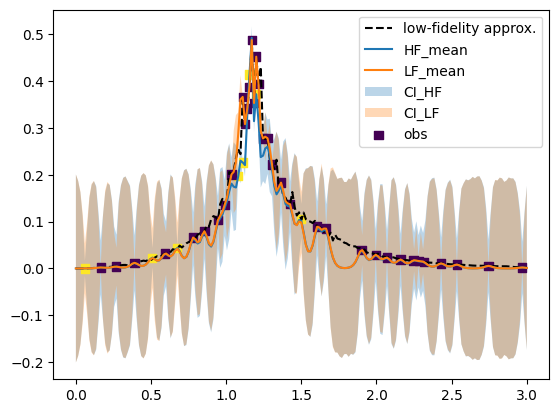

(402,)


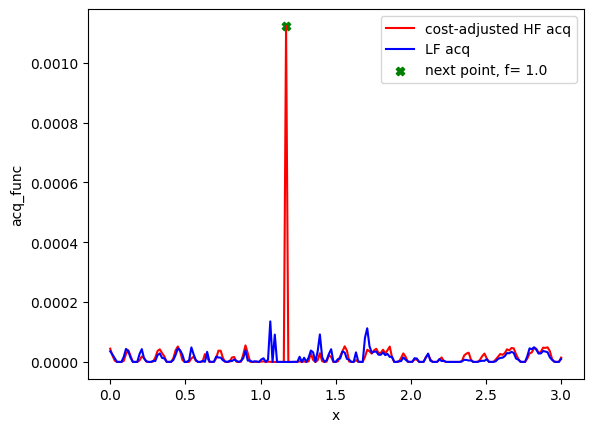

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77 278  74 275  78 279]
[1.17 1.  ] 1.17
Evaluation 44 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:35<00:00,  3.21it/s]

Completed. Saving
Time (s) to complete simulation 35: 217.46321749687195


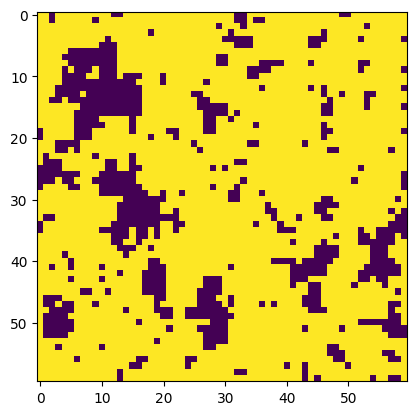

Step:35


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 83.27it/s, 15 steps of size 4.05e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.93      0.06      0.95      0.84      1.00    373.97      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    470.59      1.00
   k_scale      0.09      0.02      0.09      0.06      0.13    365.55      1.00
     noise      0.02      0.02      0.02      0.00      0.05    221.50      1.00



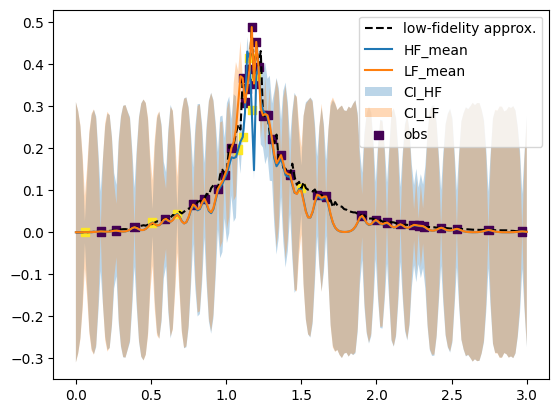

(402,)


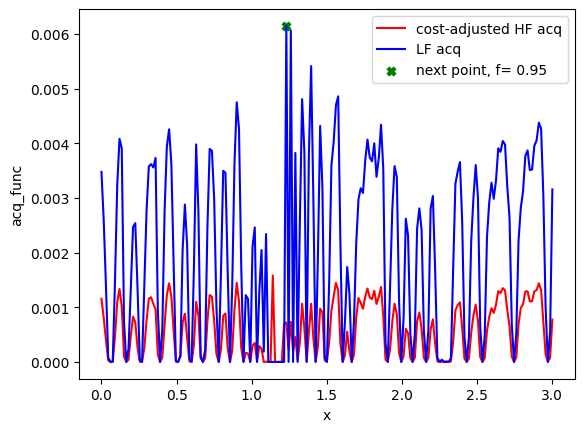

[ 81  80 273  79 281 107  26 198  69  63 133  95  66  11  91  87  85 183
 169  83  57 111 144  52 162 138  75  76  77 278  74 275  78 279  82]
[1.23 0.95] 1.23
Evaluation 45 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.09it/s]


Completed. Saving
Time (s) to complete simulation 36: 24.474791765213013


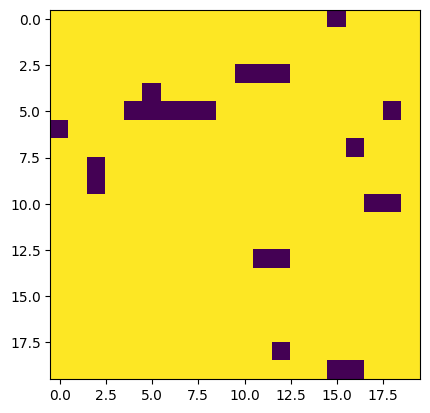

In [ ]:
N = 35
cost_ratio = 8.6/1 #time complexities
f = np.array([1.0, 2.0])
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_lf, X_test_hf))
X_test_full = np.vstack((X_test_lf, X_test_hf))
X_test_norm = np.vstack((X_test_lf, X_test_hf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.plot(xs, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

#Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 84.68it/s, 7 steps of size 4.81e-01. acc. prob=0.94] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.93      0.06      0.95      0.84      1.00    423.00      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    491.00      1.00
   k_scale      0.10      0.03      0.10      0.06      0.14    426.19      1.00
     noise      0.02      0.02      0.02      0.00      0.05    264.45      1.00



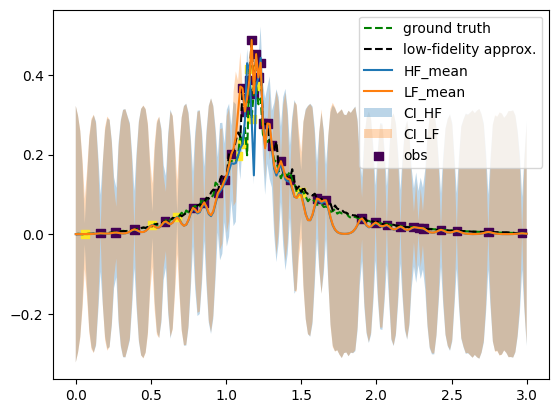

In [ ]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, true_ys_sq, "g--", label="ground truth")
plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")


plt.legend(loc="best")
#plt.ylim((-0.1, 0.5))
plt.show()

In [ ]:
train_x_full

array([[2.31396193, 0.95      ],
       [0.06225585, 1.        ],
       [1.9009447 , 0.95      ],
       [2.24641165, 0.95      ],
       [1.49552104, 1.        ],
       [0.67438994, 1.        ],
       [0.59418859, 0.95      ],
       [2.28159214, 0.95      ],
       [0.50733251, 1.        ],
       [0.26501944, 0.95      ],
       [1.215     , 0.95      ],
       [1.2       , 0.95      ],
       [1.08      , 1.        ],
       [1.185     , 0.95      ],
       [1.2       , 1.        ],
       [1.605     , 0.95      ],
       [0.39      , 0.95      ],
       [2.97      , 0.95      ],
       [1.035     , 0.95      ],
       [0.945     , 0.95      ],
       [1.995     , 0.95      ],
       [1.425     , 0.95      ],
       [0.99      , 0.95      ],
       [0.165     , 0.95      ],
       [1.365     , 0.95      ],
       [1.305     , 0.95      ],
       [1.275     , 0.95      ],
       [2.745     , 0.95      ],
       [2.535     , 0.95      ],
       [1.245     , 0.95      ],
       [0.

0.0008781281811919311


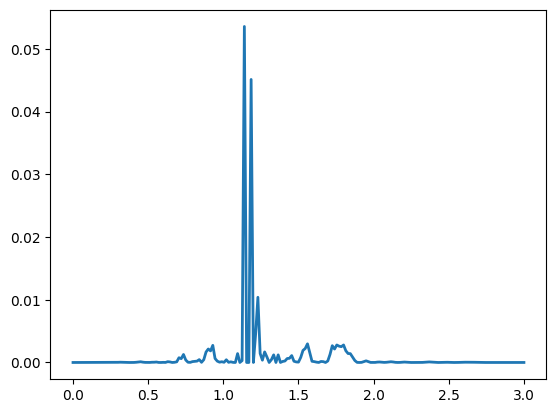

In [ ]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)


# Multi-fidelity BO

Considering triangle low and square high fid models -- Wrong low-fidelity model

In [ ]:
n = 10

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]))

<ipython-input-48-e92e699ff3a4>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],
<ipython-input-48-e92e699ff3a4>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,Jx[i],0,Jx[i],0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:03<00:00,  7.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:17<00:00,  6.45it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 1: 141.1992826461792


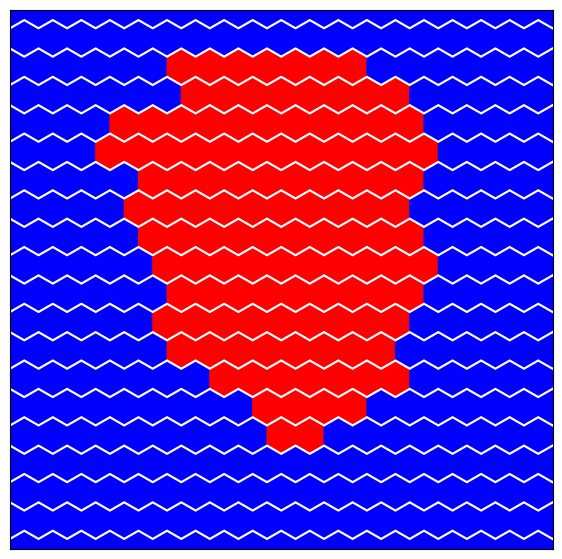

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [07:02<00:00,  1.18it/s]

Completed. Saving
Time (s) to complete simulation 2: 573.1174550056458


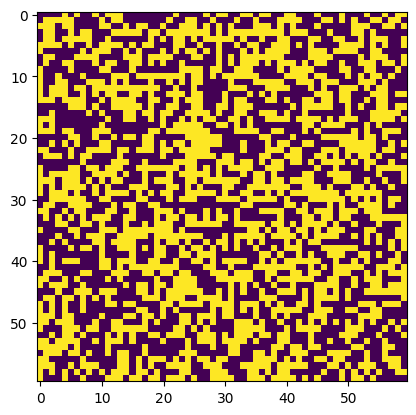

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:16<00:00,  6.54it/s]


Completed. Saving
Time (s) to complete simulation 3: 138.16474986076355


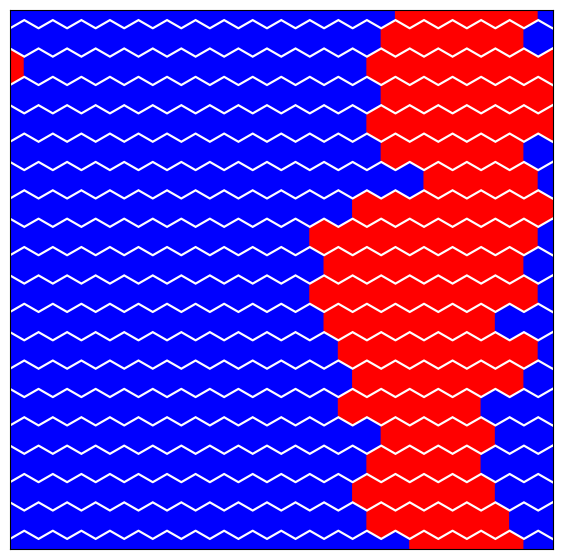

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:04<00:00,  7.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:15<00:00,  6.63it/s]


Completed. Saving
Time (s) to complete simulation 4: 139.48493218421936


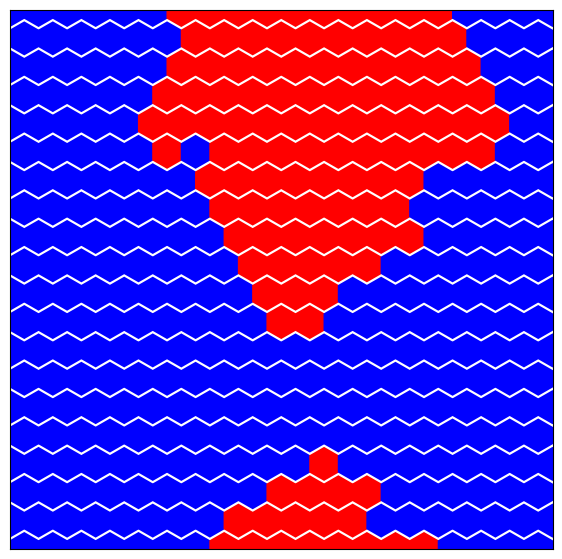

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:58<00:00,  1.19it/s]

Completed. Saving
Time (s) to complete simulation 5: 563.5380563735962


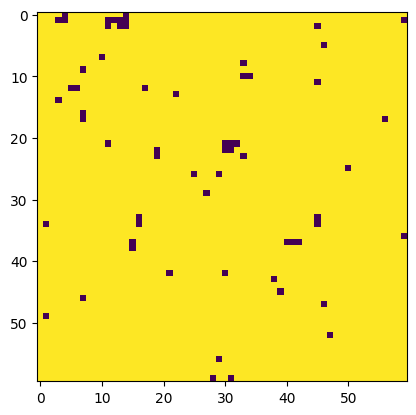

Evaluation 6 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:56<00:00,  1.20it/s]

Completed. Saving
Time (s) to complete simulation 6: 562.1274569034576


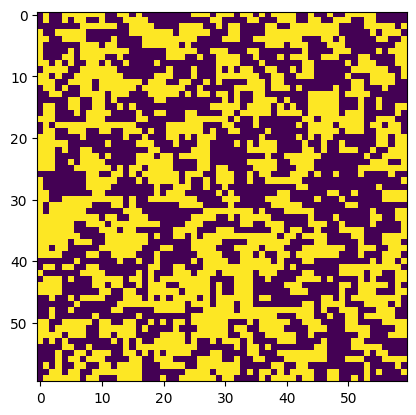

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:14<00:00,  6.72it/s]


Completed. Saving
Time (s) to complete simulation 7: 135.81001591682434


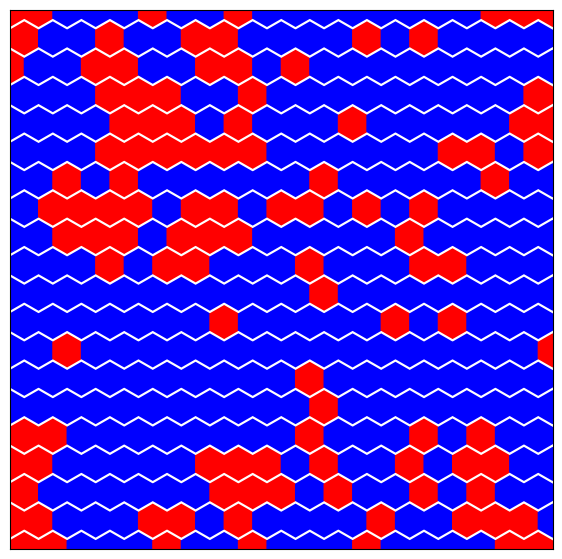

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:13<00:00,  6.80it/s]


Completed. Saving
Time (s) to complete simulation 8: 135.04268217086792


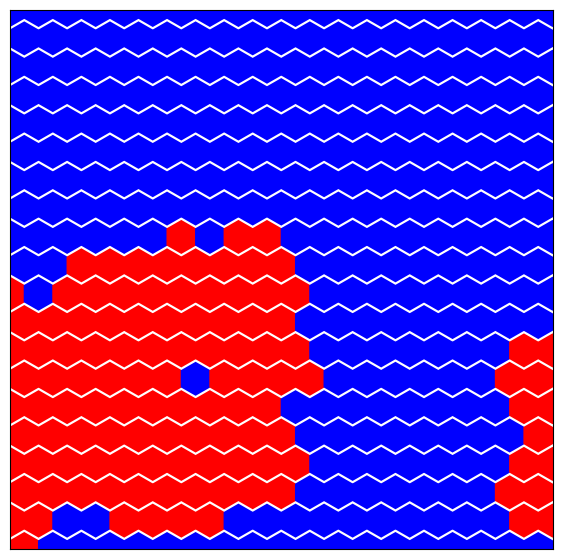

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [07:06<00:00,  1.17it/s]

Completed. Saving
Time (s) to complete simulation 9: 574.9564442634583


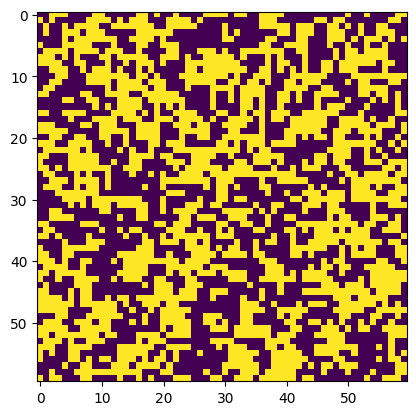

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:15<00:00,  6.65it/s]


Completed. Saving
Time (s) to complete simulation 10: 136.9127094745636


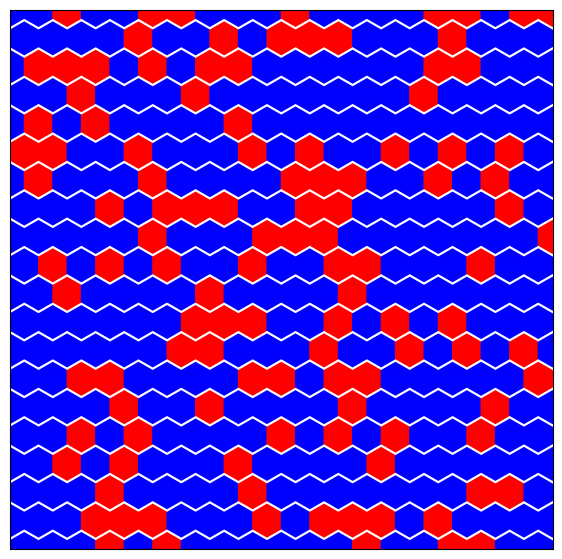

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        J_mat = np.array([[0,Jx[i],0,Jx[i],0],
                  [Jx[i],0,0,0,Jx[i]],
                  [0,Jx[i],0,Jx[i],0]])
        tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
        sq_sim = tri_sim

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    if train_x_full[i,1] == 1: #High fidelity
        plt.imshow(resultsBO_dict[i]['sim']['config'][-1])

    else: #Low fidelity
        sq_sim.plot_config(resultsBO_dict[i]['sim']['config'][-1])



    plt.show()

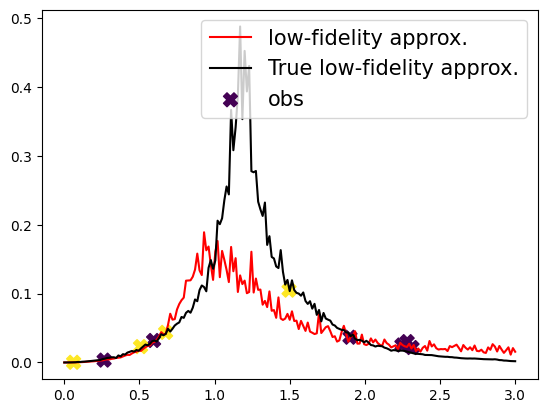

In [ ]:
plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")

plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

Run BO -25 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]),
 array([[0.02171349],
        [0.00025922],
        [0.03666318],
        [0.02538378],
        [0.10503485],
        [0.04375014],
        [0.03195398],
        [0.03032168],
        [0.02304033],
        [0.00343884]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:15<00:00, 65.33it/s, 7 steps of size 3.20e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.43      0.29      0.39      0.01      0.86    306.95      1.00
  k_length      0.12      0.08      0.10      0.05      0.17    158.86      1.02
   k_scale      0.02      0.02      0.02      0.01      0.04    297.78      1.00
     noise      0.03      0.02      0.02      0.00      0.05    282.38      1.00



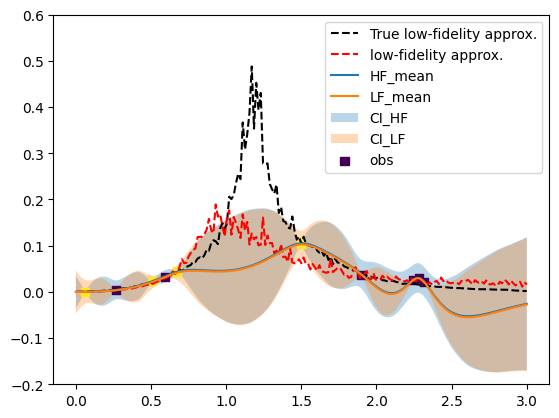

(402,)


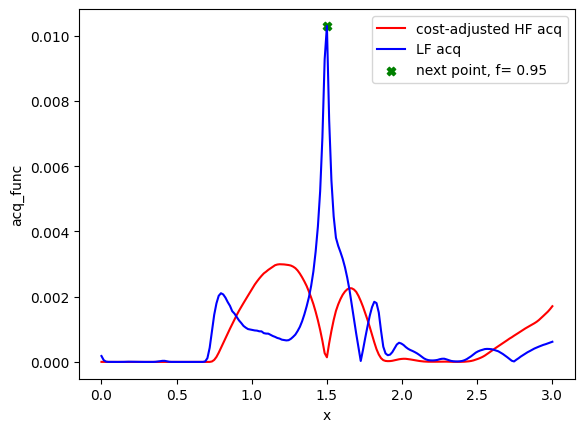

100
[1.5  0.95] 1.5
Evaluation 11 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 17.03it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 2: 54.46952199935913


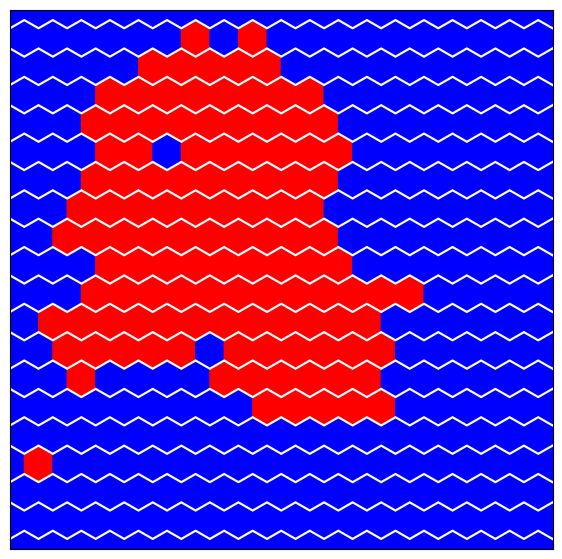

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:2


sample: 100%|██████████| 1000/1000 [00:16<00:00, 62.30it/s, 7 steps of size 4.01e-01. acc. prob=0.91] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.61      0.24      0.63      0.26      1.00    256.21      1.00
  k_length      0.15      0.16      0.10      0.03      0.27     48.99      1.02
   k_scale      0.03      0.04      0.02      0.01      0.05    258.67      1.00
     noise      0.02      0.02      0.02      0.00      0.05    427.88      1.00



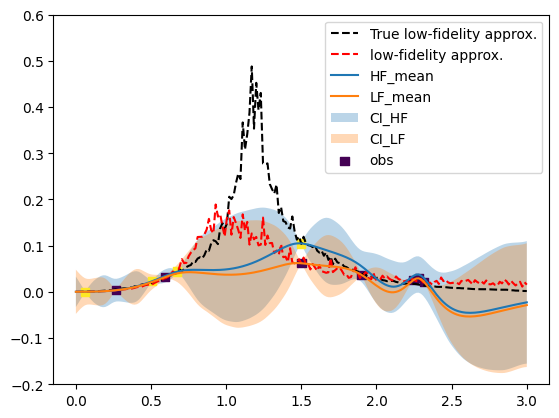

(402,)


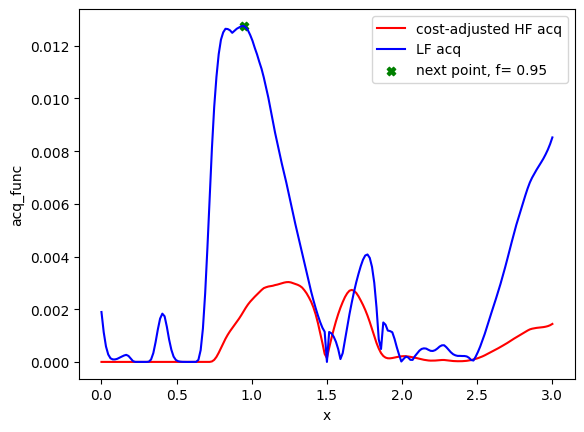

[100  63]
[0.945 0.95 ] 0.945
Evaluation 12 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.67it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 3: 55.74605917930603


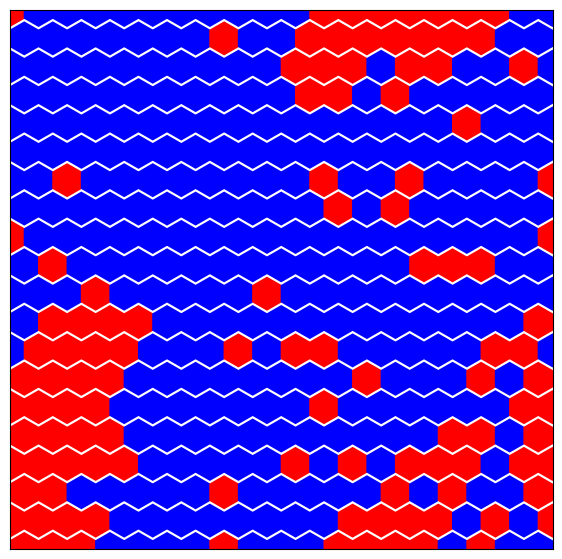

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:14<00:00, 70.49it/s, 7 steps of size 5.62e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.60      0.24      0.60      0.24      1.00    301.44      1.00
  k_length      0.11      0.04      0.10      0.05      0.16    370.33      1.00
   k_scale      0.03      0.03      0.02      0.01      0.05    349.58      1.00
     noise      0.03      0.02      0.02      0.00      0.05    364.12      1.00



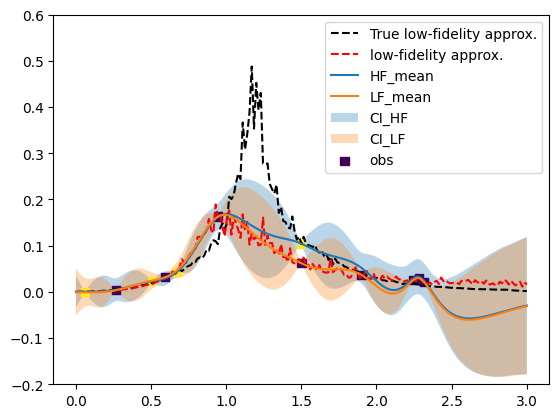

(402,)


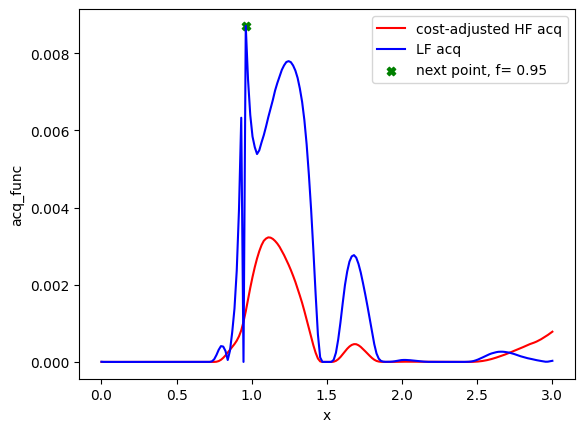

[100  63  64]
[0.96 0.95] 0.96
Evaluation 13 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.99it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 4: 54.651055574417114


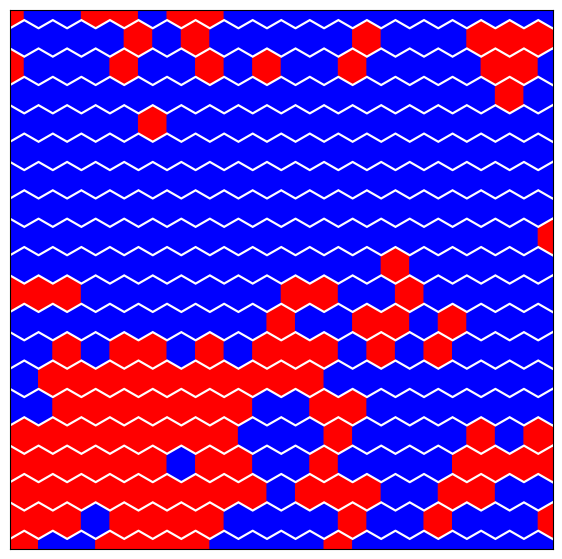

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:4


sample: 100%|██████████| 1000/1000 [00:15<00:00, 66.36it/s, 15 steps of size 5.09e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.58      0.24      0.59      0.19      0.95    272.60      1.00
  k_length      0.11      0.04      0.11      0.05      0.16    364.79      1.00
   k_scale      0.03      0.03      0.02      0.01      0.05    371.43      1.00
     noise      0.02      0.02      0.02      0.00      0.05    367.66      1.00



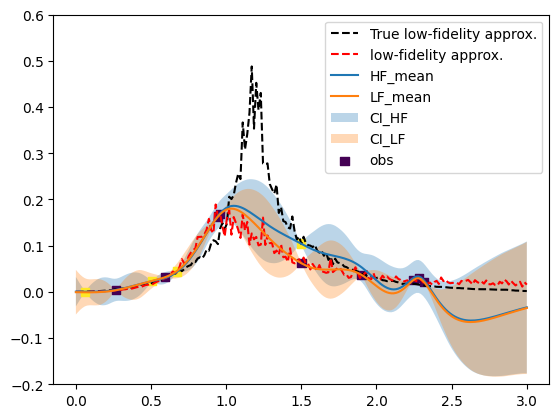

(402,)


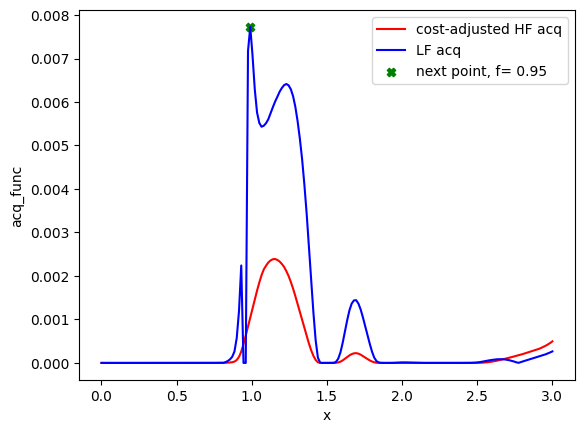

[100  63  64  66]
[0.99 0.95] 0.99
Evaluation 14 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.67it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 5: 55.48337125778198


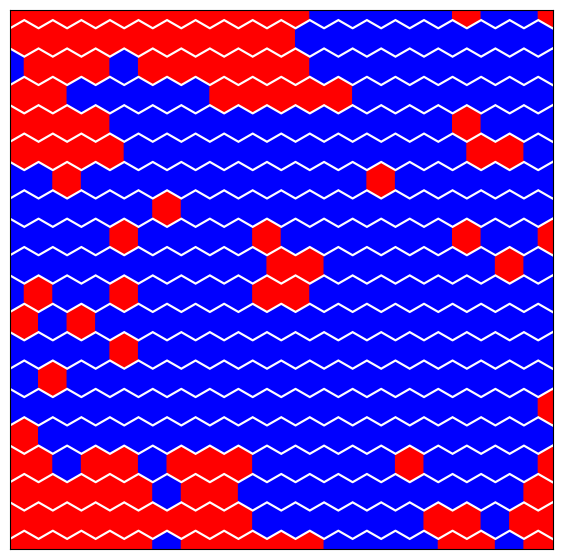

Step:5


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 59.01it/s, 7 steps of size 4.72e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.65      0.23      0.67      0.31      1.00    307.10      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    260.43      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    412.93      1.00
     noise      0.02      0.02      0.02      0.00      0.05    197.20      1.00



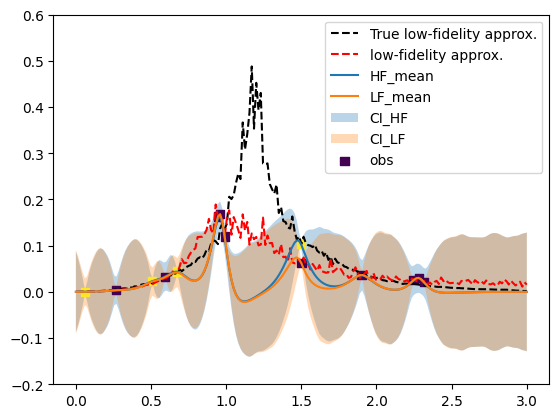

(402,)


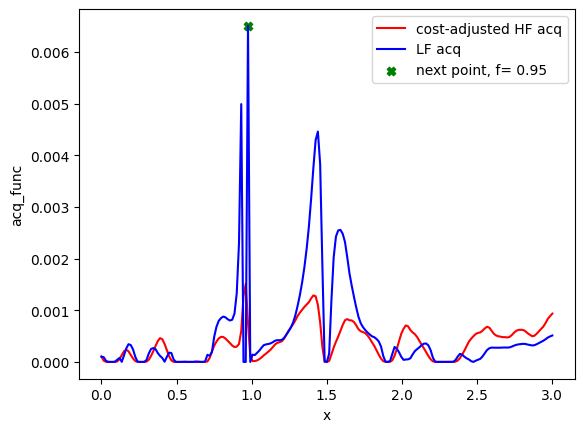

[100  63  64  66  65]
[0.975 0.95 ] 0.975
Evaluation 15 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 17.04it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 6: 54.95715928077698


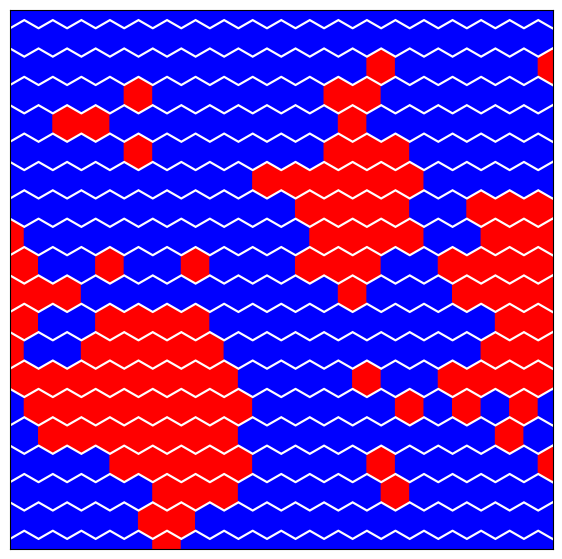

Step:6


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:17<00:00, 56.47it/s, 7 steps of size 4.40e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.63      0.23      0.64      0.31      1.00    323.03      1.00
  k_length      0.02      0.01      0.02      0.02      0.03    191.91      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    368.75      1.00
     noise      0.02      0.02      0.02      0.00      0.05    226.29      1.00



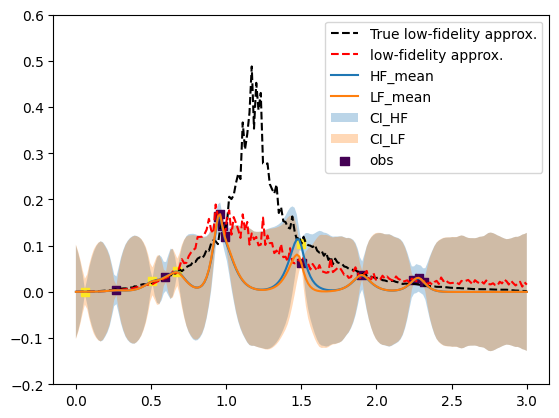

(402,)


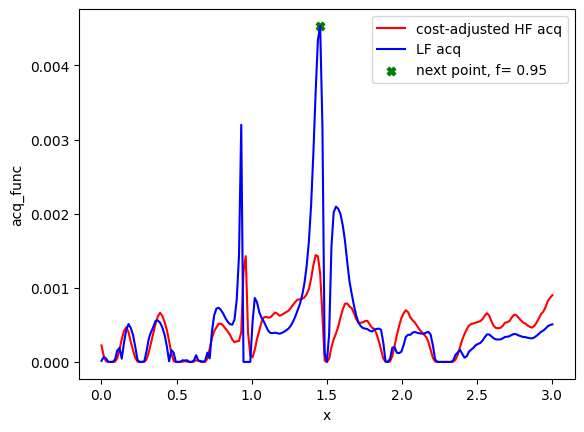

[100  63  64  66  65  97]
[1.455 0.95 ] 1.4549999999999998
Evaluation 16 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.80it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 7: 55.51350402832031


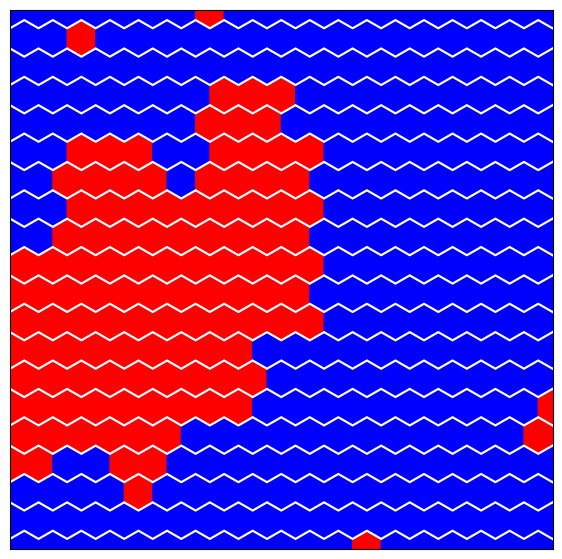

Step:7


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:10<00:00, 96.26it/s, 7 steps of size 4.72e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.64      0.23      0.67      0.30      1.00    313.70      1.00
  k_length      0.02      0.01      0.02      0.02      0.03    464.42      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    457.79      1.00
     noise      0.02      0.02      0.02      0.00      0.05    198.25      1.01



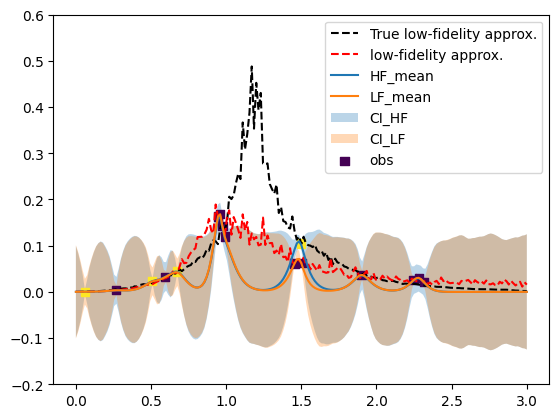

(402,)


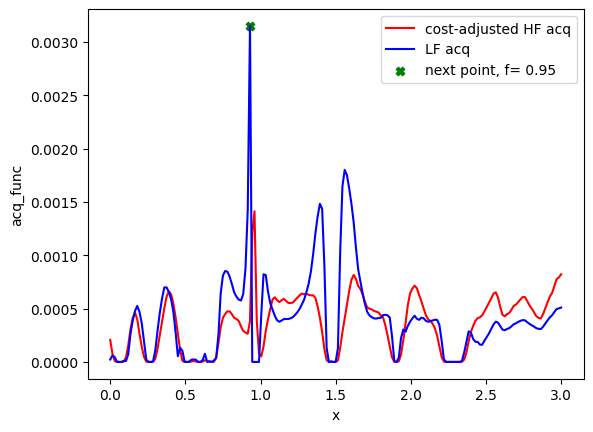

[100  63  64  66  65  97  62]
[0.93 0.95] 0.9299999999999999
Evaluation 17 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.83it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 8: 55.804622411727905


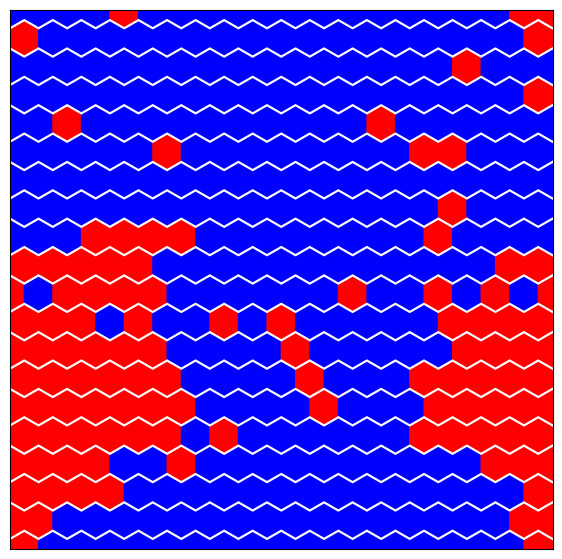

Step:8


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 48.00it/s, 7 steps of size 4.39e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.63      0.25      0.66      0.22      0.97    525.33      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    266.90      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    358.81      1.00
     noise      0.02      0.02      0.02      0.00      0.05    217.12      1.00



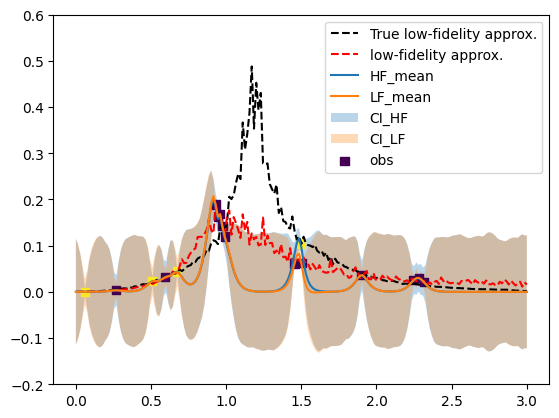

(402,)


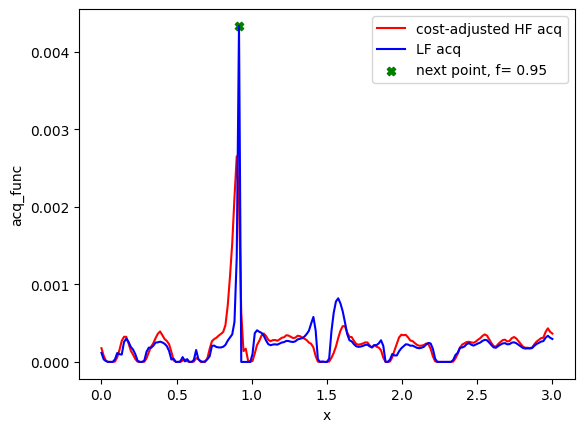

[100  63  64  66  65  97  62  61]
[0.915 0.95 ] 0.9149999999999999
Evaluation 18 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.53it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 9: 55.91691040992737


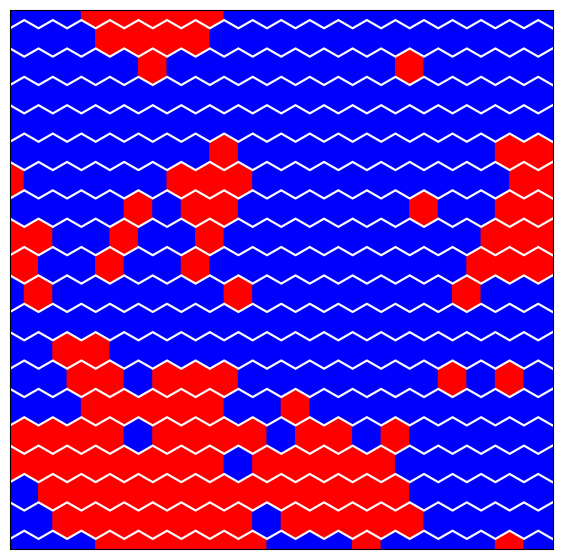

Step:9


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:23<00:00, 41.96it/s, 7 steps of size 4.32e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.58      0.25      0.60      0.22      1.00    418.59      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    288.28      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    295.32      1.00
     noise      0.02      0.02      0.02      0.00      0.05    290.65      1.00



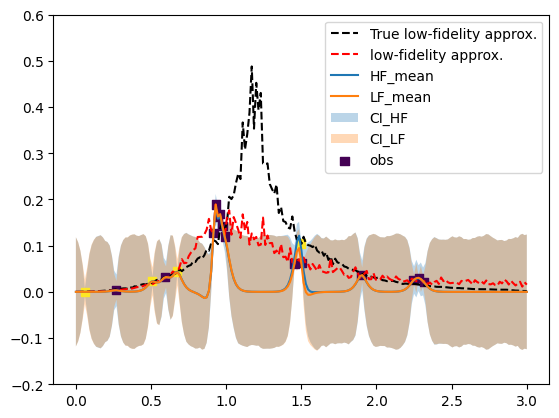

(402,)


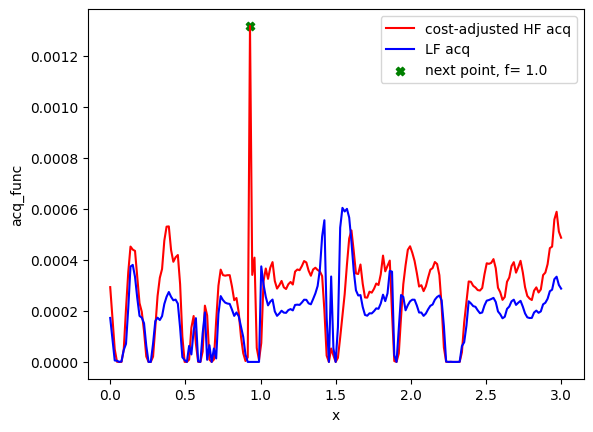

[100  63  64  66  65  97  62  61 263]
[0.93 1.  ] 0.9299999999999999
Evaluation 19 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:35<00:00,  3.22it/s]

Completed. Saving
Time (s) to complete simulation 10: 216.54056191444397


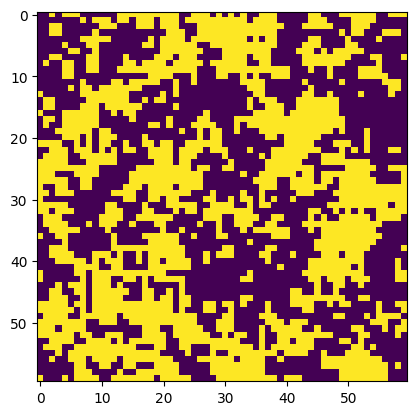

Step:10


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:23<00:00, 43.35it/s, 7 steps of size 4.67e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.18      0.79      0.47      1.00    311.98      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    156.50      1.03
   k_scale      0.02      0.01      0.01      0.01      0.02    248.75      1.02
     noise      0.02      0.02      0.02      0.00      0.05    266.87      1.00



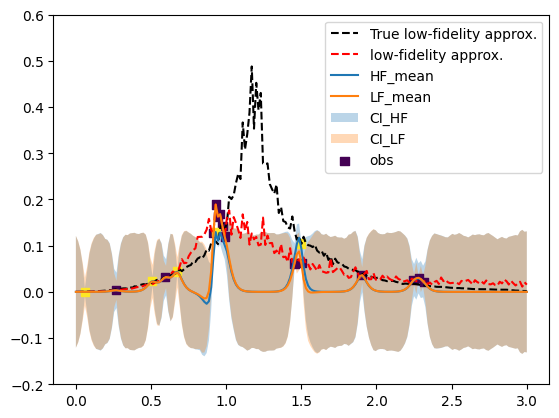

(402,)


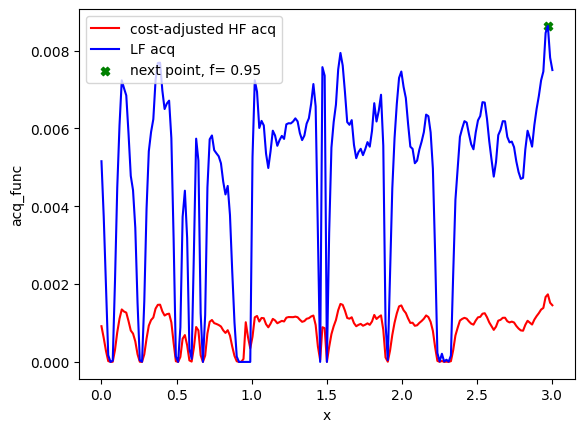

[100  63  64  66  65  97  62  61 263 198]
[2.97 0.95] 2.9699999999999998
Evaluation 20 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.60it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 11: 55.9349148273468


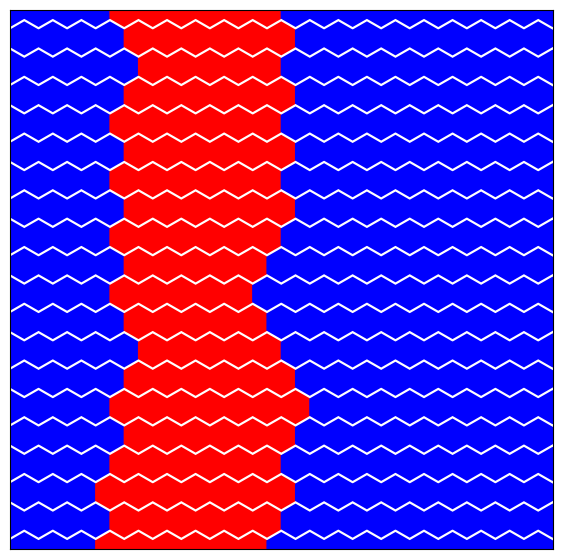

Step:11


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:23<00:00, 43.25it/s, 7 steps of size 4.38e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.73      0.18      0.76      0.46      1.00    344.79      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    167.10      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    373.29      1.00
     noise      0.02      0.02      0.02      0.00      0.05    398.68      1.00



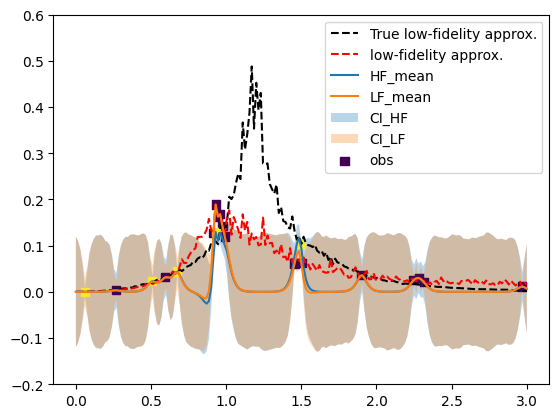

(402,)


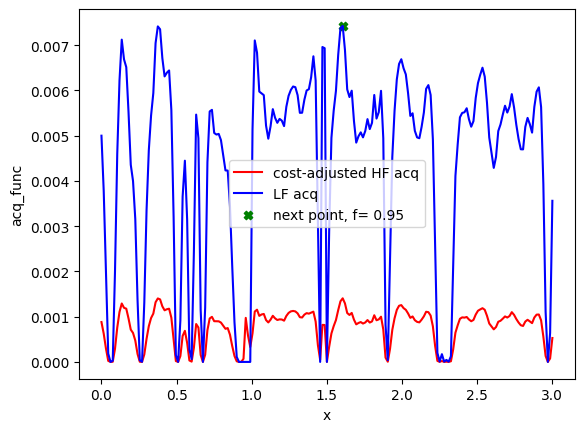

[100  63  64  66  65  97  62  61 263 198 107]
[1.605 0.95 ] 1.605
Evaluation 21 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.48it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 12: 56.23567056655884


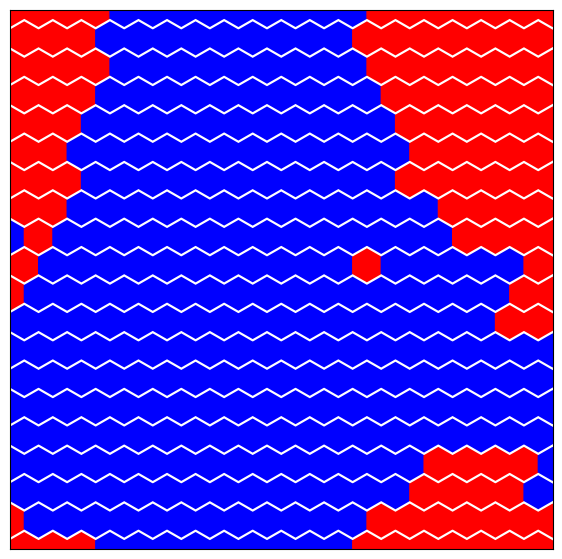

Step:12


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:29<00:00, 33.93it/s, 15 steps of size 4.07e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.17      0.78      0.50      1.00    319.03      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    233.95      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    331.66      1.00
     noise      0.02      0.02      0.02      0.00      0.05    189.91      1.00



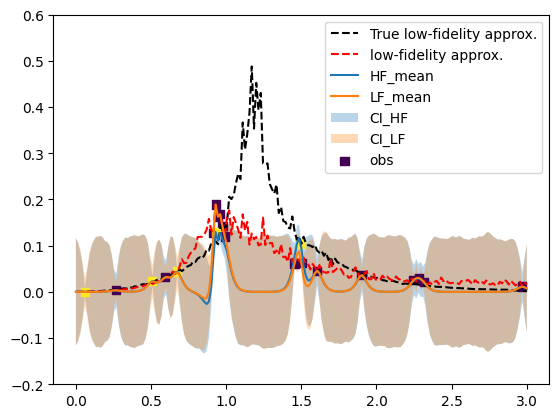

(402,)


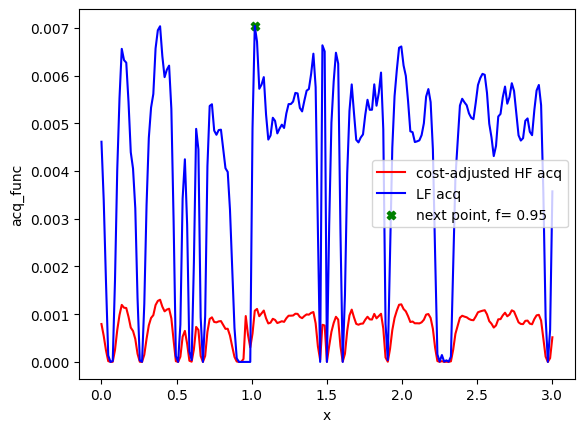

[100  63  64  66  65  97  62  61 263 198 107  68]
[1.02 0.95] 1.02
Evaluation 22 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.62it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 13: 55.969249963760376


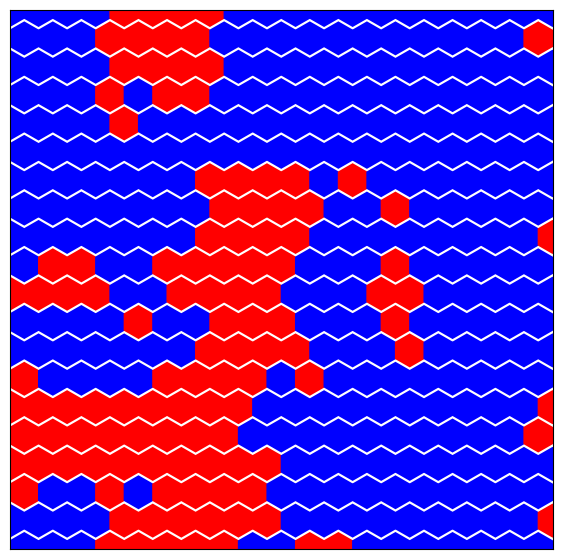

Step:13


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:28<00:00, 35.22it/s, 7 steps of size 4.32e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.18      0.78      0.48      1.00    300.69      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    274.79      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    262.35      1.00
     noise      0.02      0.02      0.02      0.00      0.05    242.53      1.00



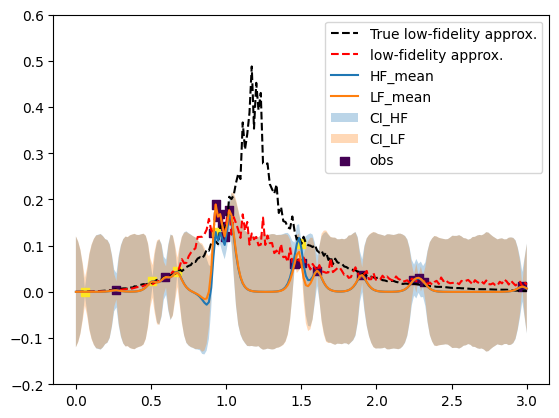

(402,)


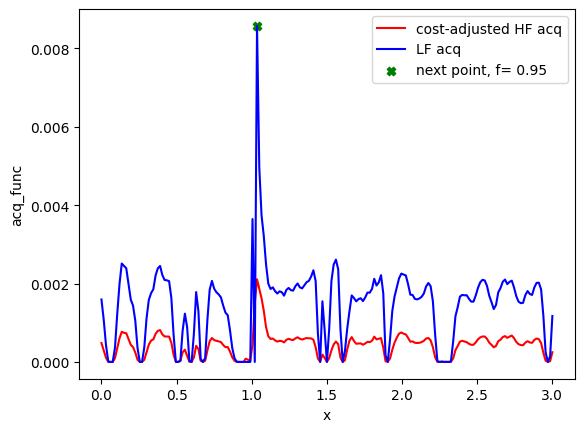

[100  63  64  66  65  97  62  61 263 198 107  68  69]
[1.035 0.95 ] 1.035
Evaluation 23 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.37it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 14: 56.509307622909546


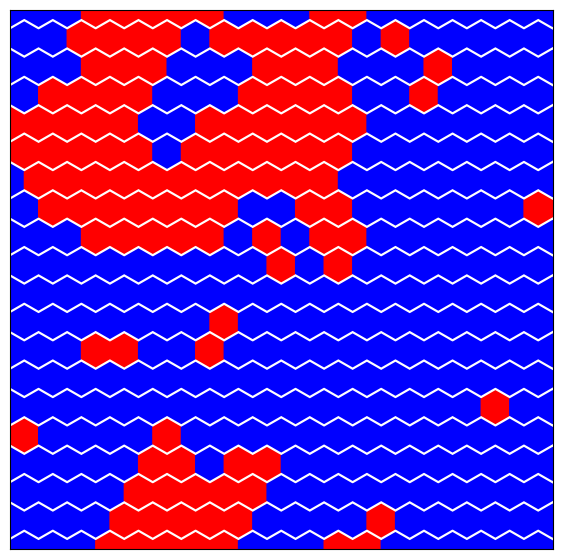

Step:14


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:29<00:00, 33.51it/s, 7 steps of size 4.00e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.17      0.78      0.50      1.00    341.18      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    254.46      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    380.88      1.00
     noise      0.02      0.02      0.02      0.00      0.05    290.63      1.00



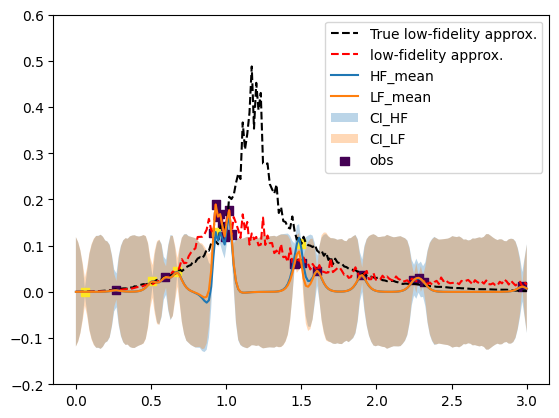

(402,)


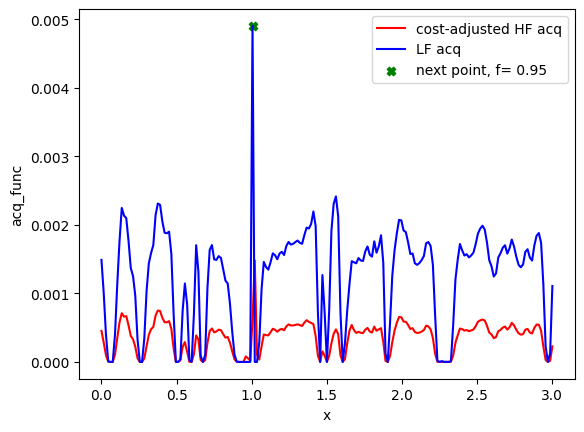

[100  63  64  66  65  97  62  61 263 198 107  68  69  67]
[1.005 0.95 ] 1.005
Evaluation 24 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.81it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 15: 55.269299268722534


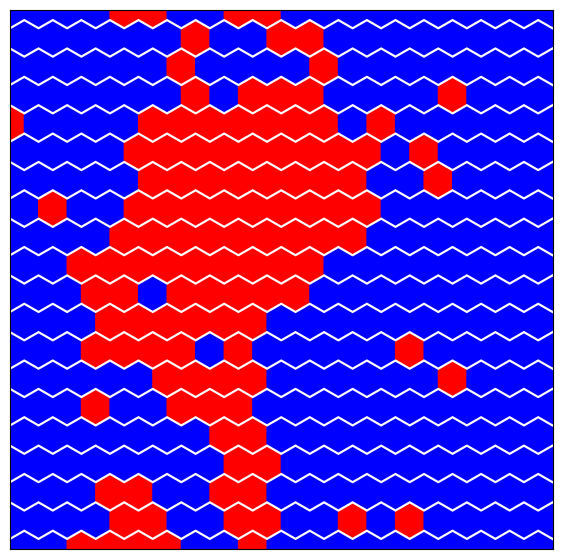

Step:15


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:35<00:00, 28.03it/s, 7 steps of size 3.76e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.74      0.18      0.77      0.49      1.00    314.06      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    242.28      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    378.77      1.00
     noise      0.02      0.02      0.02      0.00      0.05    141.61      1.00



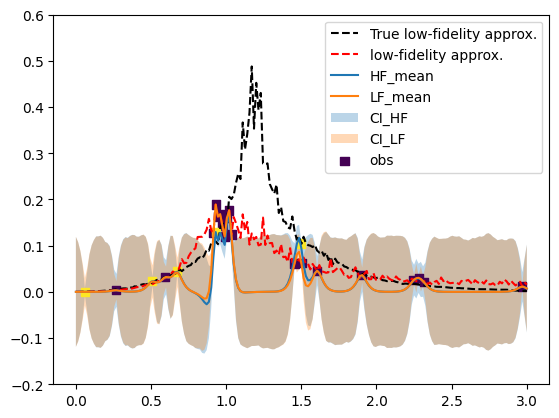

(402,)


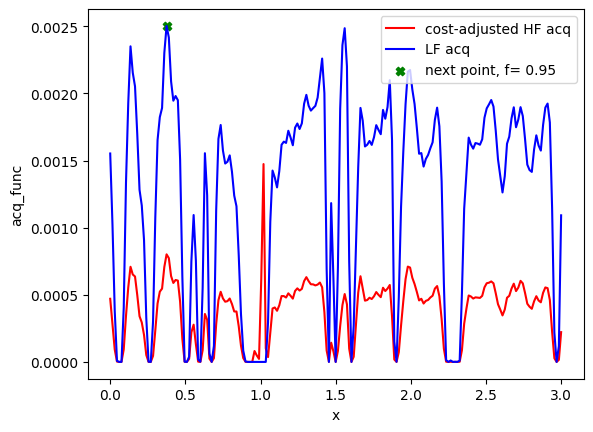

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25]
[0.375 0.95 ] 0.375
Evaluation 25 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.47it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 16: 55.90147256851196


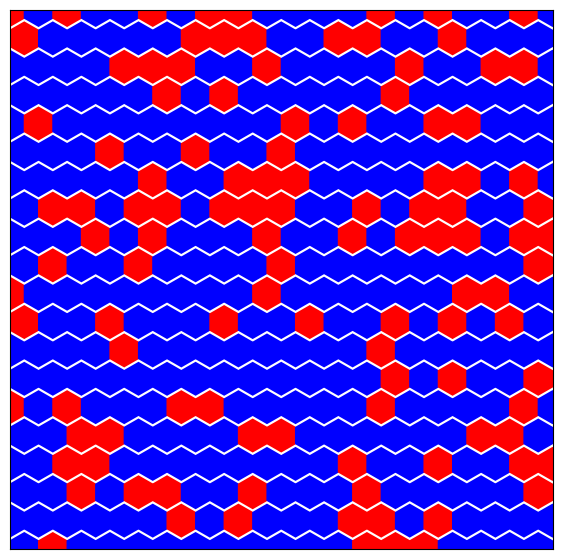

Step:16


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:36<00:00, 27.33it/s, 7 steps of size 3.20e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.17      0.77      0.49      1.00    330.94      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    229.46      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    356.78      1.00
     noise      0.02      0.02      0.02      0.00      0.05    123.26      1.01



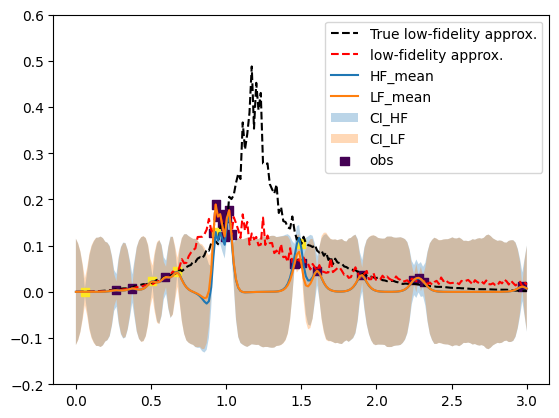

(402,)


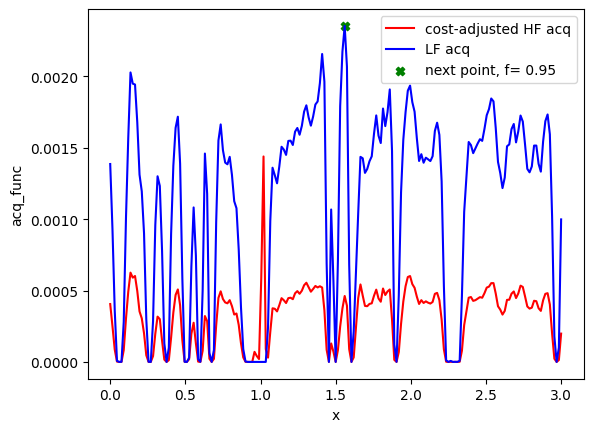

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104]
[1.56 0.95] 1.56
Evaluation 26 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.62it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 17: 55.84346294403076


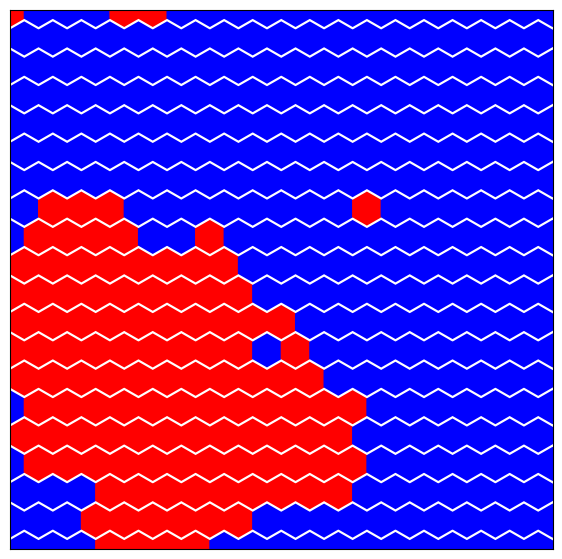

Step:17


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:35<00:00, 27.85it/s, 7 steps of size 4.17e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.79      0.52      1.00    370.37      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    199.50      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    372.26      1.00
     noise      0.02      0.02      0.02      0.00      0.05    260.80      1.00



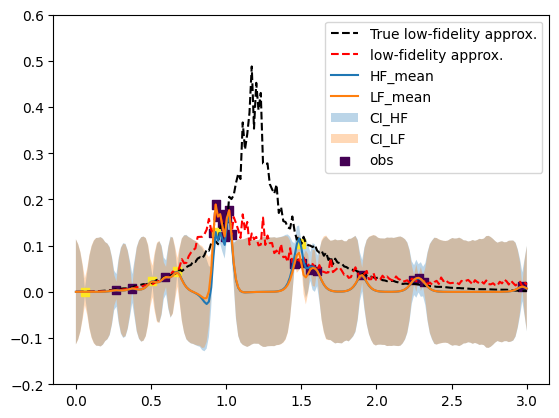

(402,)


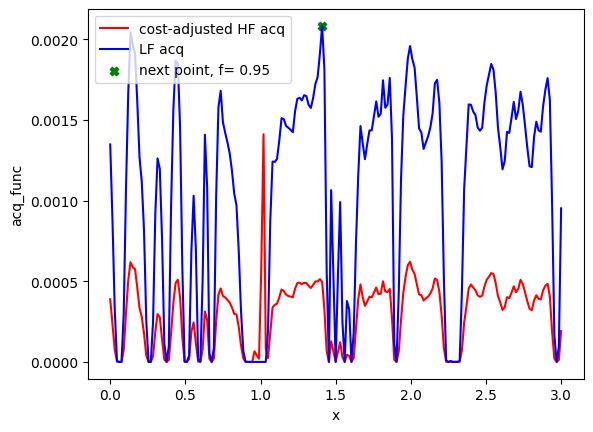

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94]
[1.41 0.95] 1.41
Evaluation 27 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.40it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 18: 57.27765107154846


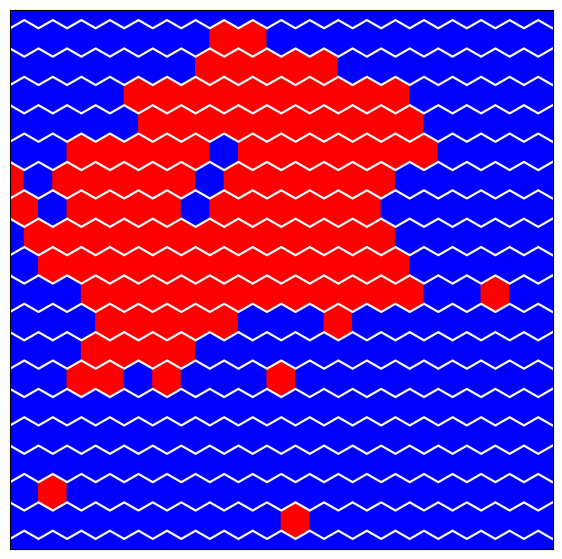

Step:18


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:40<00:00, 24.69it/s, 7 steps of size 3.39e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.78      0.51      1.00    285.03      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    249.91      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    339.66      1.00
     noise      0.02      0.02      0.02      0.00      0.05    201.12      1.01



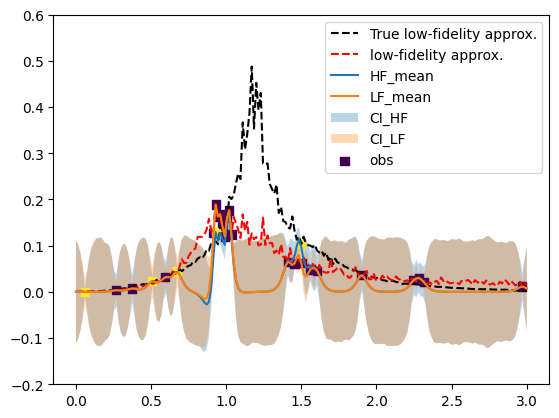

(402,)


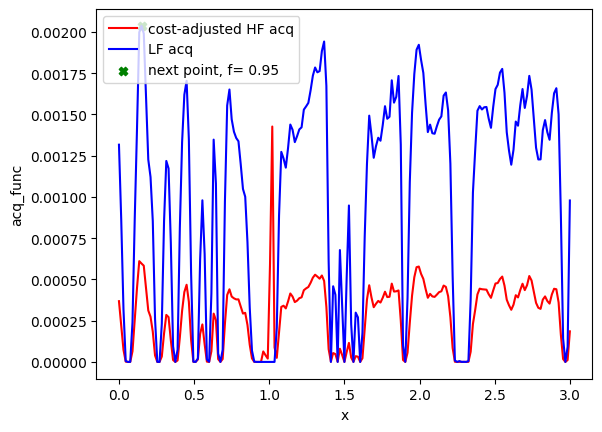

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10]
[0.15 0.95] 0.15
Evaluation 28 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.48it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 19: 56.077516078948975


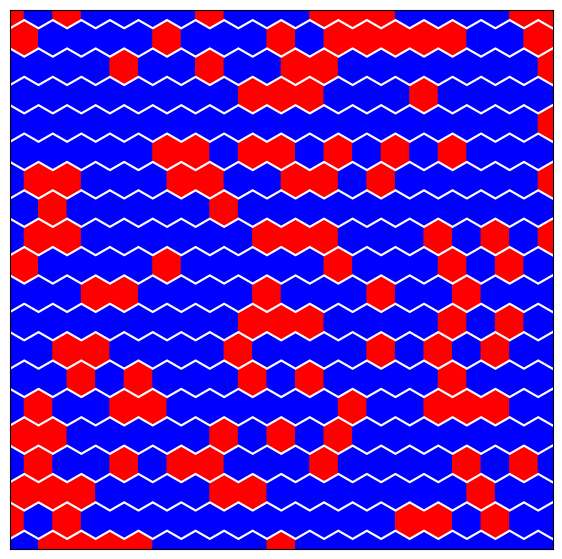

Step:19


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:36<00:00, 27.42it/s, 7 steps of size 4.81e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.79      0.52      1.00    427.76      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    217.70      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    403.85      1.00
     noise      0.02      0.02      0.02      0.00      0.05    264.87      1.01



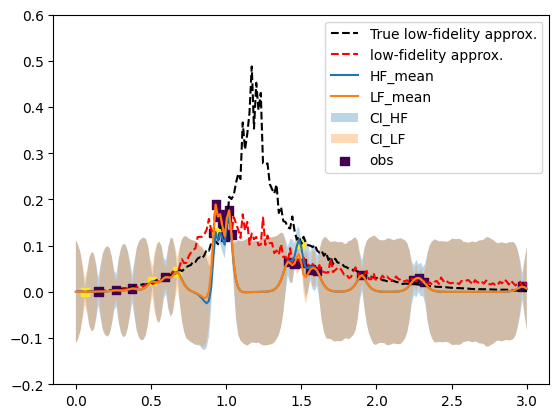

(402,)


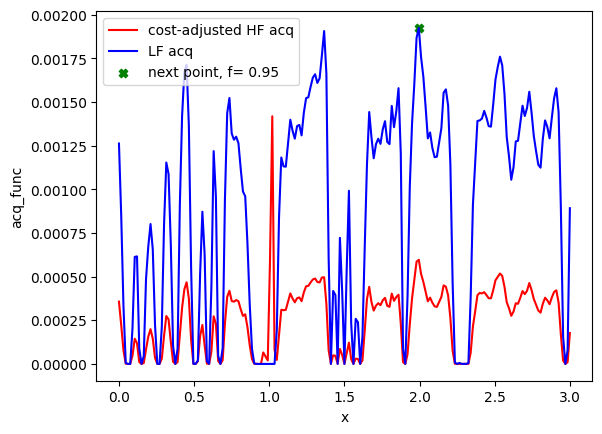

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133]
[1.995 0.95 ] 1.9949999999999999
Evaluation 29 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.34it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 20: 56.47746396064758


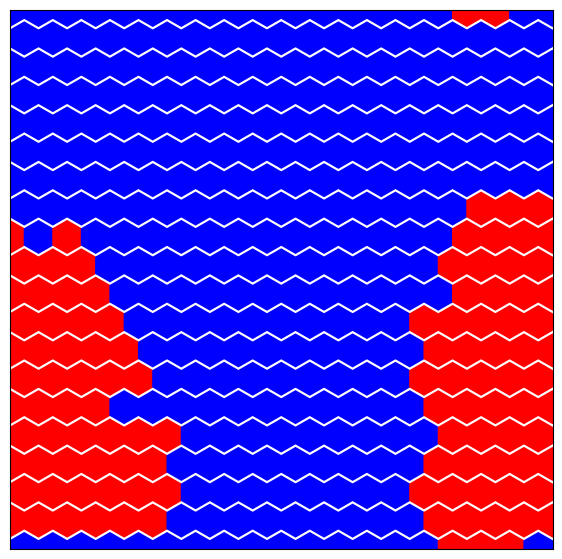

Step:20


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:42<00:00, 23.41it/s, 7 steps of size 3.24e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.80      0.51      1.00    266.23      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    198.66      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    330.85      1.00
     noise      0.02      0.02      0.02      0.00      0.05    354.66      1.01



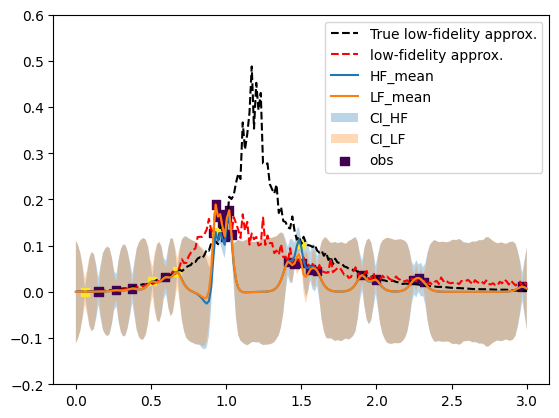

(402,)


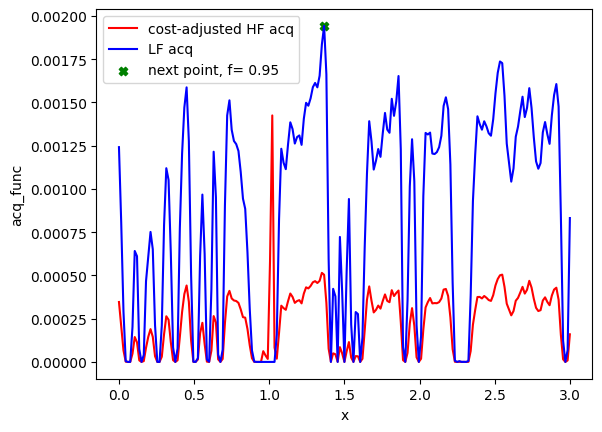

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91]
[1.365 0.95 ] 1.365
Evaluation 30 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.51it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 21: 56.24829292297363


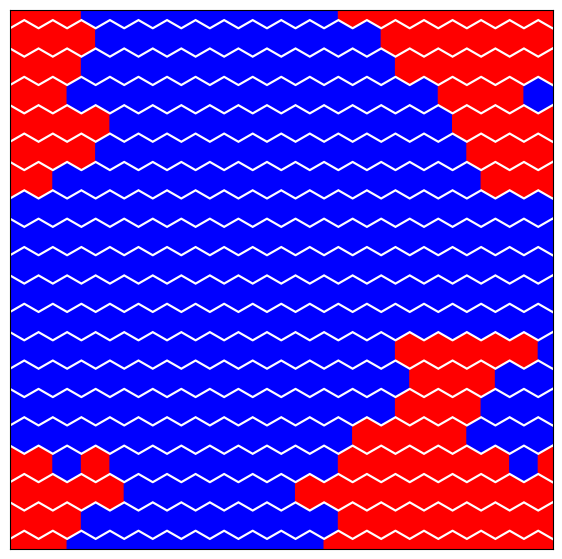

Step:21


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:42<00:00, 23.42it/s, 7 steps of size 4.27e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.81      0.52      1.00    401.49      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    219.29      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    420.33      1.00
     noise      0.02      0.02      0.02      0.00      0.05    280.25      1.00



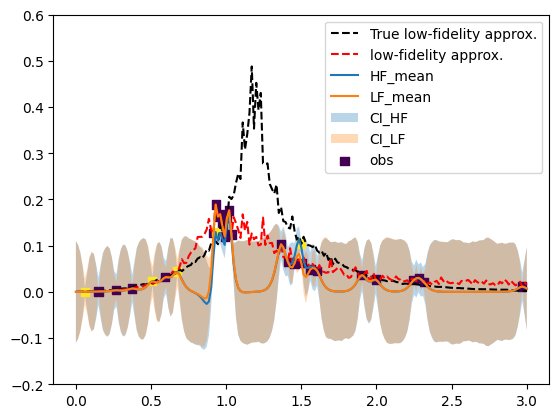

(402,)


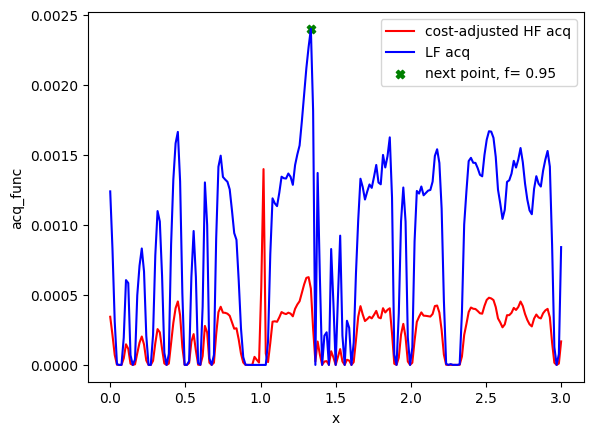

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89]
[1.335 0.95 ] 1.335
Evaluation 31 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.59it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 22: 55.909751176834106


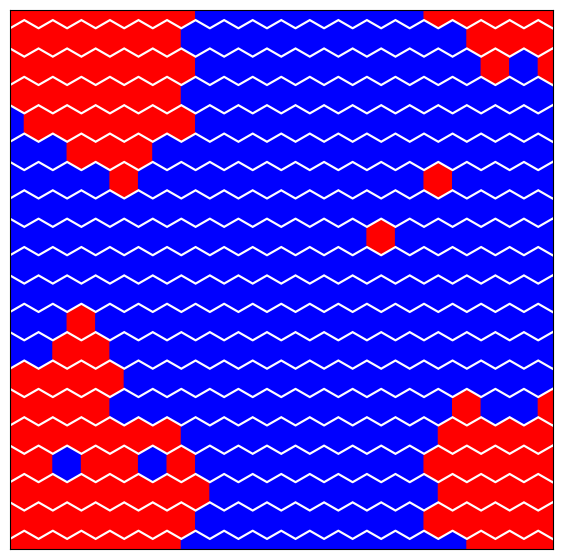

Step:22


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:47<00:00, 20.90it/s, 7 steps of size 3.20e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.80      0.52      1.00    381.86      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    269.89      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    361.50      1.00
     noise      0.02      0.02      0.02      0.00      0.05    256.71      1.00



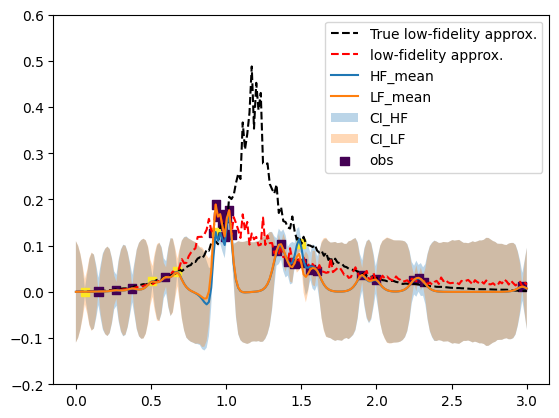

(402,)


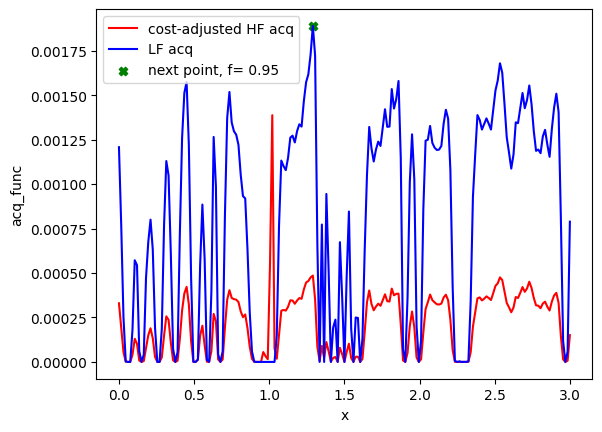

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86]
[1.29 0.95] 1.29
Evaluation 32 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.45it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 23: 56.4287211894989


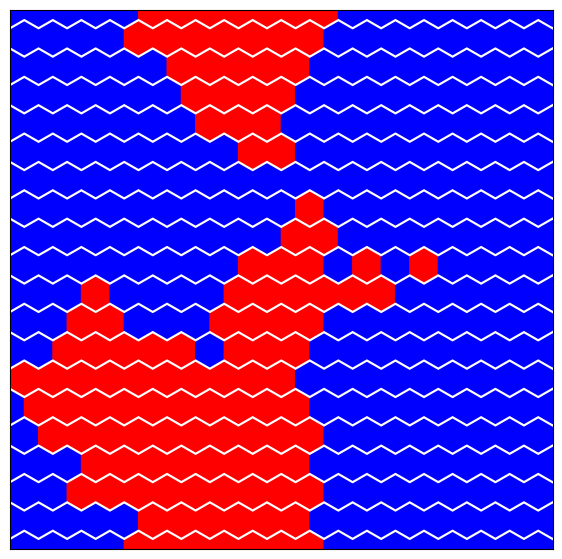

Step:23


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:11<00:00, 83.37it/s, 7 steps of size 4.32e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.80      0.52      1.00    284.38      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    225.65      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    429.65      1.00
     noise      0.02      0.02      0.02      0.00      0.05    225.02      1.00



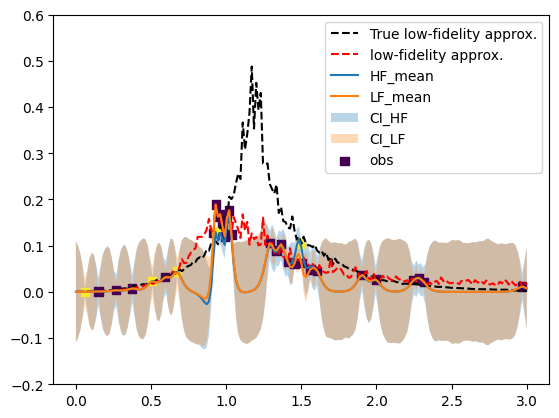

(402,)


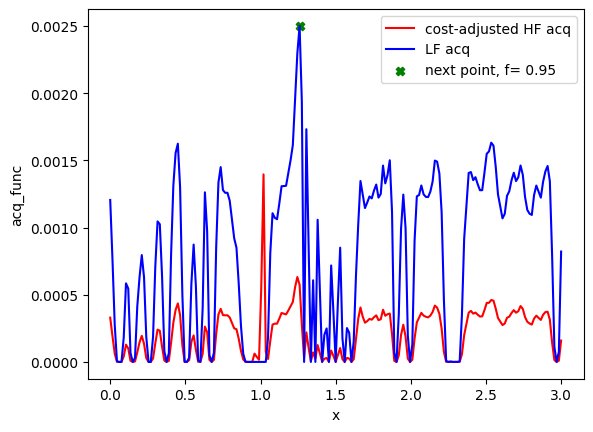

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84]
[1.26 0.95] 1.26
Evaluation 33 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.74it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 24: 55.49926137924194


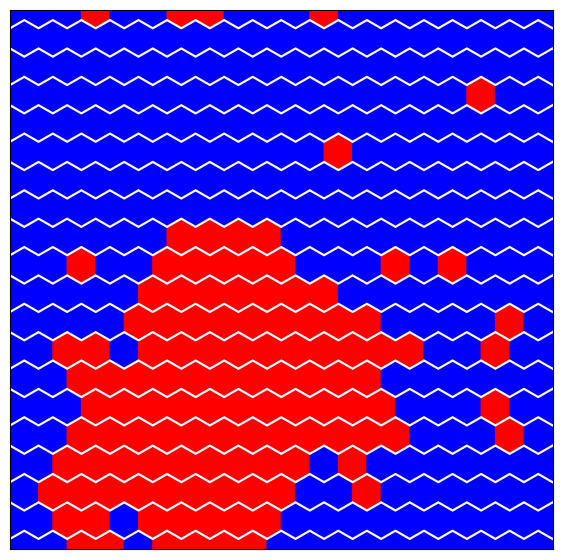

Step:24


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 80.85it/s, 7 steps of size 4.26e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.80      0.53      1.00    331.25      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    297.41      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    406.31      1.00
     noise      0.02      0.02      0.02      0.00      0.05    295.15      1.01



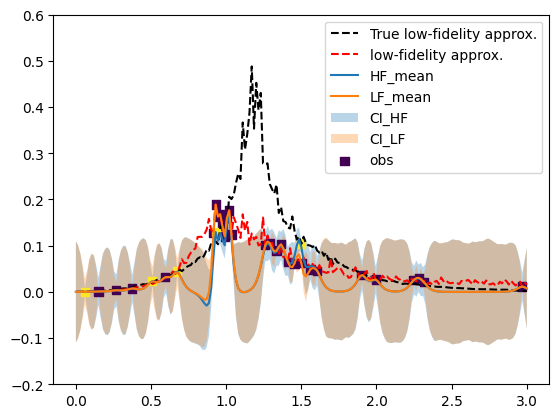

(402,)


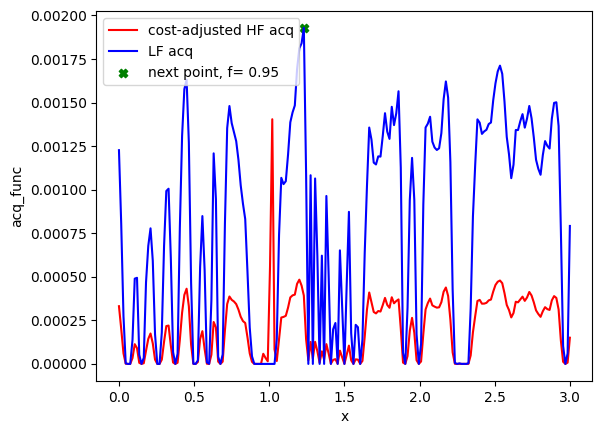

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82]
[1.23 0.95] 1.23
Evaluation 34 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.28it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 25: 56.97534704208374


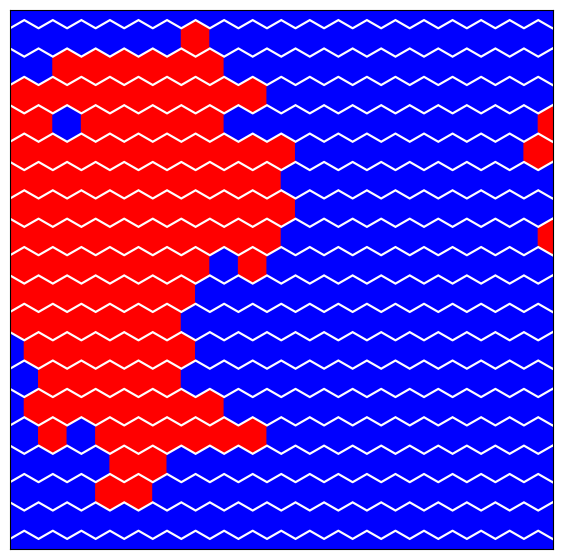

Step:25


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 80.22it/s, 7 steps of size 4.75e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.80      0.53      1.00    384.10      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    202.09      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    415.32      1.01
     noise      0.02      0.02      0.02      0.00      0.05    220.42      1.00



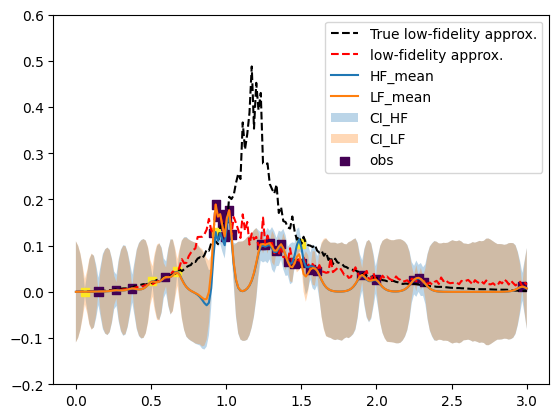

(402,)


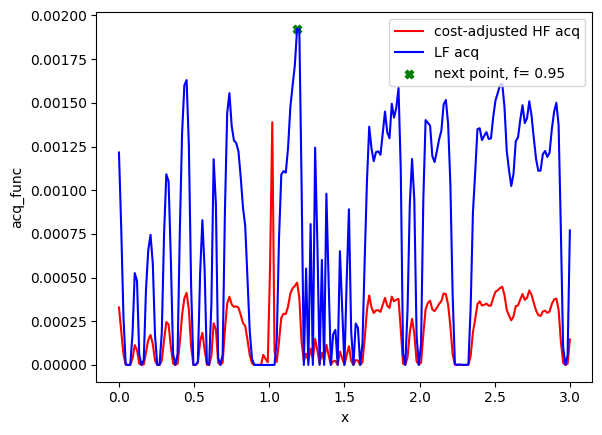

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79]
[1.185 0.95 ] 1.185
Evaluation 35 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.23it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 26: 57.41629195213318


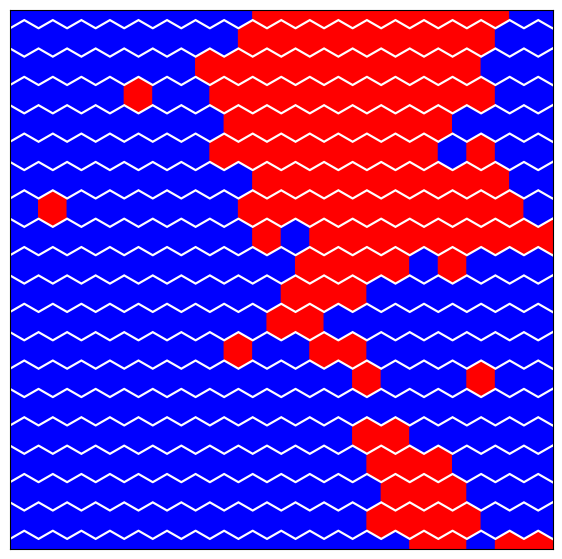

Step:26


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:13<00:00, 76.51it/s, 7 steps of size 3.95e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.81      0.51      1.00    329.04      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    347.20      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    399.99      1.00
     noise      0.02      0.02      0.02      0.00      0.05    214.15      1.01



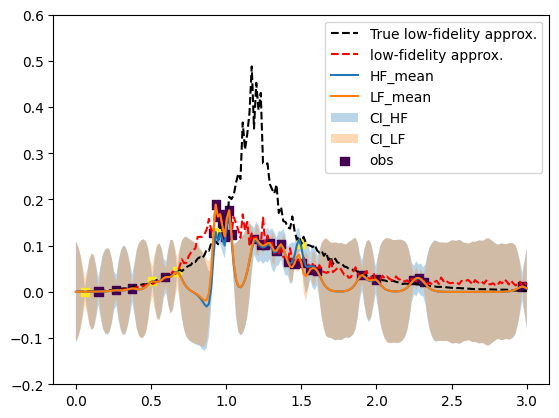

(402,)


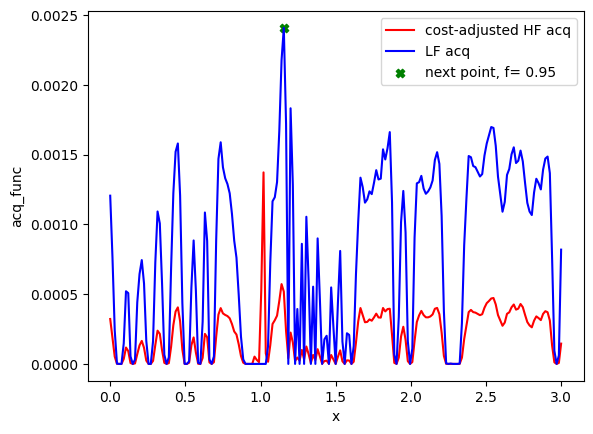

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77]
[1.155 0.95 ] 1.155
Evaluation 36 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.41it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 27: 56.86791157722473


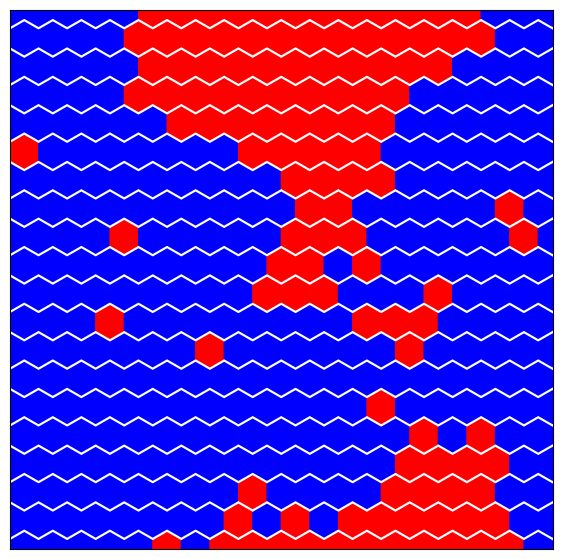

Step:27


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:13<00:00, 73.94it/s, 7 steps of size 4.05e-01. acc. prob=0.93] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.78      0.52      1.00    249.11      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    222.68      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    390.65      1.00
     noise      0.02      0.02      0.02      0.00      0.05    233.96      1.00



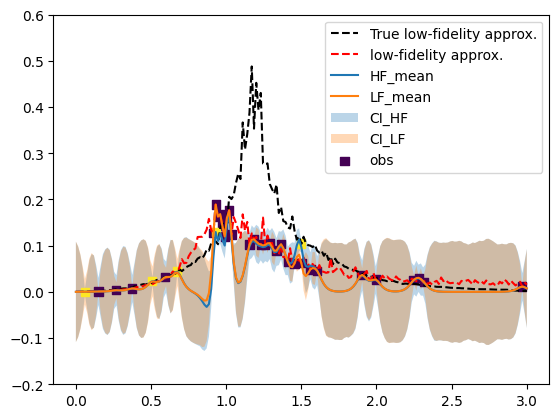

(402,)


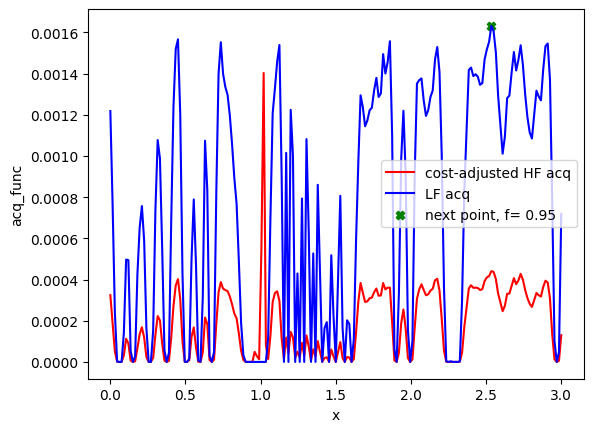

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169]
[2.535 0.95 ] 2.5349999999999997
Evaluation 37 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.58it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 28: 56.02434039115906


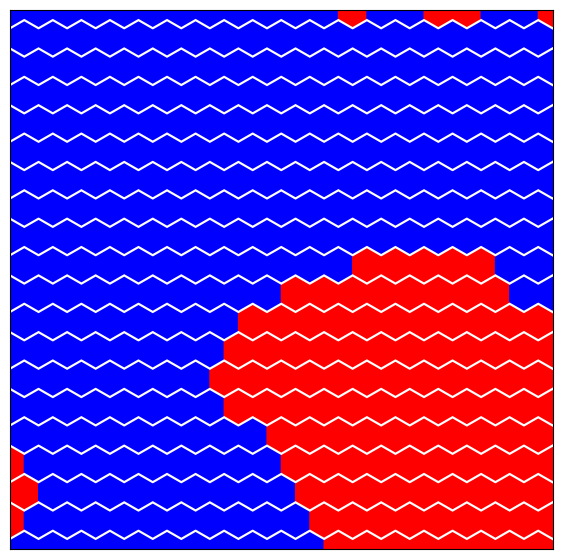

Step:28


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 81.31it/s, 7 steps of size 4.51e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.82      0.54      1.00    373.23      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    228.85      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    541.98      1.00
     noise      0.02      0.02      0.02      0.00      0.05    249.55      1.00



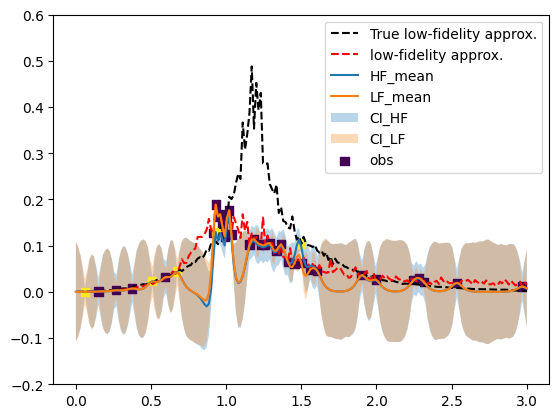

(402,)


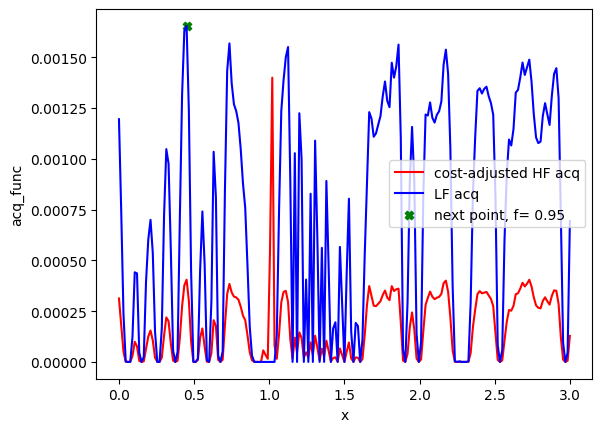

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30]
[0.45 0.95] 0.44999999999999996
Evaluation 38 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.31it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 29: 56.890501976013184


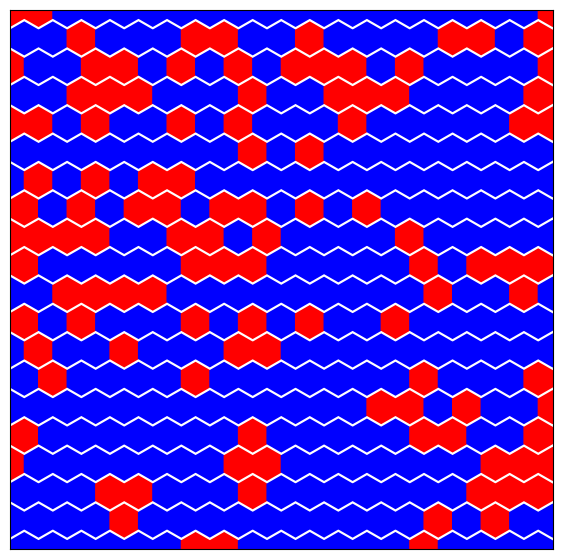

Step:29


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:13<00:00, 76.69it/s, 7 steps of size 3.78e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.80      0.53      1.00    296.68      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    334.00      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    369.95      1.00
     noise      0.02      0.02      0.02      0.00      0.05    203.36      1.01



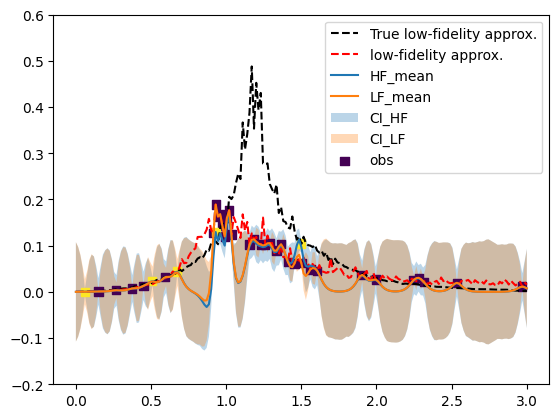

(402,)


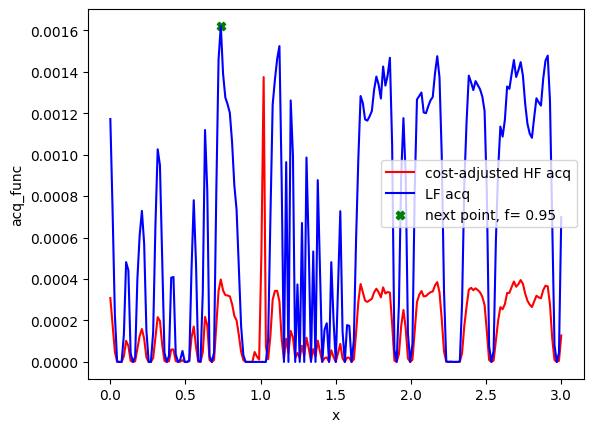

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49]
[0.735 0.95 ] 0.735
Evaluation 39 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.37it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 30: 57.09213948249817


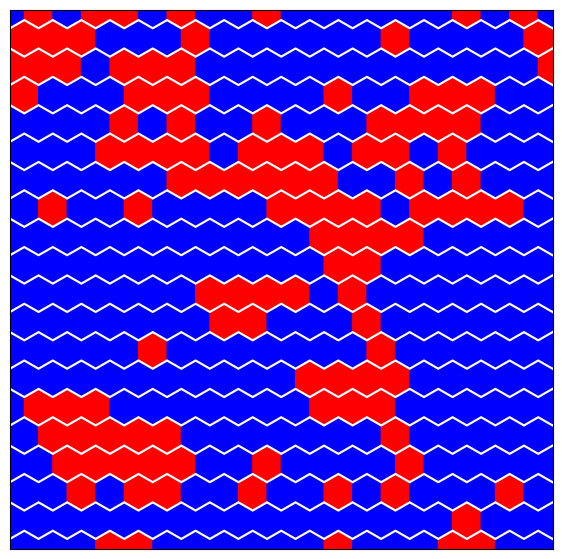

Step:30


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:14<00:00, 69.68it/s, 15 steps of size 3.14e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.80      0.53      1.00    306.25      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    327.58      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    411.01      1.00
     noise      0.02      0.02      0.02      0.00      0.05    220.52      1.00



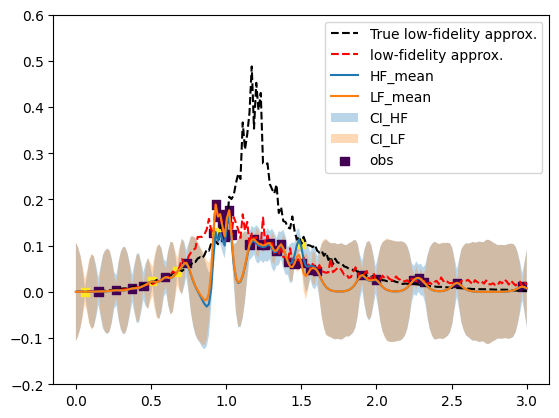

(402,)


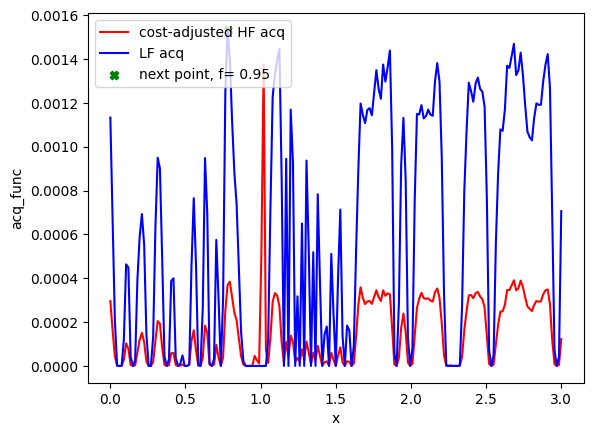

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49  52]
[0.78 0.95] 0.78
Evaluation 40 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.41it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 31: 56.90067934989929


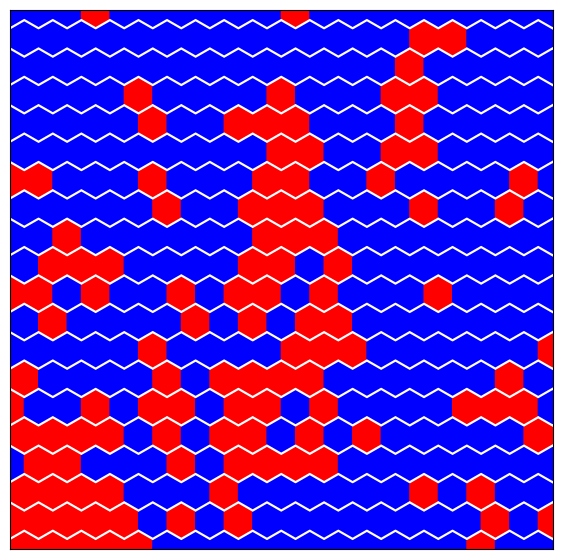

Step:31


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 79.57it/s, 7 steps of size 4.88e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.17      0.80      0.53      1.00    360.30      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    215.00      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    546.32      1.00
     noise      0.02      0.02      0.02      0.00      0.05    171.31      1.00



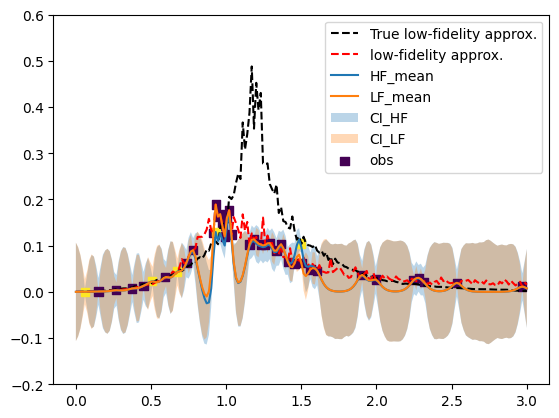

(402,)


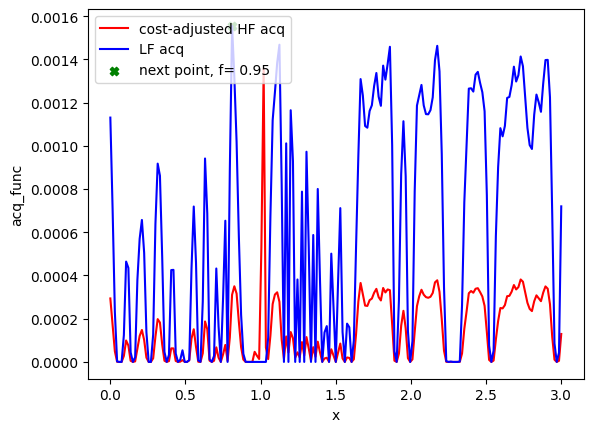

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49  52  54]
[0.81 0.95] 0.8099999999999999
Evaluation 41 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.37it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 32: 56.97309613227844


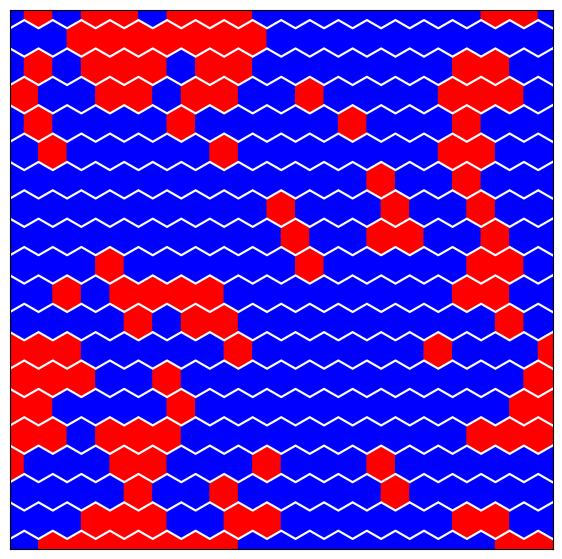

Step:32


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 79.32it/s, 7 steps of size 3.75e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.80      0.52      1.00    307.48      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    422.73      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    339.33      1.00
     noise      0.02      0.02      0.02      0.00      0.05    178.09      1.00



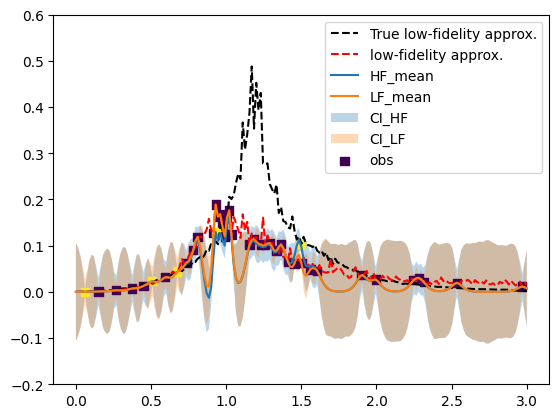

(402,)


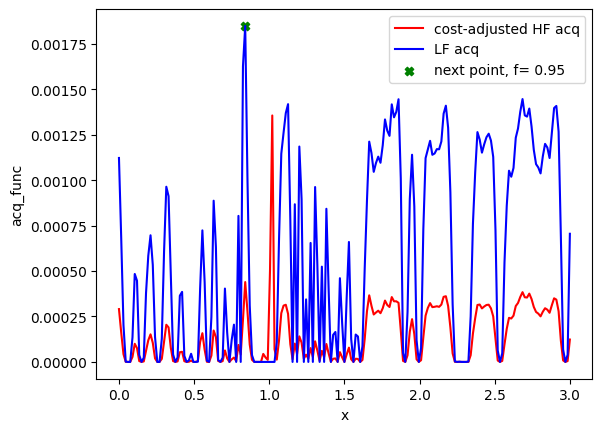

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49  52  54  56]
[0.84 0.95] 0.84
Evaluation 42 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.63it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 33: 56.032145500183105


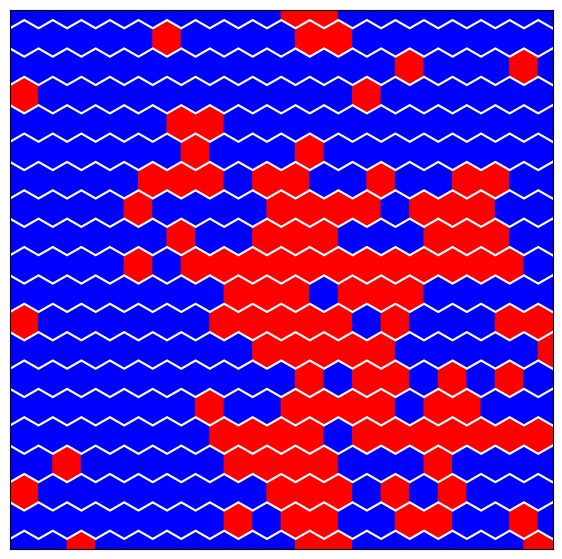

Step:33


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 82.07it/s, 7 steps of size 4.52e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.80      0.54      1.00    415.92      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    179.43      1.03
   k_scale      0.01      0.00      0.01      0.01      0.01    494.24      1.01
     noise      0.02      0.02      0.02      0.00      0.05    262.84      1.00



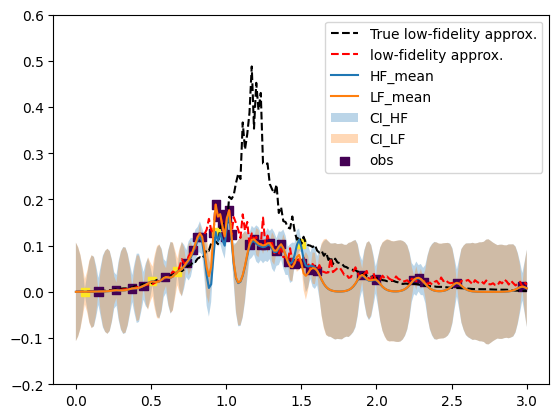

(402,)


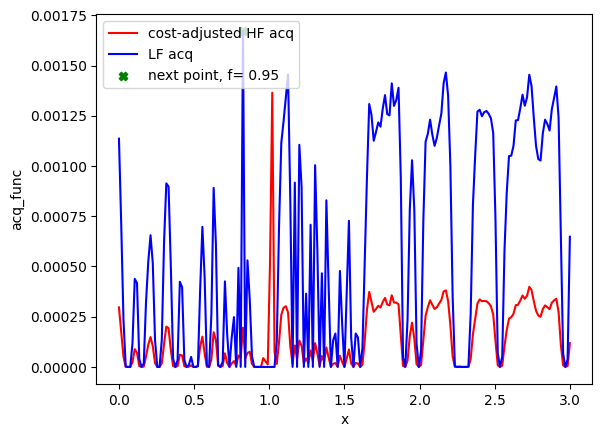

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49  52  54  56  55]
[0.825 0.95 ] 0.825
Evaluation 43 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.32it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 34: 57.60607862472534


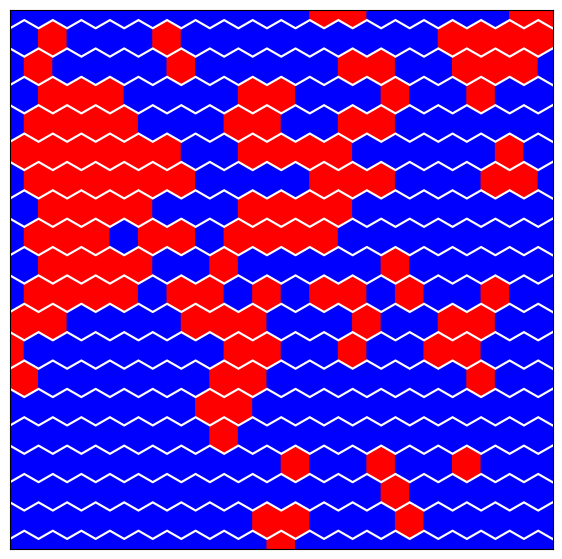

Step:34


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:13<00:00, 74.47it/s, 15 steps of size 3.45e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.77      0.16      0.79      0.53      1.00    236.76      1.00
  k_length      0.01      0.00      0.01      0.01      0.02     98.37      1.01
   k_scale      0.01      0.00      0.01      0.01      0.01    494.95      1.00
     noise      0.02      0.02      0.02      0.00      0.05    191.39      1.00



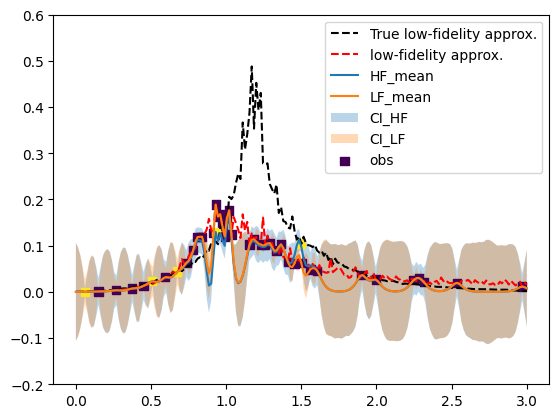

(402,)


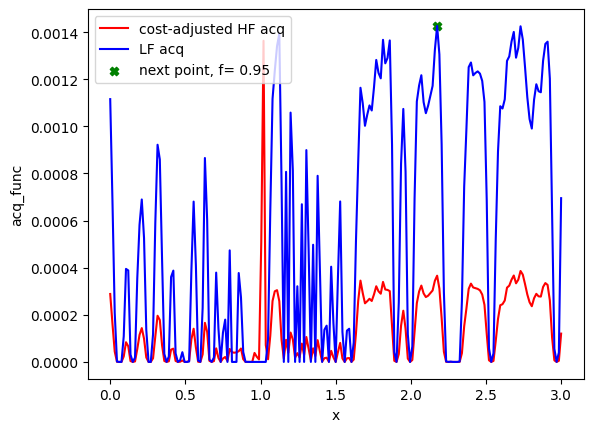

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49  52  54  56  55 145]
[2.175 0.95 ] 2.175
Evaluation 44 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.47it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 35: 56.78403925895691


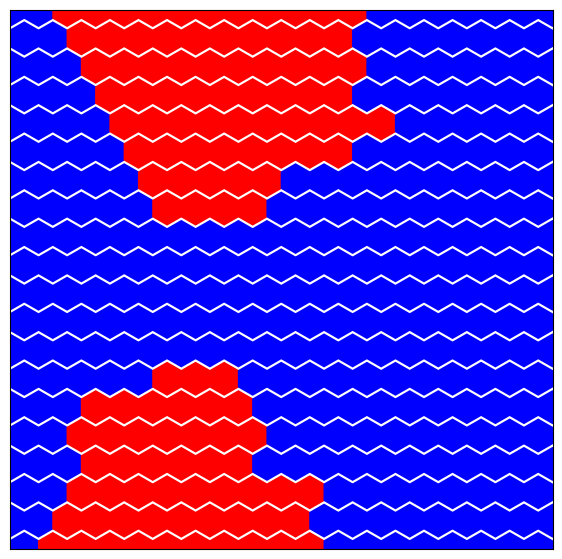

Step:35


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 81.50it/s, 7 steps of size 4.96e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.80      0.54      1.00    397.23      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    252.19      1.01
   k_scale      0.01      0.00      0.01      0.01      0.01    418.03      1.00
     noise      0.02      0.02      0.02      0.00      0.05    383.75      1.00



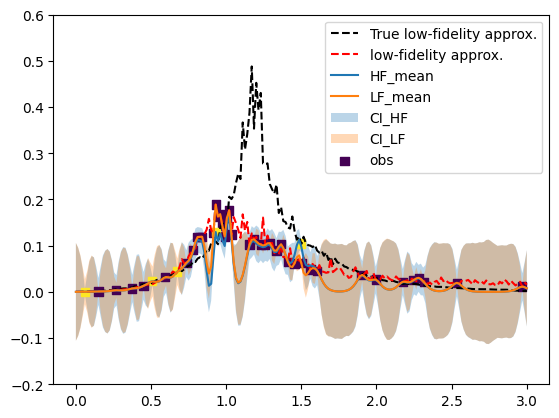

(402,)


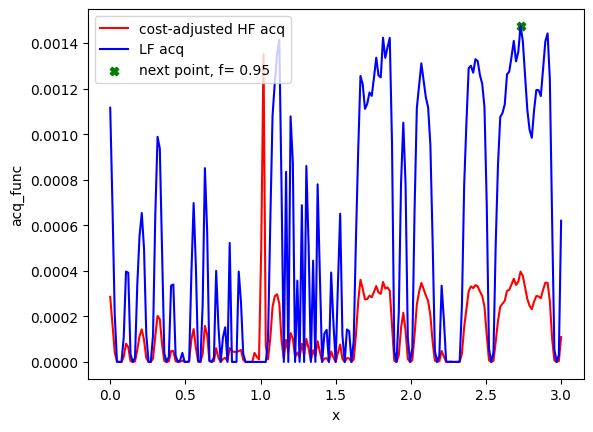

[100  63  64  66  65  97  62  61 263 198 107  68  69  67  25 104  94  10
 133  91  89  86  84  82  79  77 169  30  49  52  54  56  55 145 182]
[2.73 0.95] 2.73
Evaluation 45 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.45it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 36: 55.96780824661255


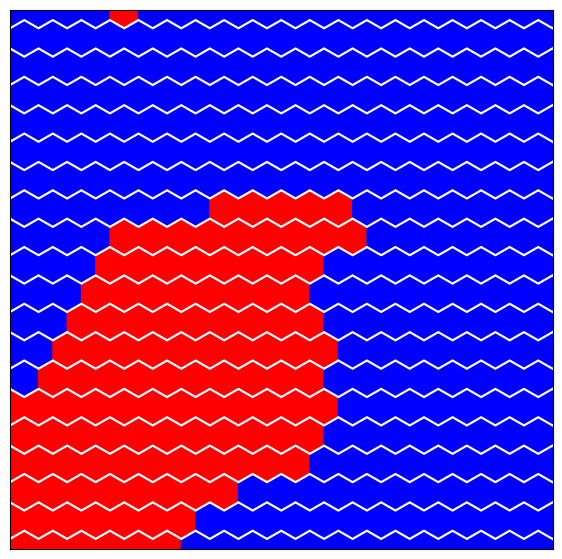

In [ ]:
N = 35
cost_ratio = 8.6/1 #time complexities
f = np.array([1.0, 2.0])
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_lf, X_test_hf))
X_test_full = np.vstack((X_test_lf, X_test_hf))
X_test_norm = np.vstack((X_test_lf, X_test_hf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs, approx_ys_sq, "k--", label="True low-fidelity approx.")
        plt.plot(xs, approx_ys_tri, "r--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.plot(xs, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")
        plt.ylim(-0.2, 0.6)
        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            J_mat = np.array([[0,Jx[-1],0,Jx[-1],0],
                      [Jx[-1],0,0,0,Jx[-1]],
                      [0,Jx[-1],0,Jx[-1],0]])
            tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
            sq_sim = tri_sim

        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        if train_x_full[-1,1] == 1: #High fidelity
            plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])

        else: #Low fidelity
            sq_sim.plot_config(resultsBO_dict[n+i]['sim']['config'][-1])

        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:12<00:00, 80.89it/s, 7 steps of size 4.73e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.80      0.54      1.00    341.05      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    242.15      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    505.51      1.00
     noise      0.02      0.02      0.02      0.00      0.05    176.28      1.00



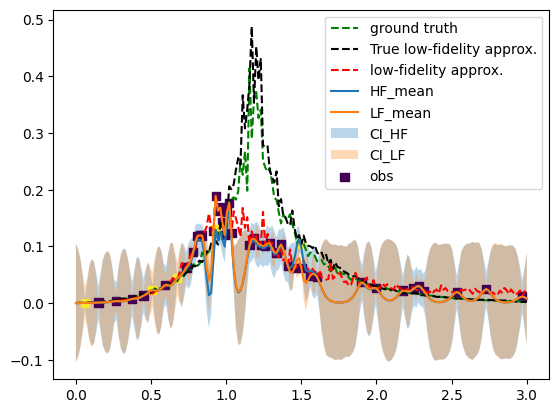

In [ ]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, true_ys_sq, "g--", label="ground truth")
plt.plot(xs, approx_ys_sq, "k--", label="True low-fidelity approx.")
plt.plot(xs, approx_ys_tri, "r--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")
#plt.ylim(-0.1, 0.6)

plt.legend(loc="best")
plt.show()

In [ ]:
train_x_full

array([[2.31396193, 0.95      ],
       [0.06225585, 1.        ],
       [1.9009447 , 0.95      ],
       [2.24641165, 0.95      ],
       [1.49552104, 1.        ],
       [0.67438994, 1.        ],
       [0.59418859, 0.95      ],
       [2.28159214, 0.95      ],
       [0.50733251, 1.        ],
       [0.26501944, 0.95      ],
       [1.5       , 0.95      ],
       [0.945     , 0.95      ],
       [0.96      , 0.95      ],
       [0.99      , 0.95      ],
       [0.975     , 0.95      ],
       [1.455     , 0.95      ],
       [0.93      , 0.95      ],
       [0.915     , 0.95      ],
       [0.93      , 1.        ],
       [2.97      , 0.95      ],
       [1.605     , 0.95      ],
       [1.02      , 0.95      ],
       [1.035     , 0.95      ],
       [1.005     , 0.95      ],
       [0.375     , 0.95      ],
       [1.56      , 0.95      ],
       [1.41      , 0.95      ],
       [0.15      , 0.95      ],
       [1.995     , 0.95      ],
       [1.365     , 0.95      ],
       [1.

0.004122439602843927


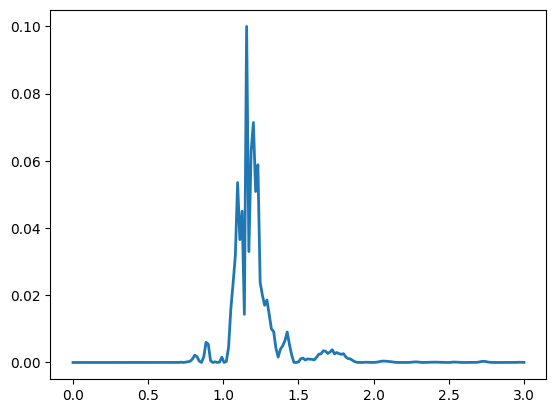

In [ ]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)


# MFBO with structured GP

- Correct models

In [ ]:
n = 10

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]))

<ipython-input-73-8de86ade8ab9>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 30.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:47<00:00, 10.57it/s]


Completed. Saving
Time (s) to complete simulation 1: 63.743717670440674


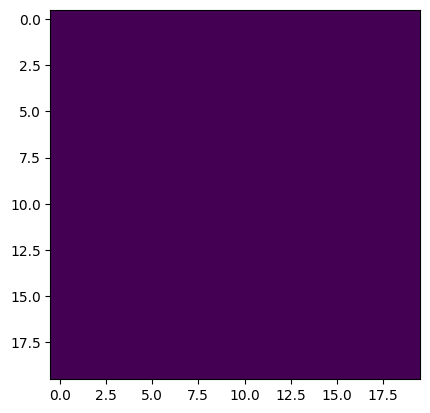

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [07:00<00:00,  1.19it/s]

Completed. Saving
Time (s) to complete simulation 2: 567.3262414932251


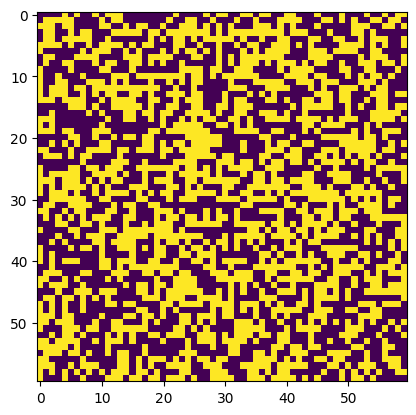

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 31.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:47<00:00, 10.61it/s]


Completed. Saving
Time (s) to complete simulation 3: 63.19581079483032


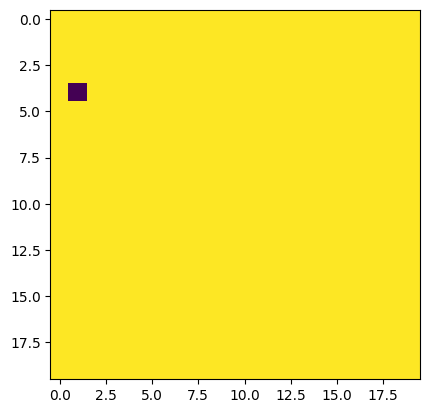

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 30.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:47<00:00, 10.63it/s]


Completed. Saving
Time (s) to complete simulation 4: 63.182713747024536


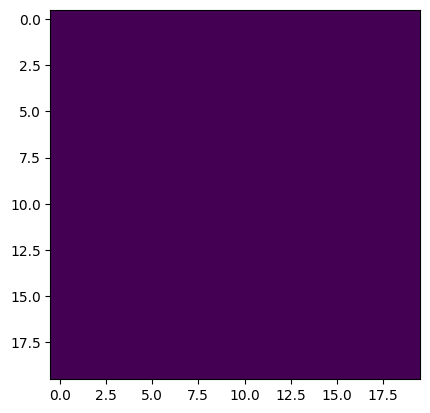

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:23<00:00,  3.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:59<00:00,  1.19it/s]

Completed. Saving
Time (s) to complete simulation 5: 562.5408430099487


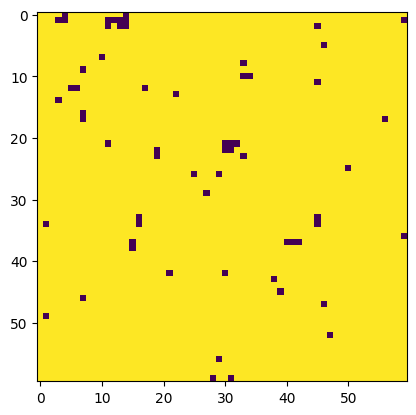

Evaluation 6 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:23<00:00,  3.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:59<00:00,  1.19it/s]

Completed. Saving
Time (s) to complete simulation 6: 563.1336557865143


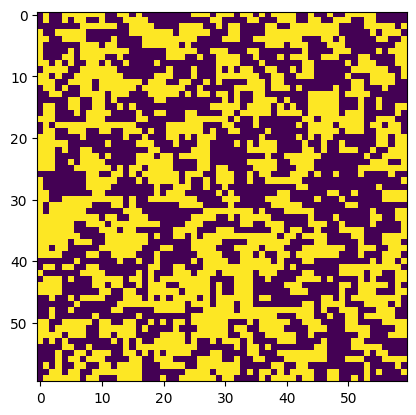

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 31.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:47<00:00, 10.61it/s]


Completed. Saving
Time (s) to complete simulation 7: 63.25742721557617


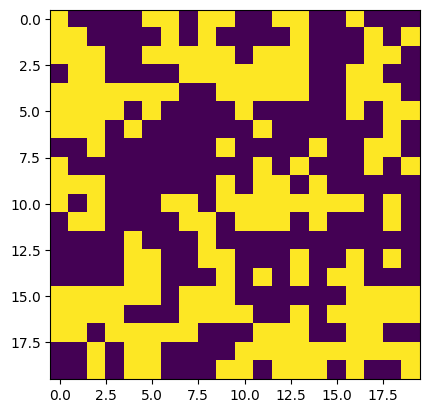

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:15<00:00, 31.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:46<00:00, 10.67it/s]


Completed. Saving
Time (s) to complete simulation 8: 62.86661076545715


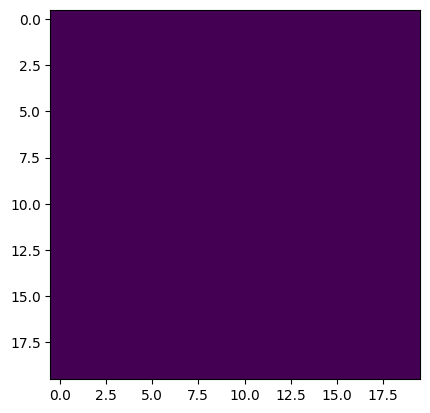

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [06:58<00:00,  1.20it/s]

Completed. Saving
Time (s) to complete simulation 9: 562.9339601993561


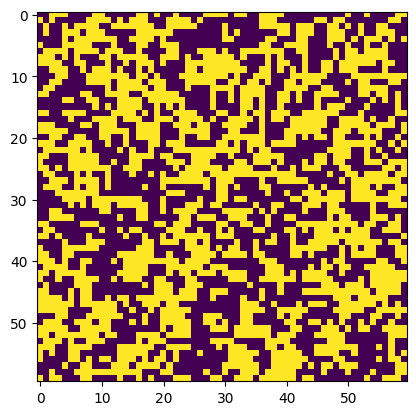

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:16<00:00, 30.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:47<00:00, 10.61it/s]


Completed. Saving
Time (s) to complete simulation 10: 63.43377232551575


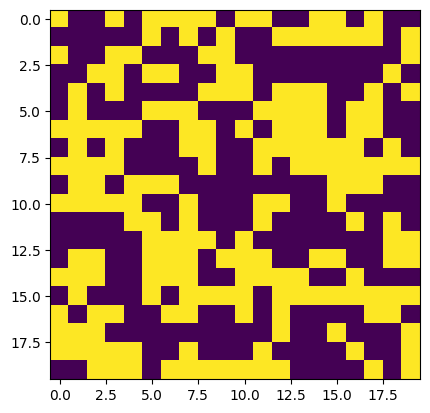

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

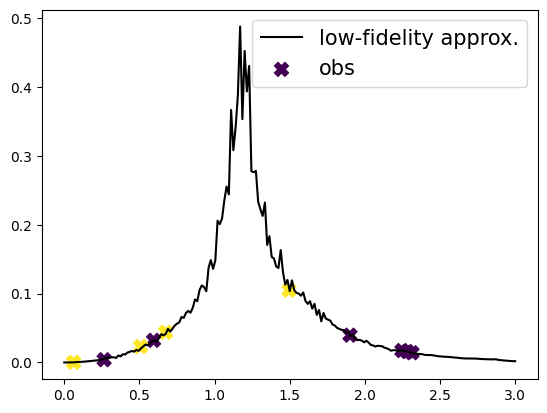

In [ ]:
plt.plot(xs, approx_ys_sq, "k", label="low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

# GP mean function
- Prioir information functional form - Single peak function (eg. Gaussian)

In [ ]:
@jit
def mean_func(x, params):

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    lb = 0
    ub = 3
    x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)
    f = params["a"]*jnp.exp((-1/2)*(jnp.square(x_data-params["b"])/jnp.square(params["c"])))

    return  f


def mf_priors():
    a = numpyro.sample("a", numpyro.distributions.HalfNormal(0.5)) #Height of peak
    b = numpyro.sample("b", numpyro.distributions.HalfNormal(1.17)) #Position of peak
    c = numpyro.sample("c", numpyro.distributions.HalfNormal(2)) #Broadness of peak
    return {"a": a, "b": b, "c": c}

Run BO 35 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]),
 array([[0.01413402],
        [0.00025922],
        [0.03967774],
        [0.01734454],
        [0.10503485],
        [0.04375014],
        [0.0321721 ],
        [0.01583695],
        [0.02304033],
        [0.00402616]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:28<00:00, 34.57it/s, 3 steps of size 1.75e-01. acc. prob=0.69]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.13      0.12      0.00      0.30    296.79      1.00
         b      1.04      0.61      1.19      0.07      1.70    122.00      1.00
         c      1.50      1.15      1.21      0.28      3.21     40.51      1.00
     delta      0.44      0.27      0.45      0.01      0.84    175.20      1.00
  k_length      0.64      0.16      0.63      0.44      0.97    205.40      1.00
   k_scale      0.06      0.10      0.03      0.01      0.15    206.78      1.00
     noise      0.03      0.02      0.02      0.00      0.06     22.30      1.00



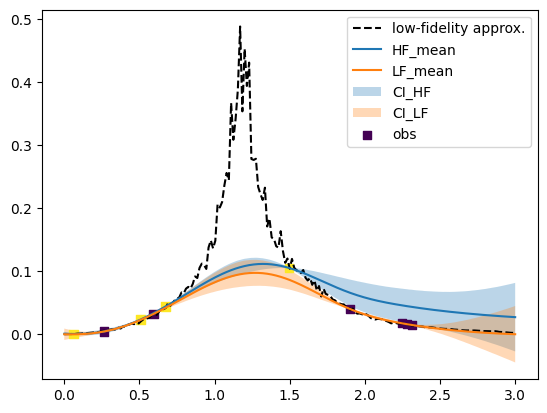

(402,)


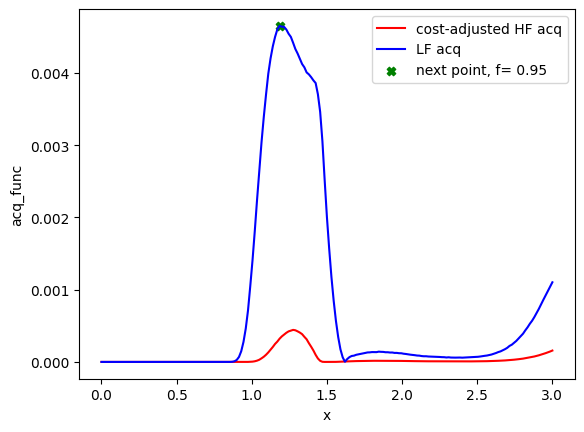

79
[1.185 0.95 ] 1.185
Evaluation 11 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.86it/s]


Completed. Saving
Time (s) to complete simulation 2: 24.01316785812378


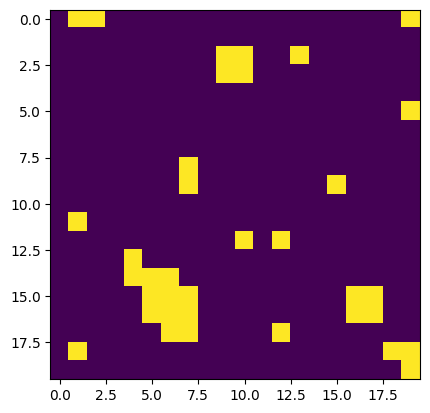

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:51<00:00, 19.54it/s, 7 steps of size 1.43e-01. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.30      0.02      0.30      0.27      0.33    107.09      1.00
         b      1.17      0.03      1.16      1.12      1.24     81.36      1.03
         c      0.17      0.03      0.18      0.10      0.21     77.24      1.04
     delta      0.38      0.29      0.32      0.01      0.84    231.21      1.01
  k_length      0.72      0.17      0.73      0.47      0.99    184.21      1.02
   k_scale      0.04      0.04      0.02      0.01      0.09    176.13      1.00
     noise      0.02      0.02      0.02      0.00      0.05    312.84      1.00



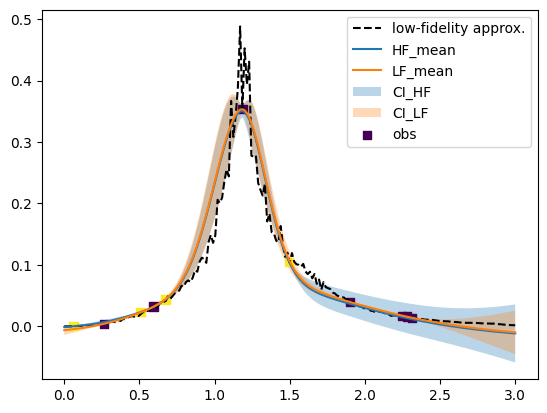

(402,)


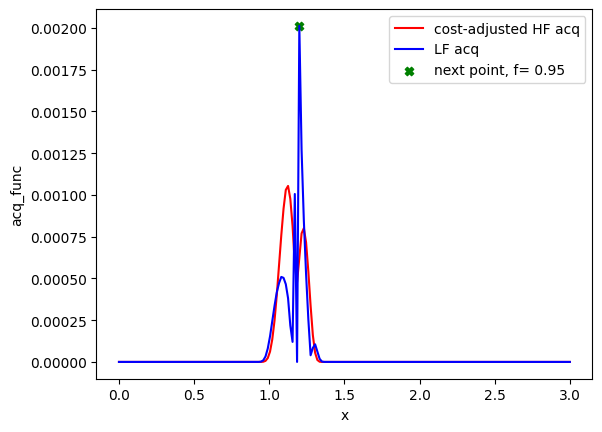

[79 80]
[1.2  0.95] 1.2
Evaluation 12 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.65it/s]


Completed. Saving
Time (s) to complete simulation 3: 24.00049352645874


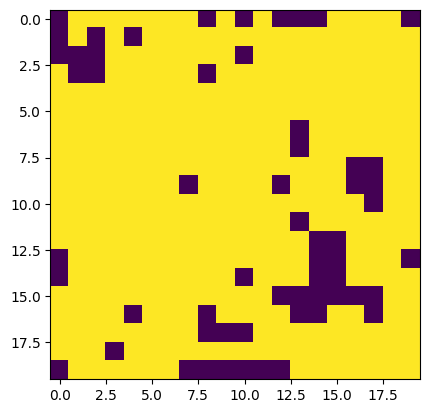

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [03:00<00:00,  5.55it/s, 15 steps of size 3.08e-02. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.81      0.21      0.89      0.44      1.05     27.98      1.07
         b      1.28      0.03      1.29      1.23      1.31     27.60      1.08
         c      0.06      0.01      0.07      0.04      0.08     28.27      1.08
     delta      0.35      0.29      0.29      0.01      0.81     89.95      1.00
  k_length      0.62      0.17      0.59      0.40      0.96    132.05      1.00
   k_scale      0.06      0.07      0.03      0.01      0.13    193.08      1.00
     noise      0.02      0.02      0.02      0.00      0.05    247.74      1.00



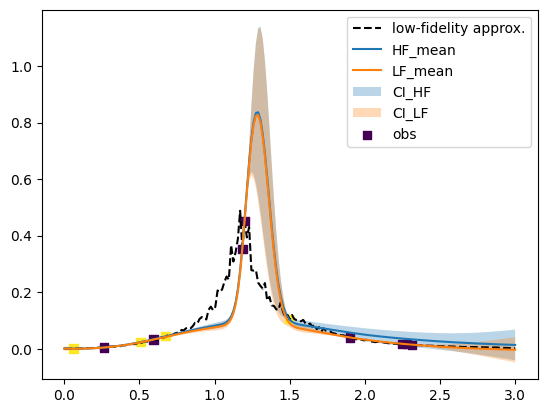

(402,)


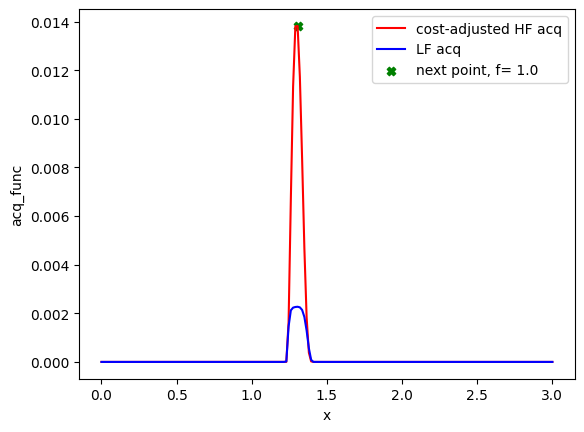

[ 79  80 288]
[1.305 1.   ] 1.305
Evaluation 13 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.30it/s]

Completed. Saving
Time (s) to complete simulation 4: 209.99011659622192


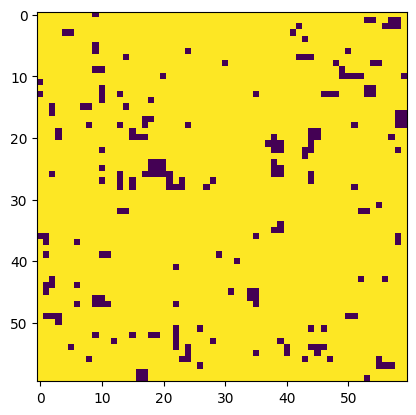

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [10:36<00:00,  1.57it/s, 191 steps of size 5.16e-04. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.47      0.01      0.47      0.45      0.50     53.14      1.01
         b      1.23      0.00      1.23      1.23      1.23     63.63      1.02
         c      0.04      0.00      0.04      0.04      0.04     68.86      1.00
     delta      0.54      0.31      0.59      0.02      0.92      8.86      1.01
  k_length      0.50      0.11      0.50      0.33      0.66     16.99      1.05
   k_scale      0.02      0.01      0.02      0.01      0.04     17.43      1.00
     noise      0.03      0.02      0.03      0.01      0.05     24.49      1.04



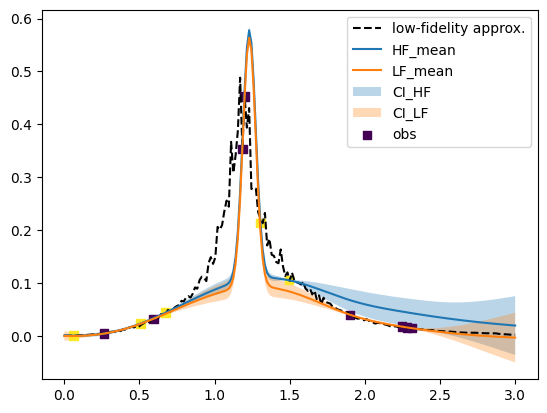

(402,)


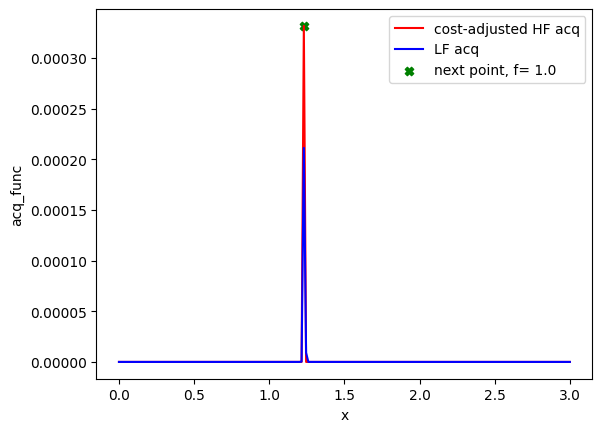

[ 79  80 288 283]
[1.23 1.  ] 1.23
Evaluation 14 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:35<00:00,  3.22it/s]

Completed. Saving
Time (s) to complete simulation 5: 214.5637068748474


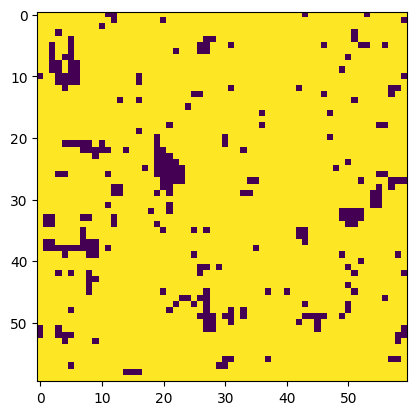

Step:5


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:36<00:00, 27.30it/s, 15 steps of size 1.72e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.17      0.16      0.01      0.42     61.35      1.02
         b      1.16      0.55      1.14      0.26      1.95     54.36      1.01
         c      1.04      1.13      0.55      0.02      2.82     79.25      1.02
     delta      0.53      0.28      0.52      0.15      1.00    346.80      1.00
  k_length      0.02      0.01      0.01      0.01      0.02    211.02      1.00
   k_scale      0.03      0.02      0.02      0.01      0.04    269.45      1.01
     noise      0.02      0.02      0.02      0.00      0.05    424.76      1.00



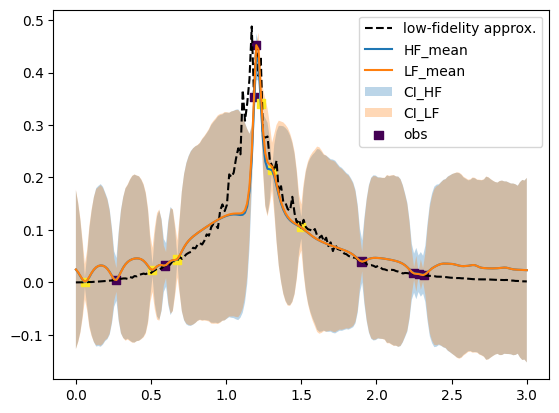

(402,)


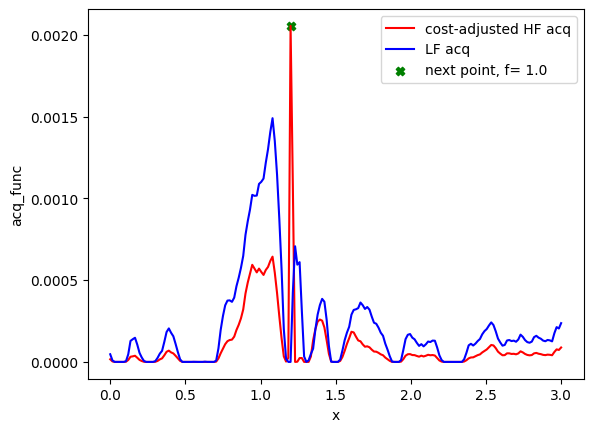

[ 79  80 288 283 281]
[1.2 1. ] 1.2
Evaluation 15 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.30it/s]

Completed. Saving
Time (s) to complete simulation 6: 211.37494015693665


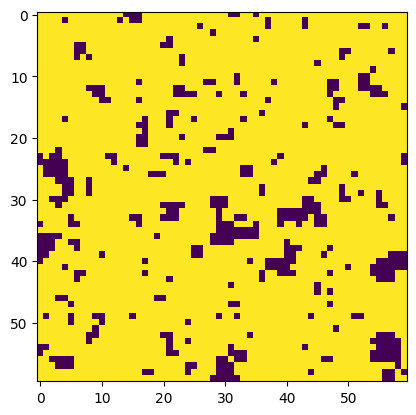

Step:6


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:39<00:00, 25.18it/s, 31 steps of size 1.24e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.12      0.14      0.03      0.33    132.83      1.01
         b      1.09      0.57      1.10      0.05      1.77    231.00      1.00
         c      1.21      1.13      0.82      0.03      2.88    151.00      1.00
     delta      0.73      0.19      0.76      0.44      0.99    208.24      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    200.08      1.00
   k_scale      0.03      0.02      0.03      0.01      0.06    207.25      1.00
     noise      0.02      0.02      0.02      0.00      0.05    242.33      1.00



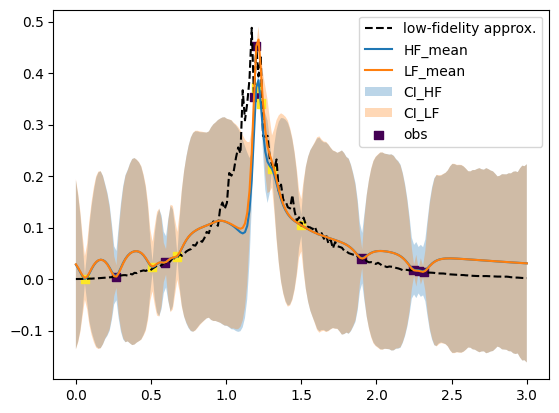

(402,)


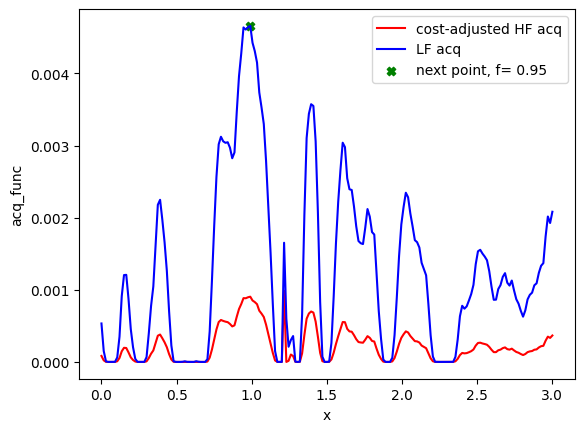

[ 79  80 288 283 281  66]
[0.99 0.95] 0.99
Evaluation 16 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.52it/s]


Completed. Saving
Time (s) to complete simulation 7: 24.110926151275635


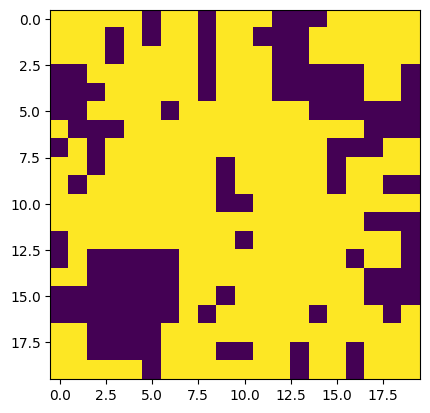

Step:7


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 50.79it/s, 31 steps of size 1.10e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.09      0.14      0.02      0.29    140.28      1.00
         b      1.12      0.54      1.14      0.09      1.80    143.68      1.00
         c      1.31      1.13      0.87      0.07      2.94    113.11      1.00
     delta      0.74      0.19      0.76      0.46      1.00    325.89      1.01
  k_length      0.02      0.00      0.02      0.01      0.02    166.77      1.03
   k_scale      0.03      0.02      0.02      0.01      0.05    231.02      1.01
     noise      0.02      0.02      0.02      0.00      0.05    270.58      1.00



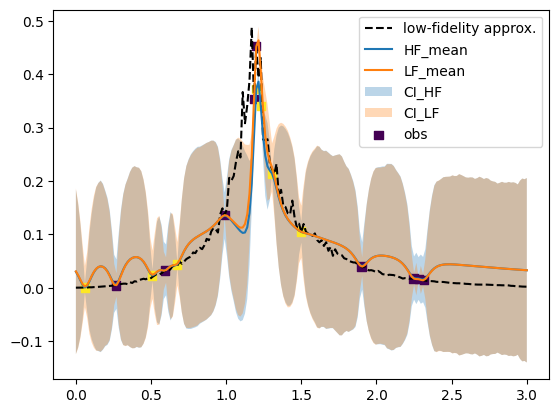

(402,)


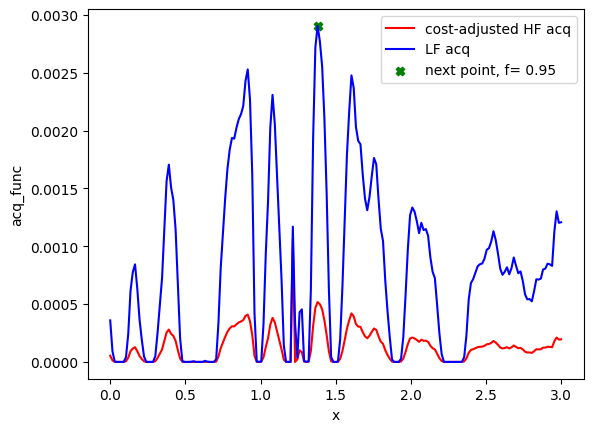

[ 79  80 288 283 281  66  92]
[1.38 0.95] 1.38
Evaluation 17 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 81.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.24it/s]


Completed. Saving
Time (s) to complete simulation 8: 22.704521417617798


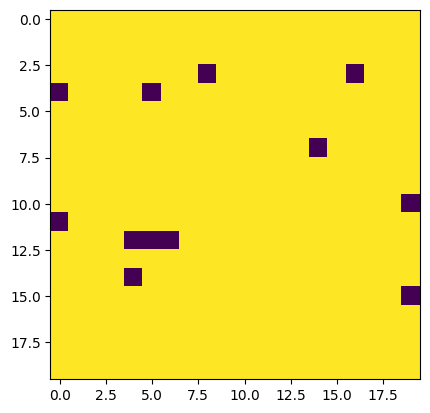

Step:8


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:42<00:00, 23.79it/s, 15 steps of size 2.06e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.08      0.14      0.00      0.26    110.90      1.02
         b      1.10      0.56      1.16      0.16      1.84    111.55      1.01
         c      1.20      1.01      0.83      0.11      2.66    123.19      1.00
     delta      0.76      0.18      0.79      0.48      1.00    452.45      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    189.60      1.00
   k_scale      0.03      0.02      0.02      0.01      0.04    228.68      1.00
     noise      0.02      0.02      0.02      0.00      0.05    537.46      1.00



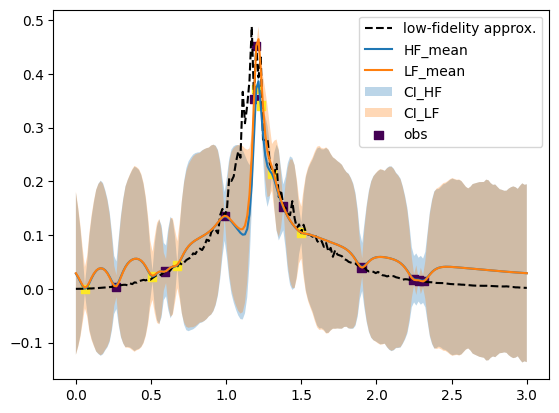

(402,)


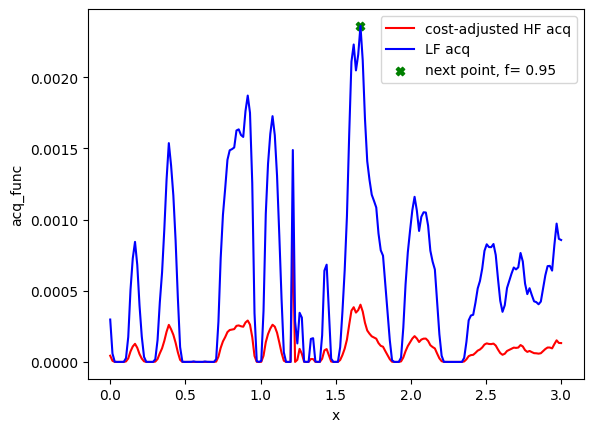

[ 79  80 288 283 281  66  92 111]
[1.665 0.95 ] 1.665
Evaluation 18 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.07it/s]


Completed. Saving
Time (s) to complete simulation 9: 23.774978637695312


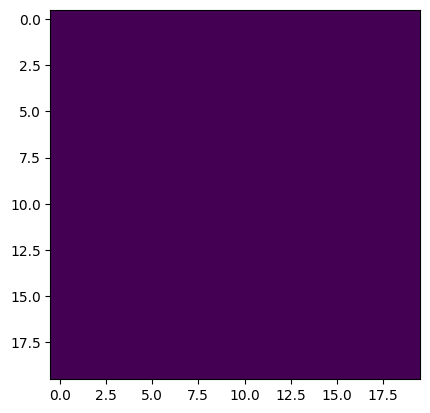

Step:9


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:39<00:00, 25.13it/s, 3 steps of size 2.24e-01. acc. prob=0.82]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.16      0.08      0.14      0.04      0.30     67.71      1.02
         b      1.06      0.53      1.17      0.00      1.61     55.33      1.01
         c      1.16      1.13      0.75      0.02      2.84     60.63      1.03
     delta      0.76      0.17      0.79      0.51      0.99    250.59      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    159.81      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    189.00      1.00
     noise      0.03      0.02      0.02      0.00      0.05    285.71      1.00



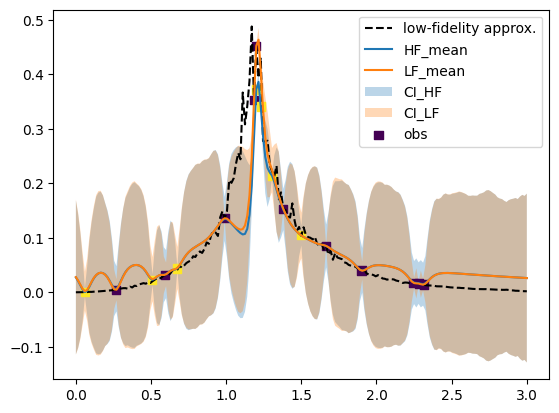

(402,)


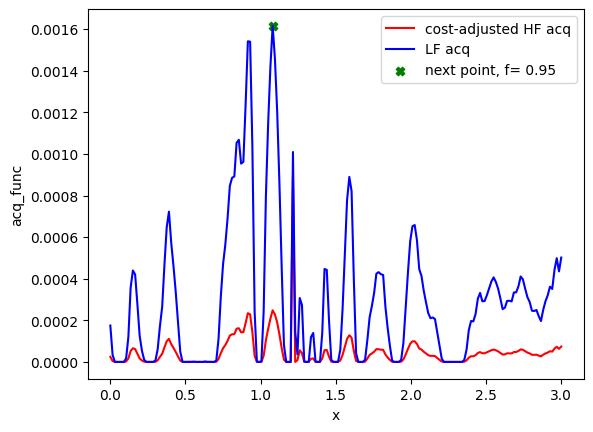

[ 79  80 288 283 281  66  92 111  72]
[1.08 0.95] 1.08
Evaluation 19 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.65it/s]


Completed. Saving
Time (s) to complete simulation 10: 23.389413118362427


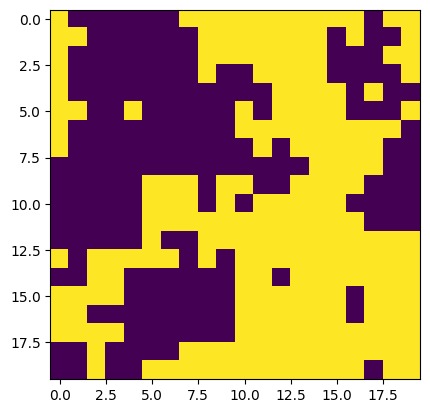

Step:10


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:47<00:00, 21.20it/s, 31 steps of size 2.23e-01. acc. prob=0.78]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.08      0.17      0.04      0.32     66.72      1.02
         b      1.12      0.44      1.18      0.32      1.82    118.12      1.01
         c      0.97      0.98      0.54      0.08      2.38    118.05      1.00
     delta      0.76      0.18      0.78      0.52      1.00    271.09      1.00
  k_length      0.02      0.00      0.01      0.01      0.02    169.35      1.00
   k_scale      0.02      0.01      0.02      0.01      0.04    194.77      1.00
     noise      0.02      0.02      0.02      0.00      0.05    272.99      1.00



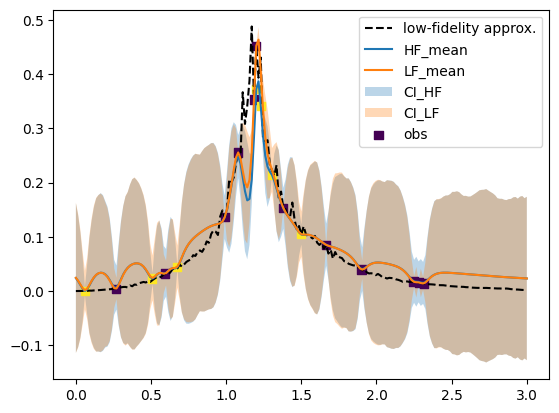

(402,)


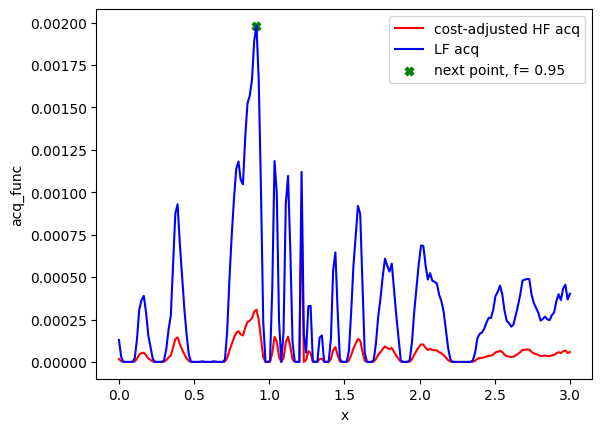

[ 79  80 288 283 281  66  92 111  72  61]
[0.915 0.95 ] 0.9149999999999999
Evaluation 20 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.96it/s]


Completed. Saving
Time (s) to complete simulation 11: 23.851737022399902


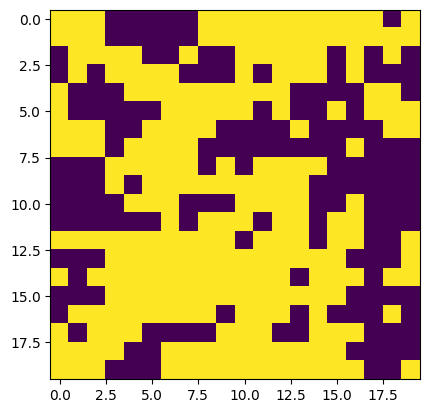

Step:11


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:49<00:00, 20.06it/s, 15 steps of size 2.20e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.08      0.16      0.04      0.29     78.82      1.00
         b      1.08      0.48      1.17      0.06      1.47     66.91      1.01
         c      1.11      1.10      0.58      0.12      2.81     40.90      1.00
     delta      0.76      0.17      0.79      0.52      1.00    370.34      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    233.04      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    202.78      1.00
     noise      0.02      0.02      0.02      0.00      0.05    260.16      1.01



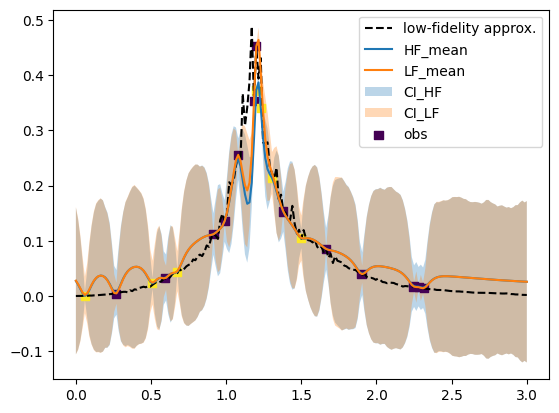

(402,)


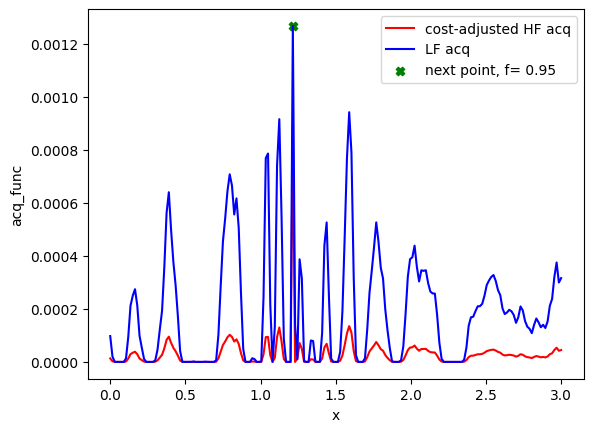

[ 79  80 288 283 281  66  92 111  72  61  81]
[1.215 0.95 ] 1.2149999999999999
Evaluation 21 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.33it/s]


Completed. Saving
Time (s) to complete simulation 12: 22.996044397354126


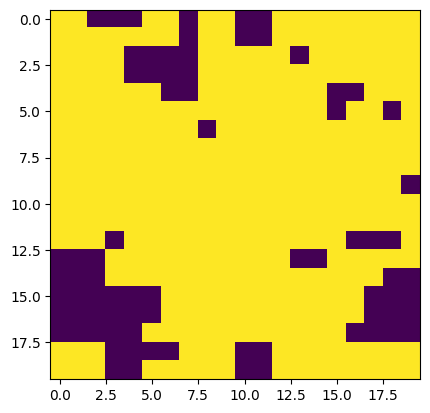

Step:12


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:59<00:00, 16.89it/s, 7 steps of size 1.64e-01. acc. prob=0.78]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.08      0.17      0.06      0.30     36.85      1.00
         b      1.10      0.48      1.18      0.02      1.52    102.72      1.00
         c      1.03      1.03      0.59      0.11      2.65     36.18      1.00
     delta      0.78      0.18      0.82      0.51      1.00    225.60      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    248.17      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    222.48      1.00
     noise      0.02      0.02      0.02      0.00      0.05    319.78      1.00



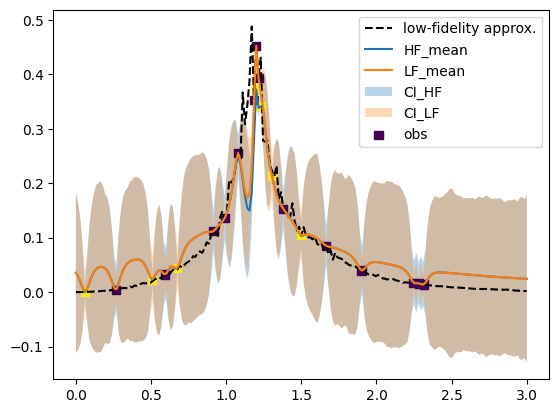

(402,)


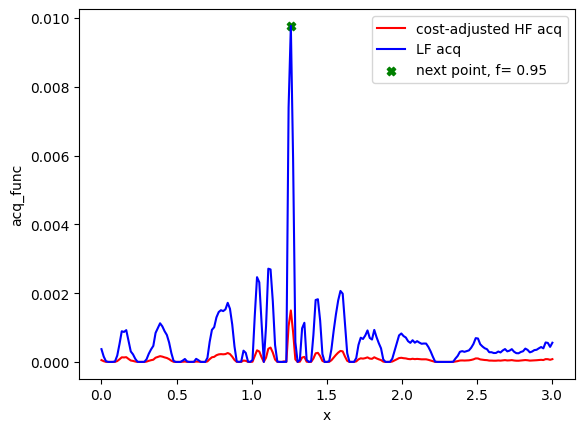

[ 79  80 288 283 281  66  92 111  72  61  81  84]
[1.26 0.95] 1.26
Evaluation 22 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 78.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.67it/s]


Completed. Saving
Time (s) to complete simulation 13: 23.231146574020386


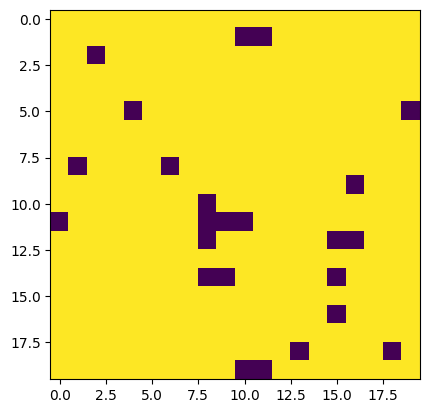

Step:13


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:57<00:00, 17.36it/s, 7 steps of size 1.77e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.20      0.09      0.19      0.07      0.31     37.38      1.04
         b      1.15      0.39      1.19      0.42      1.73    114.92      1.00
         c      0.87      0.98      0.46      0.05      2.34     95.09      1.01
     delta      0.78      0.16      0.81      0.55      1.00    348.21      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    309.01      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    346.66      1.00
     noise      0.02      0.02      0.02      0.00      0.05    150.75      1.00



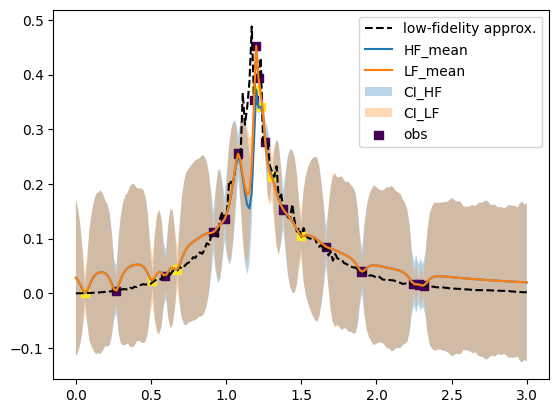

(402,)


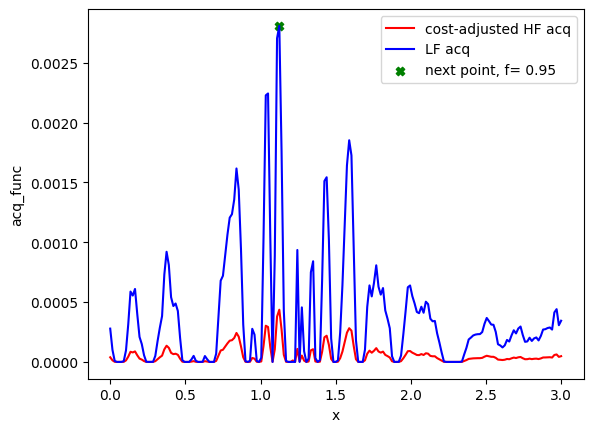

[ 79  80 288 283 281  66  92 111  72  61  81  84  75]
[1.125 0.95 ] 1.125
Evaluation 23 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.66it/s]


Completed. Saving
Time (s) to complete simulation 14: 23.322806358337402


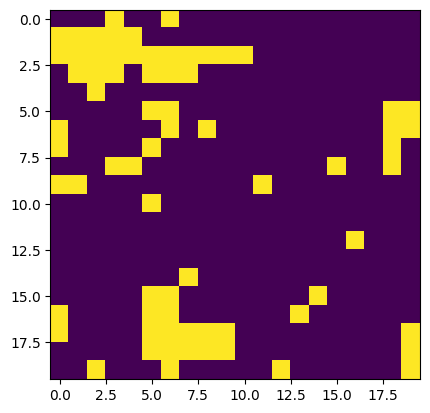

Step:14


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:51<00:00, 19.33it/s, 15 steps of size 3.17e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.20      0.09      0.19      0.06      0.34     69.29      1.00
         b      1.07      0.45      1.17      0.19      1.56     20.99      1.00
         c      0.96      1.00      0.47      0.03      2.53     38.93      1.00
     delta      0.79      0.16      0.82      0.55      1.00    361.73      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    406.21      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    103.81      1.00
     noise      0.02      0.02      0.02      0.00      0.05    242.01      1.00



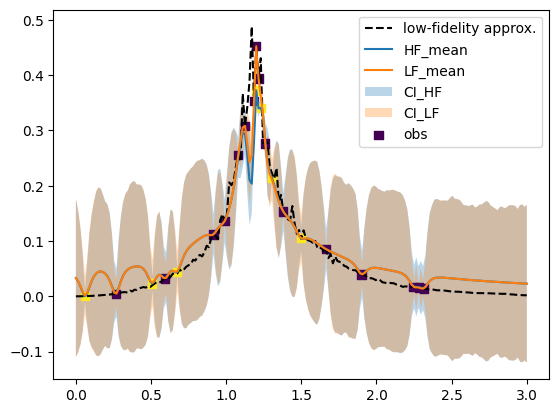

(402,)


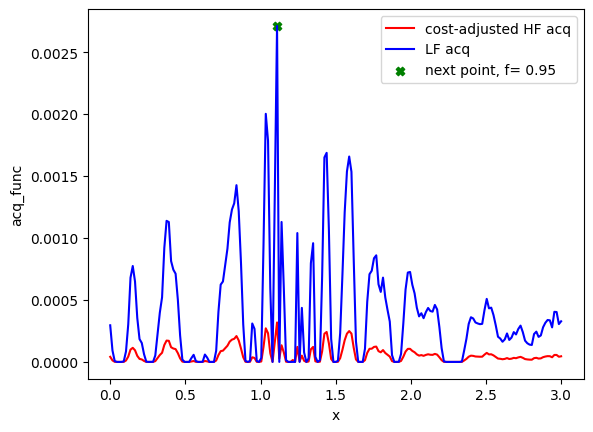

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74]
[1.11 0.95] 1.1099999999999999
Evaluation 24 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.01it/s]


Completed. Saving
Time (s) to complete simulation 15: 23.716920137405396


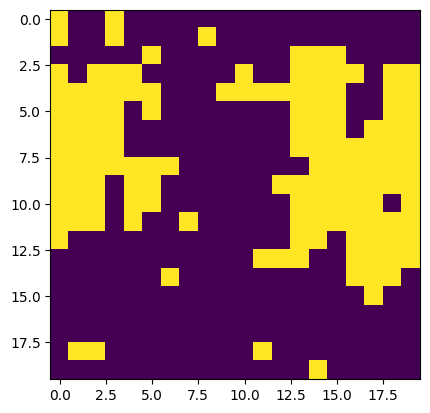

Step:15


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:12<00:00, 13.81it/s, 15 steps of size 1.67e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.09      0.20      0.08      0.36     34.76      1.05
         b      1.16      0.37      1.19      0.38      1.58    167.79      1.00
         c      0.78      0.81      0.47      0.09      1.83     29.99      1.05
     delta      0.78      0.17      0.82      0.53      1.00    353.89      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    107.13      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    100.11      1.02
     noise      0.02      0.02      0.02      0.00      0.05    245.95      1.00



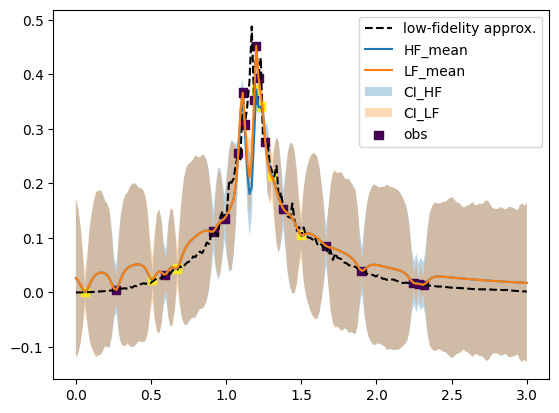

(402,)


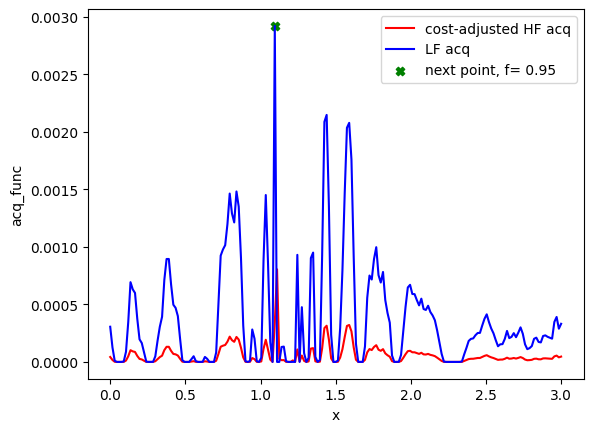

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73]
[1.095 0.95 ] 1.095
Evaluation 25 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.10it/s]


Completed. Saving
Time (s) to complete simulation 16: 23.06418251991272


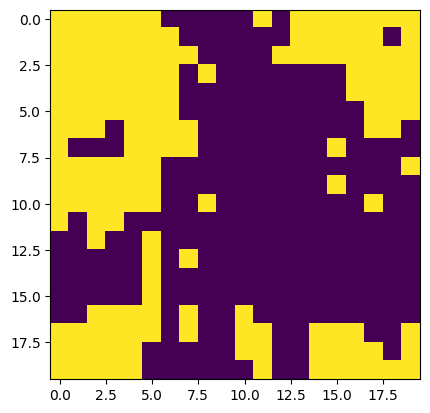

Step:16


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:53<00:00, 18.78it/s, 15 steps of size 2.94e-01. acc. prob=0.81]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.09      0.18      0.05      0.33     93.19      1.00
         b      1.06      0.46      1.15      0.03      1.50     46.36      1.02
         c      1.07      1.07      0.61      0.02      2.60     86.96      1.01
     delta      0.75      0.17      0.78      0.49      1.00    330.19      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    300.53      1.00
   k_scale      0.02      0.01      0.02      0.01      0.04    209.84      1.01
     noise      0.02      0.02      0.02      0.00      0.05    324.81      1.00



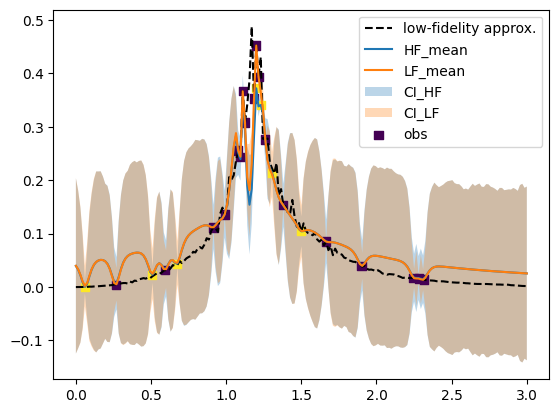

(402,)


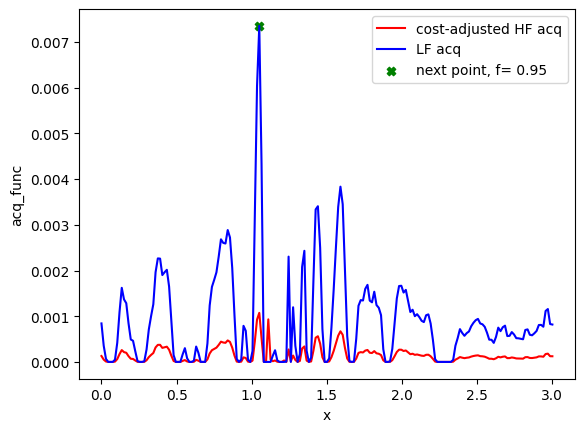

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70]
[1.05 0.95] 1.05
Evaluation 26 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.81it/s]


Completed. Saving
Time (s) to complete simulation 17: 23.833264112472534


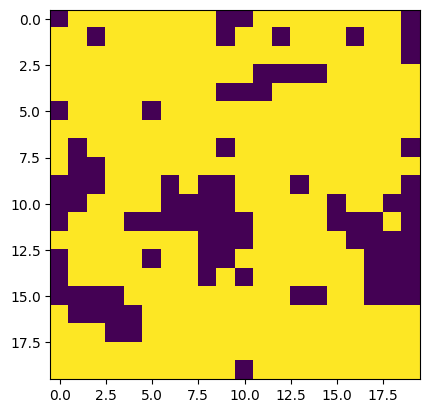

Step:17


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:11<00:00, 13.93it/s, 31 steps of size 1.63e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.08      0.18      0.07      0.32    138.09      1.02
         b      1.12      0.43      1.18      0.25      1.64    165.22      1.00
         c      1.02      1.02      0.61      0.09      2.36    115.75      1.01
     delta      0.75      0.17      0.78      0.50      0.99    265.95      1.02
  k_length      0.01      0.00      0.01      0.01      0.01    398.51      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    221.75      1.01
     noise      0.02      0.02      0.02      0.00      0.05    393.75      1.00



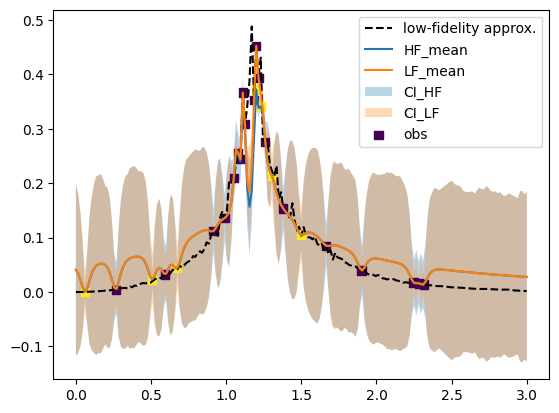

(402,)


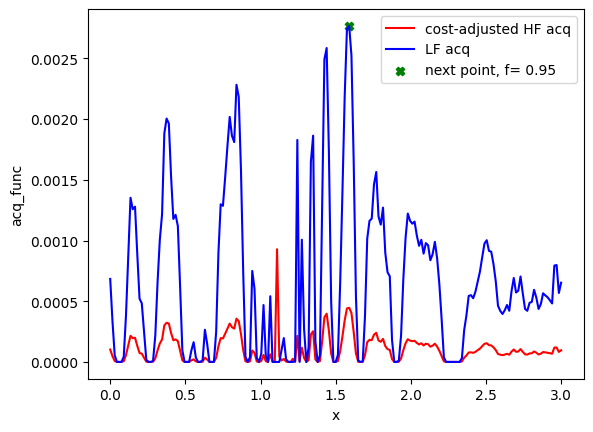

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106]
[1.59 0.95] 1.5899999999999999
Evaluation 27 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 79.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.60it/s]


Completed. Saving
Time (s) to complete simulation 18: 23.22598385810852


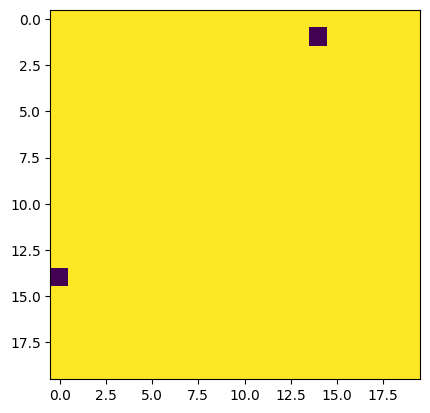

Step:18


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:02<00:00, 16.13it/s, 15 steps of size 2.76e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.08      0.16      0.05      0.30     96.06      1.00
         b      1.00      0.46      1.12      0.03      1.49     33.71      1.01
         c      1.23      1.11      0.80      0.11      2.81     68.41      1.00
     delta      0.76      0.17      0.80      0.50      1.00    453.18      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    411.65      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    199.14      1.01
     noise      0.02      0.02      0.02      0.00      0.05    292.44      1.00



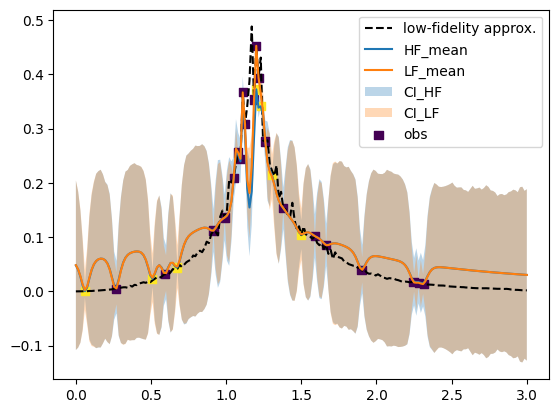

(402,)


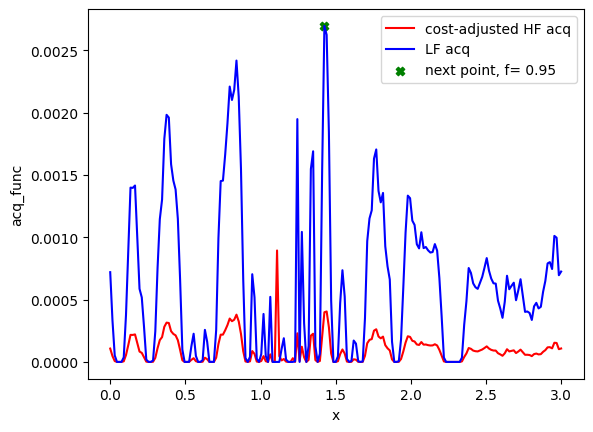

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95]
[1.425 0.95 ] 1.425
Evaluation 28 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.64it/s]


Completed. Saving
Time (s) to complete simulation 19: 23.339588403701782


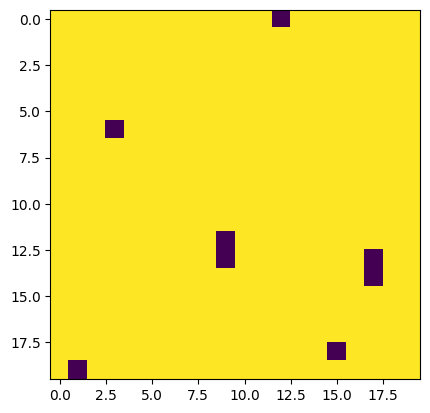

Step:19


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:47<00:00,  9.26it/s, 63 steps of size 1.04e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.08      0.17      0.07      0.32    110.45      1.00
         b      1.12      0.47      1.17      0.03      1.51    107.54      1.00
         c      1.06      1.13      0.53      0.10      2.68    108.15      1.00
     delta      0.78      0.15      0.80      0.55      1.00    286.60      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    359.39      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    146.50      1.01
     noise      0.02      0.02      0.02      0.00      0.05    240.31      1.00



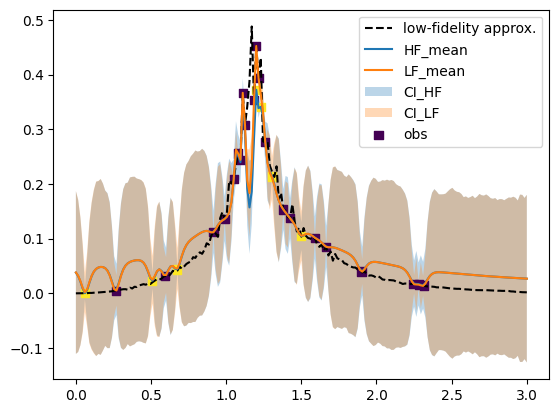

(402,)


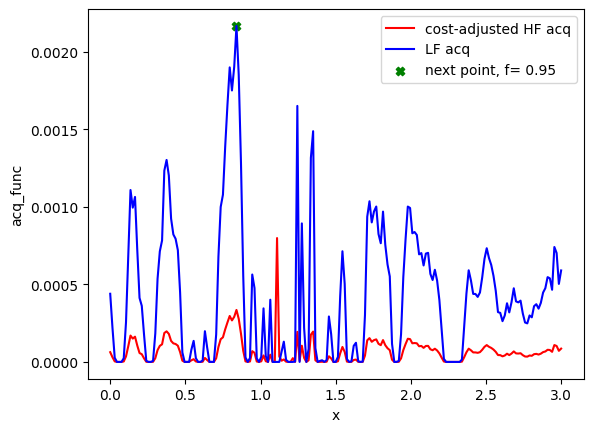

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56]
[0.84 0.95] 0.84
Evaluation 29 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.85it/s]


Completed. Saving
Time (s) to complete simulation 20: 24.01660680770874


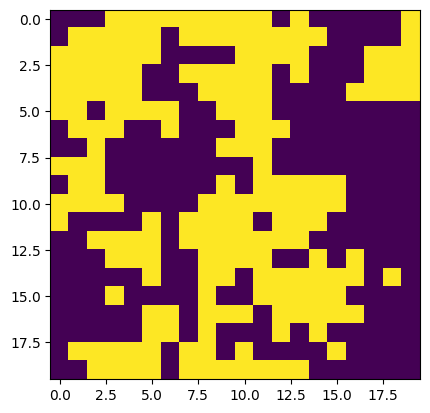

Step:20


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:19<00:00, 12.56it/s, 15 steps of size 2.15e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.08      0.18      0.07      0.32    146.65      1.00
         b      1.17      0.34      1.19      0.44      1.66    114.36      1.00
         c      0.91      1.00      0.49      0.07      2.47    111.07      1.00
     delta      0.77      0.17      0.80      0.53      1.00    298.20      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    402.00      1.01
   k_scale      0.02      0.01      0.02      0.01      0.03    377.85      1.00
     noise      0.03      0.02      0.02      0.00      0.05    588.74      1.00



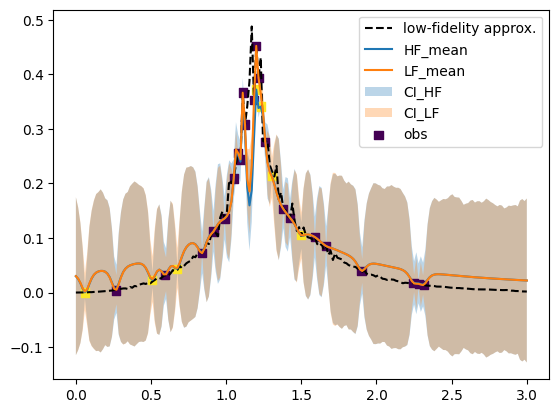

(402,)


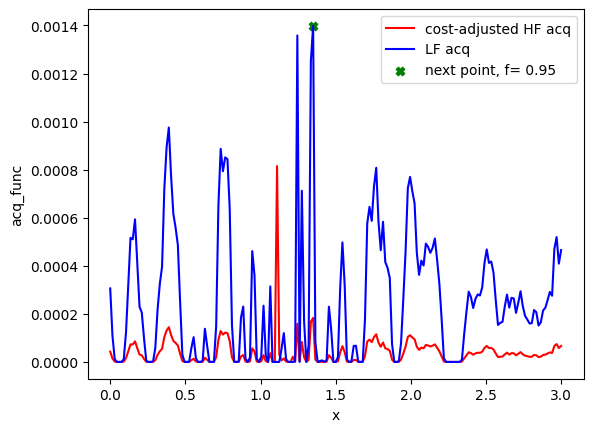

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90]
[1.35 0.95] 1.3499999999999999
Evaluation 30 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 78.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.38it/s]


Completed. Saving
Time (s) to complete simulation 21: 23.38707971572876


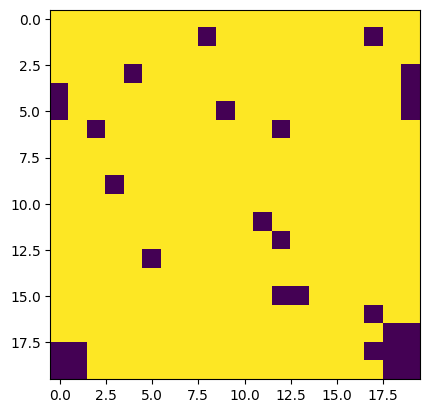

Step:21


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:09<00:00, 14.34it/s, 15 steps of size 2.55e-01. acc. prob=0.83]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.07      0.18      0.06      0.27     39.77      1.00
         b      1.13      0.37      1.18      0.50      1.70     95.29      1.00
         c      0.96      1.02      0.52      0.10      2.62     59.02      1.00
     delta      0.78      0.16      0.81      0.52      0.99    304.24      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    131.87      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    121.16      1.00
     noise      0.02      0.02      0.02      0.00      0.05    463.27      1.00



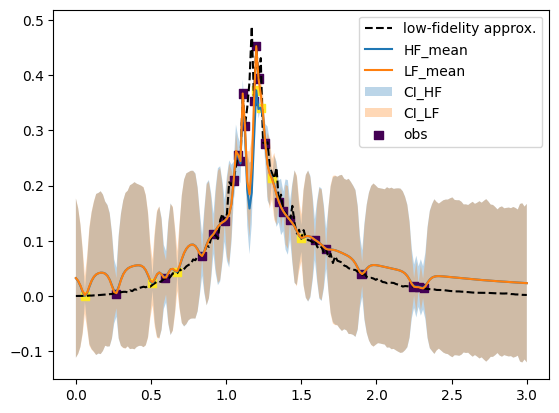

(402,)


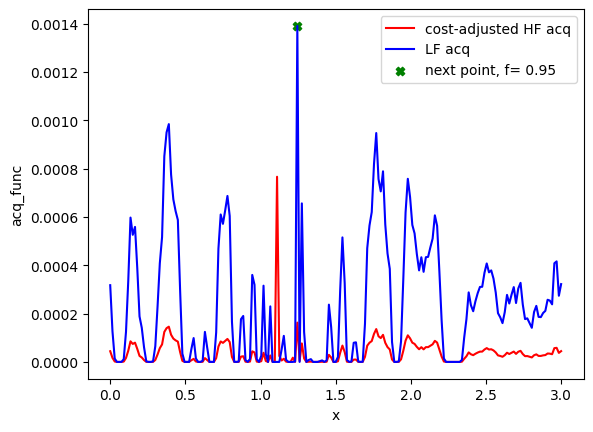

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83]
[1.245 0.95 ] 1.2449999999999999
Evaluation 31 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.44it/s]


Completed. Saving
Time (s) to complete simulation 22: 23.517916440963745


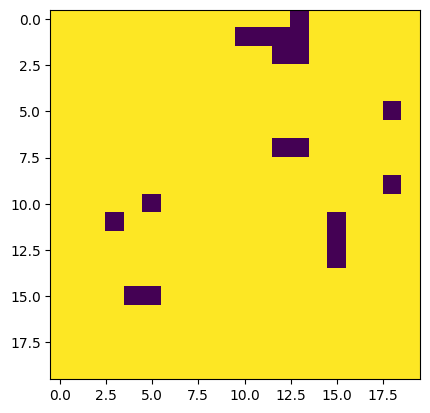

Step:22


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [02:16<00:00,  7.32it/s, 31 steps of size 9.89e-02. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.20      0.08      0.19      0.08      0.32    135.76      1.00
         b      1.13      0.40      1.18      0.30      1.56    113.25      1.00
         c      0.87      0.99      0.44      0.11      2.44    119.98      1.01
     delta      0.80      0.15      0.82      0.59      1.00    376.06      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    310.06      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    128.12      1.02
     noise      0.02      0.02      0.02      0.00      0.05    375.86      1.00



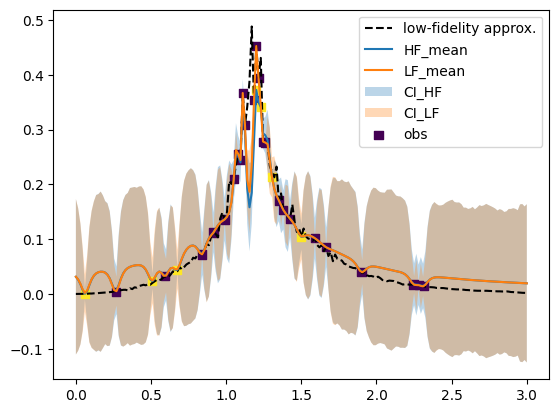

(402,)


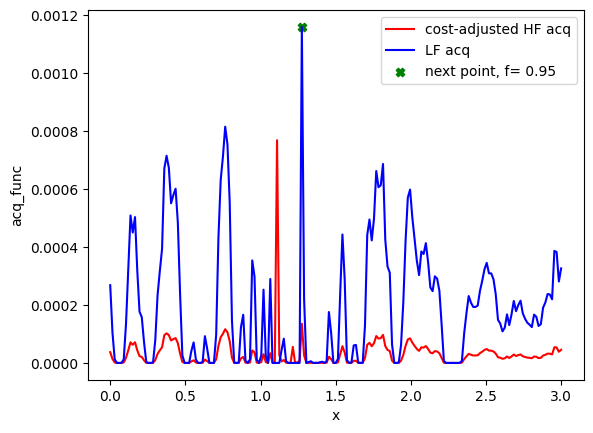

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85]
[1.275 0.95 ] 1.275
Evaluation 32 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 78.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.36it/s]


Completed. Saving
Time (s) to complete simulation 23: 23.443573236465454


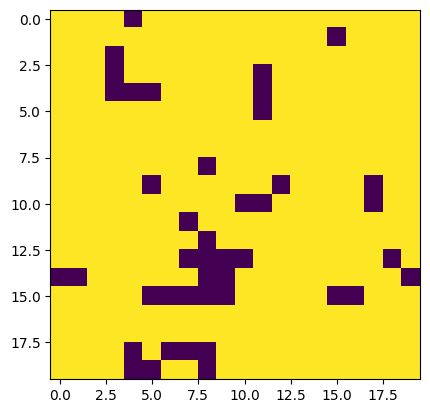

Step:23


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 50.33it/s, 31 steps of size 1.19e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.08      0.20      0.08      0.36    113.34      1.00
         b      1.20      0.30      1.19      0.74      1.59    407.24      1.01
         c      0.71      0.81      0.39      0.09      1.64     98.35      1.00
     delta      0.80      0.15      0.83      0.58      1.00    270.00      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    231.10      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    164.46      1.00
     noise      0.02      0.02      0.02      0.00      0.05    314.41      1.00



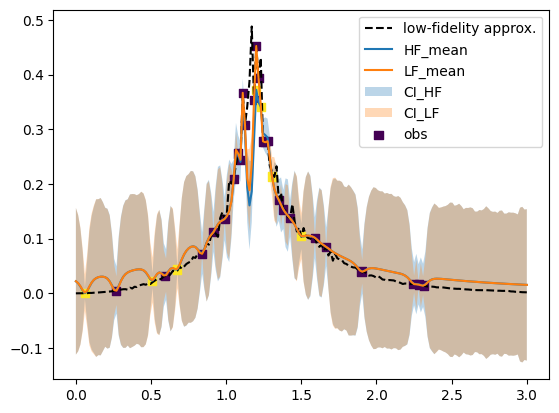

(402,)


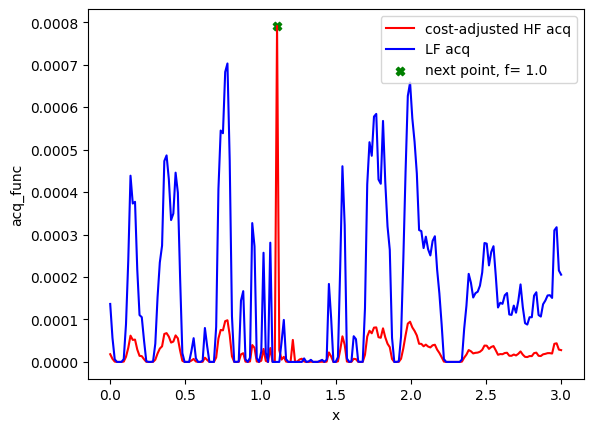

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275]
[1.11 1.  ] 1.1099999999999999
Evaluation 33 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 24: 206.26190638542175


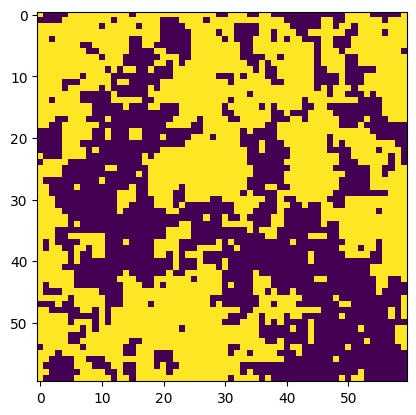

Step:24


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 47.45it/s, 15 steps of size 2.32e-01. acc. prob=0.86]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.16      0.08      0.15      0.05      0.28    103.61      1.03
         b      1.06      0.54      1.15      0.03      1.66    113.83      1.01
         c      1.32      1.13      0.95      0.09      2.98    124.42      1.01
     delta      0.87      0.11      0.90      0.72      1.00    399.91      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    361.81      1.00
   k_scale      0.03      0.01      0.02      0.01      0.04    304.86      1.00
     noise      0.02      0.02      0.02      0.00      0.05    309.63      1.00



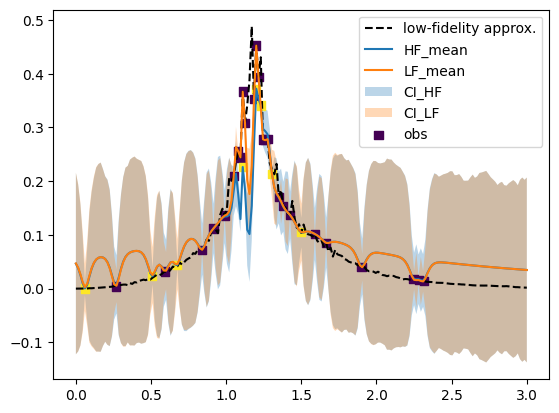

(402,)


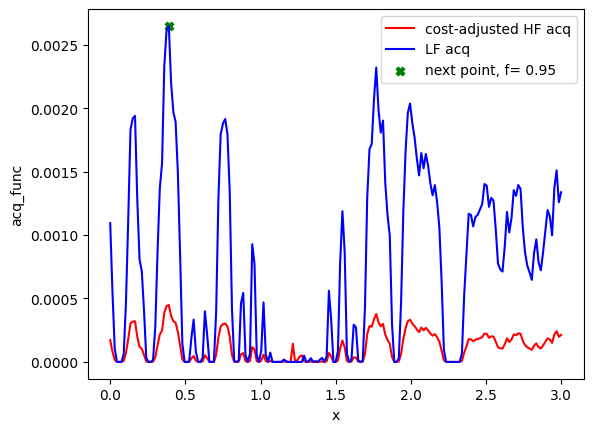

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26]
[0.39 0.95] 0.39
Evaluation 34 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.69it/s]


Completed. Saving
Time (s) to complete simulation 25: 24.1199893951416


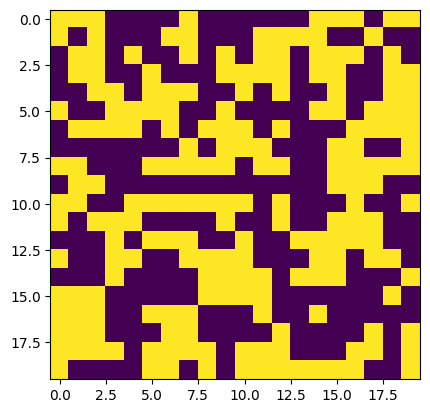

Step:25


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 47.62it/s, 15 steps of size 1.84e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.07      0.14      0.04      0.26     80.90      1.01
         b      1.10      0.56      1.14      0.06      1.77     87.88      1.00
         c      1.38      1.09      1.15      0.07      2.93    110.33      1.00
     delta      0.87      0.11      0.90      0.71      1.00    301.53      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    321.84      1.00
   k_scale      0.03      0.01      0.02      0.01      0.04    316.61      1.00
     noise      0.03      0.02      0.02      0.00      0.05    450.27      1.00



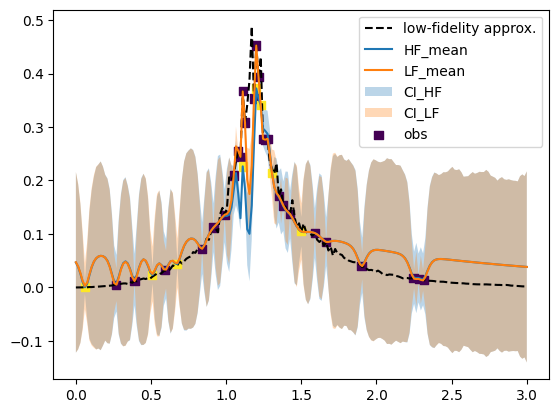

(402,)


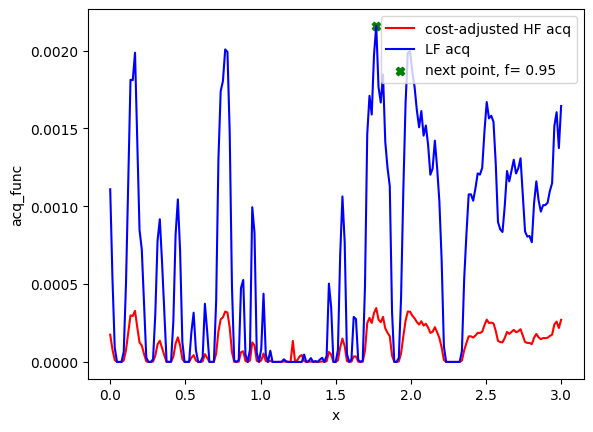

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118]
[1.77 0.95] 1.77
Evaluation 35 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.91it/s]


Completed. Saving
Time (s) to complete simulation 26: 23.147075414657593


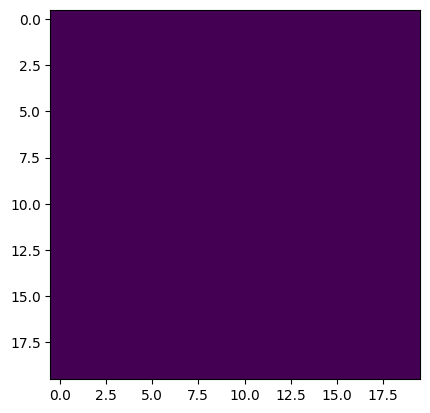

Step:26


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 48.28it/s, 15 steps of size 2.15e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.08      0.14      0.03      0.27    105.41      1.01
         b      1.06      0.53      1.16      0.00      1.61     89.24      1.00
         c      1.26      1.14      0.79      0.10      3.13    109.58      1.00
     delta      0.87      0.11      0.89      0.72      1.00    353.33      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    248.76      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    195.29      1.00
     noise      0.02      0.02      0.02      0.00      0.05    318.26      1.00



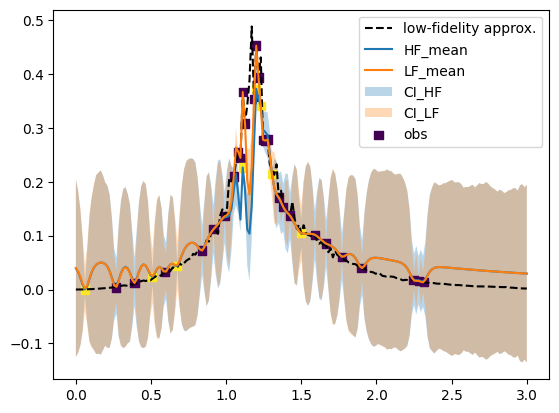

(402,)


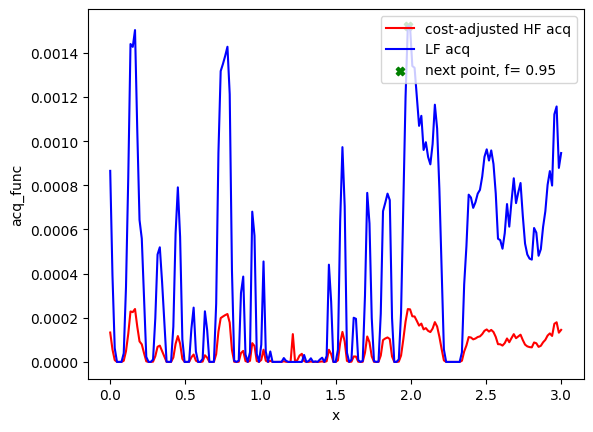

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132]
[1.98 0.95] 1.98
Evaluation 36 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.09it/s]


Completed. Saving
Time (s) to complete simulation 27: 24.247710466384888


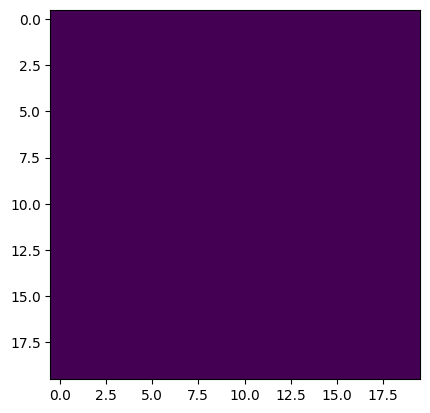

Step:27


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 48.82it/s, 15 steps of size 2.41e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.16      0.08      0.15      0.04      0.28     72.77      1.00
         b      1.07      0.49      1.16      0.02      1.53     83.68      1.00
         c      1.13      1.05      0.68      0.15      2.81     61.93      1.00
     delta      0.88      0.10      0.91      0.73      1.00    490.96      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    316.66      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    270.62      1.00
     noise      0.03      0.02      0.02      0.00      0.05    260.02      1.00



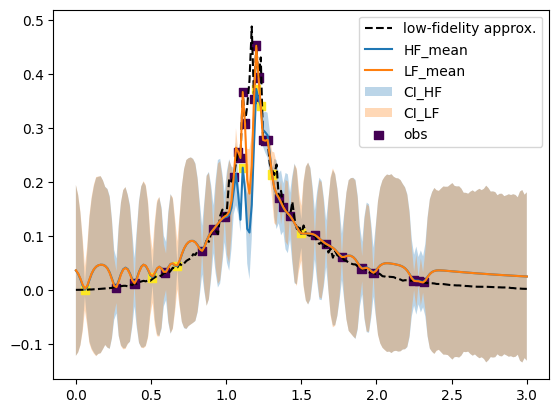

(402,)


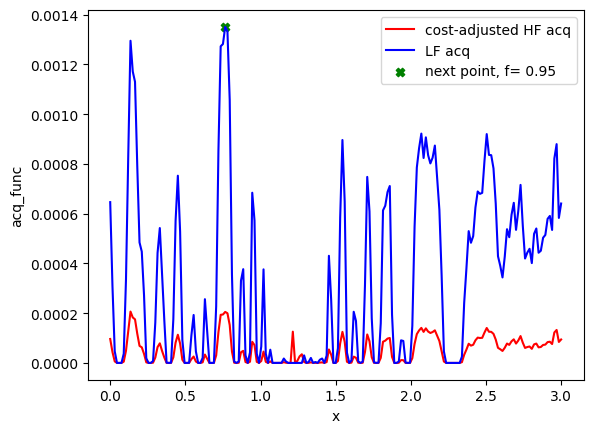

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51]
[0.765 0.95 ] 0.765
Evaluation 37 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.21it/s]


Completed. Saving
Time (s) to complete simulation 28: 23.80518102645874


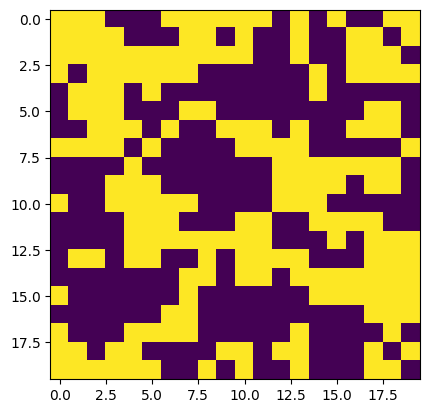

Step:28


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:26<00:00, 37.98it/s, 31 steps of size 1.48e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.09      0.15      0.07      0.30    125.98      1.00
         b      1.14      0.48      1.19      0.19      1.58    183.71      1.01
         c      0.94      0.93      0.51      0.10      2.27     84.34      1.01
     delta      0.89      0.10      0.91      0.74      1.00    471.39      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    182.93      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    119.38      1.00
     noise      0.02      0.02      0.02      0.00      0.05    323.06      1.01



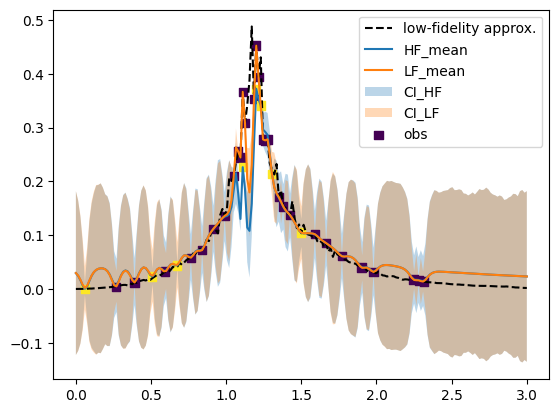

(402,)


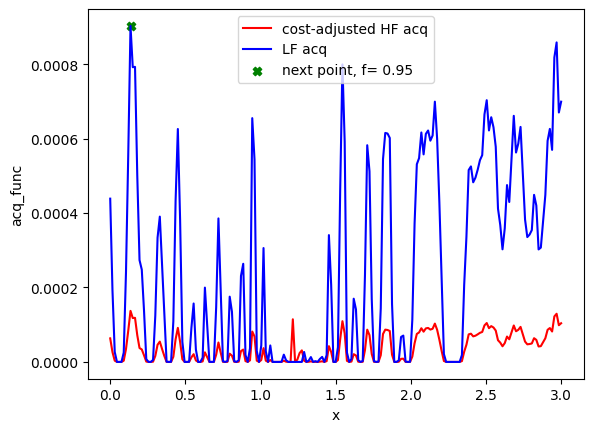

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9]
[0.135 0.95 ] 0.135
Evaluation 38 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.49it/s]


Completed. Saving
Time (s) to complete simulation 29: 24.424917459487915


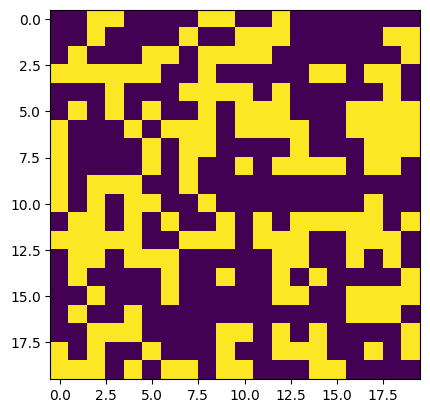

Step:29


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 51.63it/s, 15 steps of size 2.51e-01. acc. prob=0.65]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.07      0.14      0.05      0.25     66.84      1.00
         b      1.16      0.47      1.18      0.02      1.63    114.08      1.00
         c      1.13      1.05      0.67      0.15      2.82    110.97      1.00
     delta      0.88      0.10      0.91      0.73      1.00    244.77      1.00
  k_length      0.01      0.00      0.01      0.01      0.01     93.55      1.04
   k_scale      0.02      0.01      0.02      0.01      0.03    168.70      1.01
     noise      0.03      0.02      0.03      0.00      0.05    170.83      1.00



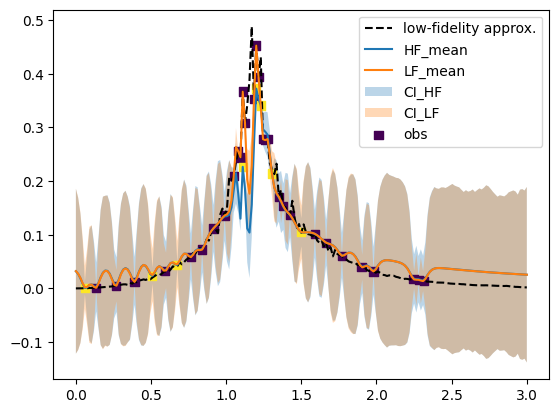

(402,)


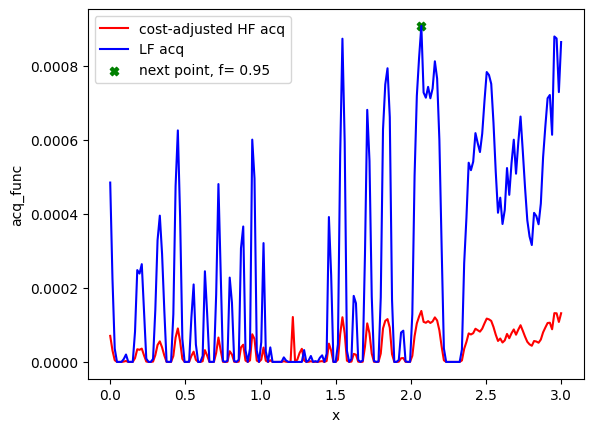

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138]
[2.07 0.95] 2.07
Evaluation 39 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 79.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.63it/s]


Completed. Saving
Time (s) to complete simulation 30: 23.166704177856445


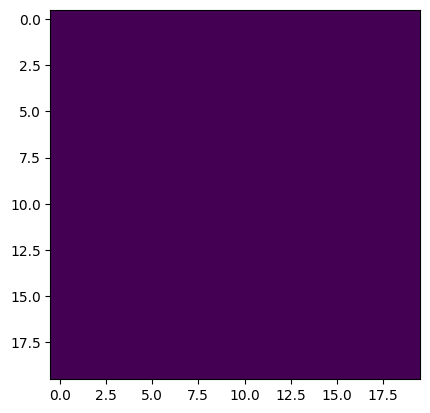

Step:30


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:27<00:00, 36.75it/s, 15 steps of size 1.67e-01. acc. prob=0.79]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.08      0.16      0.06      0.30     62.85      1.01
         b      1.18      0.44      1.21      0.30      1.71    222.57      1.00
         c      0.90      0.95      0.50      0.06      2.30     70.16      1.01
     delta      0.89      0.09      0.92      0.77      1.00    260.44      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    206.07      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    171.27      1.00
     noise      0.02      0.02      0.02      0.00      0.05    399.61      1.00



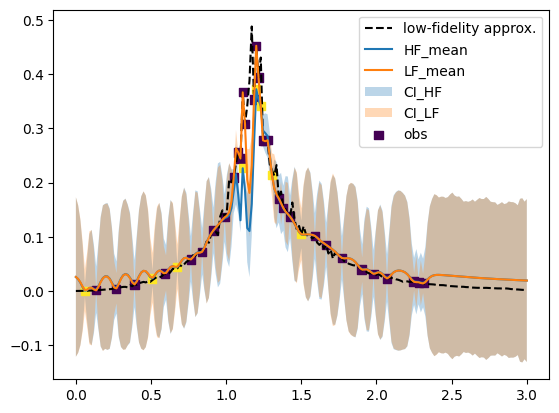

(402,)


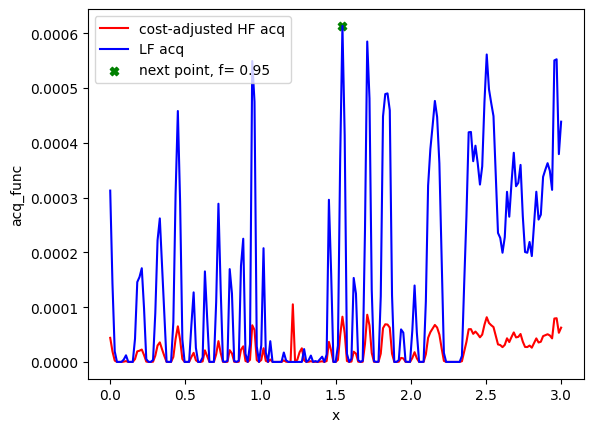

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138 103]
[1.545 0.95 ] 1.545
Evaluation 40 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 78.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.89it/s]


Completed. Saving
Time (s) to complete simulation 31: 23.108760118484497


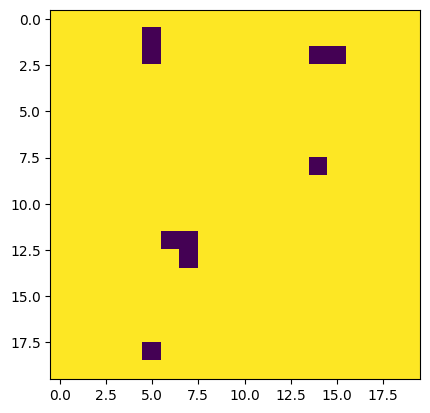

Step:31


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:22<00:00, 43.90it/s, 15 steps of size 1.72e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.08      0.16      0.07      0.31     33.01      1.02
         b      1.13      0.46      1.19      0.07      1.57     41.15      1.01
         c      1.00      1.03      0.49      0.06      2.62     23.99      1.01
     delta      0.89      0.09      0.92      0.76      1.00    394.60      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    230.65      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    122.13      1.00
     noise      0.02      0.02      0.02      0.00      0.05    292.66      1.00



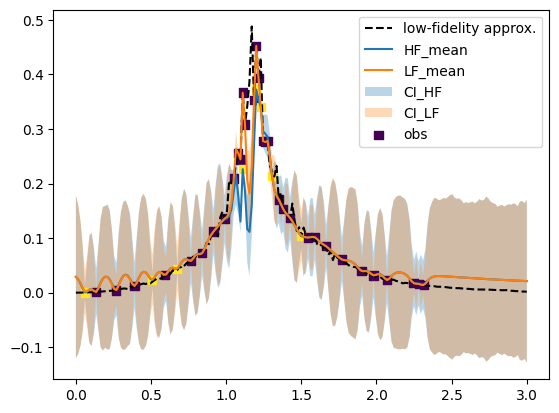

(402,)


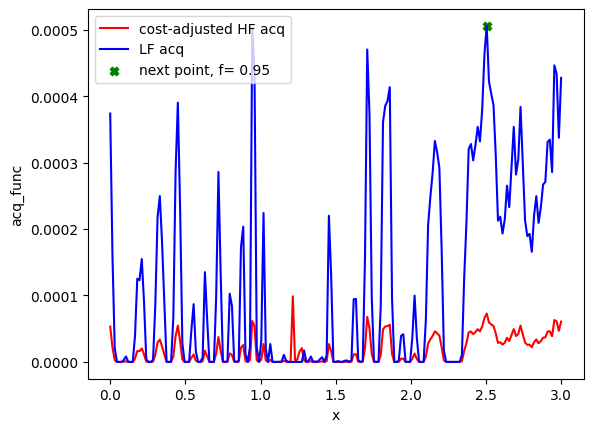

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138 103 167]
[2.505 0.95 ] 2.505
Evaluation 41 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.84it/s]


Completed. Saving
Time (s) to complete simulation 32: 23.2117178440094


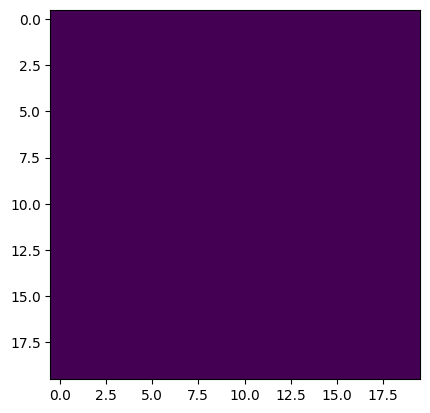

Step:32


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 46.32it/s, 15 steps of size 2.37e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.08      0.16      0.05      0.30     43.70      1.01
         b      1.07      0.39      1.17      0.35      1.65     33.01      1.00
         c      0.91      0.96      0.49      0.06      2.29     40.69      1.00
     delta      0.89      0.09      0.92      0.75      1.00    513.73      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    266.78      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    112.18      1.00
     noise      0.03      0.02      0.02      0.00      0.05    491.48      1.00



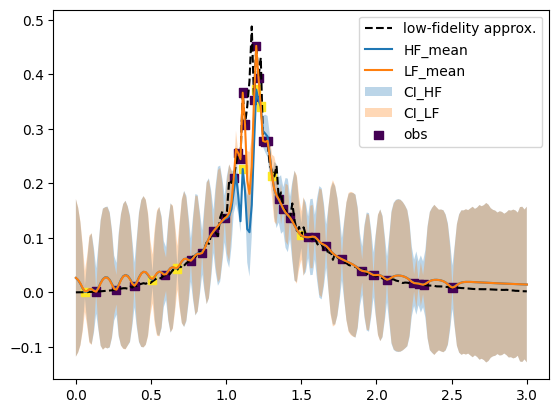

(402,)


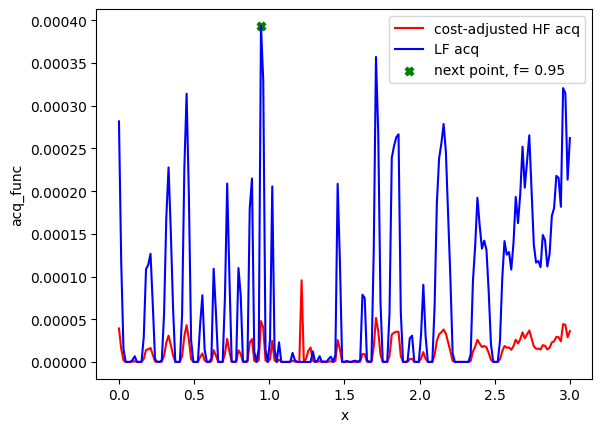

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138 103 167  63]
[0.945 0.95 ] 0.945
Evaluation 42 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.29it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.97it/s]


Completed. Saving
Time (s) to complete simulation 33: 23.82653498649597


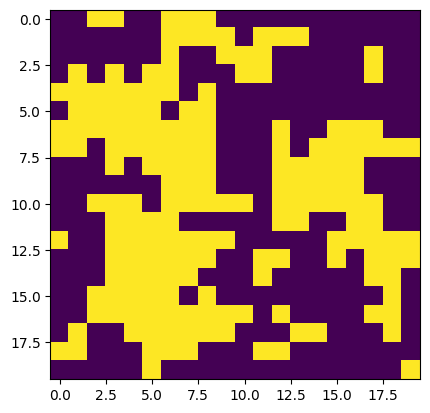

Step:33


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:24<00:00, 40.42it/s, 15 steps of size 1.92e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.07      0.18      0.08      0.30     99.86      1.02
         b      1.20      0.27      1.20      0.74      1.66    283.85      1.00
         c      0.69      0.77      0.40      0.11      1.59     96.52      1.03
     delta      0.90      0.09      0.92      0.77      1.00    258.71      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    296.17      1.00
   k_scale      0.02      0.01      0.02      0.01      0.02    218.18      1.01
     noise      0.03      0.02      0.02      0.00      0.05    500.06      1.00



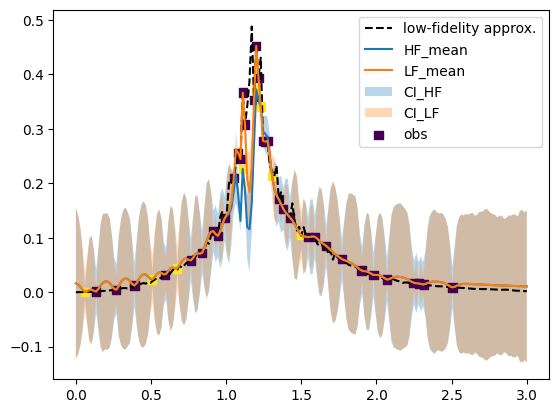

(402,)


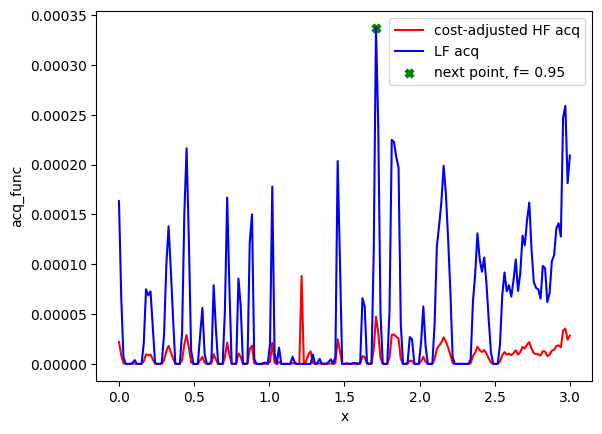

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138 103 167  63 114]
[1.71 0.95] 1.71
Evaluation 43 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.67it/s]


Completed. Saving
Time (s) to complete simulation 34: 23.29936909675598


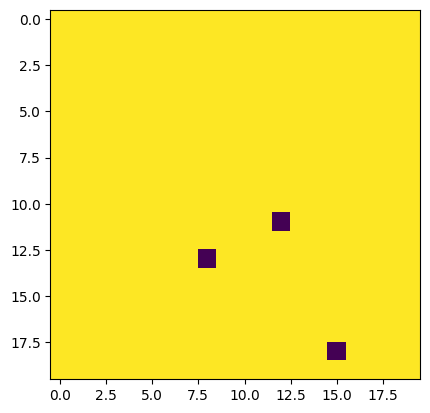

Step:34


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:25<00:00, 39.03it/s, 15 steps of size 2.36e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.08      0.19      0.06      0.30    108.89      1.00
         b      1.16      0.26      1.19      0.70      1.51    166.94      1.02
         c      0.64      0.65      0.39      0.10      1.54    111.47      1.00
     delta      0.90      0.08      0.93      0.79      1.00    472.15      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    314.81      1.00
   k_scale      0.02      0.00      0.02      0.01      0.02    242.58      1.01
     noise      0.02      0.02      0.02      0.00      0.05    460.50      1.00



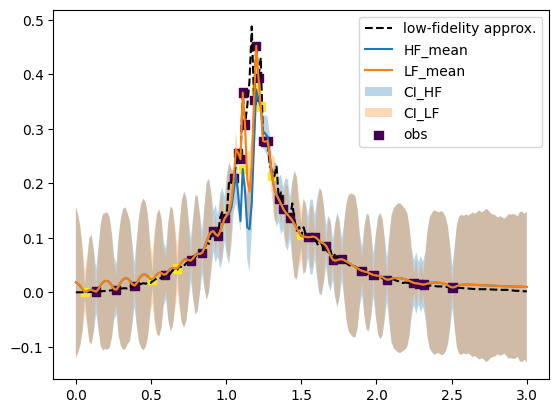

(402,)


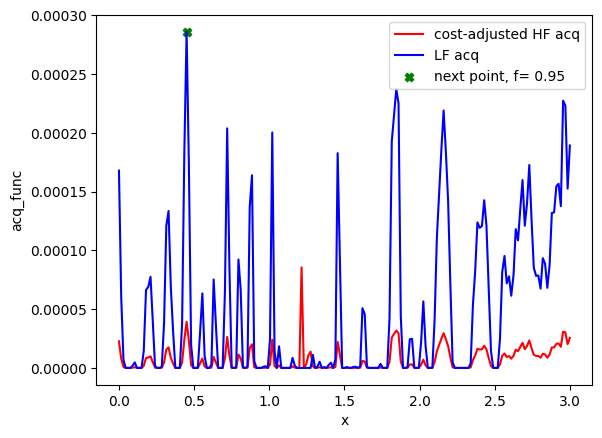

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138 103 167  63 114  30]
[0.45 0.95] 0.44999999999999996
Evaluation 44 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.94it/s]


Completed. Saving
Time (s) to complete simulation 35: 23.97846746444702


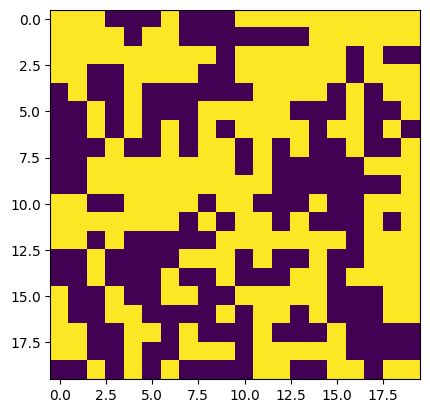

Step:35


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 50.10it/s, 15 steps of size 1.64e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.07      0.19      0.08      0.30     50.07      1.00
         b      1.13      0.32      1.19      0.58      1.63     48.47      1.00
         c      0.72      0.94      0.37      0.10      1.81     35.21      1.00
     delta      0.90      0.09      0.92      0.76      1.00    275.71      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    315.18      1.00
   k_scale      0.02      0.00      0.02      0.01      0.02    258.58      1.00
     noise      0.02      0.02      0.02      0.00      0.05    407.60      1.00



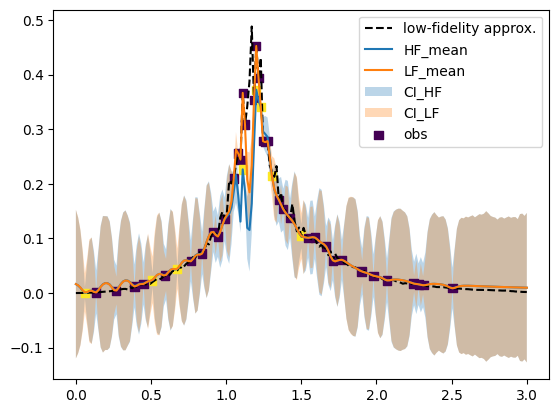

(402,)


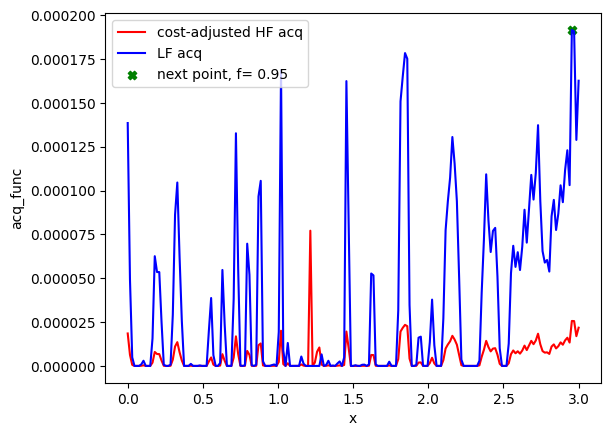

[ 79  80 288 283 281  66  92 111  72  61  81  84  75  74  73  70 106  95
  56  90  83  85 275  26 118 132  51   9 138 103 167  63 114  30 197]
[2.955 0.95 ] 2.955
Evaluation 45 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 78.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.28it/s]


Completed. Saving
Time (s) to complete simulation 36: 23.44834017753601


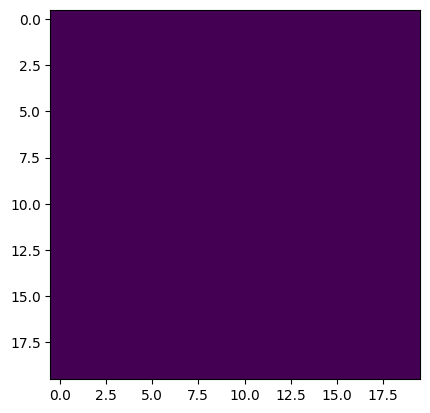

In [ ]:
N = 35
cost_ratio = 8.6/1 #time complexities
f = np.array([1.0, 2.0])
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_lf, X_test_hf))
X_test_full = np.vstack((X_test_lf, X_test_hf))
X_test_norm = np.vstack((X_test_lf, X_test_hf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                            noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.plot(xs, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 49.33it/s, 15 steps of size 2.28e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.20      0.08      0.20      0.07      0.31     45.91      1.00
         b      1.18      0.25      1.21      0.94      1.55     63.20      1.02
         c      0.57      0.73      0.35      0.06      1.05     22.96      1.02
     delta      0.91      0.08      0.93      0.79      1.00    369.22      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    276.42      1.00
   k_scale      0.02      0.00      0.01      0.01      0.02    229.45      1.00
     noise      0.03      0.02      0.02      0.00      0.05    379.24      1.00



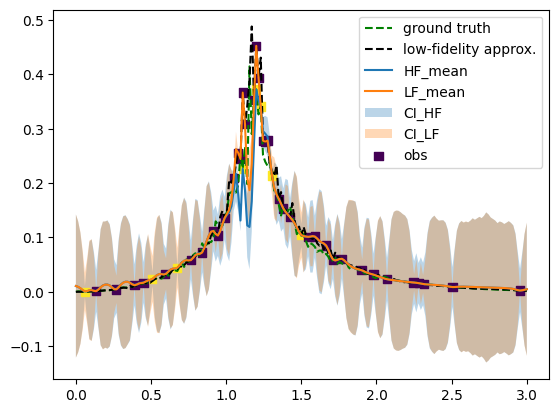

In [ ]:
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)
y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, true_ys_sq, "g--", label="ground truth")
plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

plt.legend(loc="best")
plt.show()

In [ ]:
train_x_full

array([[2.31396193, 0.95      ],
       [0.06225585, 1.        ],
       [1.9009447 , 0.95      ],
       [2.24641165, 0.95      ],
       [1.49552104, 1.        ],
       [0.67438994, 1.        ],
       [0.59418859, 0.95      ],
       [2.28159214, 0.95      ],
       [0.50733251, 1.        ],
       [0.26501944, 0.95      ],
       [1.185     , 0.95      ],
       [1.2       , 0.95      ],
       [1.305     , 1.        ],
       [1.23      , 1.        ],
       [1.2       , 1.        ],
       [0.99      , 0.95      ],
       [1.38      , 0.95      ],
       [1.665     , 0.95      ],
       [1.08      , 0.95      ],
       [0.915     , 0.95      ],
       [1.215     , 0.95      ],
       [1.26      , 0.95      ],
       [1.125     , 0.95      ],
       [1.11      , 0.95      ],
       [1.095     , 0.95      ],
       [1.05      , 0.95      ],
       [1.59      , 0.95      ],
       [1.425     , 0.95      ],
       [0.84      , 0.95      ],
       [1.35      , 0.95      ],
       [1.

0.000785245887795629


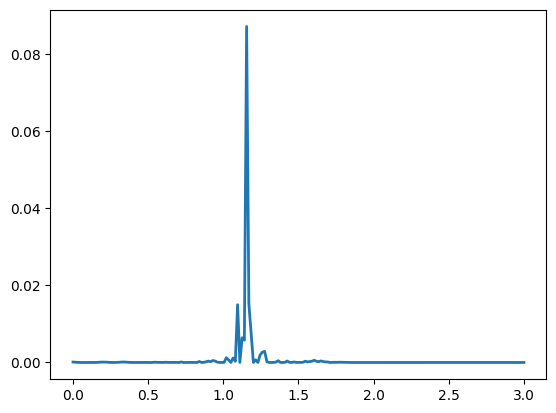

In [ ]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# MFBO with structured GP
- Wrong low-fid model

In [ ]:
n = 10

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]))

<ipython-input-13-e92e699ff3a4>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],
<ipython-input-13-e92e699ff3a4>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,Jx[i],0,Jx[i],0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:10<00:00,  7.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:26<00:00,  5.80it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 1: 156.92913627624512


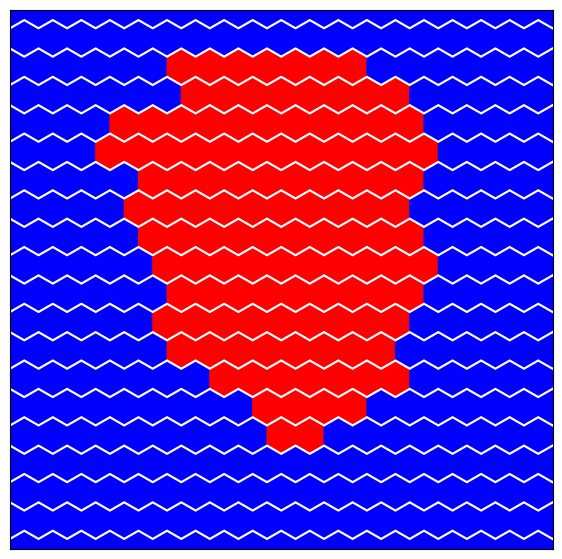

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:55<00:00,  2.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [08:23<00:00,  1.01s/it]

Completed. Saving
Time (s) to complete simulation 2: 678.9544885158539


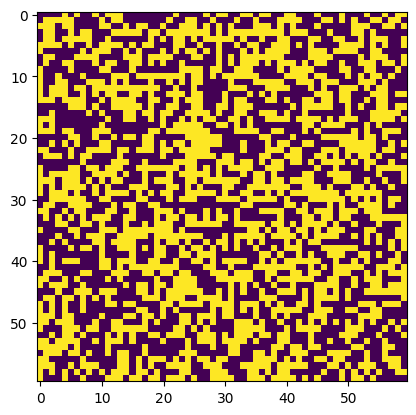

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:10<00:00,  7.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:25<00:00,  5.83it/s]


Completed. Saving
Time (s) to complete simulation 3: 155.83167219161987


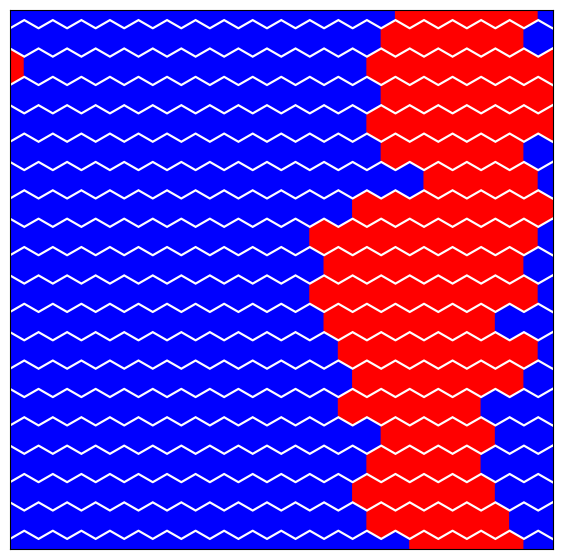

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:09<00:00,  7.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:25<00:00,  5.84it/s]


Completed. Saving
Time (s) to complete simulation 4: 155.2975583076477


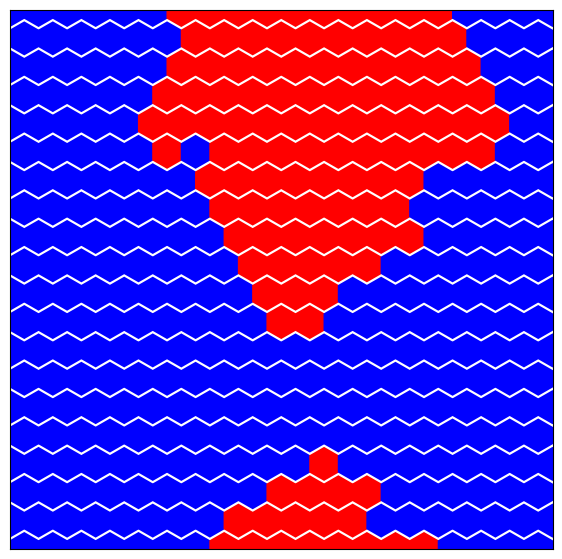

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:45<00:00,  3.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [08:03<00:00,  1.03it/s]

Completed. Saving
Time (s) to complete simulation 5: 648.6131641864777


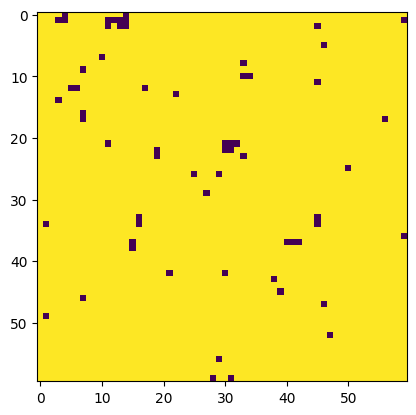

Evaluation 6 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:48<00:00,  2.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [08:08<00:00,  1.02it/s]

Completed. Saving
Time (s) to complete simulation 6: 656.7449781894684


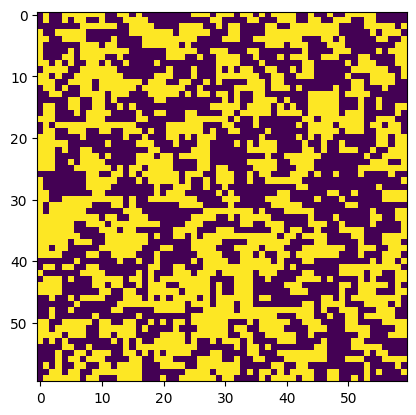

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:10<00:00,  7.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:25<00:00,  5.86it/s]


Completed. Saving
Time (s) to complete simulation 7: 156.13284420967102


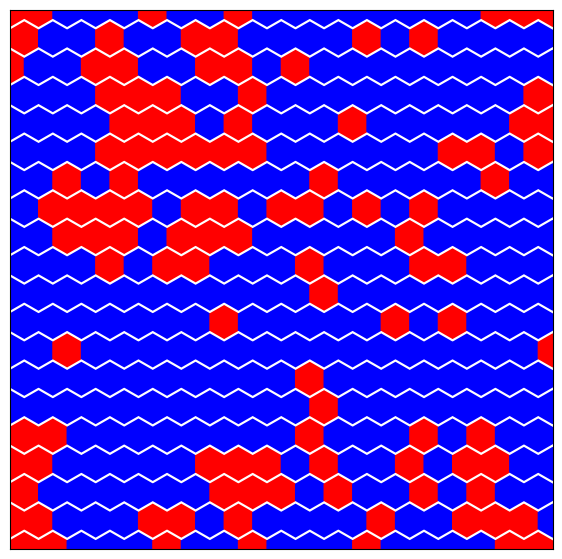

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:10<00:00,  7.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:24<00:00,  5.90it/s]


Completed. Saving
Time (s) to complete simulation 8: 155.25475001335144


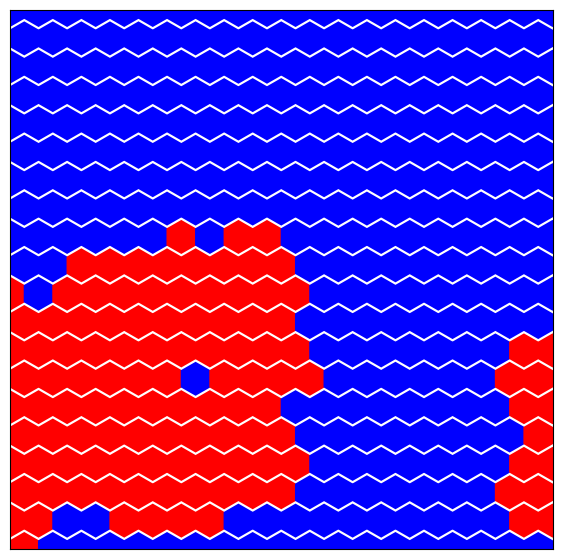

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:47<00:00,  2.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [08:07<00:00,  1.03it/s]

Completed. Saving
Time (s) to complete simulation 9: 654.7035422325134


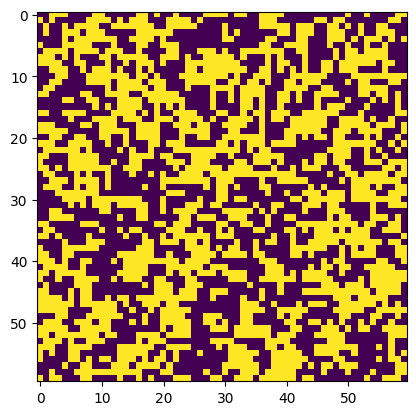

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:09<00:00,  7.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:24<00:00,  5.94it/s]


Completed. Saving
Time (s) to complete simulation 10: 154.00166058540344


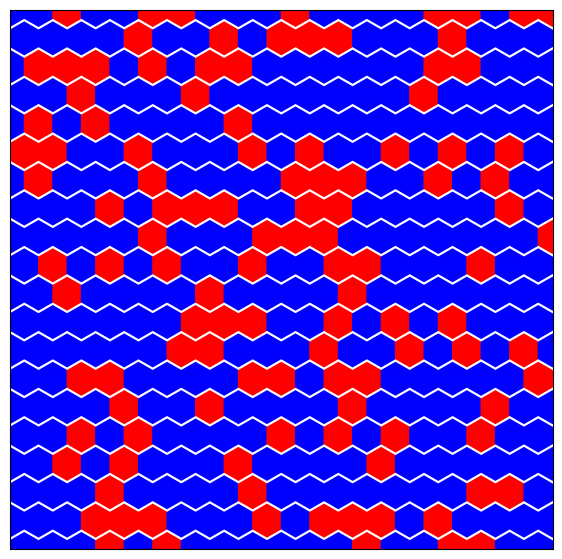

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        J_mat = np.array([[0,Jx[i],0,Jx[i],0],
                  [Jx[i],0,0,0,Jx[i]],
                  [0,Jx[i],0,Jx[i],0]])
        tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
        sq_sim = tri_sim

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    if train_x_full[i,1] == 1: #High fidelity
        plt.imshow(resultsBO_dict[i]['sim']['config'][-1])

    else: #Low fidelity
        sq_sim.plot_config(resultsBO_dict[i]['sim']['config'][-1])



    plt.show()

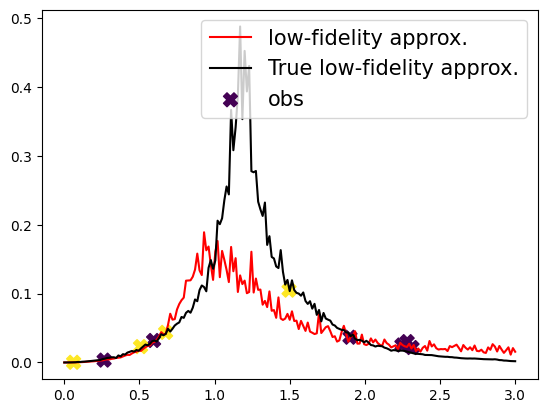

In [ ]:
plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")

plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

# GP mean function
- Gaussian peak

In [ ]:
@jit
def mean_func(x, params):

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    lb = 0
    ub = 3
    x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)
    f = params["a"]*jnp.exp((-1/2)*(jnp.square(x_data-params["b"])/jnp.square(params["c"])))

    return  f


def mf_priors():
    a = numpyro.sample("a", numpyro.distributions.HalfNormal(0.5)) #Height of peak
    b = numpyro.sample("b", numpyro.distributions.HalfNormal(1.17)) #Position of peak
    c = numpyro.sample("c", numpyro.distributions.HalfNormal(2)) #Broadness of peak
    return {"a": a, "b": b, "c": c}

# Run BO 35 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]),
 array([[0.02171349],
        [0.00025922],
        [0.03666318],
        [0.02538378],
        [0.10503485],
        [0.04375014],
        [0.03195398],
        [0.03032168],
        [0.02304033],
        [0.00343884]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:22<00:00, 43.48it/s, 15 steps of size 2.00e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.12      0.11      0.09      0.00      0.24    137.95      1.00
         b      0.92      0.61      0.84      0.06      1.70    163.46      1.00
         c      1.41      1.31      0.99      0.03      3.29    323.71      1.00
     delta      0.39      0.27      0.35      0.01      0.81    326.99      1.00
  k_length      0.12      0.09      0.10      0.04      0.20     86.91      1.00
   k_scale      0.03      0.07      0.02      0.01      0.05    253.20      1.01
     noise      0.03      0.02      0.02      0.00      0.05    330.98      1.00



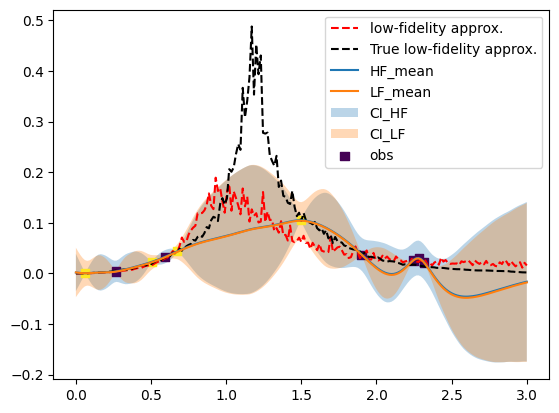

(402,)


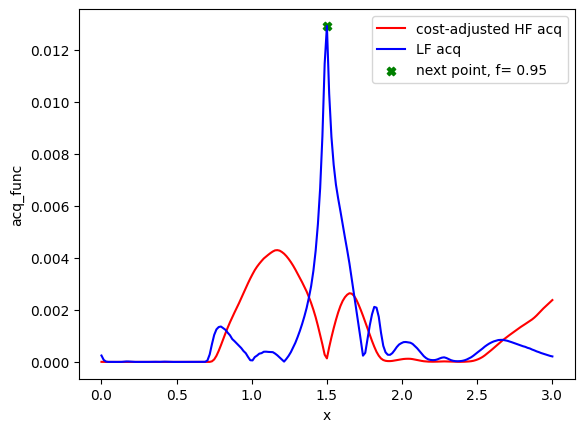

100
[1.5  0.95] 1.5
Evaluation 11 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 17.01it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 2: 55.004388093948364


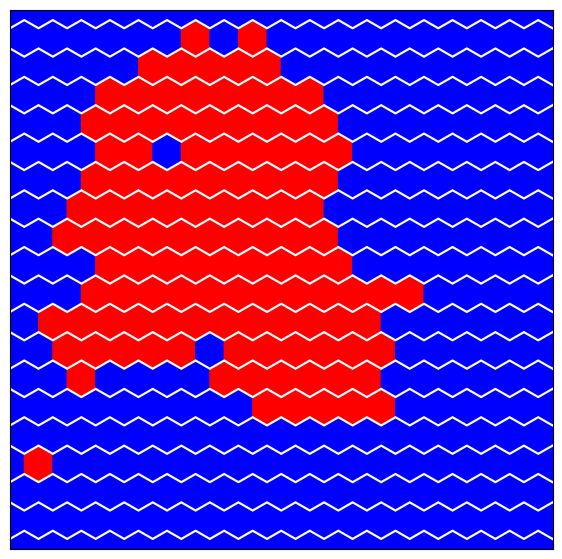

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:26<00:00, 37.41it/s, 31 steps of size 1.63e-01. acc. prob=0.84]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.17      0.19      0.11      0.00      0.39     25.74      1.03
         b      0.92      0.61      0.92      0.04      1.77    110.75      1.00
         c      1.22      1.15      0.82      0.01      2.86    126.30      1.01
     delta      0.57      0.24      0.57      0.26      1.00    181.05      1.00
  k_length      0.18      0.21      0.11      0.03      0.51     37.07      1.00
   k_scale      0.04      0.09      0.02      0.01      0.09    153.55      1.00
     noise      0.03      0.02      0.02      0.00      0.05    301.95      1.00



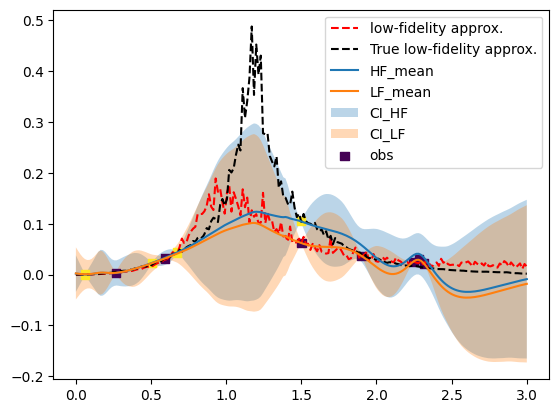

(402,)


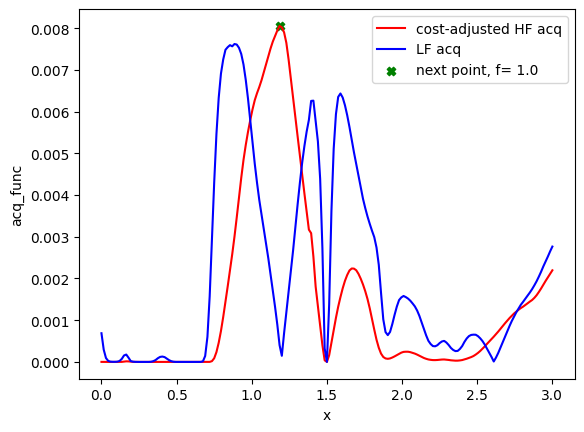

[100 280]
[1.185 1.   ] 1.185
Evaluation 12 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:35<00:00,  3.23it/s]

Completed. Saving
Time (s) to complete simulation 3: 214.22721672058105


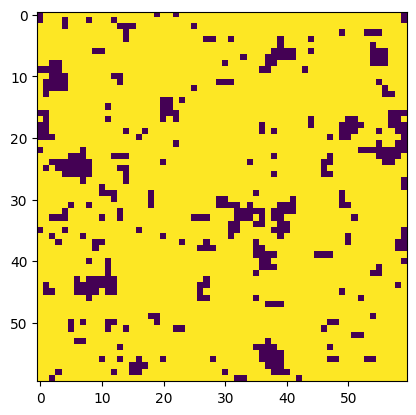

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:35<00:00, 28.11it/s, 7 steps of size 1.40e-01. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.15      0.16      0.00      0.41     83.56      1.01
         b      0.93      0.59      1.00      0.00      1.62    108.29      1.00
         c      1.16      1.18      0.74      0.01      2.86    125.90      1.00
     delta      0.53      0.26      0.51      0.18      0.98    159.33      1.00
  k_length      0.10      0.04      0.10      0.05      0.15    215.66      1.00
   k_scale      0.04      0.07      0.03      0.01      0.08    238.91      1.00
     noise      0.02      0.02      0.02      0.00      0.05    233.27      1.00



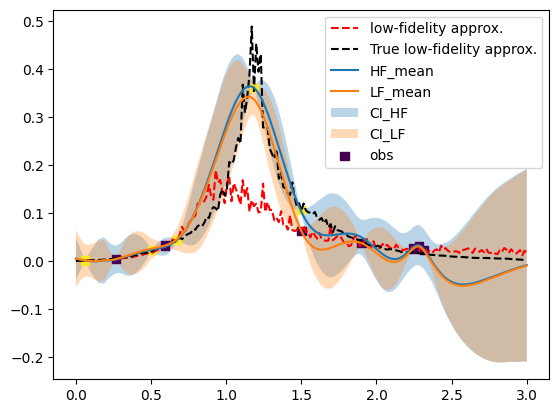

(402,)


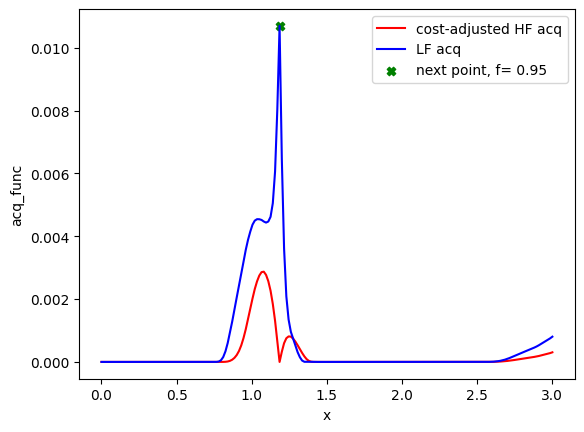

[100 280  79]
[1.185 0.95 ] 1.185
Evaluation 13 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.18it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 4: 57.897881269454956


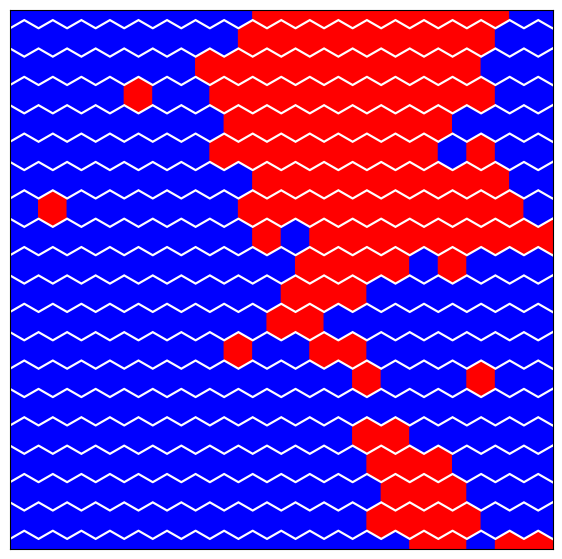

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:25<00:00, 38.81it/s, 15 steps of size 2.69e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.23      0.19      0.19      0.00      0.49    398.32      1.00
         b      0.92      0.67      0.78      0.03      1.92    349.34      1.00
         c      1.53      1.16      1.23      0.06      3.11    370.33      1.00
     delta      0.79      0.16      0.82      0.55      1.00    382.54      1.00
  k_length      0.14      0.04      0.14      0.07      0.21    281.08      1.00
   k_scale      0.24      0.20      0.17      0.04      0.52    203.17      1.00
     noise      0.02      0.02      0.02      0.00      0.05    267.94      1.00



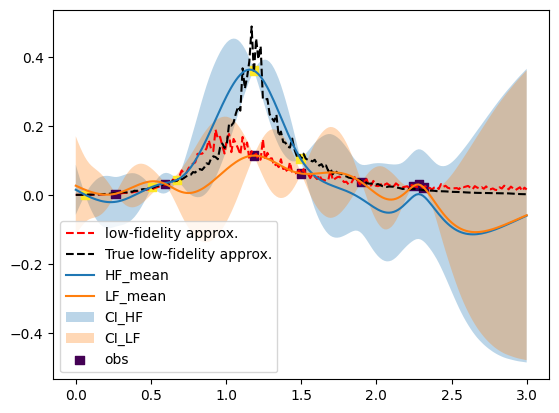

(402,)


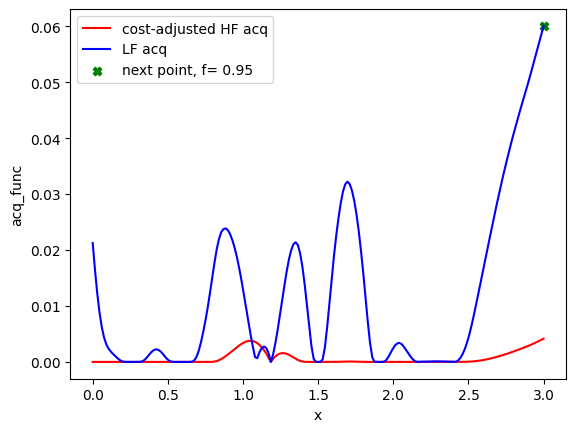

[100 280  79 200]
[3.   0.95] 3.0
Evaluation 14 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.27it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 5: 56.5353045463562


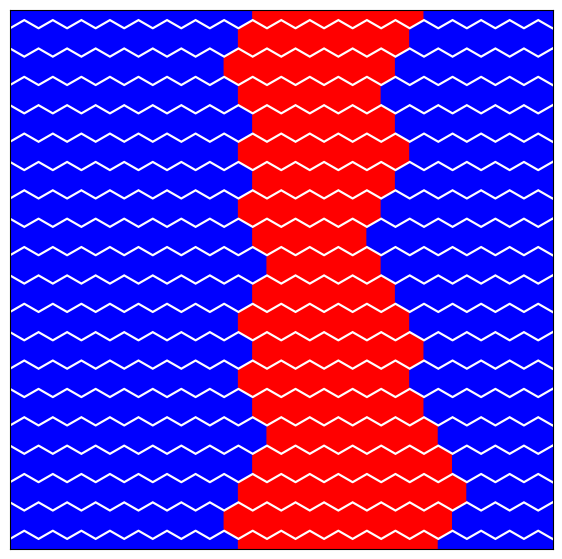

Step:5


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:26<00:00, 37.54it/s, 15 steps of size 2.79e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.18      0.17      0.00      0.46    241.21      1.02
         b      0.92      0.66      0.82      0.03      1.81    245.94      1.01
         c      1.47      1.10      1.18      0.03      3.04    332.36      1.00
     delta      0.80      0.16      0.84      0.58      1.00    694.29      1.00
  k_length      0.14      0.04      0.13      0.07      0.20    233.11      1.00
   k_scale      0.22      0.19      0.15      0.03      0.45    197.97      1.00
     noise      0.02      0.02      0.02      0.00      0.05    310.63      1.00



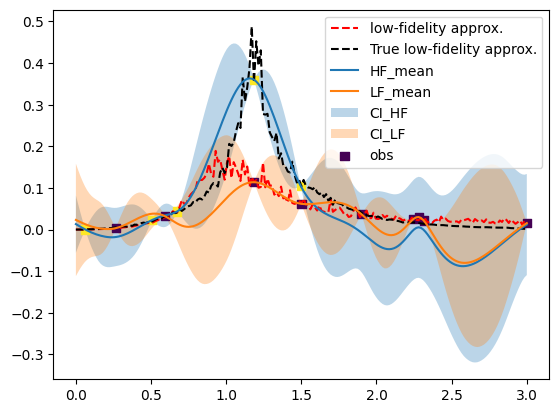

(402,)


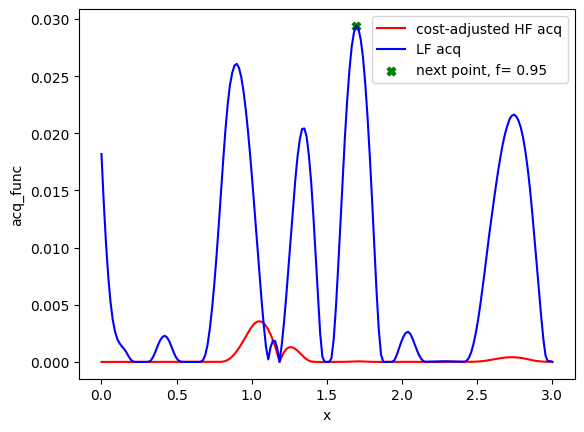

[100 280  79 200 113]
[1.695 0.95 ] 1.6949999999999998
Evaluation 15 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.31it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.21it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 6: 56.74994158744812


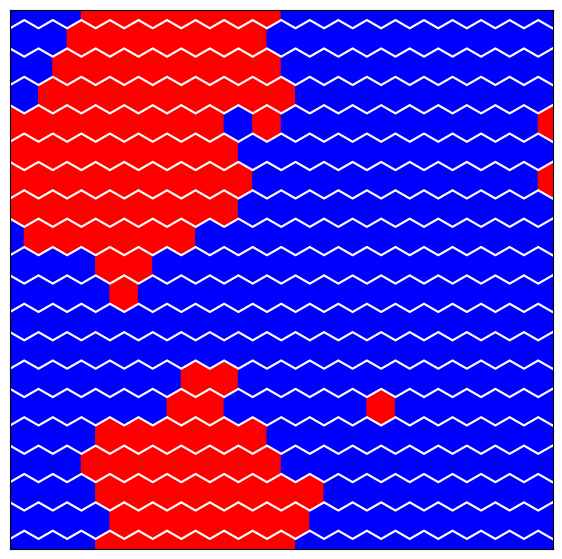

Step:6


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:29<00:00, 33.67it/s, 15 steps of size 2.35e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.22      0.17      0.18      0.00      0.45    331.80      1.00
         b      0.88      0.67      0.74      0.00      1.85    223.53      1.00
         c      1.50      1.13      1.16      0.10      3.14    456.41      1.00
     delta      0.80      0.16      0.84      0.54      1.00    394.90      1.00
  k_length      0.14      0.04      0.14      0.08      0.22    259.77      1.00
   k_scale      0.22      0.19      0.15      0.03      0.49    201.11      1.00
     noise      0.02      0.02      0.02      0.00      0.05    422.12      1.00



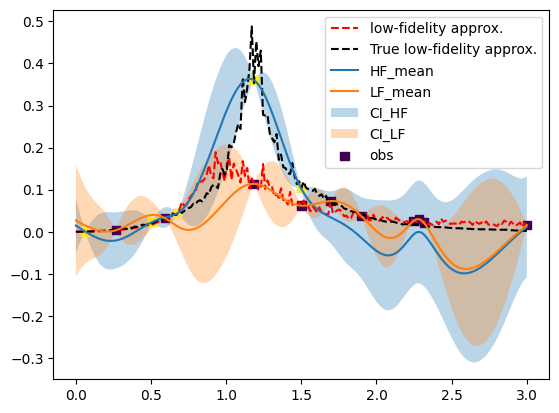

(402,)


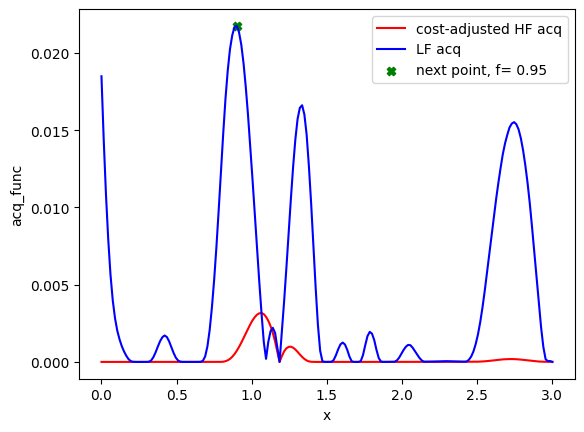

[100 280  79 200 113  60]
[0.9  0.95] 0.8999999999999999
Evaluation 16 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.60it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 7: 56.30123209953308


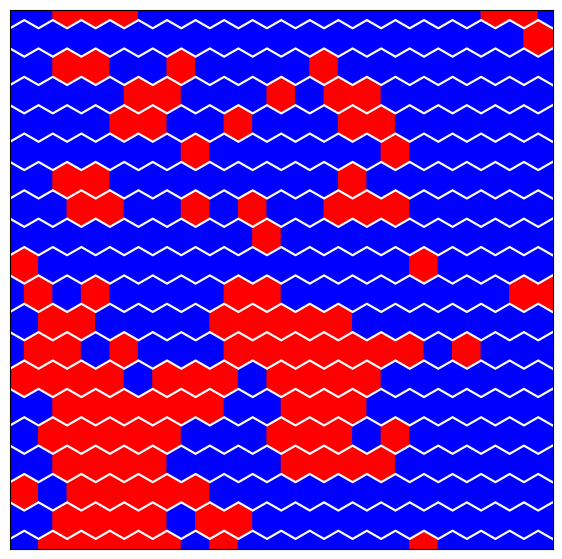

Step:7


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 61.06it/s, 7 steps of size 3.14e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.17      0.18      0.00      0.44    275.19      1.01
         b      0.90      0.65      0.76      0.02      1.86    251.72      1.00
         c      1.51      1.15      1.19      0.02      3.18    286.81      1.00
     delta      0.82      0.15      0.86      0.61      1.00    409.22      1.00
  k_length      0.14      0.04      0.14      0.07      0.20    275.84      1.00
   k_scale      0.21      0.18      0.14      0.03      0.45    191.49      1.01
     noise      0.02      0.02      0.02      0.00      0.05    325.86      1.01



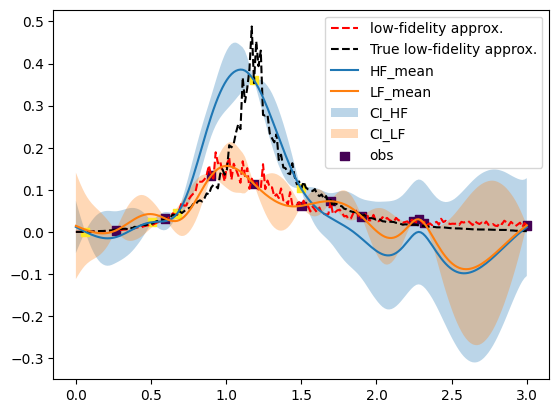

(402,)


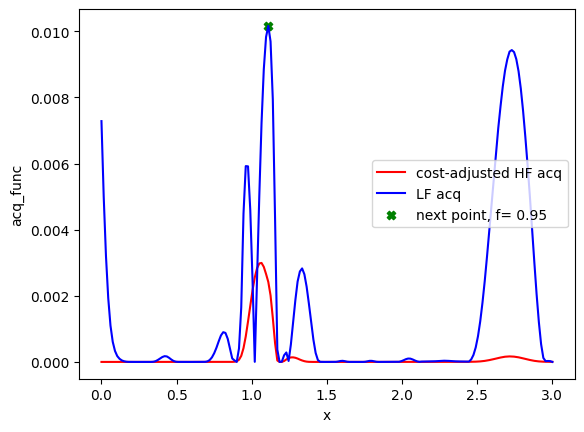

[100 280  79 200 113  60  74]
[1.11 0.95] 1.1099999999999999
Evaluation 17 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.21it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 8: 57.17835354804993


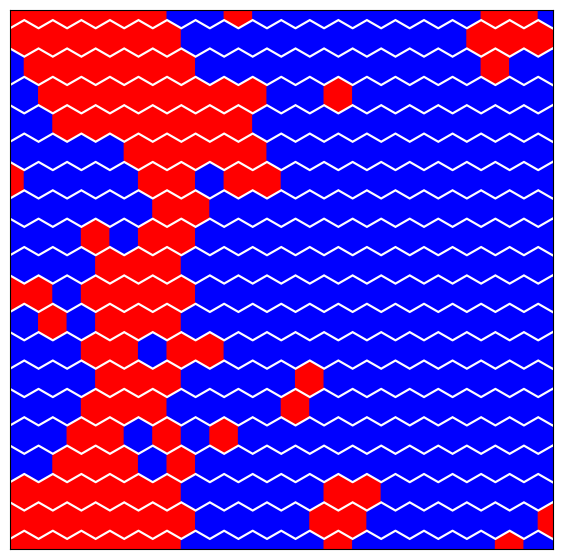

Step:8


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:36<00:00, 27.53it/s, 7 steps of size 2.15e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.23      0.17      0.17      0.00      0.49    278.95      1.00
         b      0.92      0.63      0.83      0.00      1.79    282.40      1.00
         c      1.44      1.12      1.13      0.08      2.94    297.31      1.00
     delta      0.82      0.15      0.87      0.61      1.00    203.36      1.01
  k_length      0.14      0.04      0.14      0.07      0.20    176.11      1.00
   k_scale      0.20      0.17      0.14      0.04      0.47    181.91      1.00
     noise      0.02      0.02      0.02      0.00      0.05    472.89      1.00



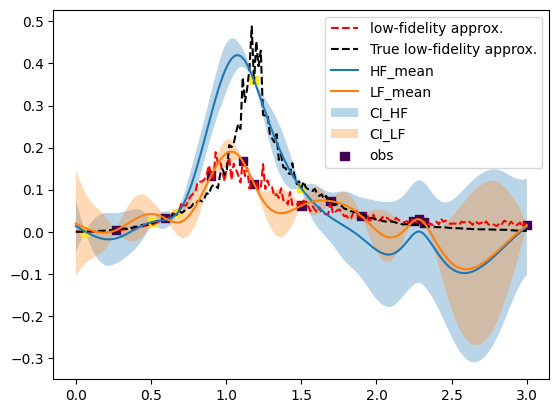

(402,)


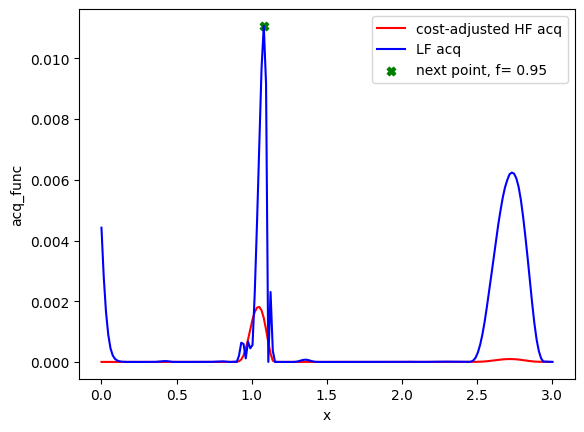

[100 280  79 200 113  60  74  72]
[1.08 0.95] 1.08
Evaluation 18 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.28it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 9: 57.01247811317444


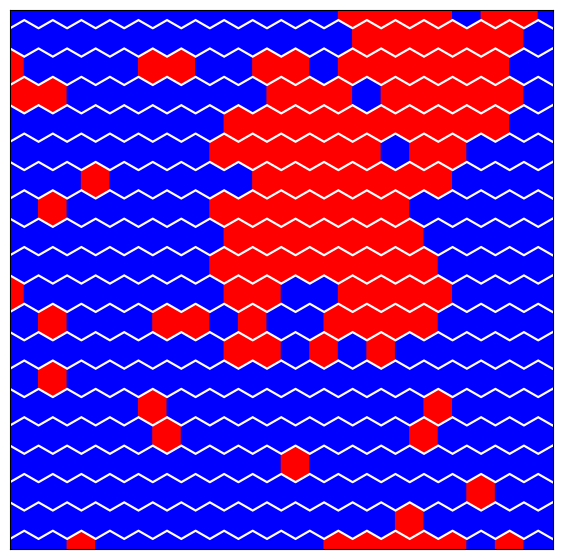

Step:9


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:37<00:00, 26.92it/s, 15 steps of size 2.39e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.15      0.14      0.00      0.37    210.36      1.00
         b      0.93      0.63      0.80      0.03      1.88    380.09      1.00
         c      1.39      1.13      1.07      0.07      3.12    556.43      1.00
     delta      0.81      0.15      0.85      0.57      0.99    356.07      1.00
  k_length      0.08      0.02      0.08      0.05      0.11    265.44      1.00
   k_scale      0.12      0.10      0.09      0.03      0.20    245.54      1.00
     noise      0.02      0.02      0.02      0.00      0.05    365.52      1.01



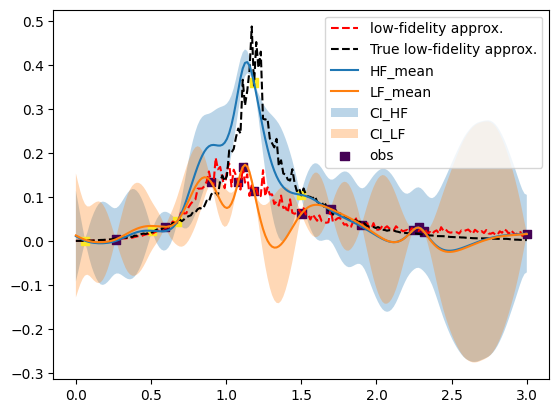

(402,)


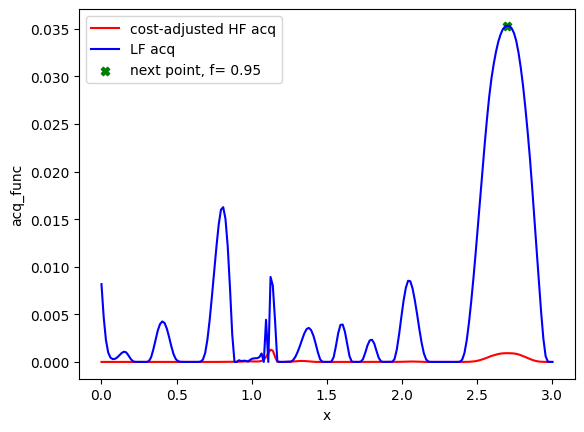

[100 280  79 200 113  60  74  72 180]
[2.7  0.95] 2.6999999999999997
Evaluation 19 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.44it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 10: 56.44183969497681


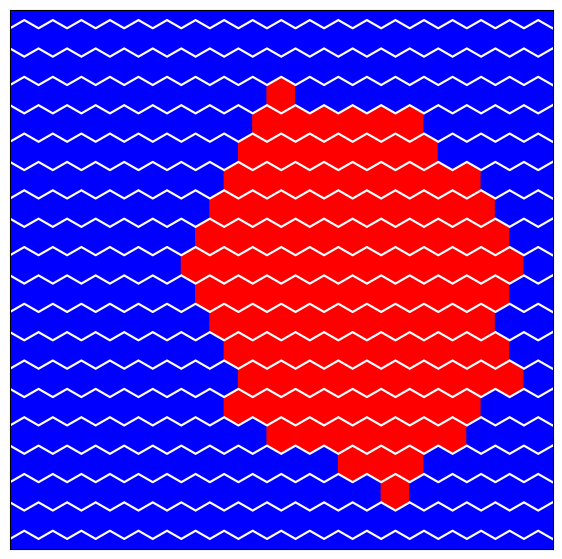

Step:10


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:44<00:00, 22.47it/s, 15 steps of size 2.34e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.12      0.13      0.00      0.34    264.34      1.00
         b      0.89      0.66      0.76      0.03      1.80    365.58      1.00
         c      1.46      1.20      1.18      0.09      3.33    571.23      1.00
     delta      0.83      0.14      0.86      0.60      1.00    297.60      1.00
  k_length      0.08      0.02      0.07      0.05      0.10    249.57      1.00
   k_scale      0.10      0.08      0.08      0.03      0.17    281.49      1.00
     noise      0.02      0.02      0.02      0.00      0.05    441.08      1.00



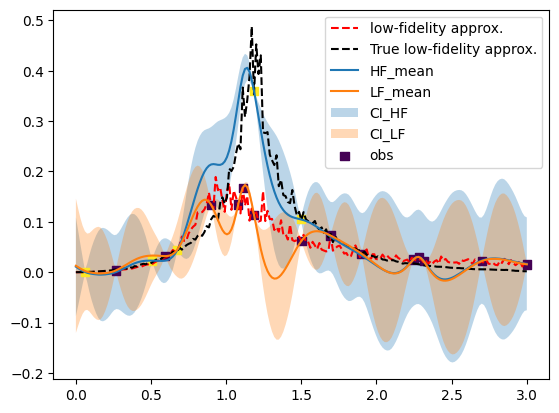

(402,)


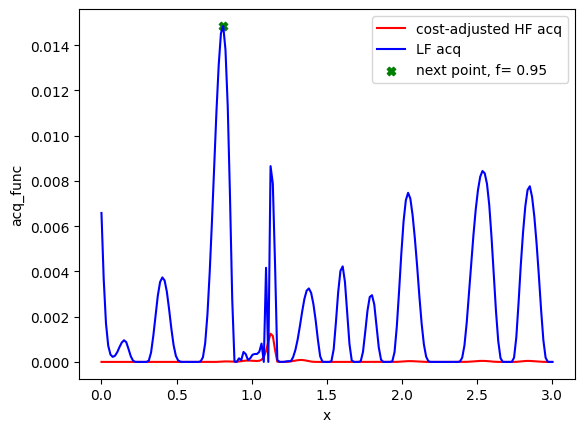

[100 280  79 200 113  60  74  72 180  54]
[0.81 0.95] 0.8099999999999999
Evaluation 20 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.35it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 11: 56.98932242393494


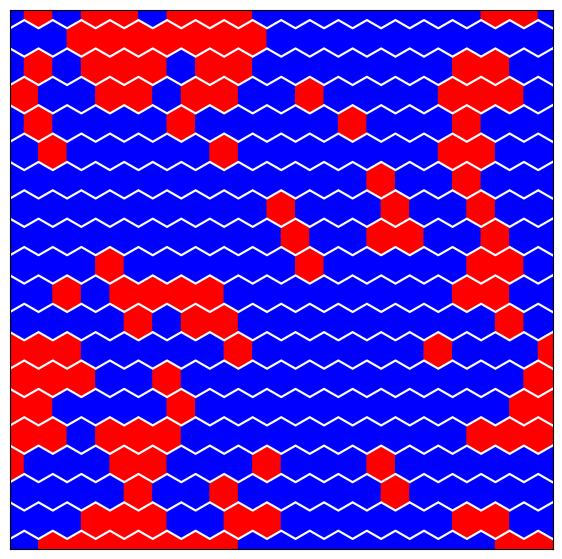

Step:11


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:40<00:00, 24.64it/s, 15 steps of size 2.53e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.16      0.13      0.13      0.00      0.34    413.51      1.00
         b      0.97      0.67      0.82      0.05      1.93    384.58      1.00
         c      1.49      1.19      1.13      0.08      3.22    499.07      1.00
     delta      0.83      0.15      0.86      0.62      1.00    324.86      1.00
  k_length      0.08      0.02      0.08      0.05      0.11    191.54      1.00
   k_scale      0.10      0.09      0.08      0.03      0.18    219.97      1.00
     noise      0.02      0.02      0.02      0.00      0.05    512.76      1.00



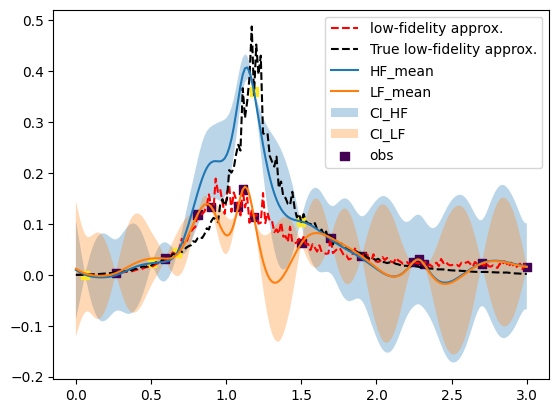

(402,)


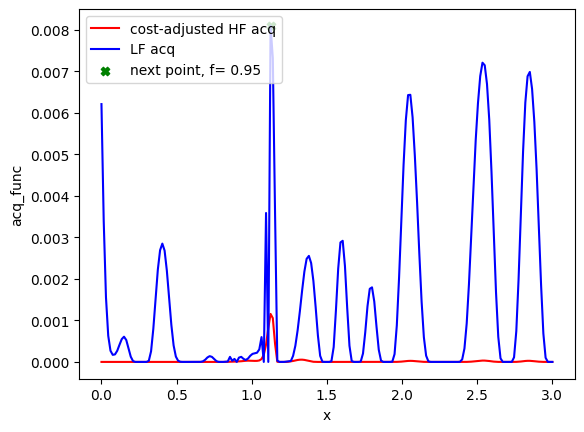

[100 280  79 200 113  60  74  72 180  54  75]
[1.125 0.95 ] 1.125
Evaluation 21 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.71it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 12: 55.5772967338562


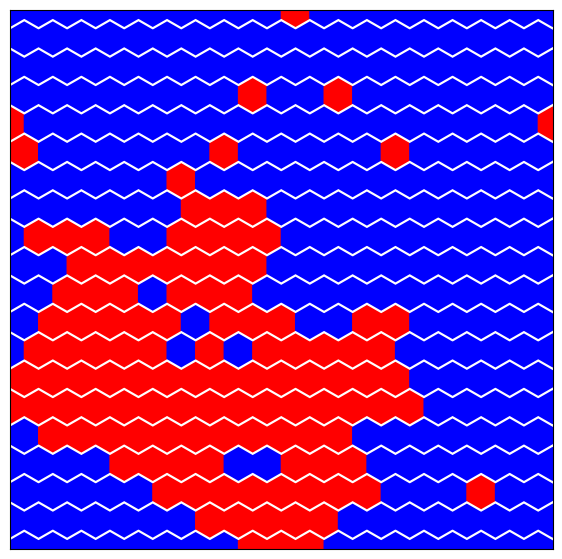

Step:12


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:44<00:00, 22.46it/s, 15 steps of size 2.29e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.13      0.09      0.11      0.00      0.26    292.90      1.00
         b      0.98      0.63      0.91      0.01      1.86    421.72      1.00
         c      1.44      1.15      1.17      0.02      3.10    410.36      1.00
     delta      0.85      0.13      0.88      0.64      0.99    398.79      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    280.59      1.00
   k_scale      0.07      0.04      0.06      0.03      0.12    330.24      1.00
     noise      0.03      0.02      0.02      0.00      0.05    540.02      1.00



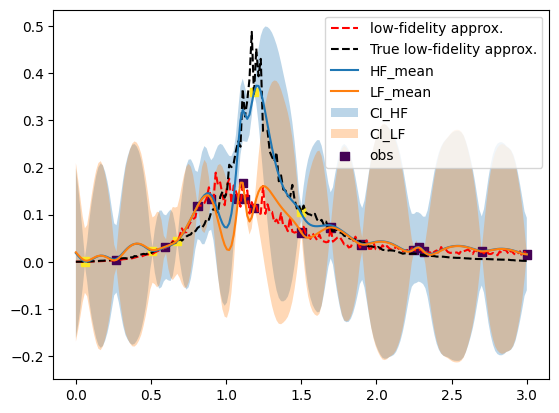

(402,)


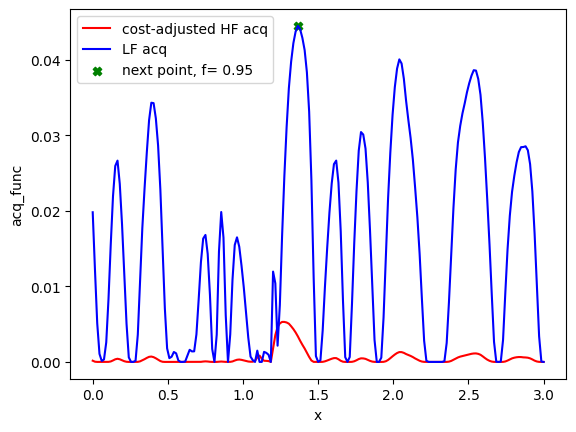

[100 280  79 200 113  60  74  72 180  54  75  91]
[1.365 0.95 ] 1.365
Evaluation 22 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:31<00:00, 16.12it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 13: 57.072449684143066


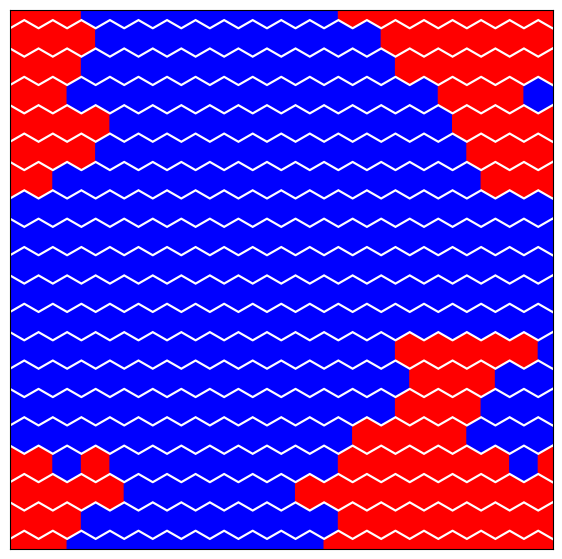

Step:13


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:44<00:00, 22.69it/s, 15 steps of size 2.46e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.13      0.10      0.11      0.00      0.25    216.22      1.00
         b      1.01      0.63      0.91      0.04      1.84    323.03      1.00
         c      1.40      1.18      1.03      0.06      3.08    241.73      1.00
     delta      0.86      0.12      0.90      0.70      1.00    517.88      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    298.20      1.00
   k_scale      0.06      0.03      0.06      0.03      0.11    396.23      1.00
     noise      0.02      0.02      0.02      0.00      0.05    455.96      1.00



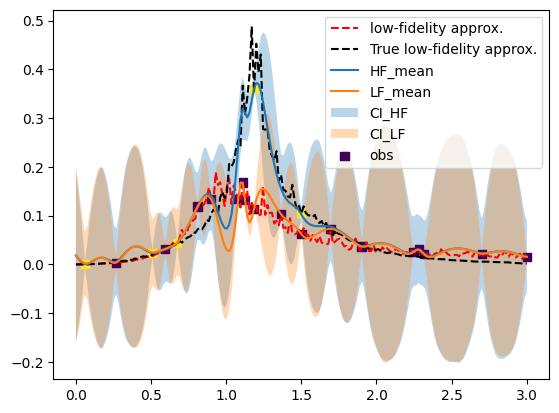

(402,)


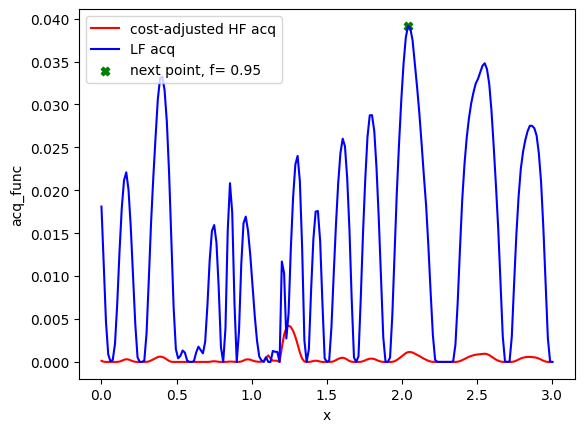

[100 280  79 200 113  60  74  72 180  54  75  91 136]
[2.04 0.95] 2.04
Evaluation 23 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.29it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 14: 57.45330023765564


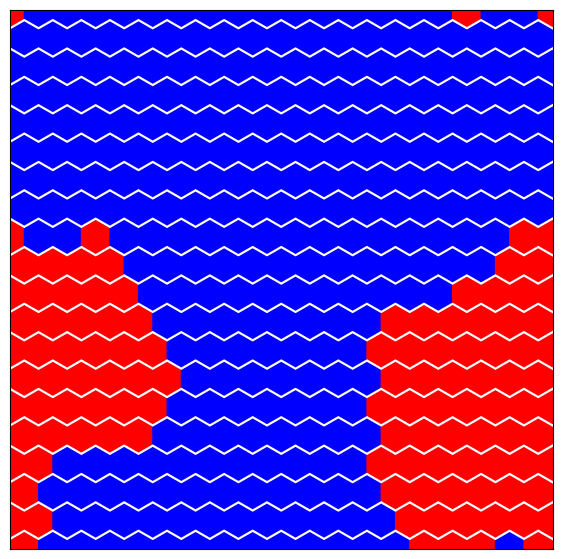

Step:14


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:46<00:00, 21.41it/s, 15 steps of size 2.59e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.13      0.11      0.11      0.00      0.24     76.65      1.02
         b      0.94      0.67      0.83      0.00      1.85    219.35      1.01
         c      1.39      1.22      1.07      0.01      3.10    304.99      1.00
     delta      0.87      0.11      0.90      0.73      1.00    377.84      1.00
  k_length      0.03      0.01      0.03      0.02      0.05    237.15      1.00
   k_scale      0.06      0.04      0.05      0.03      0.11    252.16      1.00
     noise      0.02      0.02      0.02      0.00      0.05    244.53      1.00



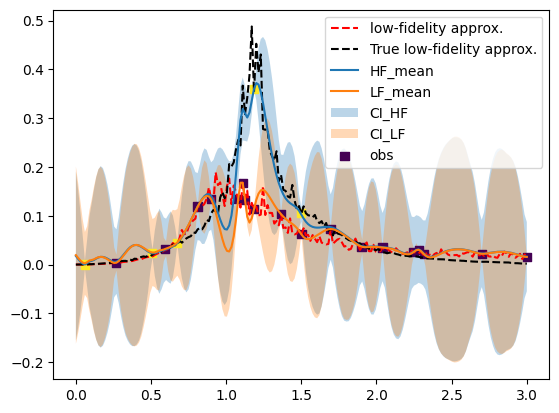

(402,)


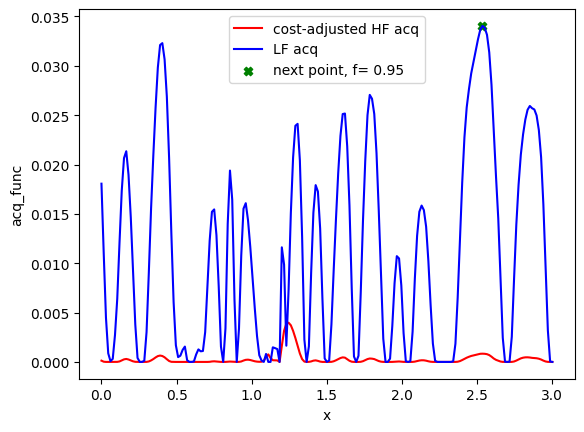

[100 280  79 200 113  60  74  72 180  54  75  91 136 169]
[2.535 0.95 ] 2.5349999999999997
Evaluation 24 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.39it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 15: 56.65355181694031


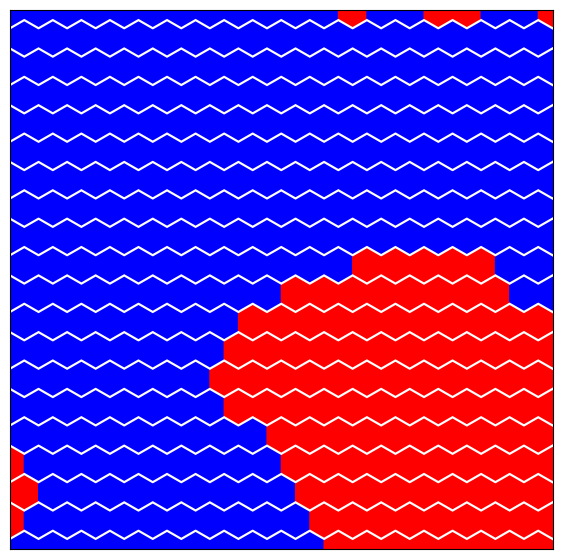

Step:15


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:57<00:00, 17.44it/s, 31 steps of size 1.90e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.13      0.09      0.11      0.01      0.25    307.06      1.01
         b      0.94      0.63      0.86      0.04      1.77    184.58      1.00
         c      1.32      1.15      0.99      0.01      3.07    197.69      1.02
     delta      0.88      0.10      0.91      0.75      1.00    536.67      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    219.51      1.02
   k_scale      0.06      0.03      0.05      0.02      0.09    306.26      1.00
     noise      0.02      0.02      0.02      0.00      0.05    371.69      1.00



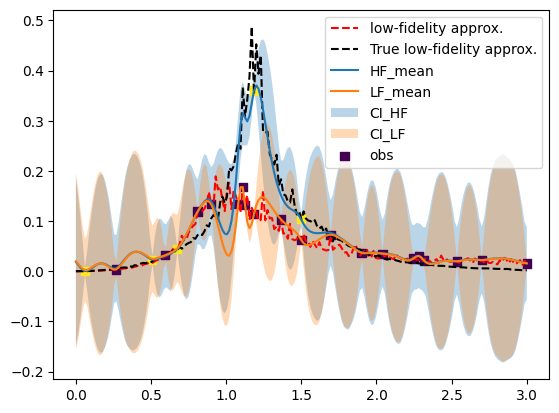

(402,)


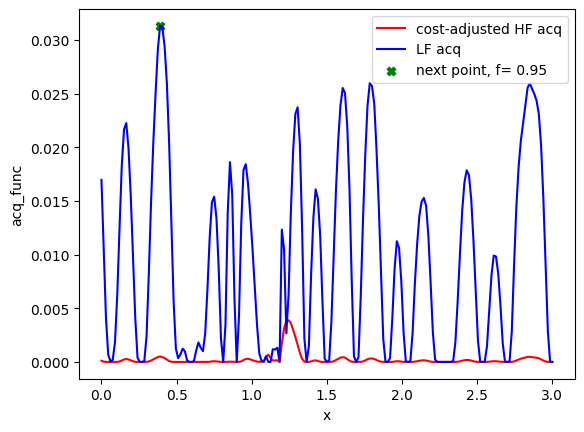

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26]
[0.39 0.95] 0.39
Evaluation 25 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.19it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 16: 57.43602156639099


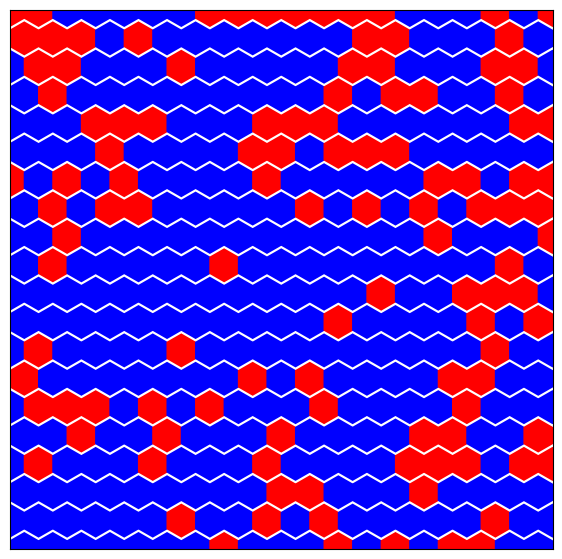

Step:16


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:52<00:00, 18.99it/s, 15 steps of size 2.67e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.10      0.00      0.23    206.92      1.00
         b      0.94      0.64      0.84      0.02      1.70    262.39      1.00
         c      1.41      1.14      1.10      0.05      3.01    517.71      1.00
     delta      0.88      0.11      0.91      0.74      1.00    388.55      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    196.84      1.00
   k_scale      0.05      0.03      0.05      0.02      0.08    344.21      1.00
     noise      0.03      0.02      0.02      0.00      0.05    470.78      1.00



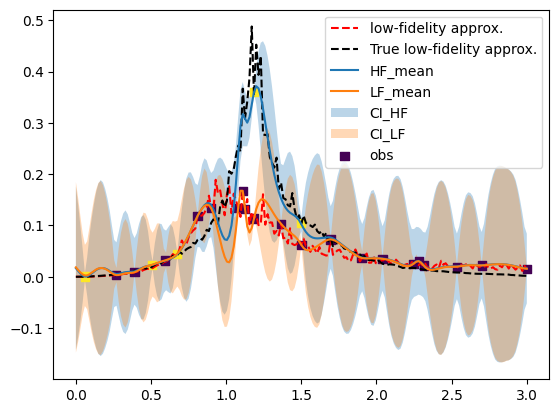

(402,)


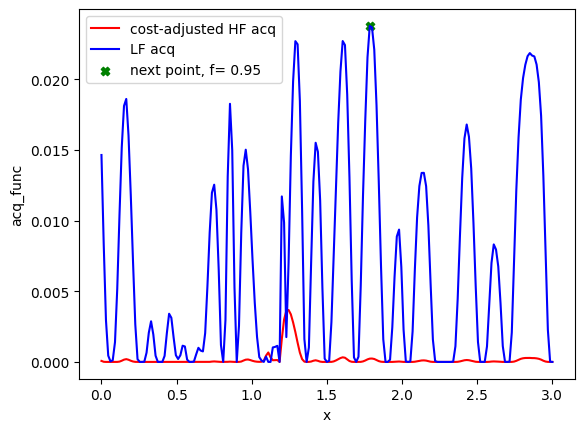

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119]
[1.785 0.95 ] 1.785
Evaluation 26 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.50it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 17: 55.77202892303467


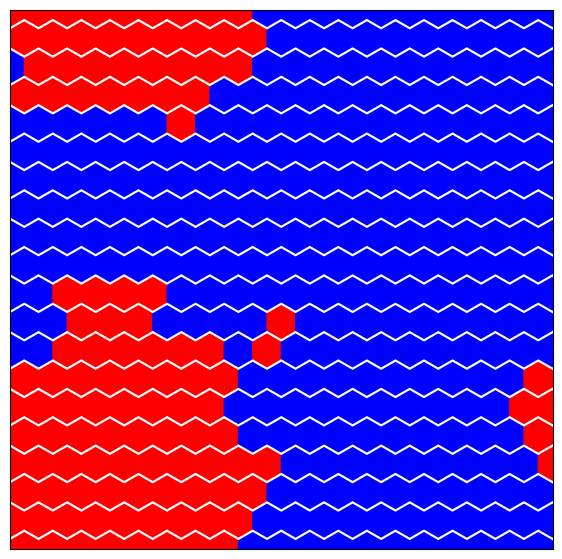

Step:17


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:50<00:00, 19.88it/s, 4 steps of size 3.13e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.12      0.09      0.10      0.00      0.23    154.86      1.00
         b      0.94      0.60      0.87      0.04      1.78    168.74      1.00
         c      1.38      1.15      1.05      0.02      3.03    302.80      1.00
     delta      0.88      0.10      0.91      0.75      1.00    435.68      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    213.85      1.00
   k_scale      0.05      0.02      0.05      0.02      0.07    301.43      1.00
     noise      0.03      0.02      0.02      0.00      0.05    333.25      1.00



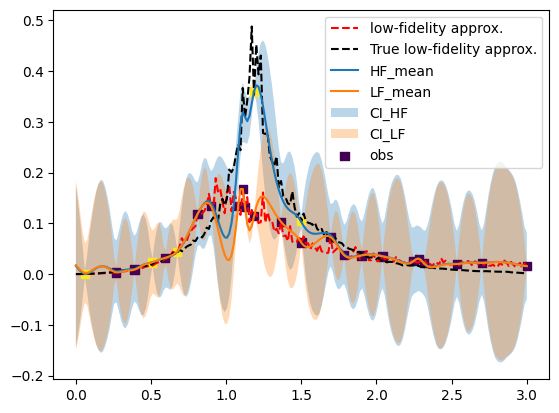

(402,)


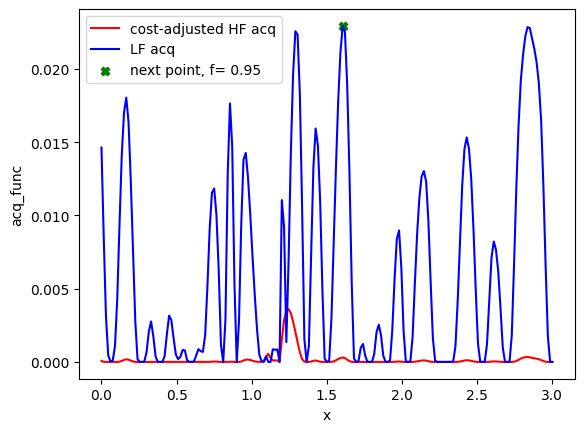

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107]
[1.605 0.95 ] 1.605
Evaluation 27 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.17it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 18: 56.96743893623352


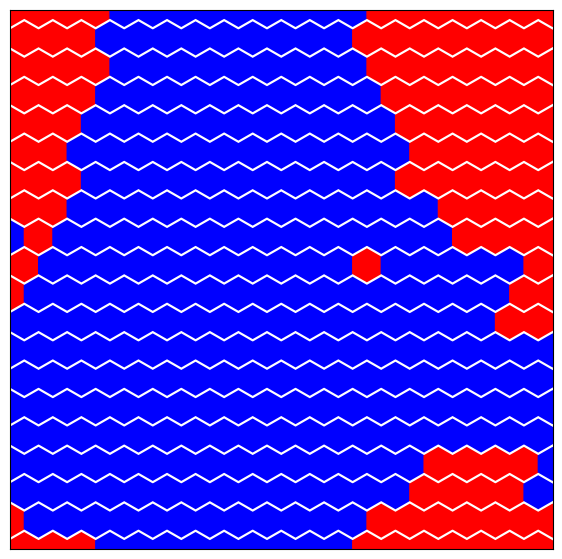

Step:18


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:59<00:00, 16.69it/s, 15 steps of size 2.51e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.12      0.08      0.10      0.00      0.23    364.75      1.00
         b      0.99      0.66      0.90      0.01      1.98    590.93      1.00
         c      1.37      1.07      1.10      0.03      2.93    396.40      1.00
     delta      0.88      0.10      0.91      0.74      1.00    407.79      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    119.73      1.00
   k_scale      0.05      0.03      0.04      0.02      0.08    267.56      1.00
     noise      0.03      0.02      0.02      0.00      0.05    615.41      1.00



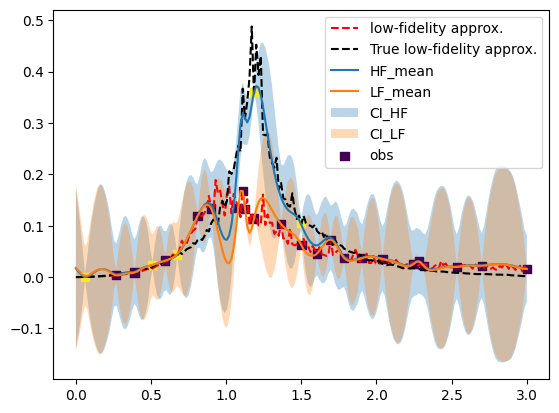

(402,)


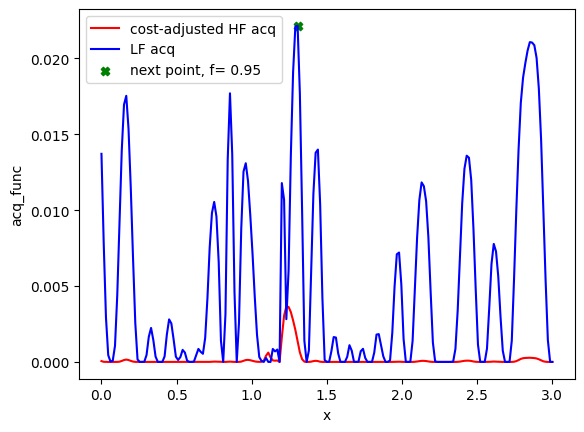

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87]
[1.305 0.95 ] 1.305
Evaluation 28 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.61it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 19: 55.9291615486145


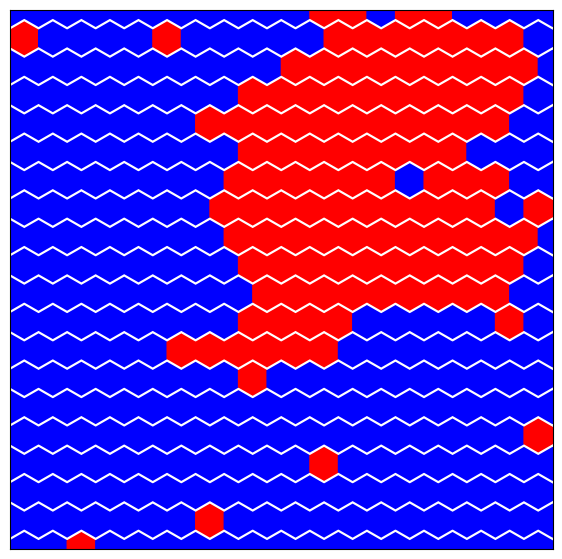

Step:19


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:06<00:00, 15.11it/s, 31 steps of size 2.00e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.09      0.09      0.00      0.21    317.91      1.00
         b      0.94      0.65      0.87      0.01      1.87    238.20      1.00
         c      1.45      1.14      1.19      0.04      3.07    267.50      1.01
     delta      0.89      0.10      0.92      0.73      1.00    440.15      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    227.28      1.01
   k_scale      0.05      0.02      0.04      0.02      0.07    310.93      1.00
     noise      0.02      0.02      0.02      0.00      0.05    415.69      1.00



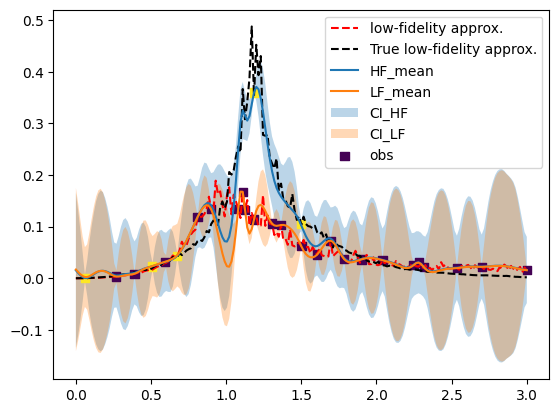

(402,)


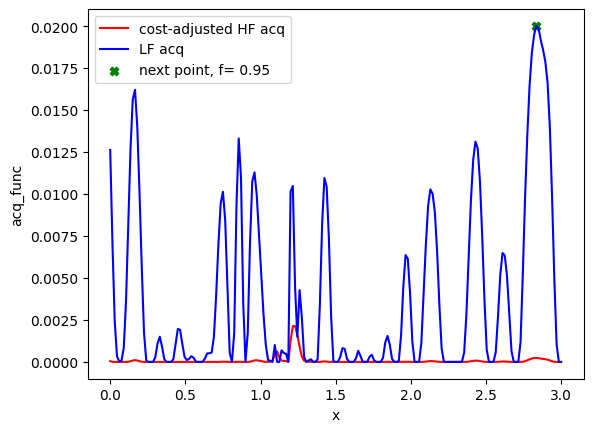

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189]
[2.835 0.95 ] 2.835
Evaluation 29 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.44it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 20: 56.528850078582764


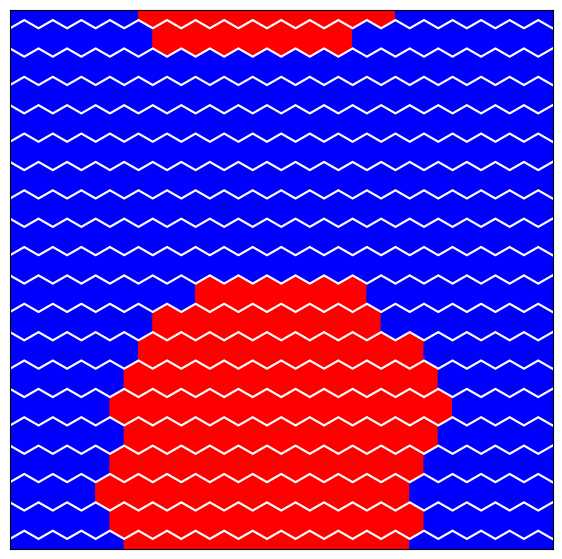

Step:20


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:03<00:00, 15.72it/s, 15 steps of size 2.70e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.08      0.09      0.00      0.19    207.50      1.00
         b      1.01      0.66      0.92      0.05      1.95    291.09      1.00
         c      1.42      1.13      1.12      0.02      3.05    418.37      1.00
     delta      0.90      0.09      0.92      0.77      1.00    530.93      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    280.24      1.00
   k_scale      0.05      0.02      0.04      0.02      0.07    289.69      1.00
     noise      0.03      0.02      0.02      0.00      0.05    417.20      1.00



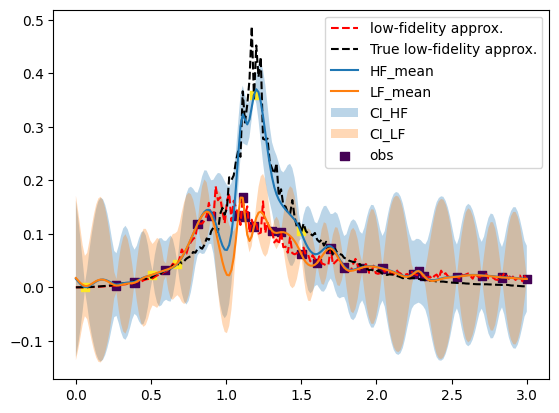

(402,)


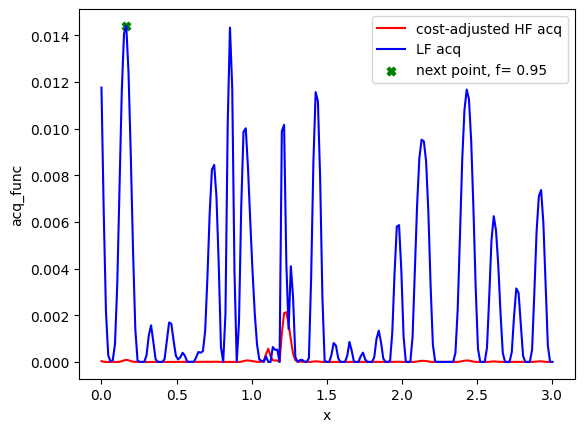

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11]
[0.165 0.95 ] 0.16499999999999998
Evaluation 30 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.59it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 21: 55.79725646972656


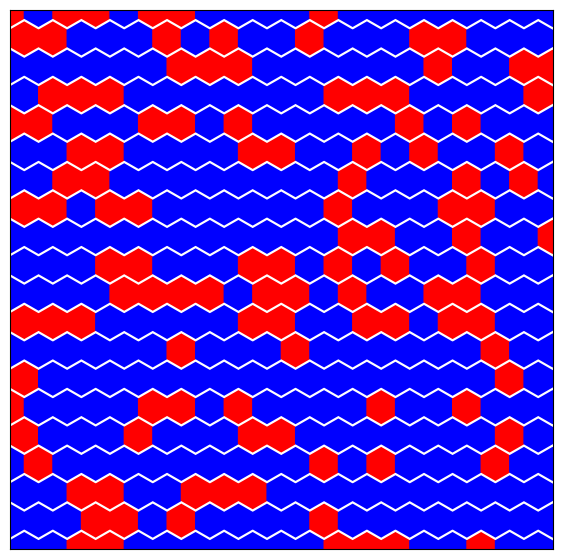

Step:21


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:11<00:00, 14.07it/s, 7 steps of size 2.42e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.09      0.00      0.22    263.84      1.01
         b      0.94      0.59      0.81      0.02      1.74    308.62      1.00
         c      1.33      1.12      1.01      0.04      2.88    327.96      1.01
     delta      0.89      0.09      0.92      0.78      1.00    425.48      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    182.14      1.00
   k_scale      0.04      0.02      0.04      0.02      0.07    275.42      1.00
     noise      0.02      0.02      0.02      0.00      0.05    330.46      1.00



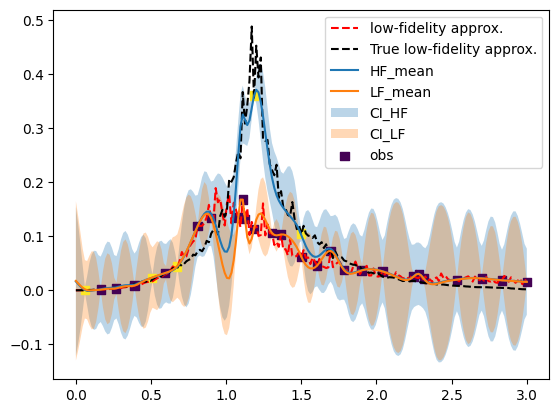

(402,)


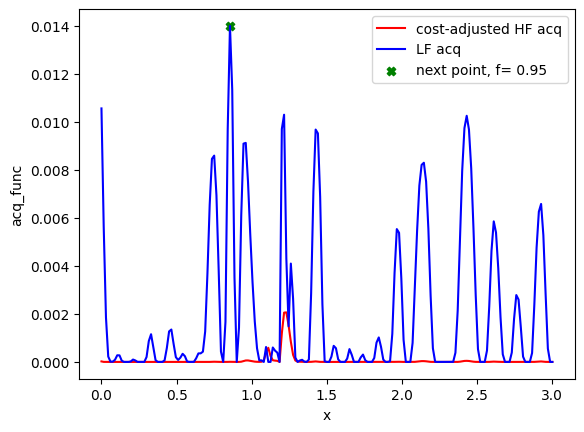

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57]
[0.855 0.95 ] 0.855
Evaluation 31 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.40it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 22: 56.999664068222046


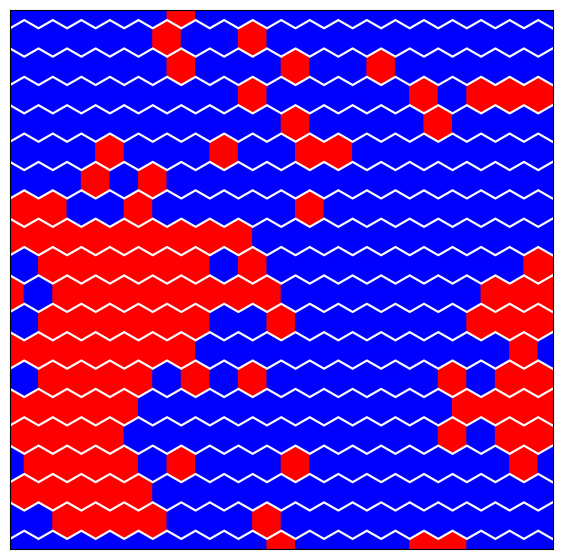

Step:22


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:09<00:00, 14.49it/s, 15 steps of size 2.74e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.12      0.10      0.10      0.00      0.23    127.34      1.01
         b      0.98      0.68      0.88      0.02      1.77    123.19      1.00
         c      1.39      1.17      1.06      0.05      3.17    459.12      1.00
     delta      0.89      0.09      0.91      0.76      1.00    382.75      1.00
  k_length      0.03      0.01      0.03      0.03      0.05    237.89      1.00
   k_scale      0.04      0.02      0.04      0.02      0.07    272.58      1.00
     noise      0.02      0.02      0.02      0.00      0.05    360.38      1.01



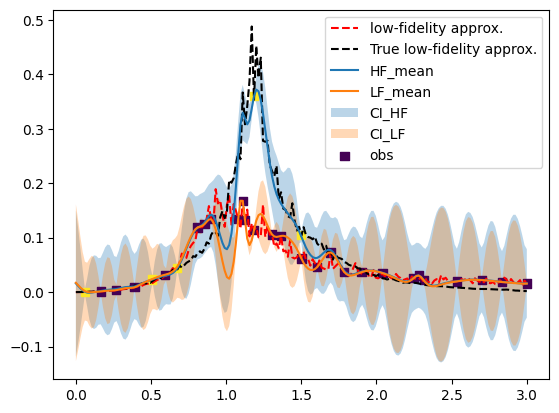

(402,)


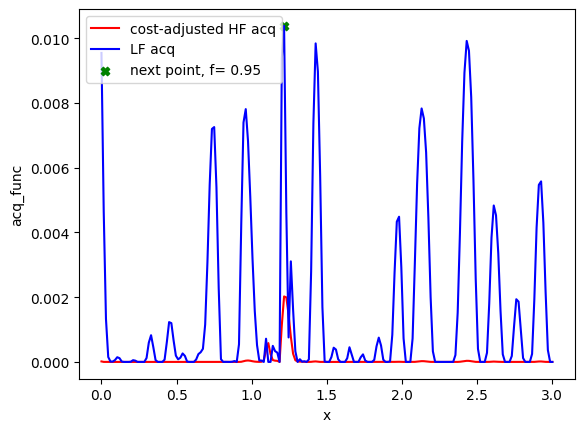

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81]
[1.215 0.95 ] 1.2149999999999999
Evaluation 32 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.44it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 23: 56.3688108921051


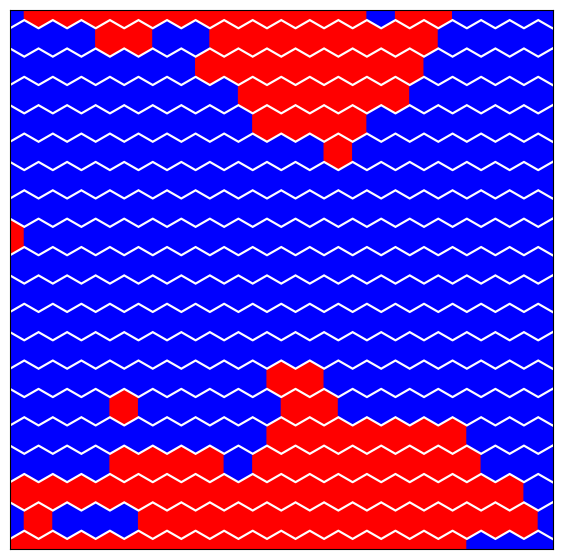

Step:23


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:17<00:00, 56.68it/s, 15 steps of size 2.83e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.09      0.00      0.22    410.11      1.00
         b      0.89      0.63      0.80      0.03      1.65    399.38      1.00
         c      1.45      1.14      1.13      0.07      3.10    464.21      1.00
     delta      0.90      0.09      0.92      0.77      1.00    337.82      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    208.97      1.00
   k_scale      0.04      0.02      0.04      0.02      0.07    239.29      1.01
     noise      0.02      0.02      0.02      0.00      0.05    448.49      1.00



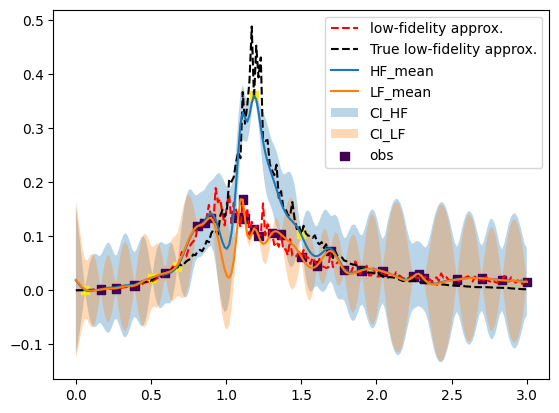

(402,)


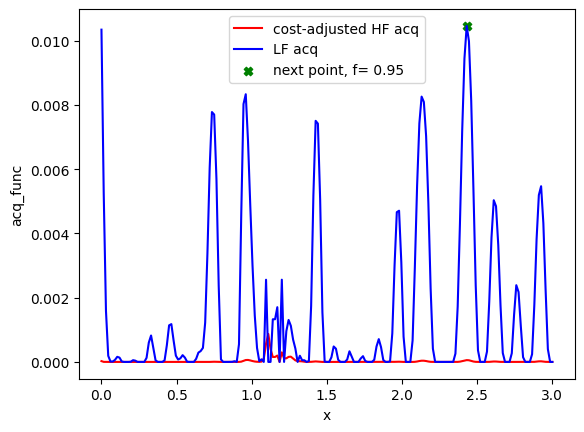

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162]
[2.43 0.95] 2.4299999999999997
Evaluation 33 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.28it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 24: 56.999451875686646


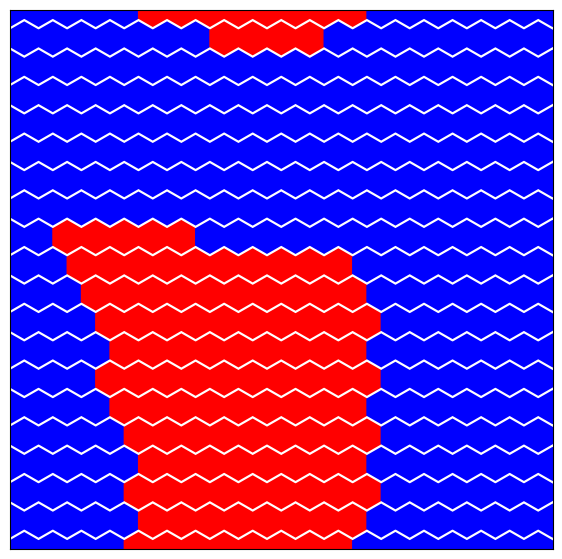

Step:24


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 48.86it/s, 15 steps of size 2.21e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.10      0.00      0.22    276.59      1.00
         b      0.93      0.61      0.88      0.02      1.66    172.11      1.00
         c      1.43      1.21      1.01      0.05      3.17    345.46      1.00
     delta      0.90      0.09      0.92      0.78      1.00    412.83      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    263.66      1.00
   k_scale      0.04      0.02      0.04      0.02      0.06    283.20      1.00
     noise      0.03      0.02      0.02      0.00      0.05    508.44      1.00



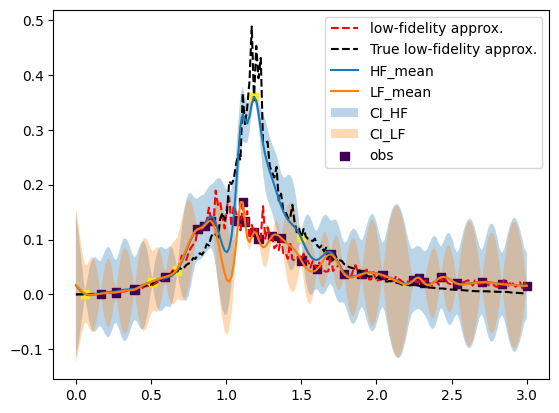

(402,)


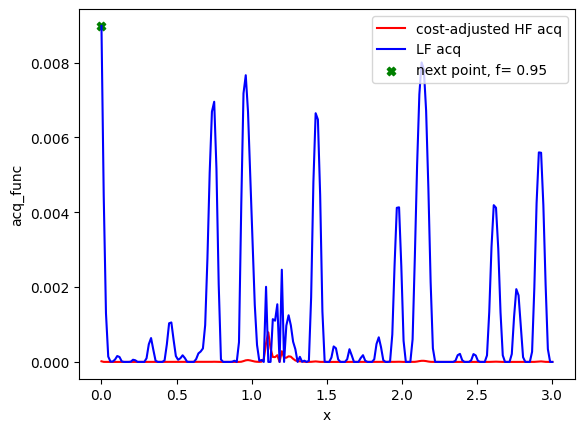

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0]
[0.   0.95] 0.0
Evaluation 34 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.57it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 25: 56.4929723739624


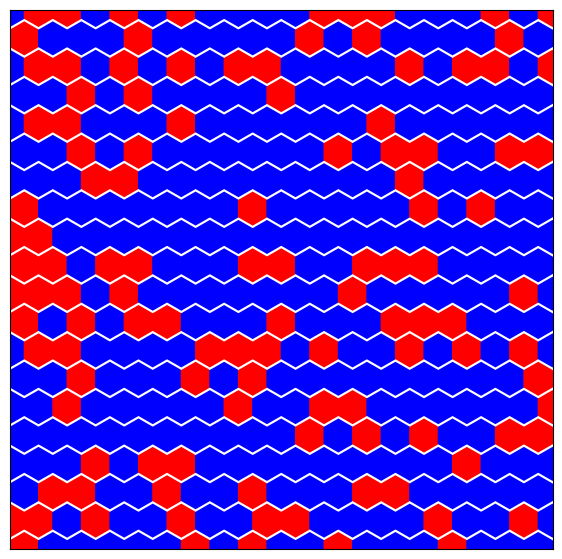

Step:25


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [07:23<00:00,  2.26it/s, 255 steps of size 9.94e-04. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.06      0.02      0.05      0.03      0.09     24.83      1.00
         b      1.11      0.00      1.11      1.10      1.11     32.04      1.00
         c      0.01      0.00      0.01      0.00      0.01    136.76      1.00
     delta      0.89      0.09      0.92      0.74      1.00     36.73      1.00
  k_length      0.12      0.02      0.11      0.09      0.14     21.29      1.03
   k_scale      0.08      0.04      0.07      0.03      0.14     17.55      1.07
     noise      0.03      0.02      0.03      0.00      0.05     30.85      1.08



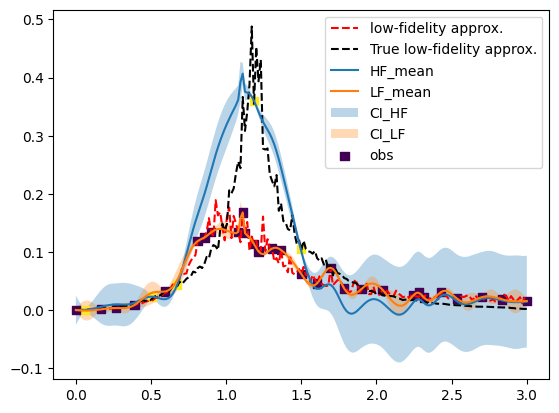

(402,)


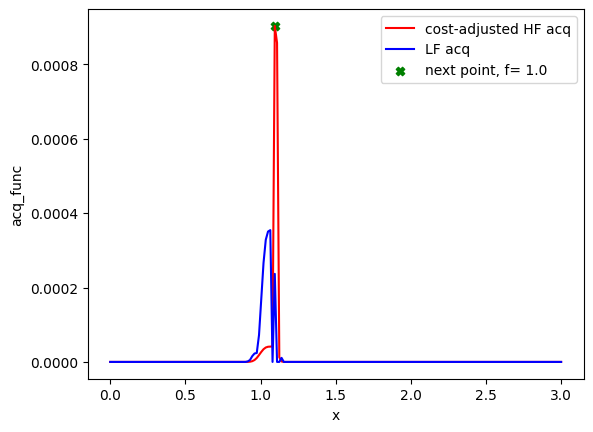

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274]
[1.095 1.   ] 1.095
Evaluation 35 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:00<00:00,  8.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:36<00:00,  3.19it/s]

Completed. Saving
Time (s) to complete simulation 26: 217.56201767921448


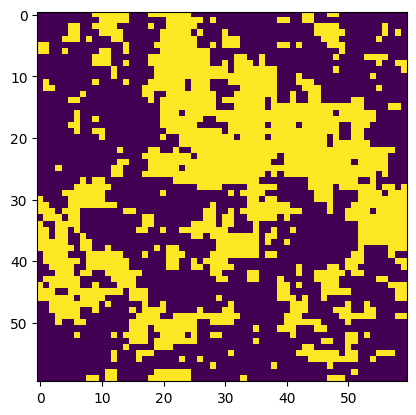

Step:26


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:22<00:00, 44.40it/s, 2 steps of size 1.70e-02. acc. prob=0.01]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.14      0.00      0.14      0.13      0.14      2.60      3.23
         b      1.10      0.00      1.10      1.10      1.10      4.42      1.69
         c      0.02      0.00      0.02      0.02      0.02      3.62      1.86
     delta      0.92      0.00      0.92      0.92      0.92      2.55      3.86
  k_length      0.06      0.00      0.06      0.06      0.06      2.56      2.70
   k_scale      0.06      0.00      0.06      0.06      0.06      4.84      1.29
     noise      0.01      0.00      0.01      0.01      0.02      3.04      2.01



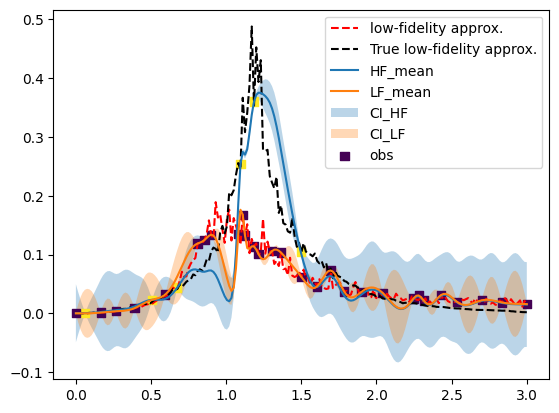

(402,)


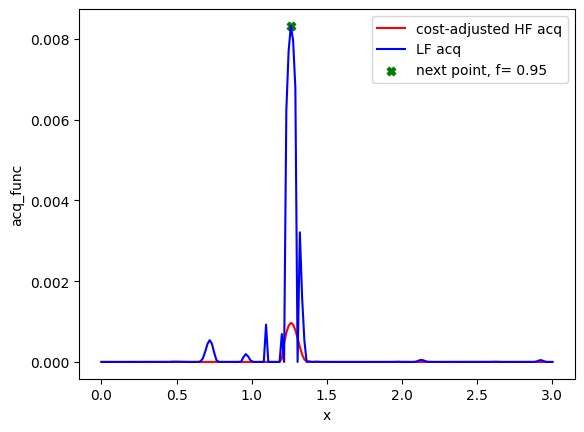

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84]
[1.26 0.95] 1.26
Evaluation 36 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.51it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 27: 56.22768187522888


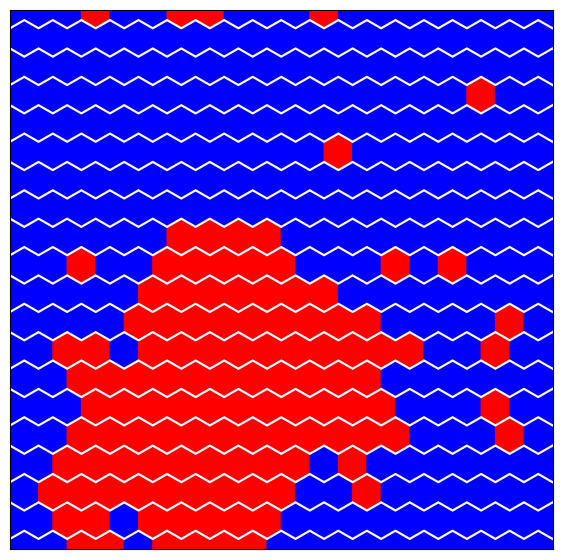

Step:27


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 52.13it/s, 15 steps of size 2.46e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.09      0.00      0.20    229.82      1.01
         b      0.92      0.58      0.85      0.01      1.63    325.35      1.00
         c      1.39      1.11      1.04      0.11      3.12    269.84      1.00
     delta      0.91      0.09      0.94      0.79      1.00    468.51      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    301.50      1.00
   k_scale      0.04      0.02      0.03      0.02      0.06    285.81      1.00
     noise      0.03      0.02      0.02      0.00      0.05    596.29      1.00



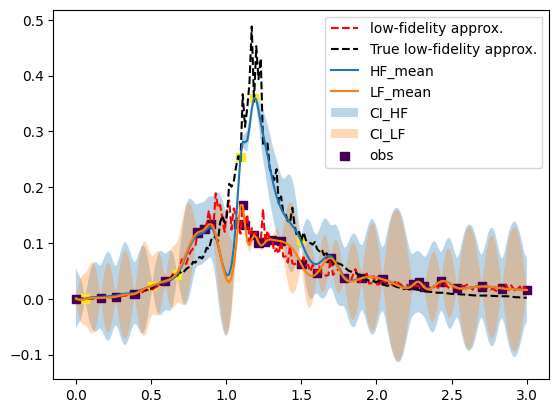

(402,)


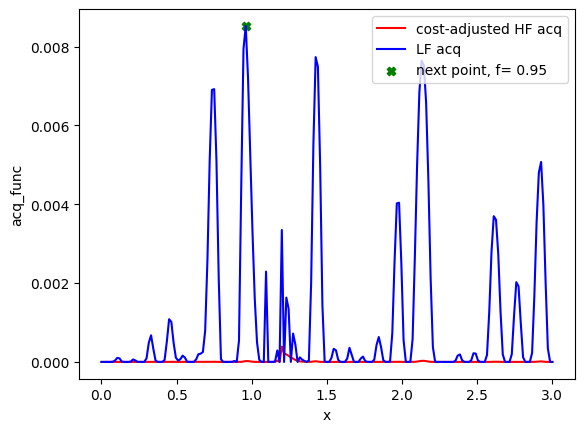

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64]
[0.96 0.95] 0.96
Evaluation 37 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.43it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 28: 56.06486105918884


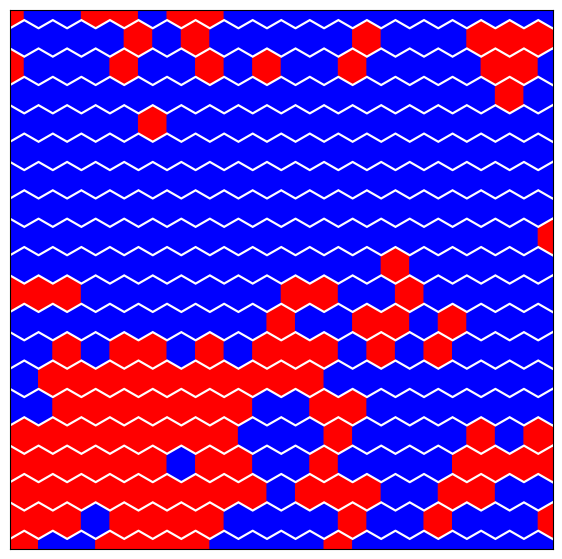

Step:28


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 49.03it/s, 15 steps of size 2.29e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.07      0.09      0.00      0.20    204.66      1.01
         b      0.98      0.60      0.92      0.00      1.83    372.21      1.00
         c      1.41      1.15      1.11      0.02      3.07    445.74      1.00
     delta      0.91      0.08      0.93      0.79      1.00    350.94      1.01
  k_length      0.03      0.01      0.03      0.02      0.04    286.80      1.01
   k_scale      0.04      0.02      0.03      0.02      0.06    328.49      1.00
     noise      0.03      0.02      0.02      0.00      0.05    511.31      1.00



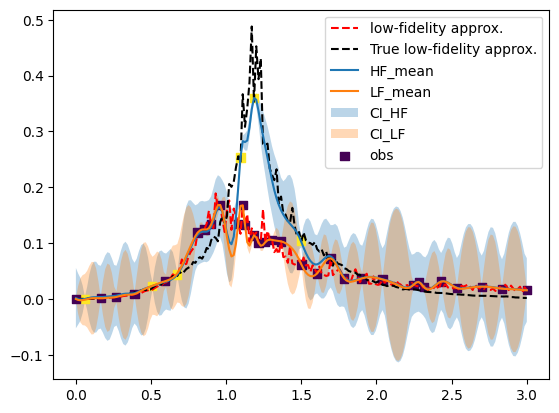

(402,)


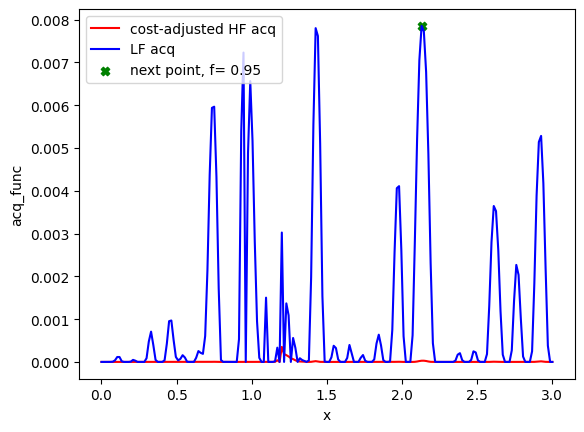

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142]
[2.13 0.95] 2.13
Evaluation 38 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.21it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 29: 57.14124369621277


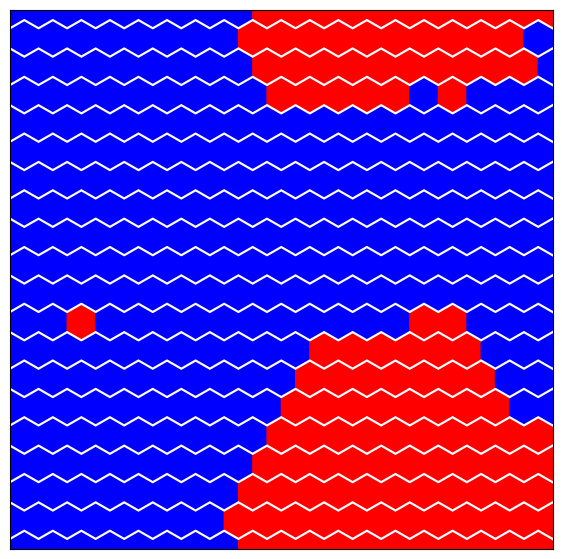

Step:29


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 51.72it/s, 15 steps of size 2.26e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.08      0.09      0.00      0.21    276.41      1.00
         b      0.96      0.58      0.88      0.04      1.80    279.04      1.00
         c      1.45      1.19      1.09      0.05      3.23    339.95      1.00
     delta      0.92      0.07      0.93      0.81      1.00    435.62      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    317.27      1.00
   k_scale      0.03      0.02      0.03      0.02      0.05    297.27      1.00
     noise      0.02      0.02      0.02      0.00      0.05    588.39      1.00



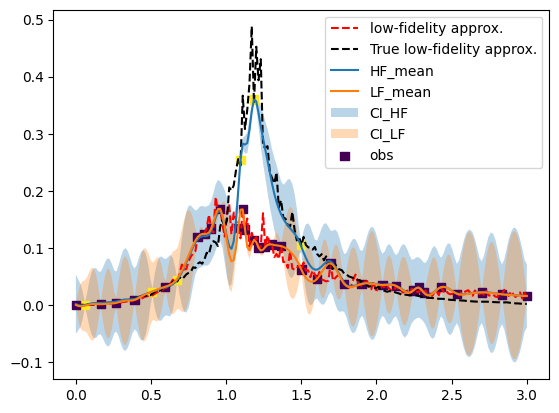

(402,)


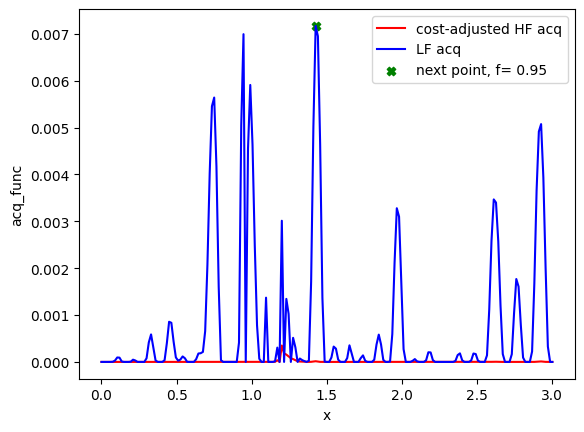

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95]
[1.425 0.95 ] 1.425
Evaluation 39 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.45it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 30: 56.92939376831055


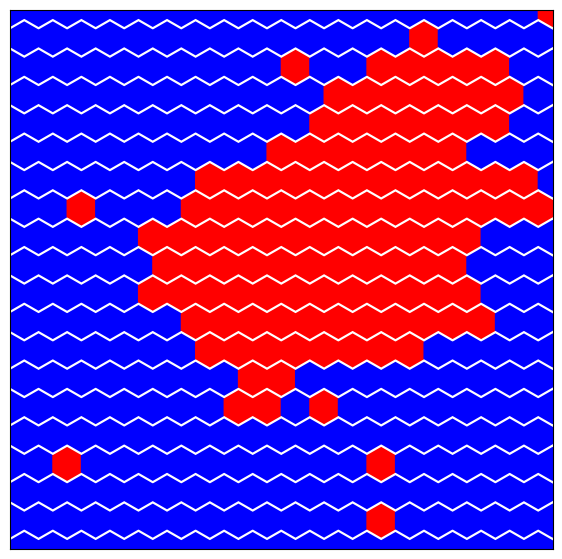

Step:30


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 46.87it/s, 15 steps of size 2.80e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.07      0.09      0.01      0.20    228.89      1.00
         b      1.00      0.65      0.94      0.03      1.93    422.26      1.00
         c      1.38      1.16      1.03      0.06      3.07    495.83      1.00
     delta      0.91      0.08      0.93      0.80      1.00    427.44      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    276.91      1.00
   k_scale      0.03      0.01      0.03      0.02      0.05    324.27      1.00
     noise      0.03      0.02      0.02      0.00      0.05    427.34      1.00



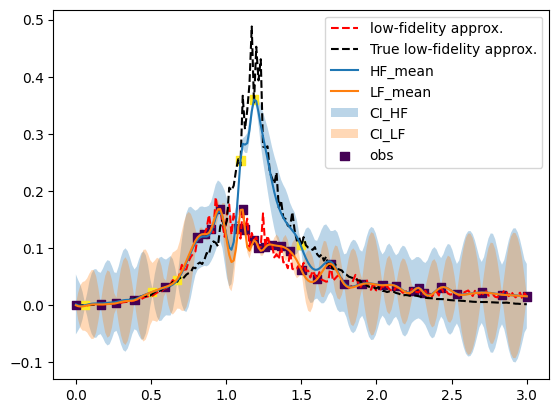

(402,)


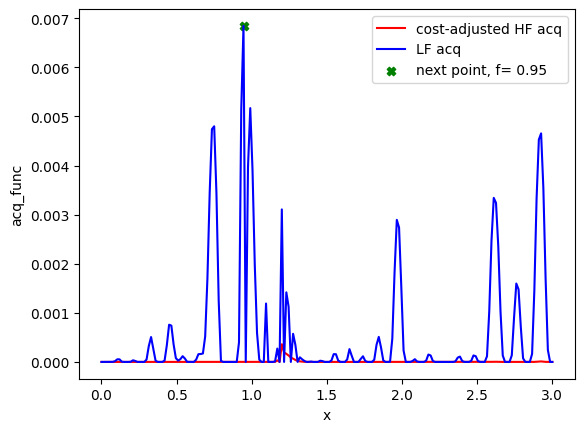

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95  63]
[0.945 0.95 ] 0.945
Evaluation 40 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.60it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 31: 55.760934352874756


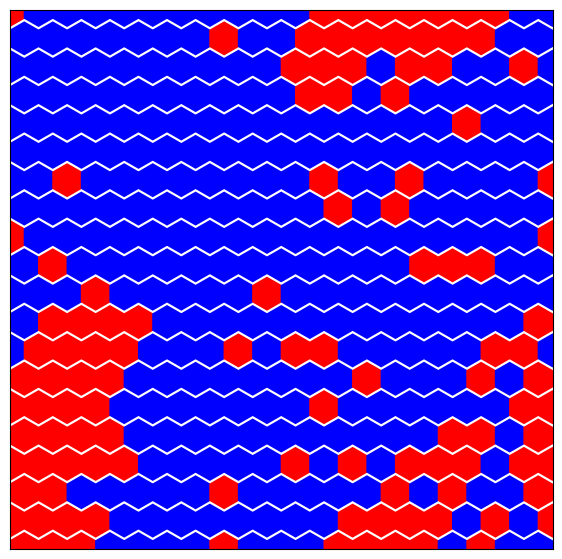

Step:31


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 48.28it/s, 15 steps of size 2.86e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.09      0.09      0.00      0.20    190.51      1.01
         b      0.93      0.60      0.79      0.05      1.82    319.76      1.00
         c      1.44      1.22      1.07      0.08      3.22    520.74      1.00
     delta      0.91      0.08      0.94      0.81      1.00    279.14      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    298.26      1.00
   k_scale      0.04      0.01      0.03      0.02      0.05    282.86      1.00
     noise      0.02      0.02      0.02      0.00      0.05    405.68      1.00



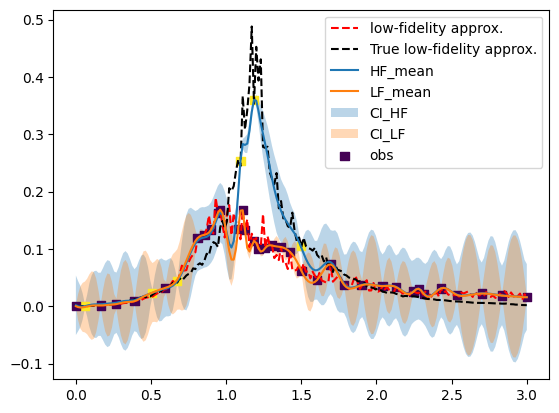

(402,)


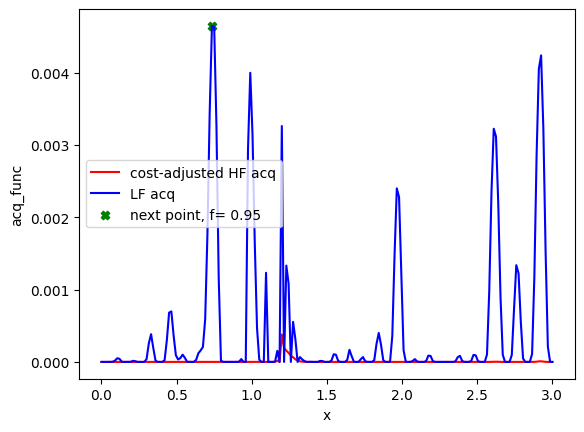

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95  63  49]
[0.735 0.95 ] 0.735
Evaluation 41 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.25it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 32: 56.855682611465454


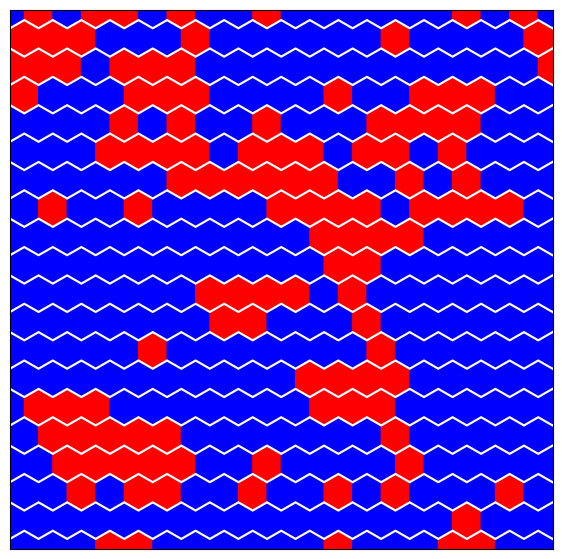

Step:32


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 51.84it/s, 7 steps of size 3.08e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.09      0.00      0.21    166.11      1.01
         b      0.93      0.60      0.90      0.03      1.77    266.14      1.00
         c      1.48      1.19      1.17      0.05      3.21    386.79      1.00
     delta      0.92      0.07      0.94      0.82      1.00    340.03      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    319.86      1.00
   k_scale      0.03      0.01      0.03      0.02      0.05    317.67      1.00
     noise      0.02      0.02      0.02      0.00      0.05    378.83      1.00



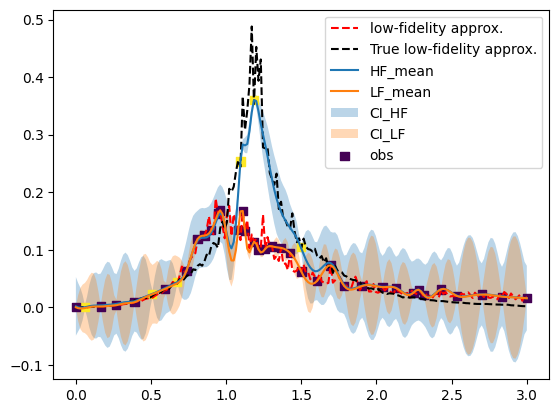

(402,)


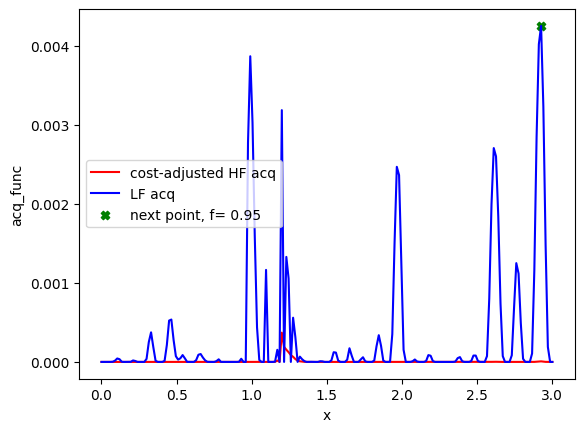

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95  63  49 195]
[2.925 0.95 ] 2.925
Evaluation 42 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.24it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.20it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 33: 56.86309218406677


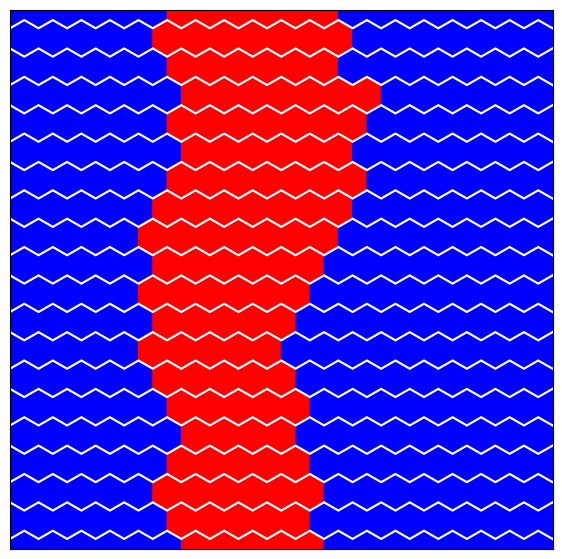

Step:33


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:18<00:00, 54.81it/s, 15 steps of size 3.20e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.08      0.09      0.00      0.20    266.76      1.00
         b      0.94      0.62      0.86      0.08      1.77    338.72      1.00
         c      1.45      1.19      1.07      0.03      3.15    286.34      1.01
     delta      0.92      0.07      0.94      0.82      1.00    324.32      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    232.49      1.00
   k_scale      0.03      0.01      0.03      0.02      0.05    296.04      1.00
     noise      0.02      0.02      0.02      0.00      0.05    526.32      1.00



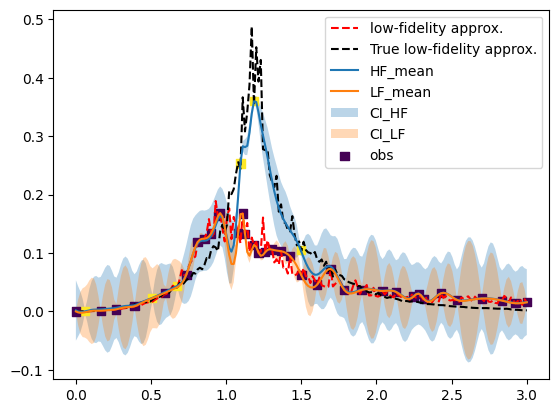

(402,)


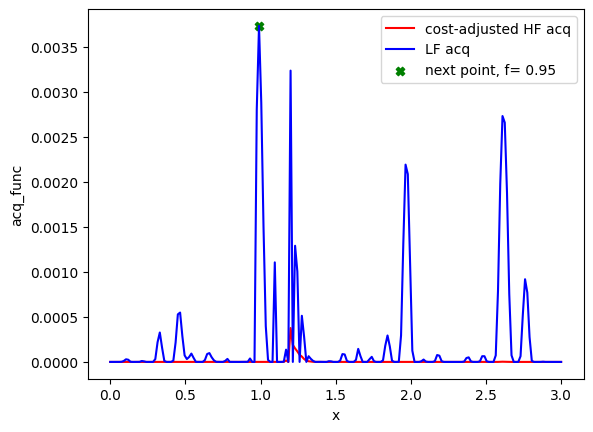

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95  63  49 195  66]
[0.99 0.95] 0.99
Evaluation 43 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.15it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 34: 57.464590311050415


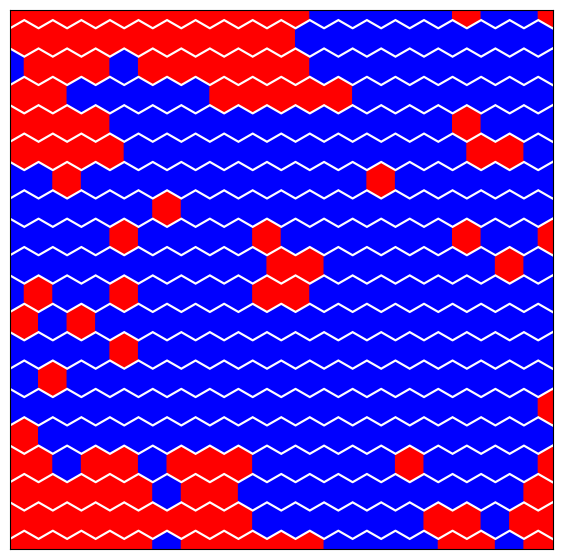

Step:34


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 51.83it/s, 15 steps of size 2.68e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.07      0.09      0.00      0.19    266.94      1.00
         b      0.95      0.62      0.88      0.01      1.72    226.56      1.00
         c      1.47      1.12      1.16      0.06      3.04    430.78      1.00
     delta      0.92      0.07      0.94      0.83      1.00    464.69      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    184.72      1.01
   k_scale      0.03      0.01      0.03      0.02      0.05    178.66      1.00
     noise      0.02      0.02      0.02      0.00      0.05    312.36      1.00



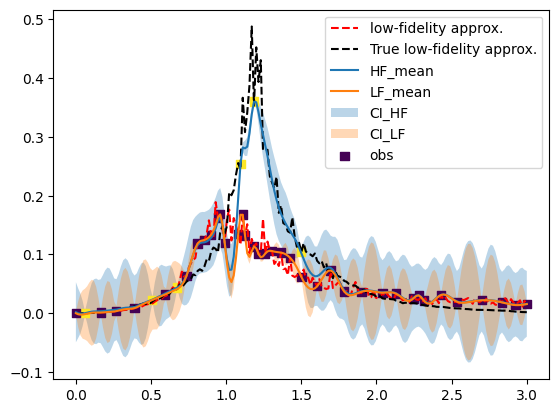

(402,)


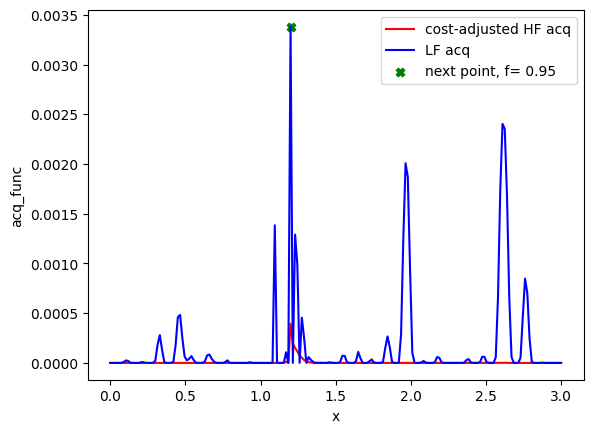

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95  63  49 195  66  80]
[1.2  0.95] 1.2
Evaluation 44 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.35it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 35: 56.90381717681885


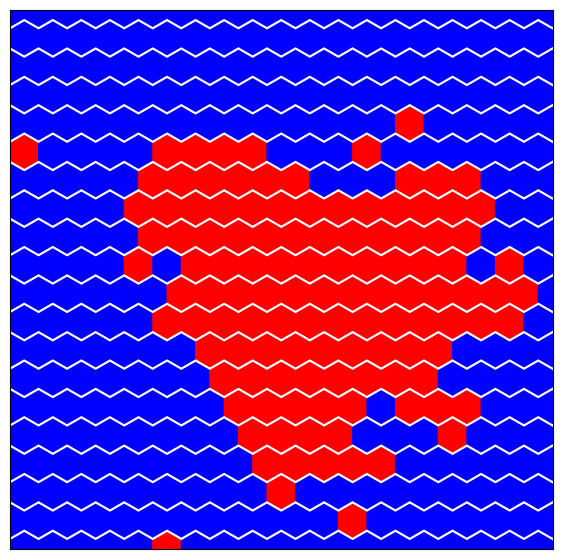

Step:35


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 49.46it/s, 15 steps of size 2.47e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.07      0.09      0.00      0.19    273.07      1.00
         b      0.95      0.60      0.91      0.02      1.75    288.43      1.00
         c      1.54      1.14      1.25      0.06      3.13    396.62      1.00
     delta      0.92      0.08      0.94      0.82      1.00    522.32      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    272.04      1.00
   k_scale      0.03      0.01      0.03      0.02      0.05    309.83      1.00
     noise      0.03      0.02      0.02      0.00      0.05    419.46      1.00



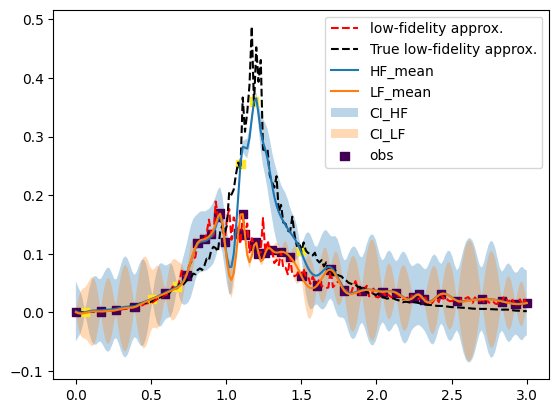

(402,)


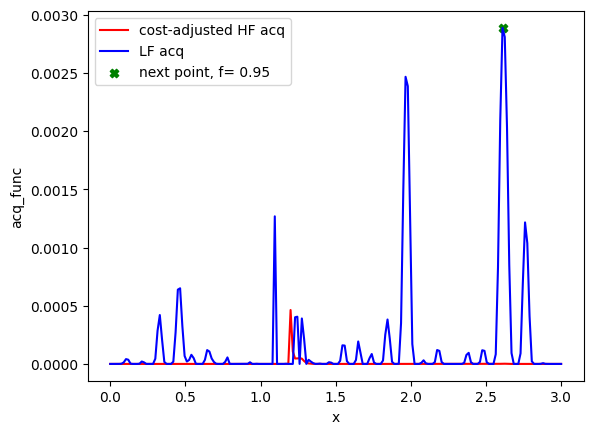

[100 280  79 200 113  60  74  72 180  54  75  91 136 169  26 119 107  87
 189  11  57  81 162   0 274  84  64 142  95  63  49 195  66  80 174]
[2.61 0.95] 2.61
Evaluation 45 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.41it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 36: 56.83938479423523


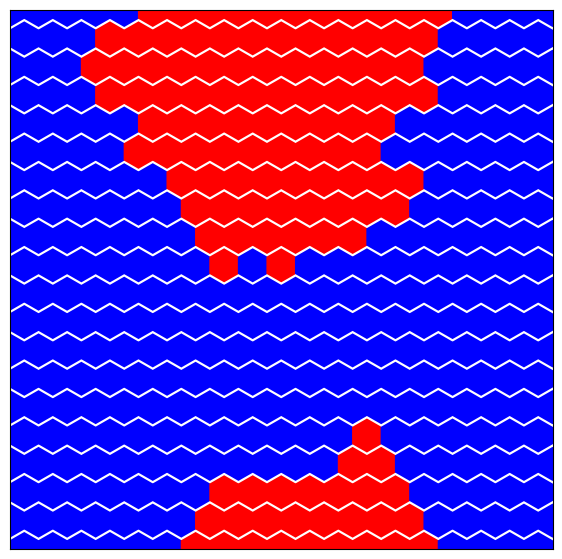

In [ ]:
N = 35
cost_ratio = 8.6/1 #time complexities
f = np.array([1.0, 2.0])
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_lf, X_test_hf))
X_test_full = np.vstack((X_test_lf, X_test_hf))
X_test_norm = np.vstack((X_test_lf, X_test_hf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                            noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs, approx_ys_tri, "r--", label="low-fidelity approx.")
        plt.plot(xs, approx_ys_sq, "k--", label="True low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.plot(xs, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            J_mat = np.array([[0,Jx[-1],0,Jx[-1],0],
                      [Jx[-1],0,0,0,Jx[-1]],
                      [0,Jx[-1],0,Jx[-1],0]])
            tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
            sq_sim = tri_sim

        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        if train_x_full[-1,1] == 1: #High fidelity
            plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])

        else: #Low fidelity
            sq_sim.plot_config(resultsBO_dict[n+i]['sim']['config'][-1])

        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 49.06it/s, 15 steps of size 2.26e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.07      0.08      0.00      0.20    190.74      1.00
         b      1.00      0.58      0.92      0.06      1.84    380.90      1.00
         c      1.35      1.10      1.09      0.04      3.07    285.39      1.00
     delta      0.92      0.07      0.94      0.82      1.00    347.75      1.00
  k_length      0.03      0.00      0.03      0.03      0.04    159.57      1.00
   k_scale      0.03      0.01      0.03      0.02      0.05    205.73      1.00
     noise      0.02      0.02      0.02      0.00      0.05    492.16      1.00



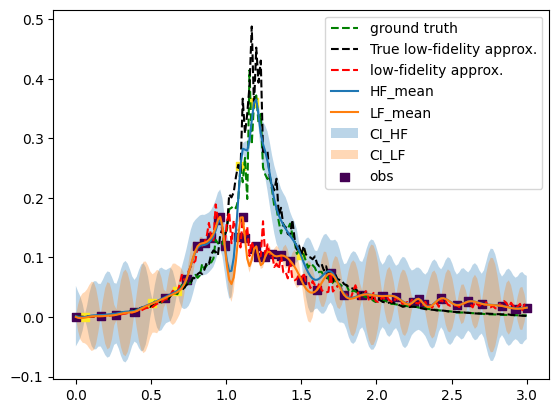

In [ ]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, true_ys_sq, "g--", label="ground truth")
plt.plot(xs, approx_ys_sq, "k--", label="True low-fidelity approx.")
plt.plot(xs, approx_ys_tri, "r--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

plt.legend(loc="best")
plt.show()

In [ ]:
train_x_full

array([[2.31396193, 0.95      ],
       [0.06225585, 1.        ],
       [1.9009447 , 0.95      ],
       [2.24641165, 0.95      ],
       [1.49552104, 1.        ],
       [0.67438994, 1.        ],
       [0.59418859, 0.95      ],
       [2.28159214, 0.95      ],
       [0.50733251, 1.        ],
       [0.26501944, 0.95      ],
       [1.5       , 0.95      ],
       [1.185     , 1.        ],
       [1.185     , 0.95      ],
       [3.        , 0.95      ],
       [1.695     , 0.95      ],
       [0.9       , 0.95      ],
       [1.11      , 0.95      ],
       [1.08      , 0.95      ],
       [2.7       , 0.95      ],
       [0.81      , 0.95      ],
       [1.125     , 0.95      ],
       [1.365     , 0.95      ],
       [2.04      , 0.95      ],
       [2.535     , 0.95      ],
       [0.39      , 0.95      ],
       [1.785     , 0.95      ],
       [1.605     , 0.95      ],
       [1.305     , 0.95      ],
       [2.835     , 0.95      ],
       [0.165     , 0.95      ],
       [0.

0.0005201064494746326


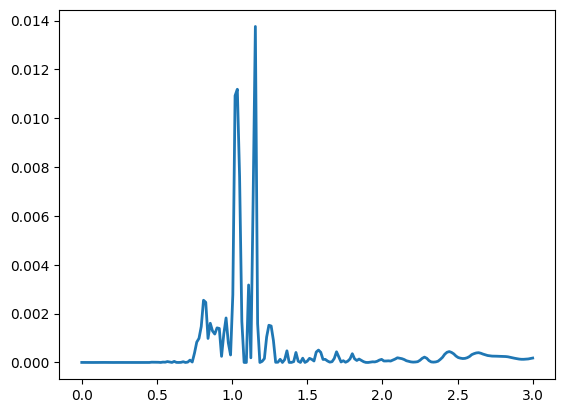

In [ ]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# Interractive BO

In [13]:
#@title user interraction function

def ipolicy(train_x, train_x_norm, train_y, X_test, X_test_norm, imodel, cost_ratio, N, k, idx):
    # Step 7a
    print("Do you want to update current policy? y- Yes or press ENTER- No")
    ip = str(input("Answer: "))
    if (ip == 'Y' or ip == 'y'):
        print("What policies you want to change? Options: 1-parameter space, 2-surrogate model, 3-acq. func., 4-convergence")
        cp = list(map(int, input("Enter multiple choices each followed by a space: ").split()))
        print("choices made: ", cp)
        for i in cp:
          if i == 1: #Change parameter space
            idx=[]
            print("Provide minimum and maximum values of X")
            lb, ub = input("Enter two values: ").split()
            lb = float(lb)
            ub = float(ub)
            print("min:", lb)
            print("max:", ub)
            fidelities = np.array((0.95, 1.0))
            xs = np.linspace(lb, ub, 201)
            X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
            X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
            X_test =np.vstack((X_test_lf, X_test_hf))
            X_test_full = np.vstack((X_test_lf, X_test_hf))
            X_test_norm = np.vstack((X_test_lf, X_test_hf))
            X_test_norm[:, 0] = (X_test[:, 0]-lb)/(ub-lb)

            #Removing the training data outside the new range
            train_y = train_y[train_x[:,0]<=ub]
            train_x = train_x[train_x[:,0]<=ub]
            train_x_norm = train_x[train_x[:,0]<=ub]

            train_y = train_y[train_x[:,0]>=lb]
            train_x = train_x[train_x[:,0]>=lb]
            train_x_norm = train_x[train_x[:,0]>=lb]

            train_x_norm[:, 0] = (train_x[:,0]-lb)/(ub-lb)


          if i == 2: #Change surrogate model
            print("Provide choice of model: 1-standard 2-structured")
            imodel = int(input("enter choice: "))
            print("choices made: ", imodel)
          if i == 3: #Change acquisition function
            print("Provide new cost ratio between high and low fidelities")
            cost_ratio = float(input("enter value: "))
            print("cost ratio: ", cost_ratio)
          if i == 4: #Change convergence criteria
            print("Provide new number of total iterations.")
            N = int(input("enter value: "))
            print("iteration: ", N)
            if N<=k:
              print("Invalid number. Please provide total iterations greater than current iteration")
              N = int(input("enter value: "))
              print("iteration: ", N)
          if (i > 4) or (i < 1):
              print("Invalid choice")

    return train_x, train_x_norm, train_y, X_test, X_test_norm, imodel, cost_ratio, N, idx

# Correct low-fidelity model

In [14]:
n = 10

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]))

Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 26.87it/s]


Completed. Saving
Time (s) to complete simulation 1: 25.59834384918213


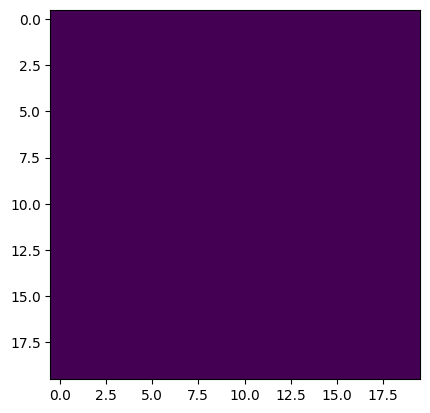

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:42<00:00,  3.09it/s]

Completed. Saving
Time (s) to complete simulation 2: 228.52088618278503


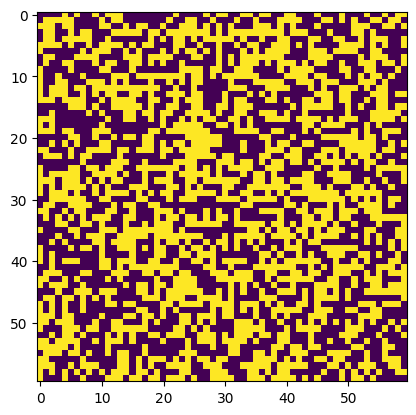

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.43it/s]


Completed. Saving
Time (s) to complete simulation 3: 24.12176537513733


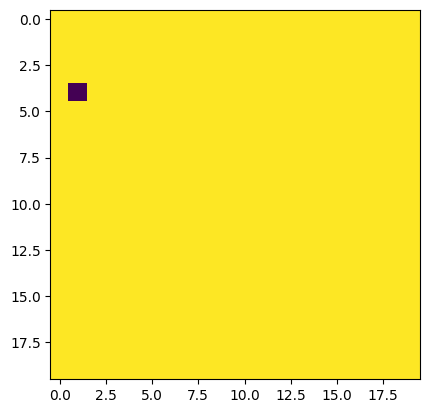

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.29it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.24it/s]


Completed. Saving
Time (s) to complete simulation 4: 24.18717336654663


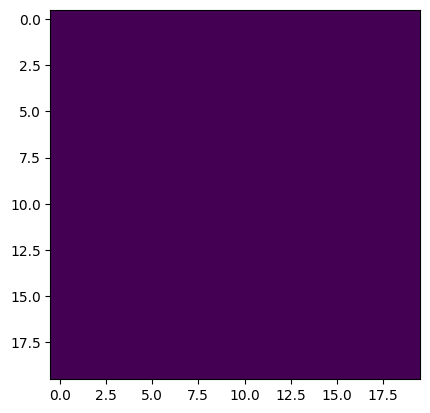

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.30it/s]

Completed. Saving
Time (s) to complete simulation 5: 210.4284906387329


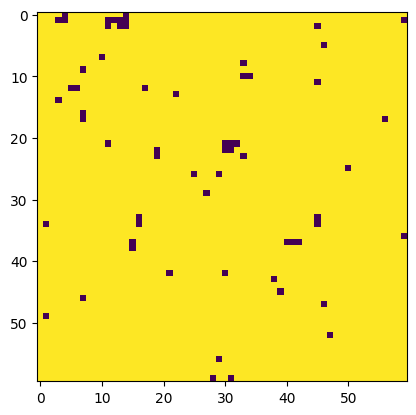

Evaluation 6 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.39it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.25it/s]

Completed. Saving
Time (s) to complete simulation 6: 213.55062747001648


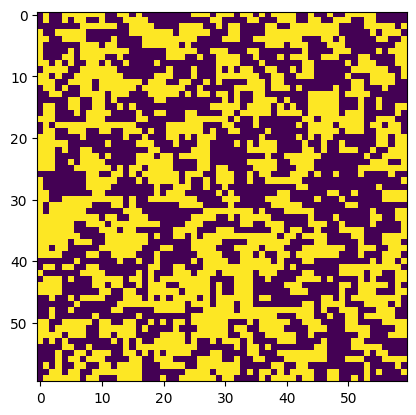

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.77it/s]


Completed. Saving
Time (s) to complete simulation 7: 24.196978092193604


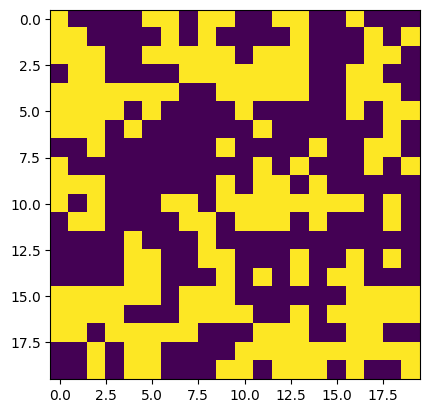

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.67it/s]


Completed. Saving
Time (s) to complete simulation 8: 23.862351179122925


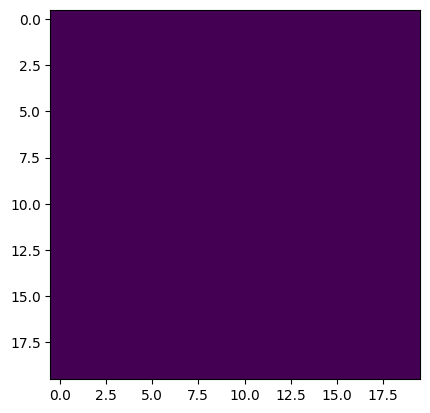

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:34<00:00,  3.23it/s]

Completed. Saving
Time (s) to complete simulation 9: 214.4808247089386


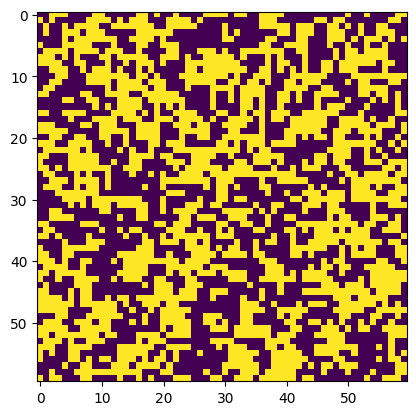

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.38it/s]


Completed. Saving
Time (s) to complete simulation 10: 24.334584951400757


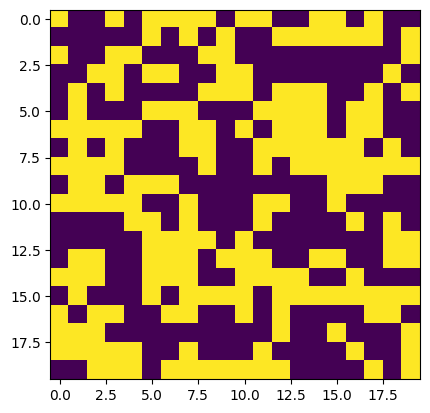

In [15]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}

for i in range(0, train_x.shape[0]):

    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i,0],0,0],
                      [0,Jx[i,0],0,Jx[i,0],0],
                      [0,0,Jx[i,0],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

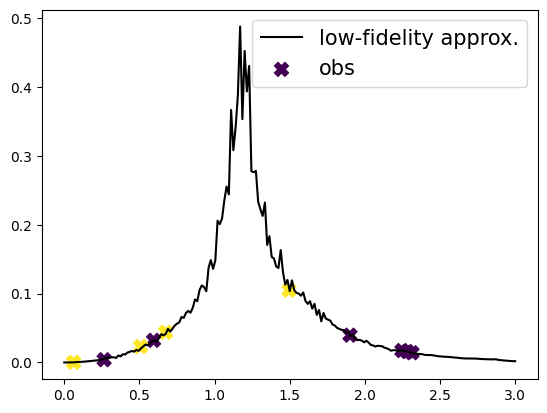

In [16]:
plt.plot(xs, approx_ys_sq, "k", label="low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [17]:
@jit
def mean_func(x, params):

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    lb = 0
    ub = 3
    x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)
    f = params["a"]*jnp.exp((-1/2)*(jnp.square(x_data-params["b"])/jnp.square(params["c"])))

    return  f


def mf_priors():
    a = numpyro.sample("a", numpyro.distributions.HalfNormal(0.5)) #Height of peak
    b = numpyro.sample("b", numpyro.distributions.HalfNormal(1.17)) #Position of peak
    c = numpyro.sample("c", numpyro.distributions.HalfNormal(2)) #Broadness of peak
    return {"a": a, "b": b, "c": c}

# Run BO

In [ ]:
lb = 0
ub = 3
N_total = 201
bounds = np.array((lb, ub), dtype=float)
fidelities = np.array((0.95, 1.0))

xs = np.linspace(lb, ub, N_total)
xs_norm = (xs-lb)/(ub-lb)
approx_ys_tri = np.zeros(xs.shape[0])
approx_ys_sq = np.zeros(xs.shape[0])
for i in range(0, xs.shape[0]):
    approx_ys_tri[i] = results_dict_tri[1][i]['sim']['SpecificHeat']
    approx_ys_sq[i] = results_dict_square[1][i]['sim']['SpecificHeat']

In [23]:
train_x_full, train_x_full_norm, train_y = hist_policy[0]['train_x'], hist_policy[0]['train_x_norm'], hist_policy[0]['train_y']
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ],
        [1.215     , 0.95      ],
        [1.2       , 0.95      ],
        [1.08      , 1.        ],
        [1.185     , 0.95      ],
        [1.2       , 1.        ],
        [1.605     , 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ],
        [0.405     , 0.95      ],
        [0.4       , 0.95      ],
        [0.36      , 1.        ],
        [0.3

In [24]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]),
 array([[0.01413402],
        [0.00025922],
        [0.03967774],
        [0.01734454],
        [0.10503485],
        [0.04375014],
        [0.0321721 ],
        [0.01583695],
        [0.02304033],
        [0.00402616]]))

In [18]:
hist_policy={}

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 61.45it/s, 7 steps of size 2.70e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.46      0.29      0.46      0.01      0.89    375.32      1.00
  k_length      0.63      0.18      0.60      0.38      0.94    226.19      1.00
   k_scale      0.07      0.09      0.04      0.01      0.15    172.59      1.00
     noise      0.02      0.02      0.02      0.00      0.05    183.30      1.00



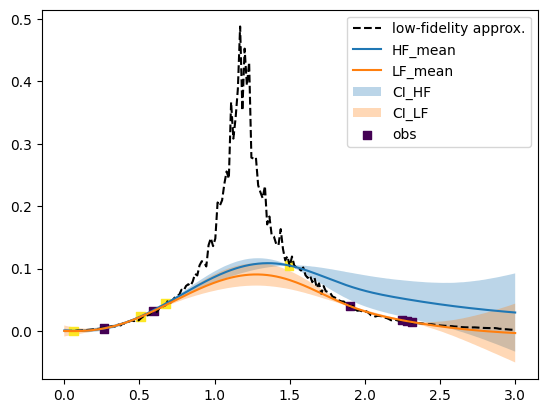

(402,)


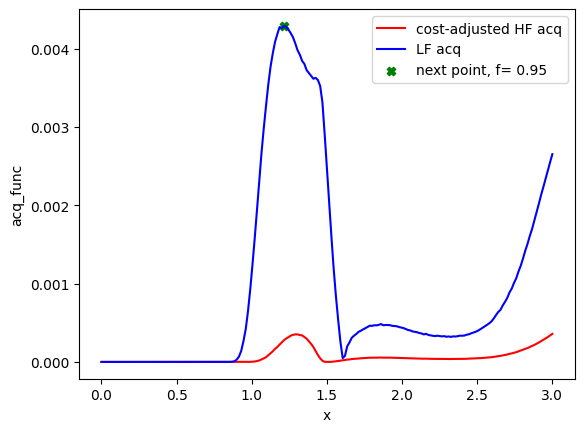

<ipython-input-19-90cb20710818>:84: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


81
[1.215 0.95 ] 1.2149999999999999
Evaluation 11 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.37it/s]


Completed. Saving
Time (s) to complete simulation 2: 24.251511096954346


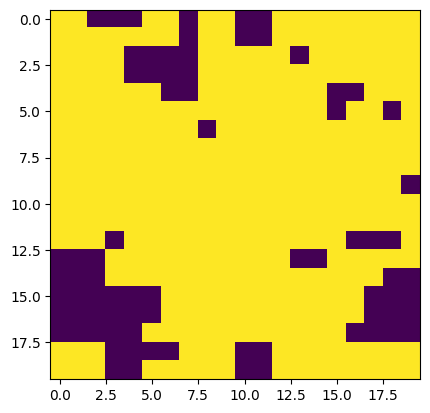

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:18<00:00, 55.43it/s, 5 steps of size 3.26e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.51      0.28      0.53      0.01      0.90    308.71      1.00
  k_length      0.23      0.10      0.21      0.09      0.38    140.05      1.00
   k_scale      0.17      0.20      0.09      0.01      0.43    180.59      1.00
     noise      0.03      0.02      0.02      0.00      0.05    248.37      1.00



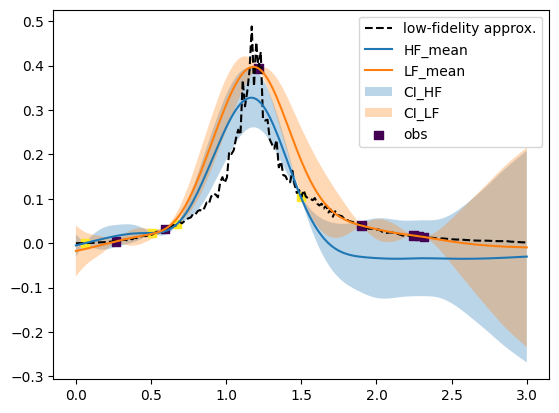

(402,)


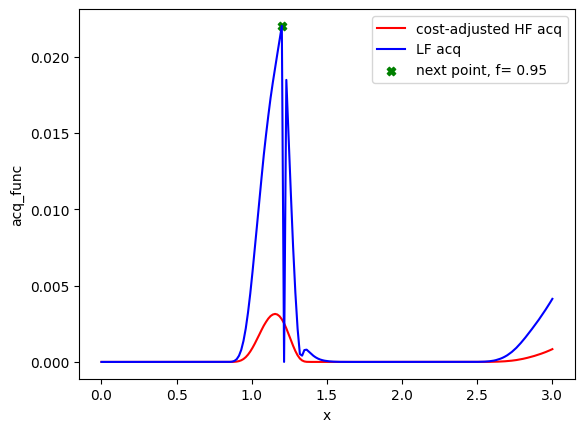

[81 80]
[1.2  0.95] 1.2
Evaluation 12 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.53it/s]


Completed. Saving
Time (s) to complete simulation 3: 24.180351495742798


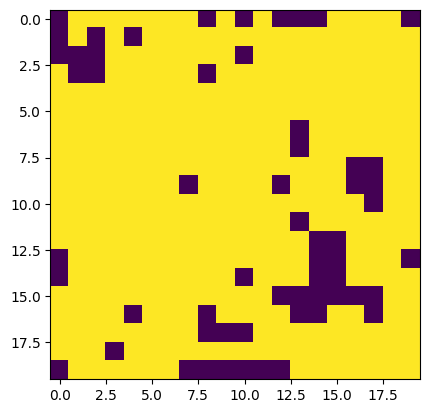

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:3


sample: 100%|██████████| 1000/1000 [00:18<00:00, 55.12it/s, 7 steps of size 3.46e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.45      0.28      0.44      0.01      0.85    402.13      1.00
  k_length      0.06      0.03      0.06      0.02      0.11    198.05      1.00
   k_scale      0.08      0.08      0.06      0.01      0.17    223.80      1.00
     noise      0.03      0.02      0.02      0.00      0.05    229.97      1.00



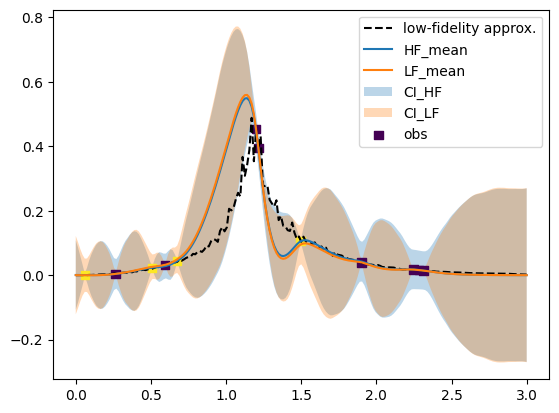

(402,)


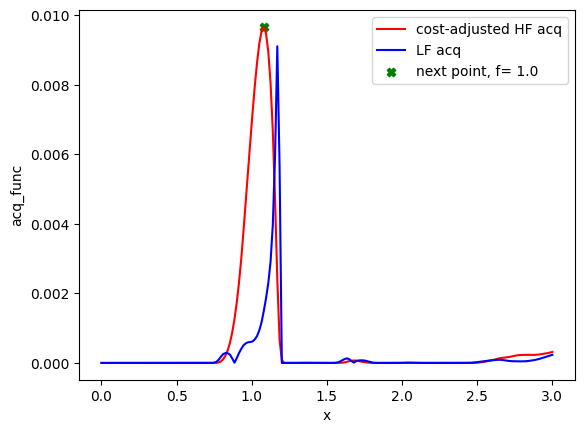

[ 81  80 273]
[1.08 1.  ] 1.08
Evaluation 13 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.39it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:34<00:00,  3.23it/s]

Completed. Saving
Time (s) to complete simulation 4: 214.2272515296936


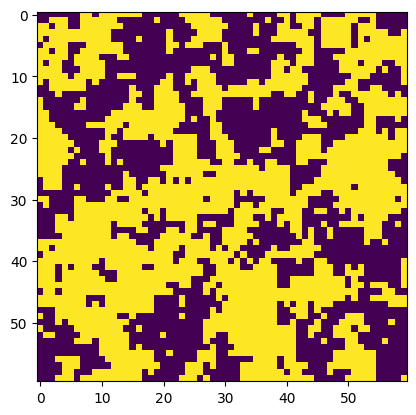

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:17<00:00, 58.82it/s, 7 steps of size 4.92e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.51      0.28      0.50      0.12      1.00    526.45      1.00
  k_length      0.03      0.01      0.03      0.02      0.05    334.92      1.00
   k_scale      0.04      0.04      0.03      0.01      0.07    378.11      1.00
     noise      0.02      0.02      0.02      0.00      0.05    295.06      1.00



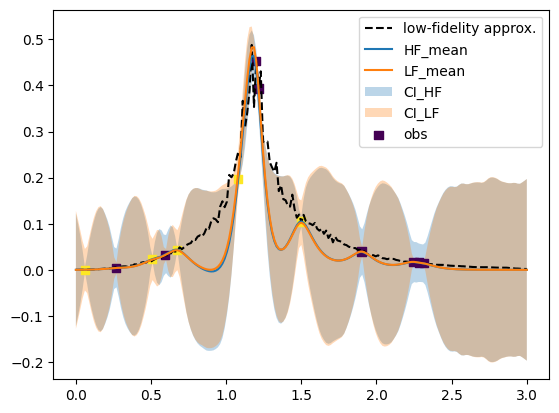

(402,)


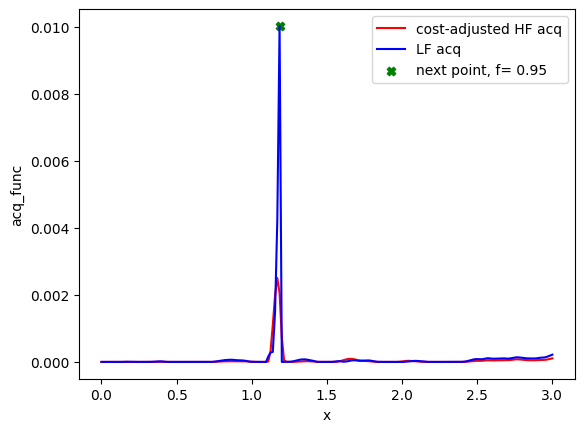

[ 81  80 273  79]
[1.185 0.95 ] 1.185
Evaluation 14 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.77it/s]


Completed. Saving
Time (s) to complete simulation 5: 23.849505186080933


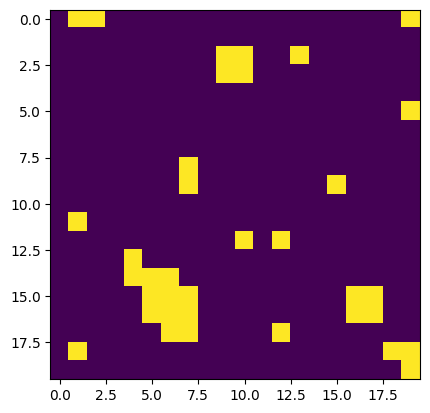

Step:5


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 60.51it/s, 7 steps of size 4.55e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.52      0.28      0.54      0.10      0.98    489.57      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    221.18      1.00
   k_scale      0.03      0.02      0.03      0.01      0.05    335.76      1.00
     noise      0.02      0.02      0.02      0.00      0.05    244.66      1.00



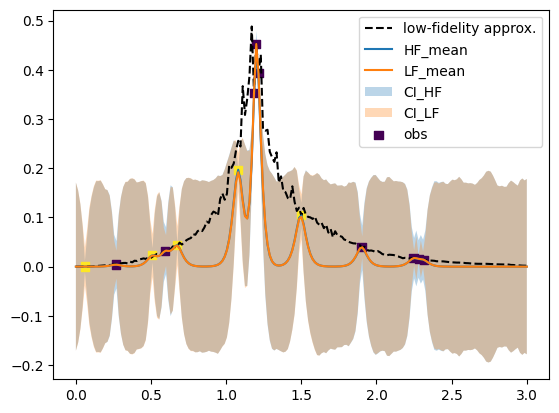

(402,)


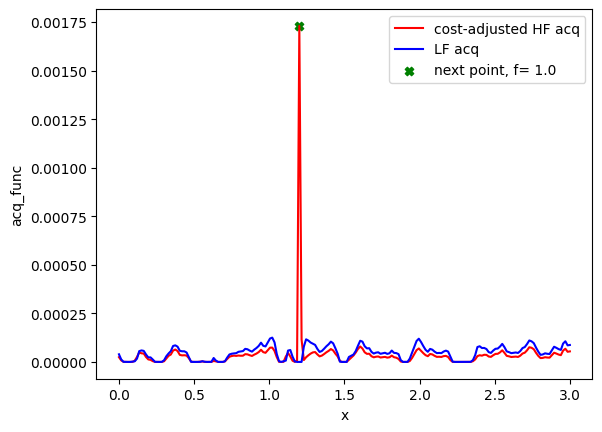

[ 81  80 273  79 281]
[1.2 1. ] 1.2
Evaluation 15 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.25it/s]

Completed. Saving
Time (s) to complete simulation 6: 211.73174619674683


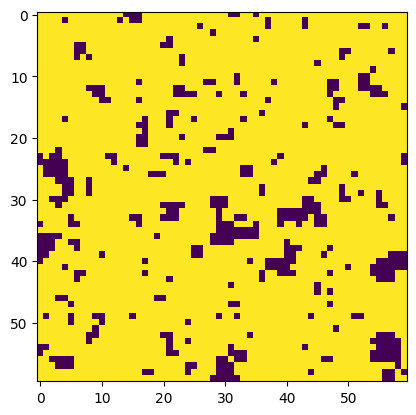

Step:6


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:18<00:00, 54.65it/s, 7 steps of size 3.70e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.72      0.19      0.74      0.44      1.00    226.09      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    293.38      1.00
   k_scale      0.04      0.02      0.03      0.02      0.07    282.05      1.00
     noise      0.02      0.02      0.02      0.00      0.05    308.48      1.00



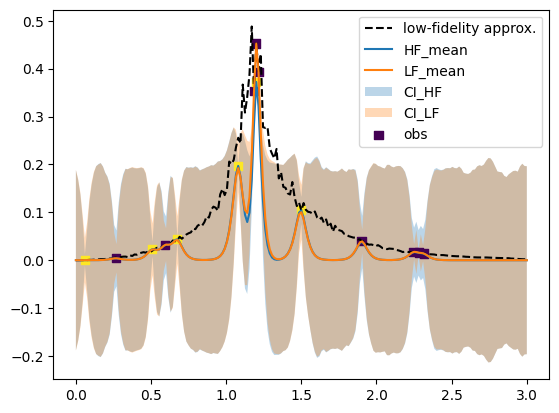

(402,)


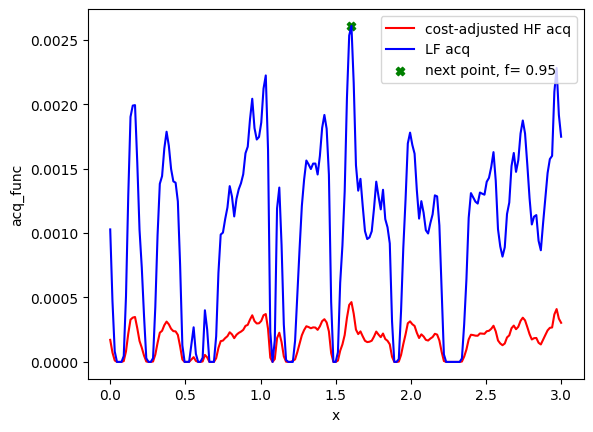

[ 81  80 273  79 281 107]
[1.605 0.95 ] 1.605
Evaluation 16 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.28it/s]


Completed. Saving
Time (s) to complete simulation 7: 24.210794925689697


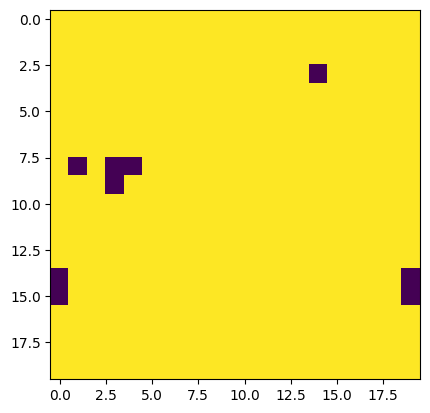

User interraction for policy change
Do you want to update current policy? y- Yes or press ENTER- No
Answer: y
What policies you want to change? Options: 1-parameter space, 2-surrogate model, 3-acq. func., 4-convergence
Enter multiple choices each followed by a space: 2
choices made:  [2]
Provide choice of model: 1-standard 2-structured
enter choice: 2
choices made:  2
Step:7


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 62.39it/s, 23 steps of size 2.26e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.14      0.09      0.12      0.00      0.26    135.63      1.03
         b      1.06      0.57      1.09      0.11      1.82    140.79      1.00
         c      1.35      1.21      0.96      0.01      3.11    157.54      1.00
     delta      0.74      0.19      0.76      0.43      0.99    236.25      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    254.02      1.00
   k_scale      0.03      0.02      0.02      0.01      0.05    251.81      1.00
     noise      0.02      0.02      0.02      0.00      0.05    397.45      1.00



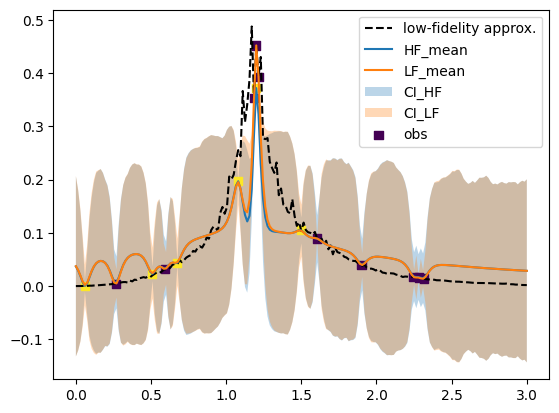

(402,)


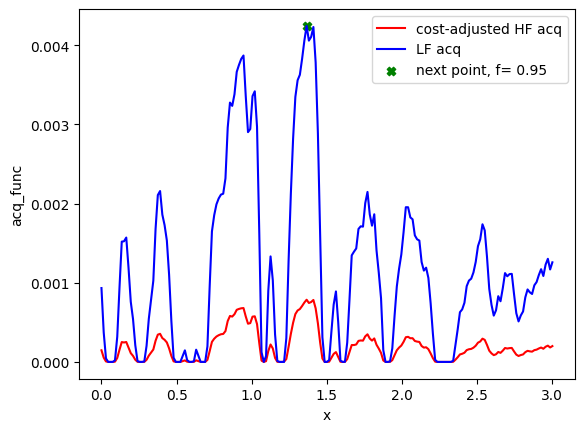

[ 81  80 273  79 281 107  91]
[1.365 0.95 ] 1.365
Evaluation 17 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.66it/s]


Completed. Saving
Time (s) to complete simulation 8: 23.99539542198181


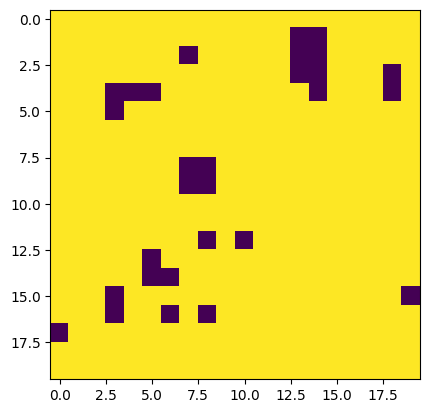

Step:8


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:39<00:00, 25.61it/s, 7 steps of size 2.23e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.14      0.08      0.12      0.03      0.26    115.04      1.01
         b      1.02      0.57      1.06      0.01      1.70    130.34      1.00
         c      1.40      1.12      1.10      0.07      3.05    194.66      1.00
     delta      0.74      0.17      0.76      0.48      0.99    347.67      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    302.00      1.00
   k_scale      0.02      0.01      0.02      0.01      0.04    302.54      1.00
     noise      0.02      0.02      0.02      0.00      0.05    501.95      1.00



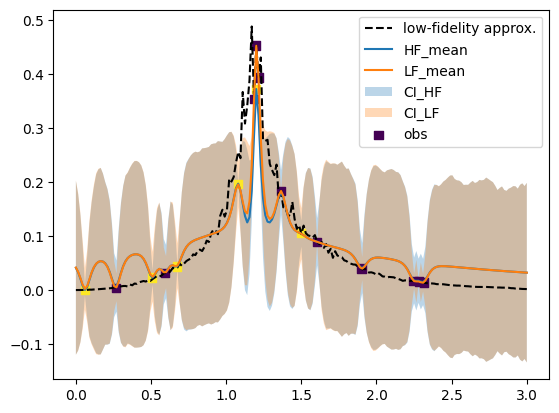

(402,)


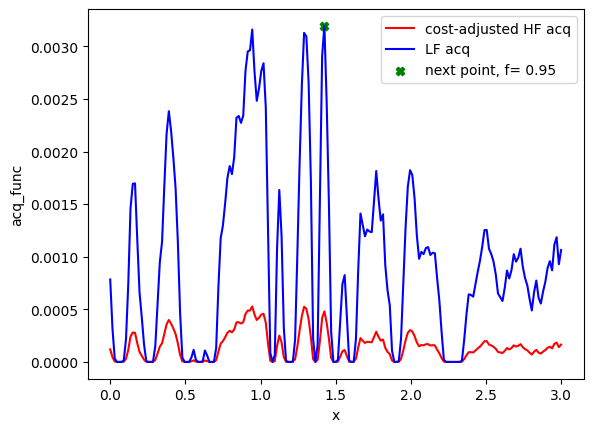

[ 81  80 273  79 281 107  91  95]
[1.425 0.95 ] 1.425
Evaluation 18 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.27it/s]


Completed. Saving
Time (s) to complete simulation 9: 23.697563886642456


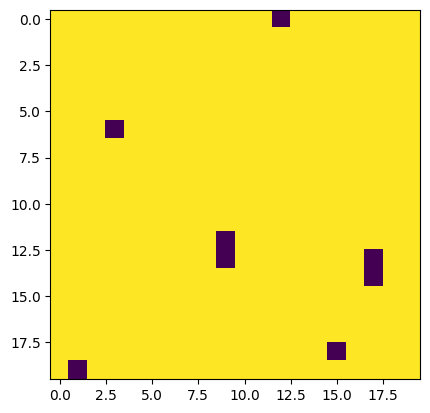

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:9


sample: 100%|██████████| 1000/1000 [00:52<00:00, 19.05it/s, 31 steps of size 1.35e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.15      0.08      0.13      0.03      0.28    138.88      1.00
         b      1.04      0.53      1.09      0.03      1.58    157.67      1.01
         c      1.18      1.04      0.86      0.07      2.69    153.81      1.01
     delta      0.76      0.17      0.78      0.49      1.00    402.99      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    264.50      1.00
   k_scale      0.02      0.01      0.02      0.01      0.04    244.18      1.00
     noise      0.02      0.02      0.02      0.00      0.05    202.17      1.00



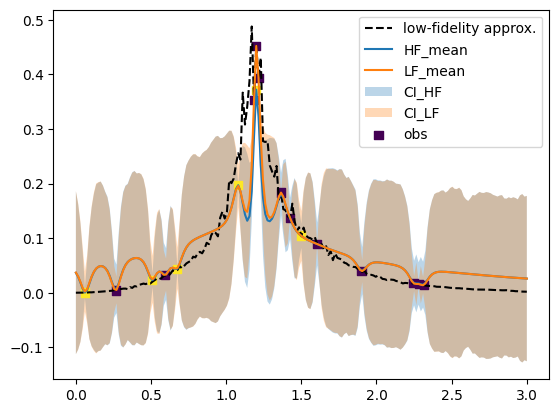

(402,)


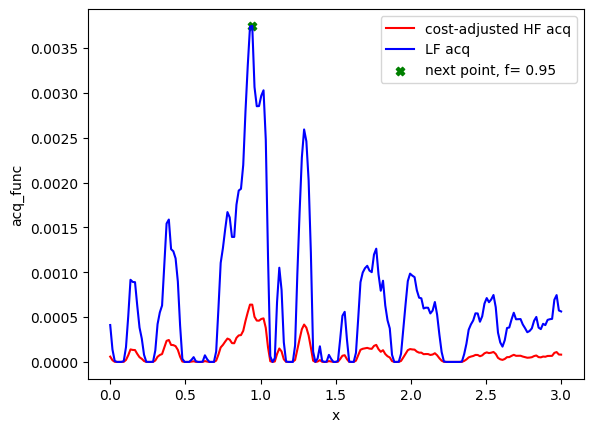

[ 81  80 273  79 281 107  91  95  63]
[0.945 0.95 ] 0.945
Evaluation 19 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.49it/s]


Completed. Saving
Time (s) to complete simulation 10: 24.225346088409424


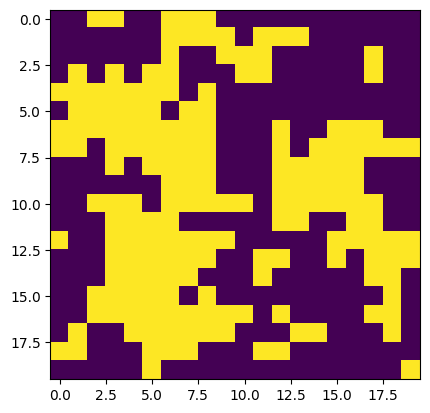

Step:10


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:41<00:00, 23.86it/s, 15 steps of size 2.07e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.14      0.08      0.13      0.01      0.25    120.14      1.03
         b      1.08      0.53      1.15      0.04      1.68     51.77      1.04
         c      1.31      1.11      0.83      0.15      3.09    111.55      1.02
     delta      0.77      0.17      0.82      0.53      1.00    374.67      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    231.47      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    303.98      1.00
     noise      0.02      0.02      0.02      0.00      0.05    480.30      1.00



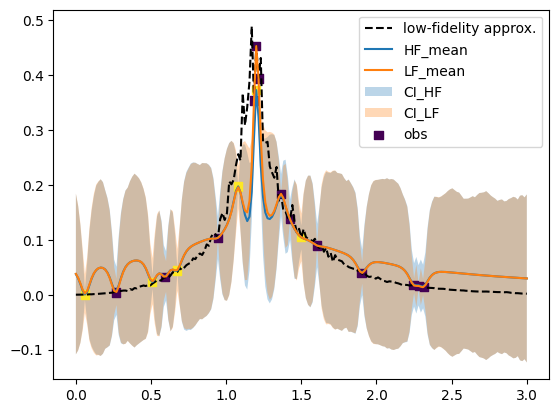

(402,)


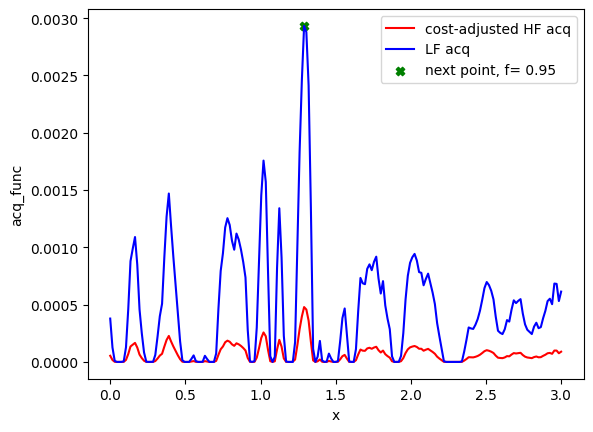

[ 81  80 273  79 281 107  91  95  63  86]
[1.29 0.95] 1.29
Evaluation 20 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.69it/s]


Completed. Saving
Time (s) to complete simulation 11: 23.89247441291809


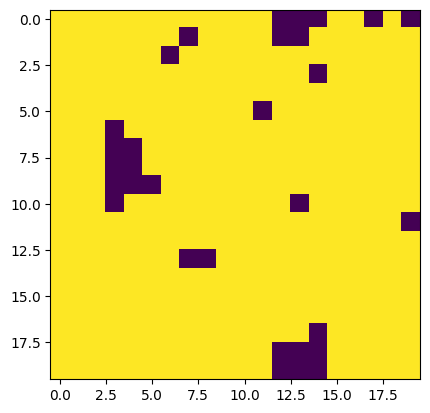

Step:11


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:48<00:00, 20.73it/s, 15 steps of size 1.69e-01. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.16      0.08      0.14      0.05      0.29     43.04      1.03
         b      1.12      0.55      1.17      0.10      1.66    172.25      1.01
         c      1.24      1.15      0.79      0.10      3.11     79.45      1.01
     delta      0.77      0.15      0.79      0.56      1.00    277.74      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    307.24      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    150.19      1.00
     noise      0.02      0.02      0.02      0.00      0.05    150.69      1.00



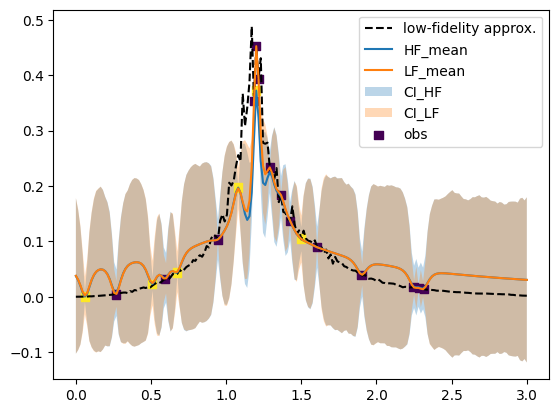

(402,)


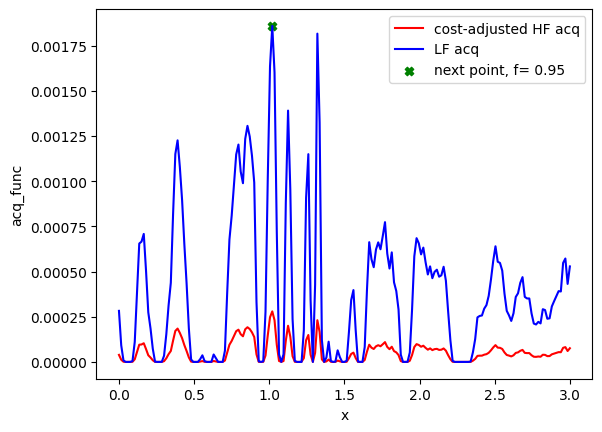

[ 81  80 273  79 281 107  91  95  63  86  68]
[1.02 0.95] 1.02
Evaluation 21 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.61it/s]


Completed. Saving
Time (s) to complete simulation 12: 24.091043710708618


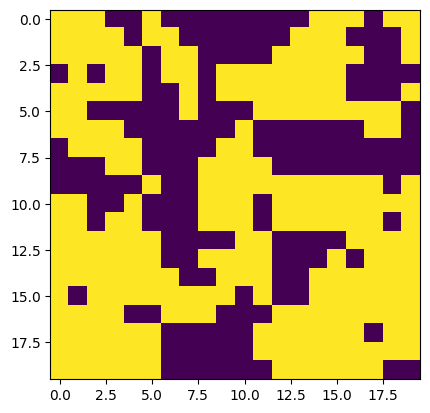

Step:12


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:53<00:00, 18.69it/s, 15 steps of size 2.12e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.16      0.07      0.15      0.04      0.27     58.45      1.04
         b      1.13      0.43      1.17      0.35      1.74     71.75      1.00
         c      1.05      1.06      0.58      0.03      2.48     89.38      1.02
     delta      0.78      0.16      0.80      0.53      1.00    326.41      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    363.55      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    253.94      1.00
     noise      0.02      0.02      0.02      0.00      0.05    370.60      1.00



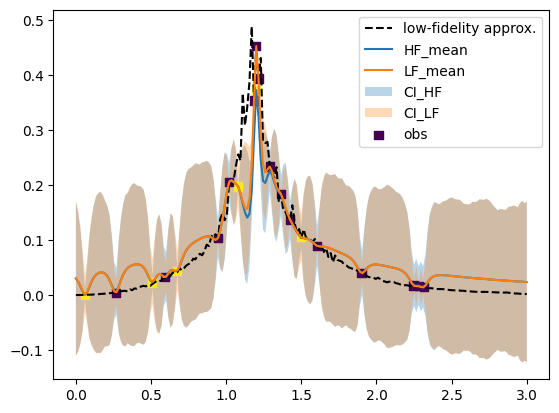

(402,)


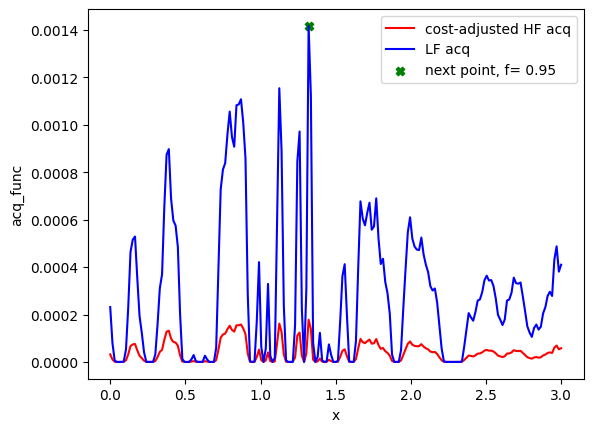

[ 81  80 273  79 281 107  91  95  63  86  68  88]
[1.32 0.95] 1.3199999999999998
Evaluation 22 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.17it/s]


Completed. Saving
Time (s) to complete simulation 13: 24.379155158996582


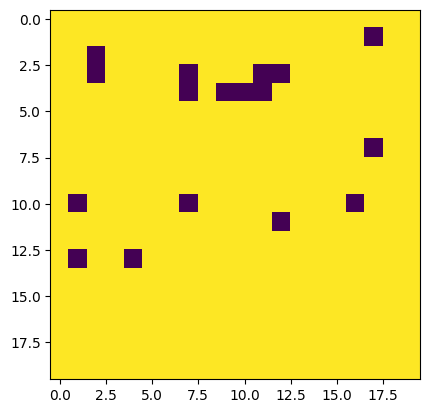

Step:13


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:56<00:00, 17.79it/s, 15 steps of size 1.73e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.08      0.17      0.05      0.30     99.54      1.04
         b      1.15      0.40      1.19      0.43      1.70    101.87      1.00
         c      1.00      1.00      0.57      0.13      2.50     98.54      1.03
     delta      0.77      0.16      0.81      0.53      1.00    454.06      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    262.06      1.00
   k_scale      0.02      0.01      0.01      0.01      0.03    215.60      1.01
     noise      0.03      0.02      0.02      0.00      0.05    387.14      1.00



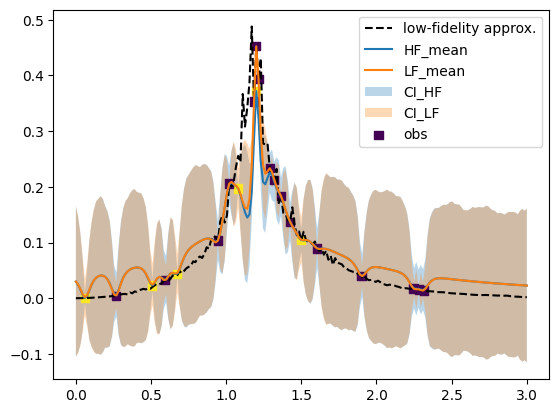

(402,)


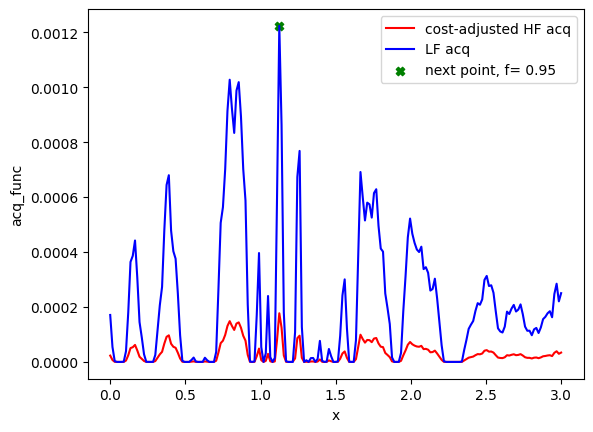

[ 81  80 273  79 281 107  91  95  63  86  68  88  75]
[1.125 0.95 ] 1.125
Evaluation 23 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.09it/s]


Completed. Saving
Time (s) to complete simulation 14: 24.527255296707153


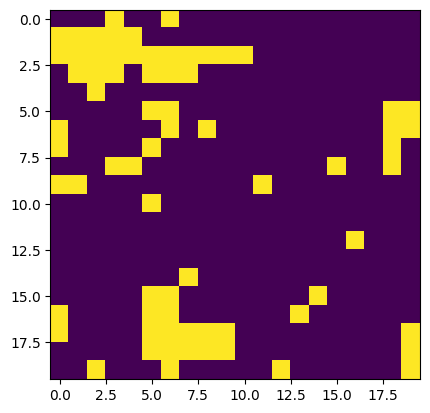

Step:14


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:54<00:00, 18.27it/s, 15 steps of size 2.27e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.08      0.18      0.08      0.31     63.45      1.01
         b      1.02      0.42      1.13      0.08      1.39     33.09      1.00
         c      0.93      1.02      0.49      0.06      2.31     55.45      1.00
     delta      0.79      0.16      0.82      0.52      0.99    404.64      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    303.58      1.00
   k_scale      0.02      0.01      0.01      0.01      0.03    300.44      1.00
     noise      0.03      0.02      0.02      0.00      0.05    322.92      1.00



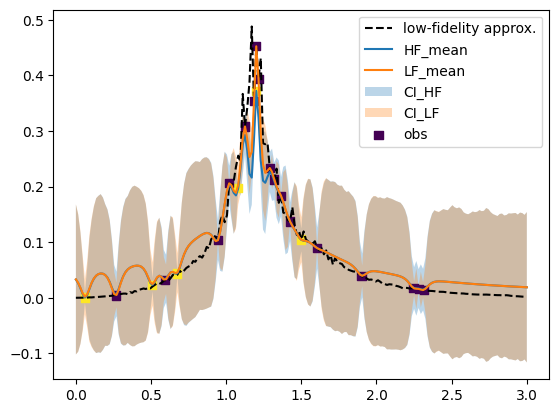

(402,)


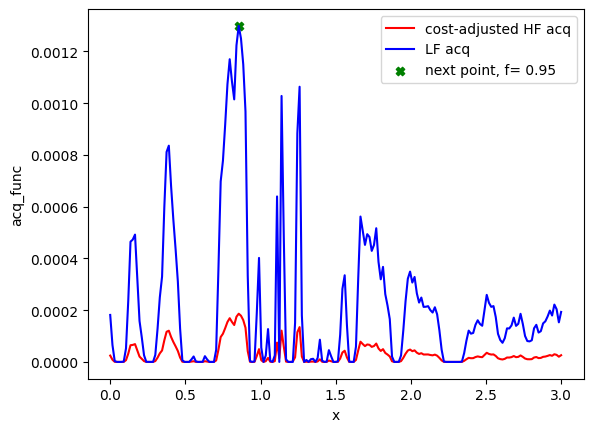

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57]
[0.855 0.95 ] 0.855
Evaluation 24 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.96it/s]


Completed. Saving
Time (s) to complete simulation 15: 24.789520978927612


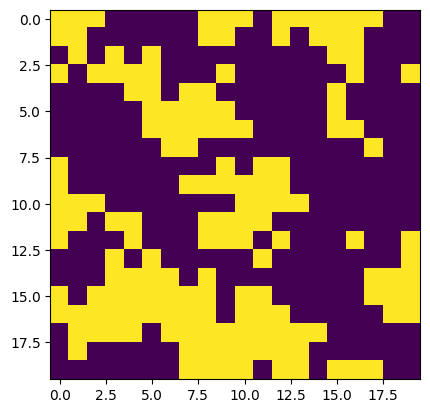

Step:15


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:12<00:00, 13.71it/s, 7 steps of size 1.64e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.18      0.08      0.17      0.07      0.31     24.25      1.03
         b      1.04      0.47      1.16      0.00      1.47     24.06      1.00
         c      1.08      1.12      0.58      0.11      2.78     25.35      1.00
     delta      0.77      0.15      0.81      0.55      1.00    504.15      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    252.63      1.00
   k_scale      0.02      0.01      0.01      0.01      0.03     96.48      1.01
     noise      0.03      0.02      0.02      0.00      0.05    482.94      1.00



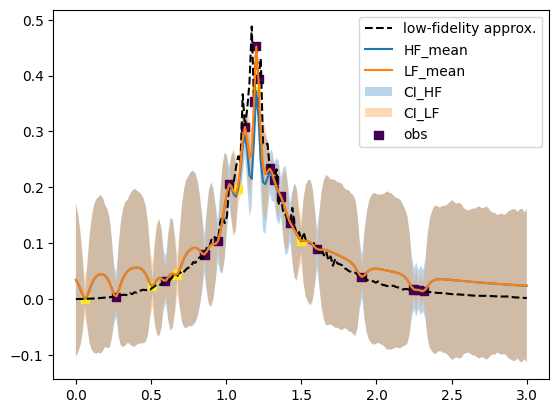

(402,)


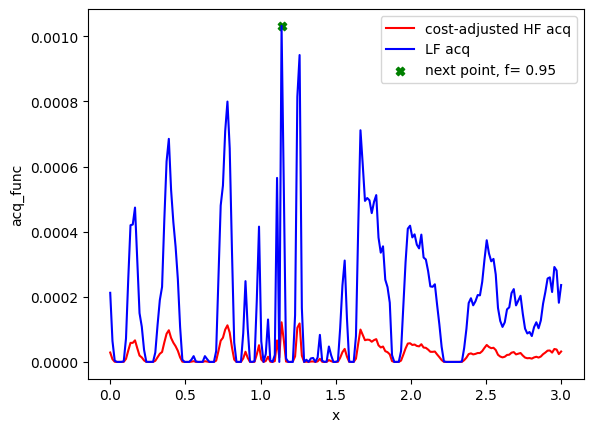

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76]
[1.14 0.95] 1.14
Evaluation 25 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.33it/s]


Completed. Saving
Time (s) to complete simulation 16: 24.371429204940796


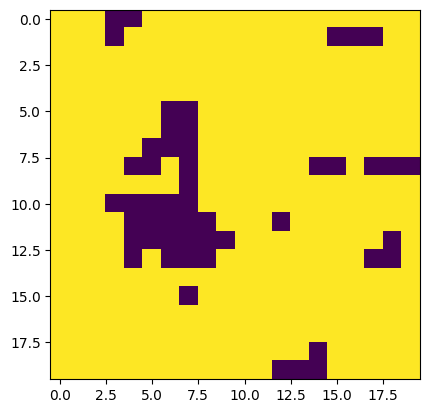

Step:16


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:06<00:00, 15.09it/s, 7 steps of size 2.60e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.08      0.20      0.08      0.35     58.20      1.02
         b      1.11      0.28      1.18      0.69      1.52     33.65      1.02
         c      0.67      0.79      0.37      0.10      1.60     53.22      1.02
     delta      0.78      0.16      0.81      0.52      0.99    330.43      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    200.46      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    168.57      1.00
     noise      0.03      0.02      0.02      0.00      0.05    315.43      1.00



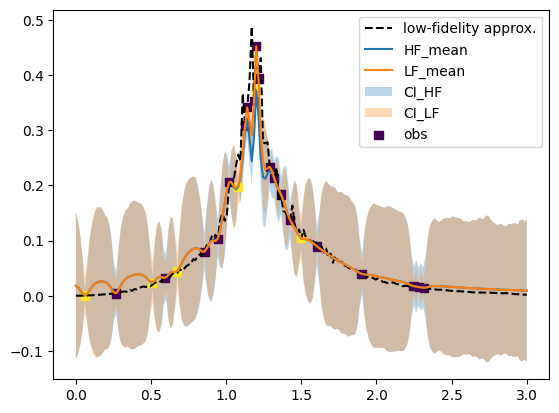

(402,)


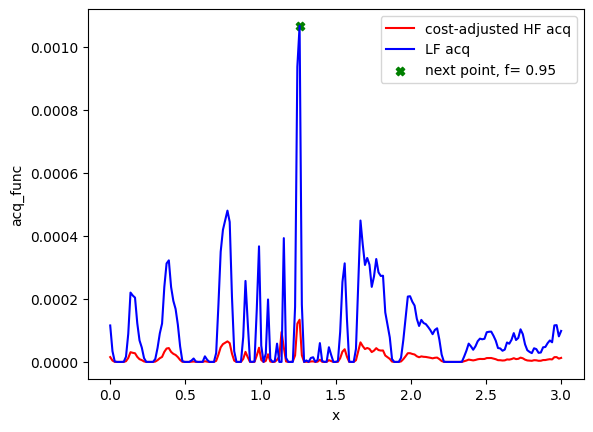

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84]
[1.26 0.95] 1.26
Evaluation 26 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.30it/s]


Completed. Saving
Time (s) to complete simulation 17: 24.505946397781372


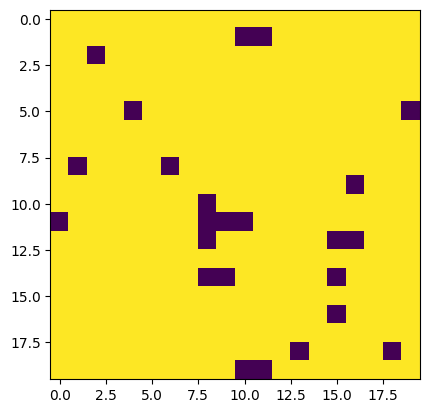

Step:17


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:57<00:00, 17.29it/s, 7 steps of size 2.20e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.08      0.20      0.07      0.33     43.16      1.01
         b      1.14      0.33      1.18      0.66      1.61     70.48      1.00
         c      0.74      0.87      0.38      0.10      1.89     37.35      1.00
     delta      0.79      0.16      0.83      0.54      1.00    383.51      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    235.72      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02     96.45      1.00
     noise      0.02      0.02      0.02      0.00      0.05    476.93      1.00



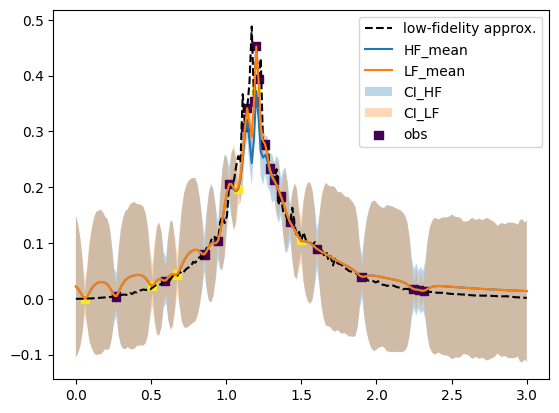

(402,)


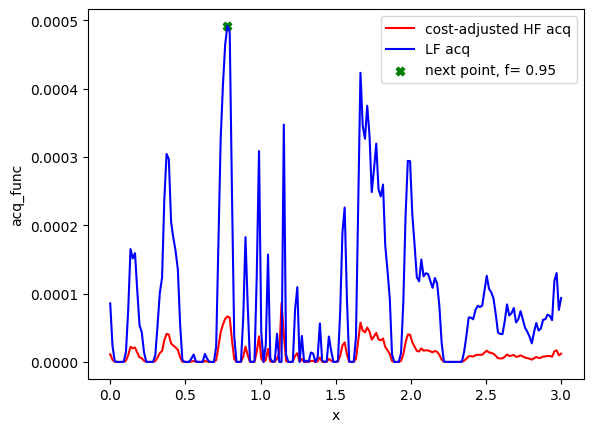

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52]
[0.78 0.95] 0.78
Evaluation 27 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.98it/s]


Completed. Saving
Time (s) to complete simulation 18: 24.70626187324524


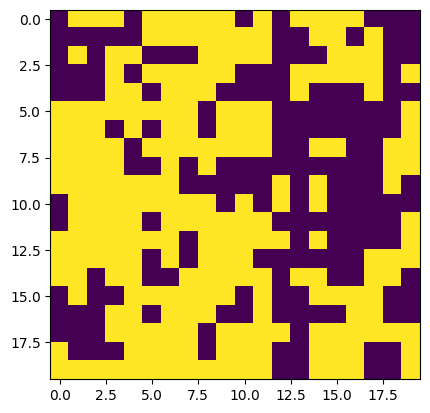

Step:18


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:13<00:00, 13.64it/s, 15 steps of size 2.06e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.22      0.07      0.22      0.10      0.33     73.58      1.00
         b      1.18      0.24      1.20      0.77      1.49     39.96      1.01
         c      0.54      0.61      0.35      0.08      1.02     44.18      1.00
     delta      0.79      0.15      0.83      0.56      1.00    265.43      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    219.41      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    174.31      1.01
     noise      0.02      0.02      0.02      0.00      0.05    348.56      1.01



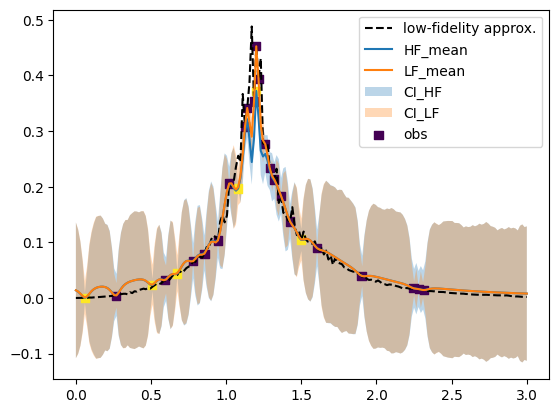

(402,)


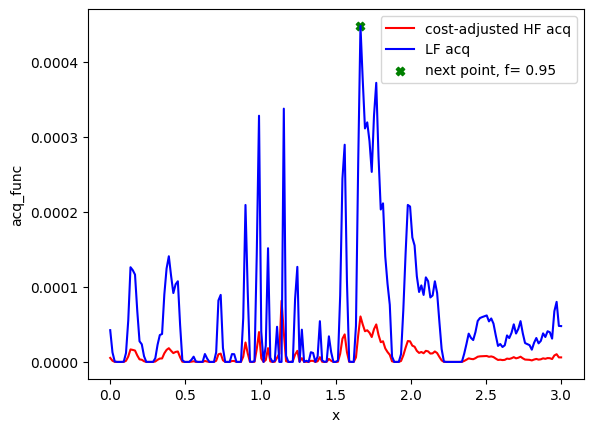

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111]
[1.665 0.95 ] 1.665
Evaluation 28 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.77it/s]


Completed. Saving
Time (s) to complete simulation 19: 24.613850116729736


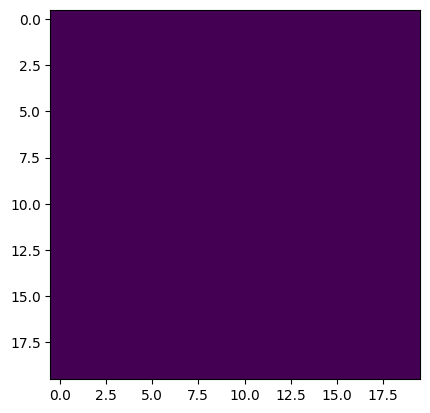

Step:19


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:11<00:00, 13.91it/s, 31 steps of size 2.57e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.19      0.08      0.19      0.09      0.32     20.70      1.12
         b      1.09      0.34      1.17      0.33      1.46     22.26      1.03
         c      0.84      0.89      0.44      0.09      2.27     22.15      1.11
     delta      0.80      0.16      0.83      0.55      1.00    450.40      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    285.74      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    188.40      1.01
     noise      0.02      0.02      0.02      0.00      0.05    322.39      1.00



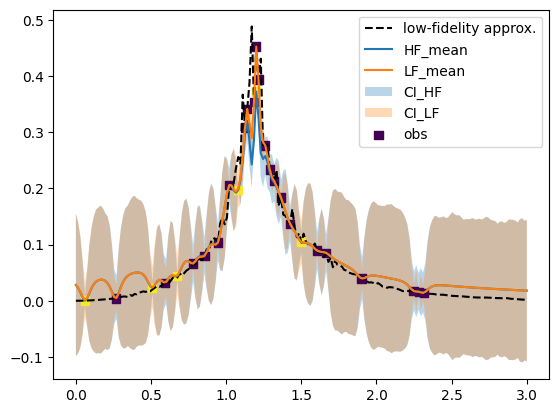

(402,)


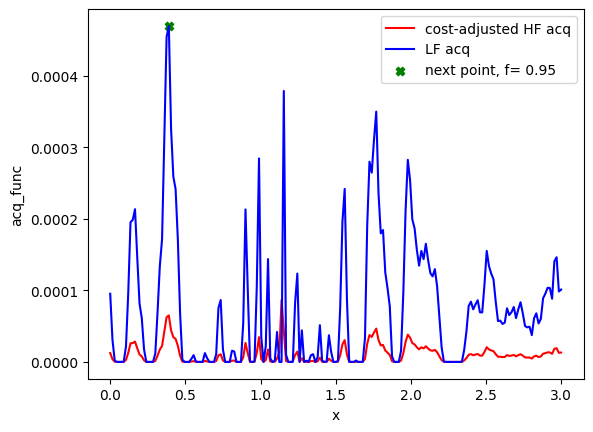

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26]
[0.39 0.95] 0.39
Evaluation 29 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.56it/s]


Completed. Saving
Time (s) to complete simulation 20: 25.154896020889282


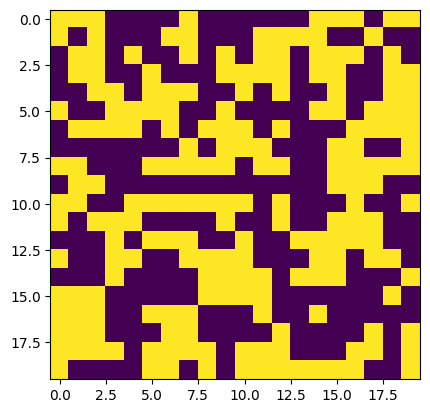

User interraction for policy change
Do you want to update current policy? y- Yes or press ENTER- No
Answer: y
What policies you want to change? Options: 1-parameter space, 2-surrogate model, 3-acq. func., 4-convergence
Enter multiple choices each followed by a space: 4
choices made:  [4]
Provide new number of total iterations.
enter value: 30
iteration:  30
Step:20


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:03<00:00, 15.83it/s, 15 steps of size 2.88e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.23      0.07      0.22      0.09      0.33     91.04      1.01
         b      1.23      0.16      1.21      1.01      1.37    190.35      1.00
         c      0.47      0.60      0.30      0.13      0.90     45.21      1.00
     delta      0.81      0.15      0.85      0.57      1.00    273.71      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    307.14      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    369.05      1.00
     noise      0.02      0.02      0.02      0.00      0.05    303.04      1.00



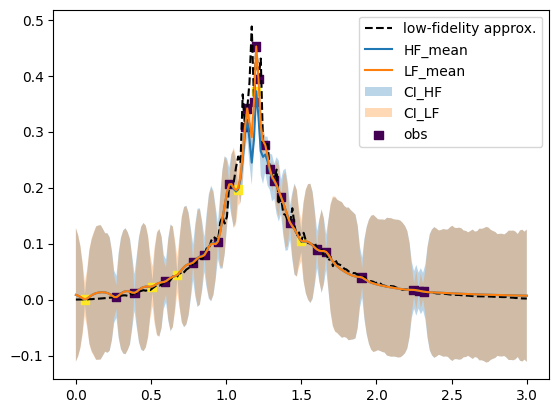

(402,)


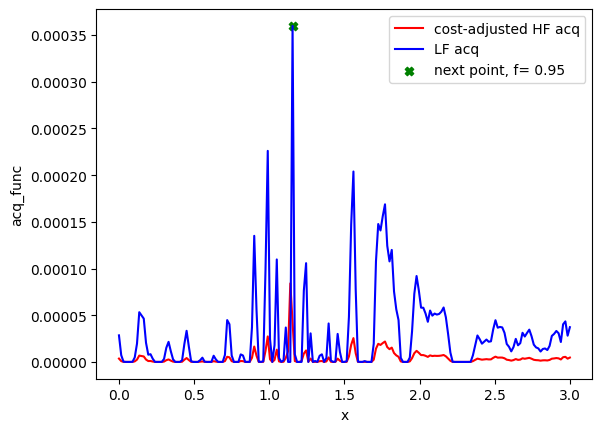

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77]
[1.155 0.95 ] 1.155
Evaluation 30 of 40
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 27.83it/s]


Completed. Saving
Time (s) to complete simulation 21: 24.619394063949585


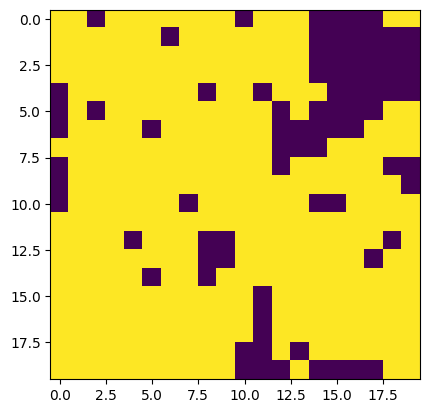

Step:21


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:17<00:00, 12.90it/s, 15 steps of size 2.62e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.21      0.09      0.21      0.06      0.33     13.26      1.07
         b      1.01      0.37      1.16      0.26      1.35      7.72      1.10
         c      0.89      1.02      0.39      0.09      2.42     10.01      1.07
     delta      0.79      0.16      0.83      0.55      1.00    406.01      1.02
  k_length      0.01      0.00      0.01      0.01      0.01    129.04      1.01
   k_scale      0.01      0.01      0.01      0.01      0.02     39.84      1.01
     noise      0.02      0.02      0.02      0.00      0.05    238.53      1.00



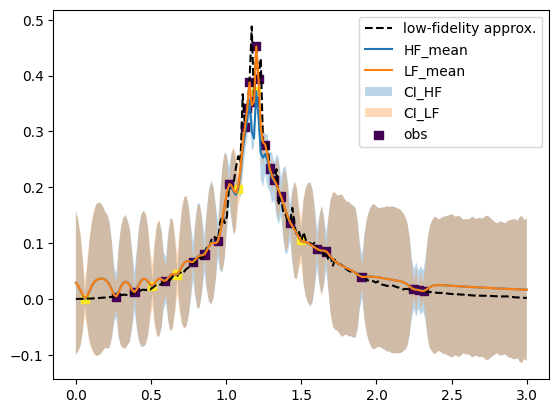

(402,)


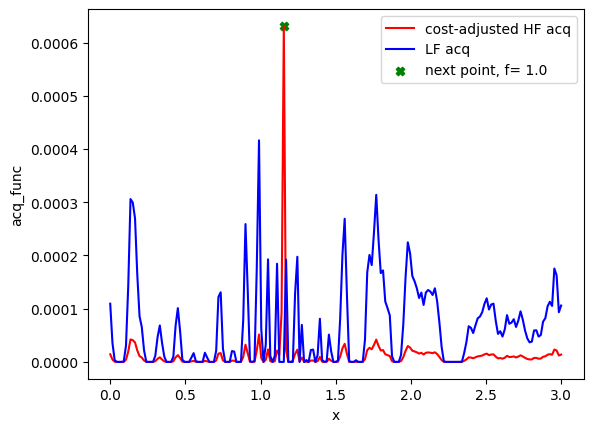

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77 278]
[1.155 1.   ] 1.155
Evaluation 31 of 40
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:36<00:00,  3.19it/s]


Completed. Saving
Time (s) to complete simulation 22: 216.28441405296326


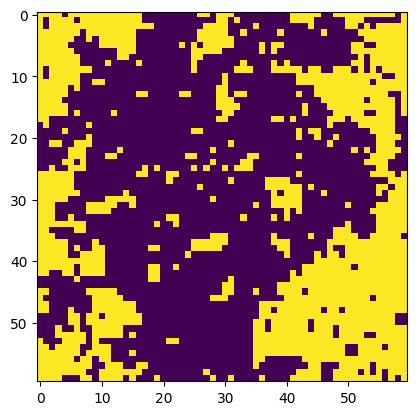

Step:22


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [01:27<00:00, 11.38it/s, 15 steps of size 2.55e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.25      0.07      0.25      0.12      0.37    146.74      1.00
         b      1.20      0.10      1.20      1.08      1.35    233.71      1.00
         c      0.36      0.41      0.27      0.10      0.52    109.72      1.00
     delta      0.83      0.12      0.85      0.66      1.00    369.59      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    373.93      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    290.73      1.00
     noise      0.02      0.02      0.02      0.00      0.05    505.76      1.00



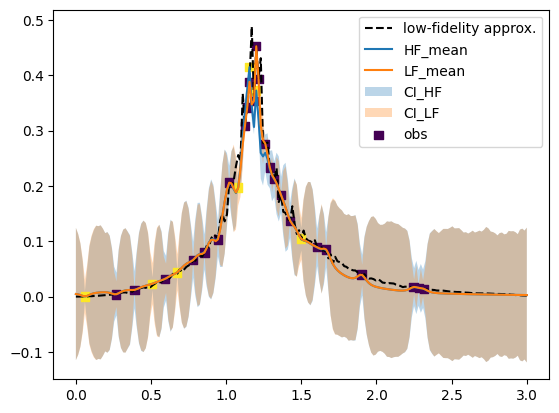

(402,)


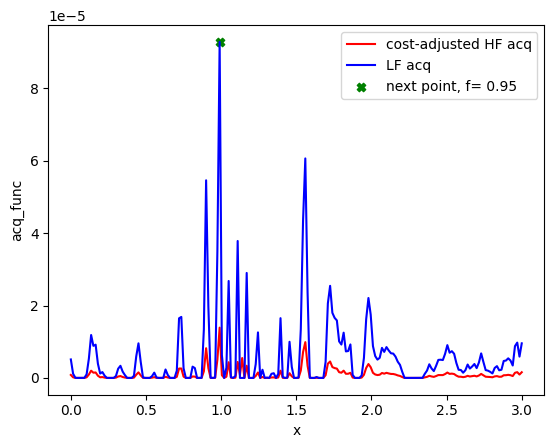

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77 278  66]
[0.99 0.95] 0.99
Evaluation 32 of 40
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.47it/s]


Completed. Saving
Time (s) to complete simulation 23: 25.049953937530518


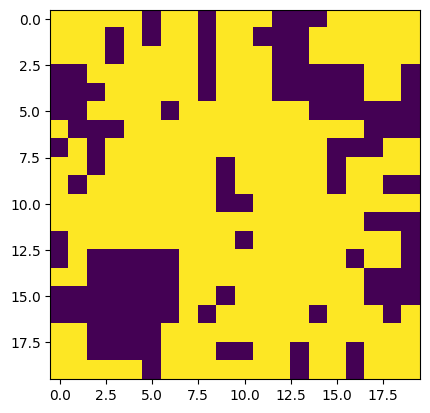

Step:23


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:23<00:00, 42.54it/s, 15 steps of size 1.48e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.23      0.09      0.22      0.09      0.34     39.57      1.01
         b      1.18      0.26      1.20      0.79      1.56     52.17      1.02
         c      0.60      0.74      0.32      0.10      1.45     32.84      1.00
     delta      0.83      0.13      0.86      0.65      1.00    391.23      1.02
  k_length      0.01      0.00      0.01      0.01      0.01    261.67      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    116.14      1.01
     noise      0.02      0.02      0.02      0.00      0.05    382.46      1.00



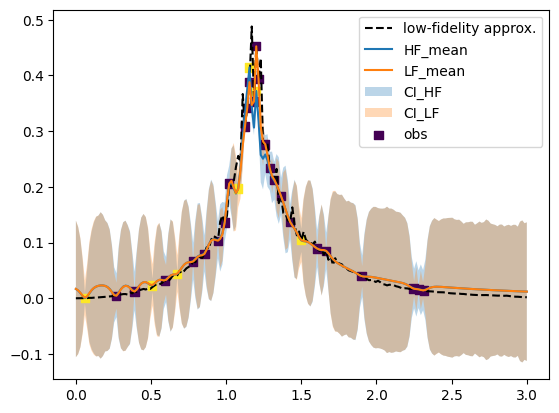

(402,)


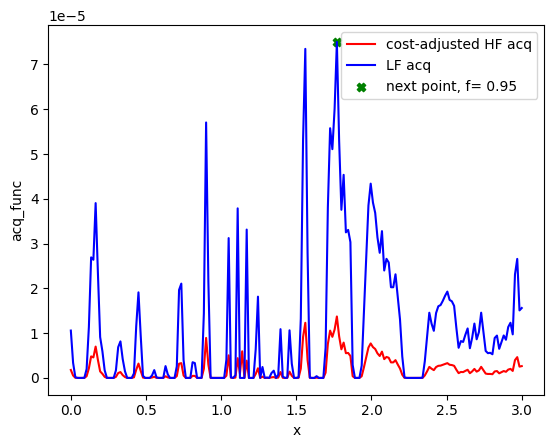

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77 278  66 118]
[1.77 0.95] 1.77
Evaluation 33 of 40
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.42it/s]


Completed. Saving
Time (s) to complete simulation 24: 25.02258324623108


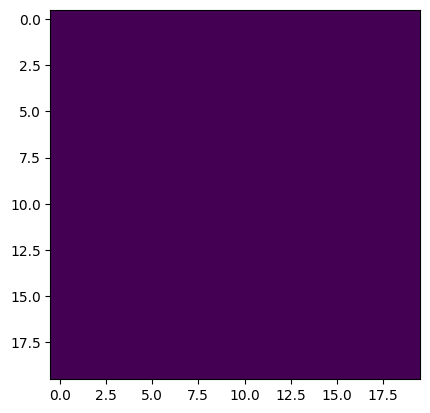

Step:24


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 50.99it/s, 15 steps of size 2.10e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.24      0.08      0.24      0.10      0.36     58.08      1.00
         b      1.15      0.33      1.19      0.83      1.60     29.94      1.02
         c      0.55      0.77      0.29      0.08      1.28     32.35      1.01
     delta      0.83      0.13      0.86      0.64      1.00    326.48      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    297.19      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    257.63      1.00
     noise      0.02      0.02      0.02      0.00      0.05    474.03      1.00



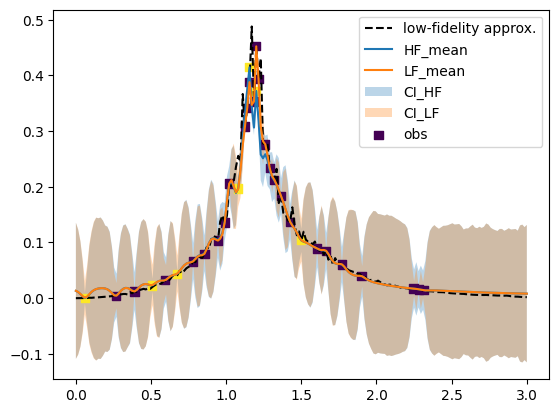

(402,)


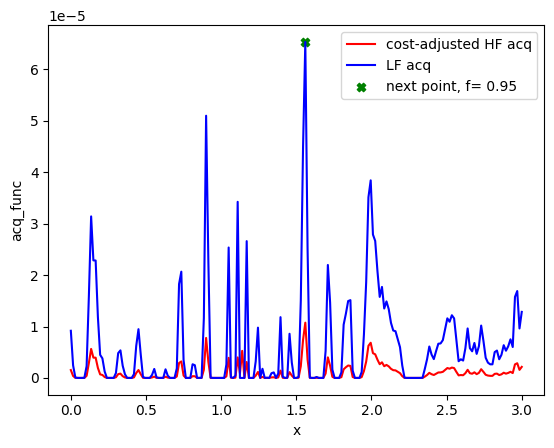

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77 278  66 118 104]
[1.56 0.95] 1.56
Evaluation 34 of 40
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.69it/s]


Completed. Saving
Time (s) to complete simulation 25: 24.674832344055176


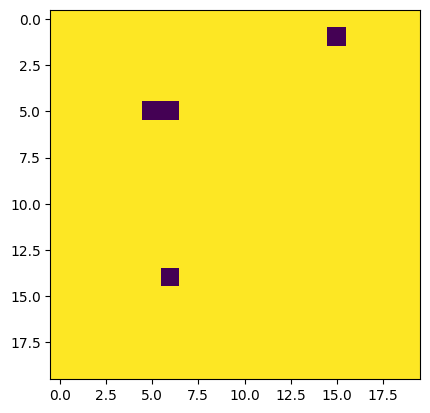

Step:25


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:26<00:00, 38.39it/s, 15 steps of size 2.68e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.23      0.07      0.24      0.10      0.34     34.56      1.03
         b      1.16      0.19      1.19      0.95      1.47     22.45      1.06
         c      0.53      0.67      0.30      0.12      1.40     15.50      1.08
     delta      0.83      0.13      0.86      0.64      1.00    307.42      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    487.64      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    136.22      1.02
     noise      0.03      0.02      0.02      0.00      0.05    346.89      1.00



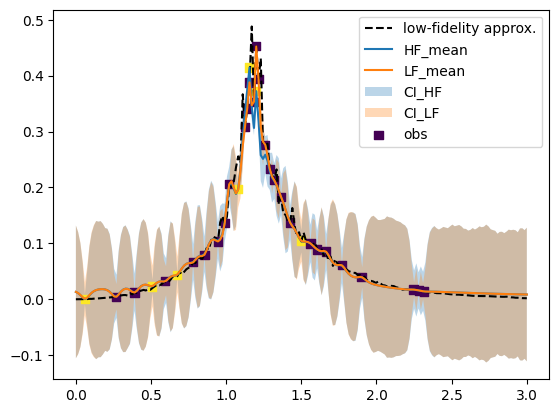

(402,)


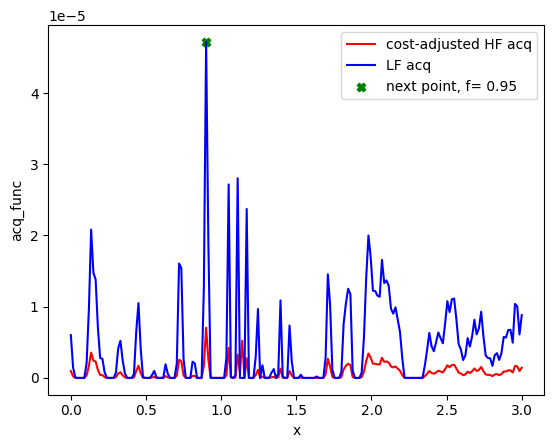

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77 278  66 118 104  60]
[0.9  0.95] 0.8999999999999999
Evaluation 35 of 40
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.69it/s]


Completed. Saving
Time (s) to complete simulation 26: 24.946577072143555


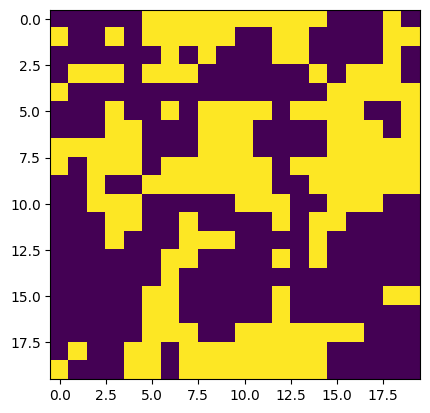

User interraction for policy change
Do you want to update current policy? y- Yes or press ENTER- No
Answer: y
What policies you want to change? Options: 1-parameter space, 2-surrogate model, 3-acq. func., 4-convergence
Enter multiple choices each followed by a space: 3 4
choices made:  [3, 4]
Provide new cost ratio between high and low fidelities
enter value: 1
cost ratio:  1.0
Provide new number of total iterations.
enter value: 26
iteration:  26
Step:26


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 47.22it/s, 15 steps of size 2.24e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.24      0.08      0.24      0.11      0.37     42.42      1.00
         b      1.20      0.16      1.20      0.99      1.37    180.33      1.00
         c      0.45      0.50      0.29      0.07      0.84     34.49      1.00
     delta      0.83      0.13      0.85      0.63      1.00    479.53      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    164.27      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    354.39      1.00
     noise      0.02      0.02      0.02      0.00      0.05    303.91      1.00



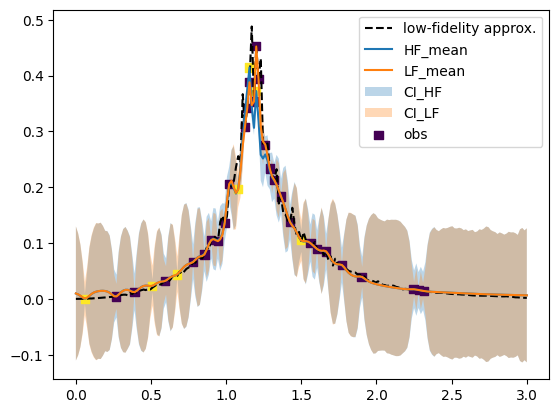

(402,)


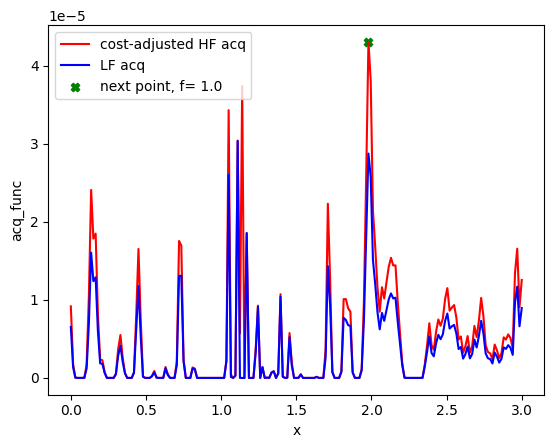

[ 81  80 273  79 281 107  91  95  63  86  68  88  75  57  76  84  52 111
  26  77 278  66 118 104  60 333]
[1.98 1.  ] 1.98
Evaluation 36 of 36
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.19it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:37<00:00,  3.18it/s]

Completed. Saving
Time (s) to complete simulation 27: 218.50487899780273


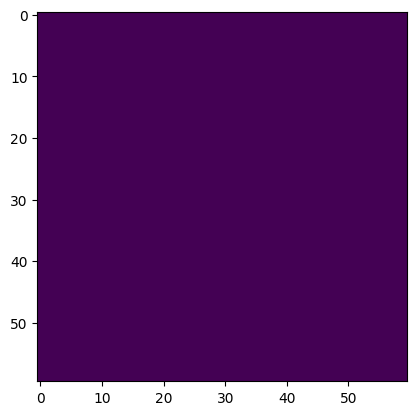

In [19]:
N = 25
cost_ratio = 8.6/1
imodel = 1 # Structured GP
npol = 5 #Number of max iterations without finding better solutions before asking for policy change
f = np.array([1.0, 2.0])

idx = []
p = 0
j = 1
i = 1
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_lf, X_test_hf))
X_test_full = np.vstack((X_test_lf, X_test_hf))
X_test_norm = np.vstack((X_test_lf, X_test_hf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
while (i < N+1):
    print("Step:"+str(i))

    # Multi-fidelity structured GP
    if imodel == 2:
        # Initialize MF model
        gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                                noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
        # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
        gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)
    else:
        gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior,
                                noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
        # Run MCMC to obtain posterior samples
        gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions

        approx_ys_sq = approx_ys_sq[xs<=np.max(X_test[:,0])]
        xs = xs[xs<=np.max(X_test[:,0])]

        approx_ys_sq = approx_ys_sq[xs>=np.min(X_test[:,0])]
        xs = xs[xs>=np.min(X_test[:,0])]
        if imodel == 2:
            y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
            y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        else:
            y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
            y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)

        plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(X_test[X_test_lf.shape[0]:, 0], y_pred, label="HF_mean")
        plt.plot(X_test[X_test_lf.shape[0]:, 0], y_pred_lf, label="LF_mean")
        plt.fill_between(
            X_test[X_test_lf.shape[0]:, 0].flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            X_test[X_test_lf.shape[0]:, 0].flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        #Check for the need of policy change
        print("Do you want to update current policy? y- Yes or press ENTER- No")
        ip = str(input("Answer: "))
        if (ip == 'Y' or ip == 'y'):
            print("User interraction for policy change")
            X_test, X_test_norm, imodel, cost_ratio, N, idx = ipolicy(X_test, X_test_norm, imodel, cost_ratio, N, i, idx)
        else:
            break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))


    #Check for the need of policy change
    t_y1 = train_y[-npol]
    t_y2 = np.max(train_y[-4:])
    if (j>=npol) & (t_y1 >= t_y2):
    #if (j>=1):
      #Storing training data of earlier policies
        j = 0
        hist_policy[p] = {'train_x': train_x_full, 'train_x_norm': train_x_full_norm, 'train_y': train_y, 'cost_ratio': cost_ratio}
        p = p + 1
        print("User interraction for policy change")
        train_x_full, train_x_full_norm, train_y, X_test, X_test_norm, imodel, cost_ratio, N, idx = ipolicy(train_x_full, train_x_full_norm, train_y, X_test, X_test_norm, imodel, cost_ratio, N, i, idx)
    j = j + 1
    i = i + 1
    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

#Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:18<00:00, 53.73it/s, 7 steps of size 3.66e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.24      0.07      0.24      0.12      0.35    120.17      1.02
         b      1.20      0.10      1.20      1.08      1.36    149.05      1.01
         c      0.37      0.37      0.28      0.12      0.53     66.67      1.03
     delta      0.83      0.13      0.86      0.64      1.00    377.81      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    438.19      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    246.42      1.00
     noise      0.03      0.02      0.02      0.00      0.05    371.46      1.00



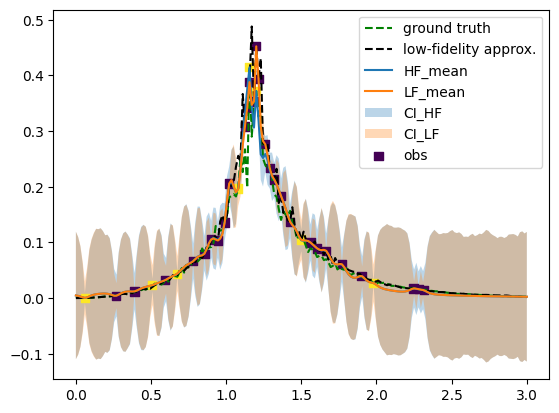

In [20]:
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, true_ys_sq, "g--", label="ground truth")
plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(X_test[X_test_lf.shape[0]:, 0], y_pred, label="HF_mean")
plt.plot(X_test[X_test_lf.shape[0]:, 0], y_pred_lf, label="LF_mean")
plt.fill_between(
    X_test[X_test_lf.shape[0]:, 0].flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    X_test[X_test_lf.shape[0]:, 0].flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

plt.legend(loc="best")
plt.show()

In [33]:
hist_policy, train_x_full[:-1,:], train_y[:-1,:]

({0: {'train_x': array([[2.31396193, 0.95      ],
          [0.06225585, 1.        ],
          [1.9009447 , 0.95      ],
          [2.24641165, 0.95      ],
          [1.49552104, 1.        ],
          [0.67438994, 1.        ],
          [0.59418859, 0.95      ],
          [2.28159214, 0.95      ],
          [0.50733251, 1.        ],
          [0.26501944, 0.95      ],
          [1.215     , 0.95      ],
          [1.2       , 0.95      ],
          [1.08      , 1.        ],
          [1.185     , 0.95      ],
          [1.2       , 1.        ],
          [1.605     , 0.95      ]]),
   'train_x_norm': array([[0.77132064, 0.95      ],
          [0.02075195, 1.        ],
          [0.63364823, 0.95      ],
          [0.74880388, 0.95      ],
          [0.49850701, 1.        ],
          [0.22479665, 1.        ],
          [0.19806286, 0.95      ],
          [0.76053071, 0.95      ],
          [0.16911084, 1.        ],
          [0.08833981, 0.95      ],
          [0.405     , 0.95     

0.00033163158956246047


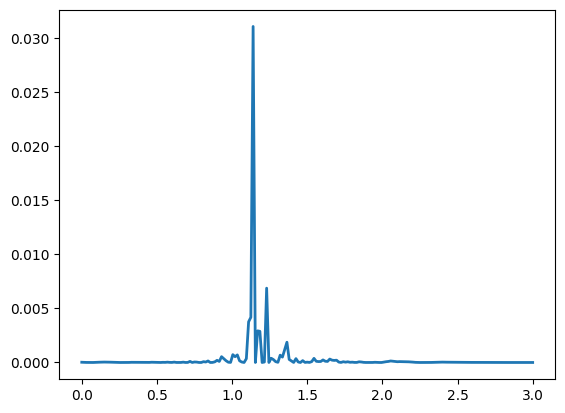

In [21]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# Wrong low fidelity model

In [15]:
n = 10

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]))

Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 17.91it/s]

Completed. Saving
Time (s) to complete simulation 1: 51.71211218833923



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


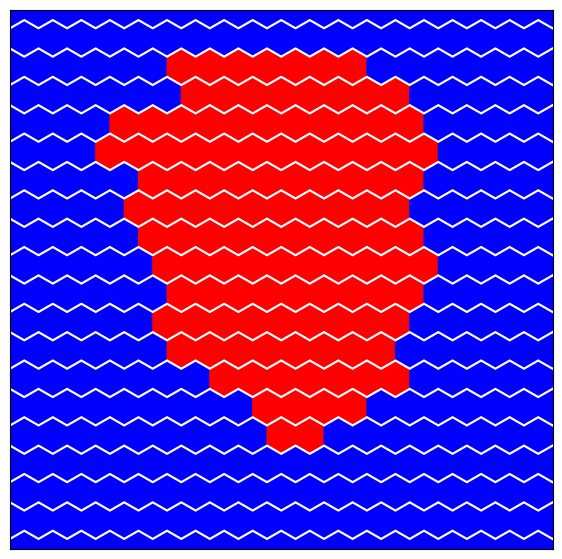

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:34<00:00,  3.23it/s]

Completed. Saving
Time (s) to complete simulation 2: 214.69844031333923


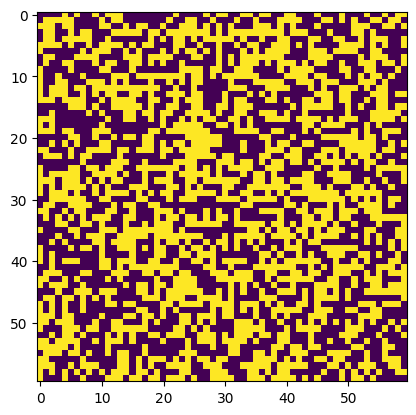

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.24it/s]

Completed. Saving
Time (s) to complete simulation 3: 50.49107813835144


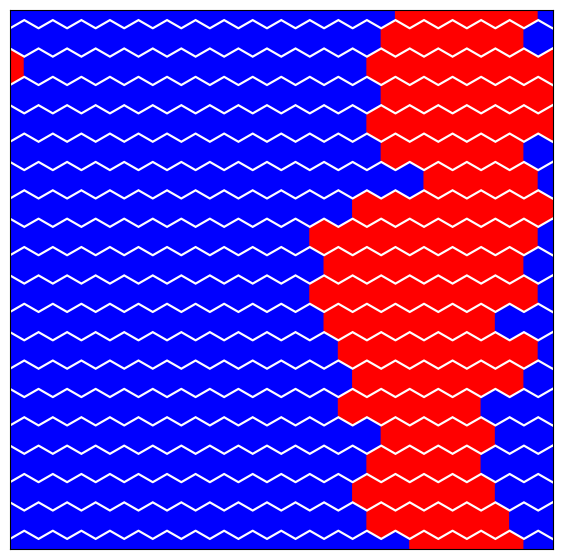

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:22<00:00, 21.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:26<00:00, 18.68it/s]


Completed. Saving
Time (s) to complete simulation 4: 49.60028052330017


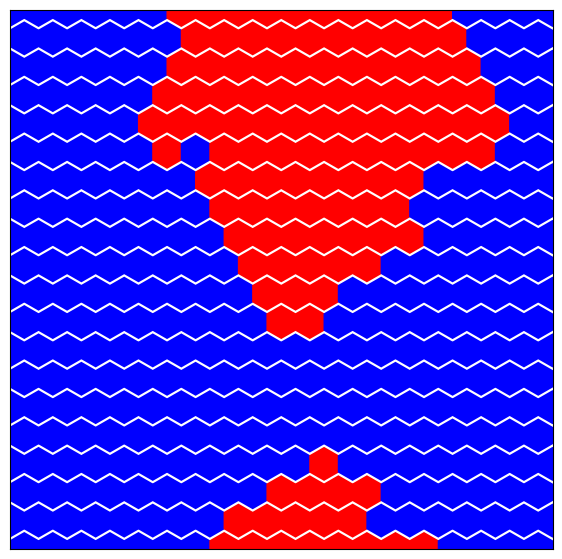

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:53<00:00,  9.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:22<00:00,  3.52it/s]

Completed. Saving
Time (s) to complete simulation 5: 195.43646264076233


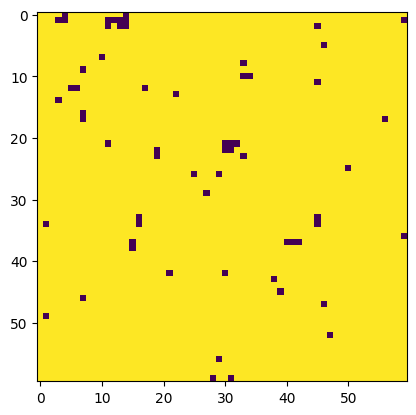

Evaluation 6 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 6: 199.8237521648407


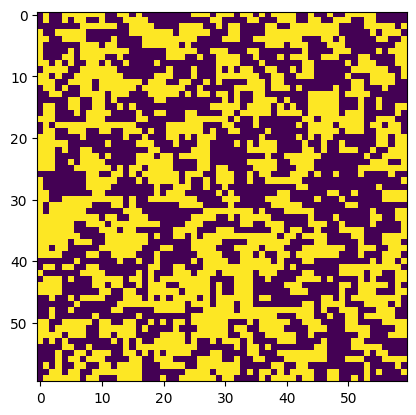

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.27it/s]


Completed. Saving
Time (s) to complete simulation 7: 50.50554442405701


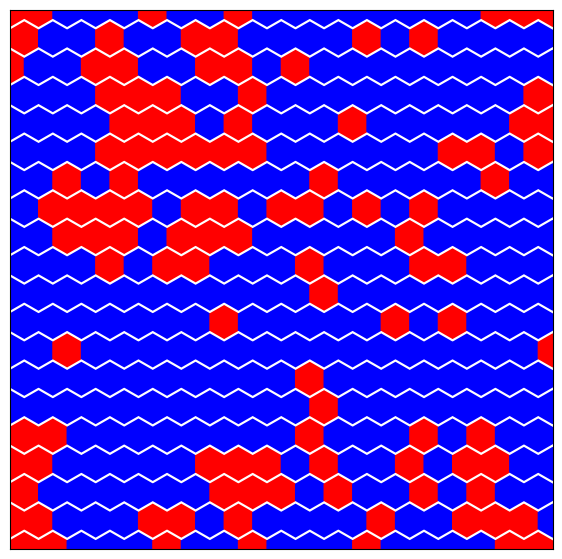

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.39it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.43it/s]

Completed. Saving
Time (s) to complete simulation 8: 50.52404189109802


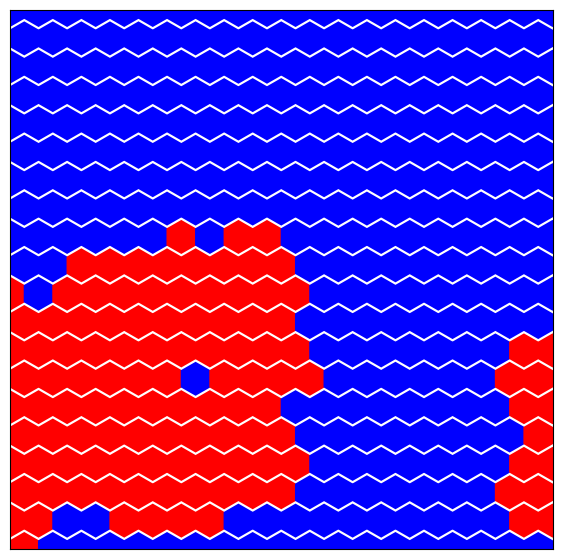

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 9: 200.01524686813354


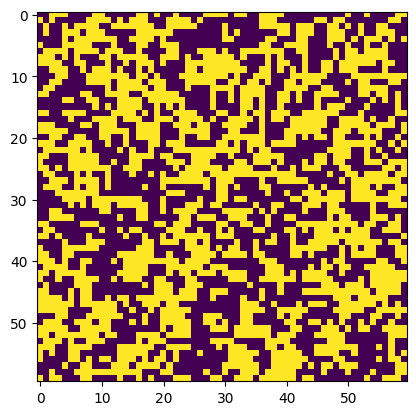

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.37it/s]


Completed. Saving
Time (s) to complete simulation 10: 50.34532070159912


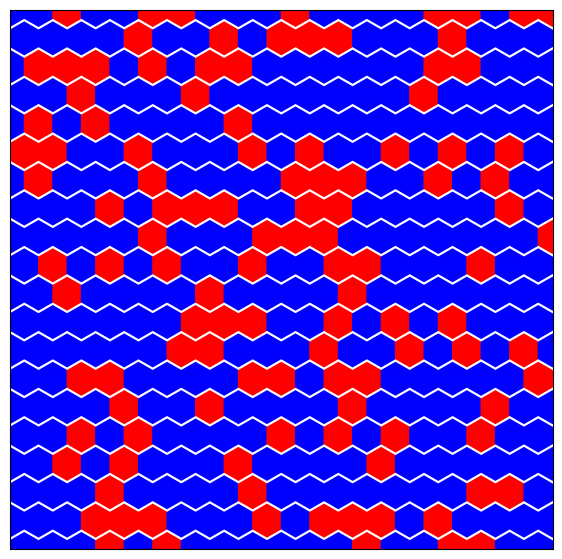

In [16]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i, 0],0,0],
                      [0,Jx[i, 0],0,Jx[i, 0],0],
                      [0,0,Jx[i, 0 ],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        J_mat = np.array([[0,Jx[i, 0],0,Jx[i, 0],0],
                  [Jx[i, 0],0,0,0,Jx[i, 0]],
                  [0,Jx[i, 0],0,Jx[i, 0],0]])
        tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
        sq_sim = tri_sim

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    if train_x_full[i,1] == 1: #High fidelity
        plt.imshow(resultsBO_dict[i]['sim']['config'][-1])

    else: #Low fidelity
        sq_sim.plot_config(resultsBO_dict[i]['sim']['config'][-1])



    plt.show()

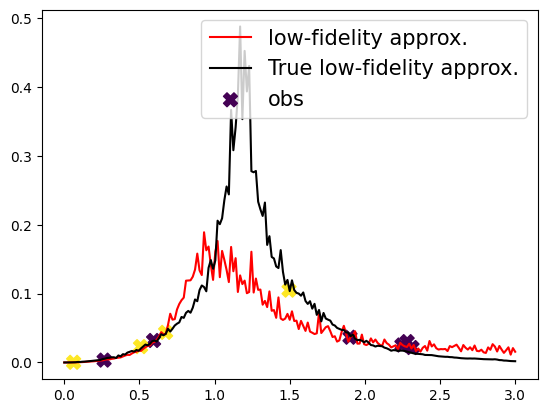

In [17]:
plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")

plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [18]:
@jit
def mean_func(x, params):

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    lb = 0
    ub = 3
    x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)
    f = params["a"]*jnp.exp((-1/2)*(jnp.square(x_data-params["b"])/jnp.square(params["c"])))

    return  f


def mf_priors():
    a = numpyro.sample("a", numpyro.distributions.HalfNormal(0.5)) #Height of peak
    b = numpyro.sample("b", numpyro.distributions.HalfNormal(1.17)) #Position of peak
    c = numpyro.sample("c", numpyro.distributions.HalfNormal(2)) #Broadness of peak
    return {"a": a, "b": b, "c": c}

# Run BO

In [18]:
lb = 0
ub = 3
N_total = 201
bounds = np.array((lb, ub), dtype=float)
fidelities = np.array((0.95, 1.0))

xs = np.linspace(lb, ub, N_total)
xs_norm = (xs-lb)/(ub-lb)
approx_ys_tri = np.zeros(xs.shape[0])
approx_ys_sq = np.zeros(xs.shape[0])
for i in range(0, xs.shape[0]):
    approx_ys_tri[i] = results_dict_tri[1][i]['sim']['SpecificHeat']
    approx_ys_sq[i] = results_dict_square[1][i]['sim']['SpecificHeat']

In [19]:
train_x_full, train_x_full_norm, train_y = hist_policy[0]['train_x'], hist_policy[0]['train_x_norm'], hist_policy[0]['train_y']
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ],
        [1.5       , 0.95      ],
        [0.945     , 0.95      ],
        [0.96      , 0.95      ],
        [0.99      , 0.95      ],
        [0.975     , 0.95      ],
        [1.455     , 0.95      ],
        [0.93      , 0.95      ],
        [0.915     , 0.95      ],
        [0.93      , 1.        ],
        [2.97      , 0.95      ],
        [1.605     , 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.1

In [20]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193, 0.95      ],
        [0.06225585, 1.        ],
        [1.9009447 , 0.95      ],
        [2.24641165, 0.95      ],
        [1.49552104, 1.        ],
        [0.67438994, 1.        ],
        [0.59418859, 0.95      ],
        [2.28159214, 0.95      ],
        [0.50733251, 1.        ],
        [0.26501944, 0.95      ]]),
 array([[0.77132064, 0.95      ],
        [0.02075195, 1.        ],
        [0.63364823, 0.95      ],
        [0.74880388, 0.95      ],
        [0.49850701, 1.        ],
        [0.22479665, 1.        ],
        [0.19806286, 0.95      ],
        [0.76053071, 0.95      ],
        [0.16911084, 1.        ],
        [0.08833981, 0.95      ]]),
 array([[0.02171349],
        [0.00025922],
        [0.03666318],
        [0.02538378],
        [0.10503485],
        [0.04375014],
        [0.03195398],
        [0.03032168],
        [0.02304033],
        [0.00343884]]))

In [19]:
hist_policy={}

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:13<00:00, 72.65it/s, 7 steps of size 3.20e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.43      0.29      0.39      0.01      0.86    306.95      1.00
  k_length      0.12      0.08      0.10      0.05      0.17    158.86      1.02
   k_scale      0.02      0.02      0.02      0.01      0.04    297.78      1.00
     noise      0.03      0.02      0.02      0.00      0.05    282.38      1.00



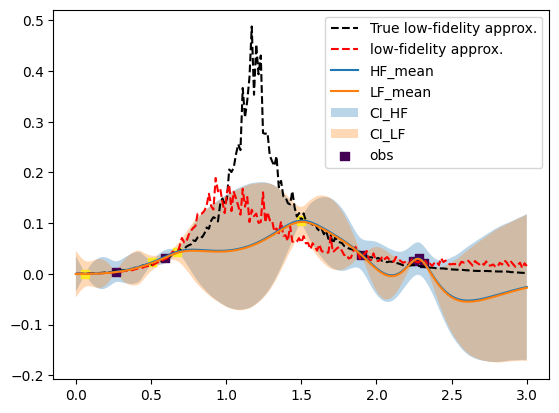

(402,)


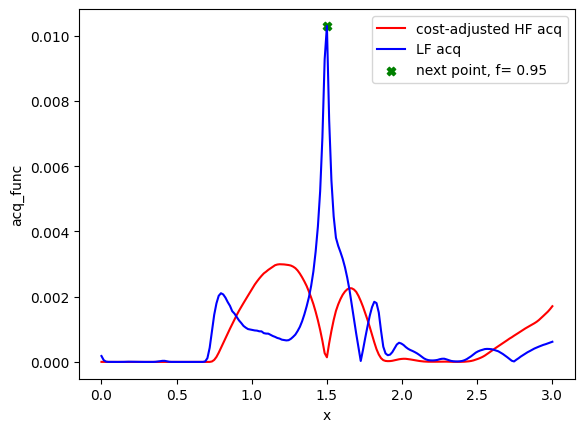

<ipython-input-20-08df7d02626e>:88: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


100
[1.5  0.95] 1.5
Evaluation 11 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.44it/s]

Completed. Saving
Time (s) to complete simulation 2: 50.18329191207886



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


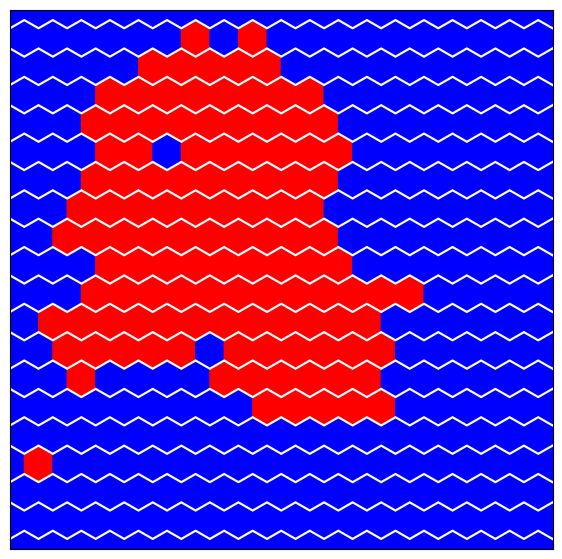

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:2


sample: 100%|██████████| 1000/1000 [00:14<00:00, 67.61it/s, 7 steps of size 4.01e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.61      0.24      0.63      0.26      1.00    256.21      1.00
  k_length      0.15      0.16      0.10      0.03      0.27     48.99      1.02
   k_scale      0.03      0.04      0.02      0.01      0.05    258.67      1.00
     noise      0.02      0.02      0.02      0.00      0.05    427.88      1.00



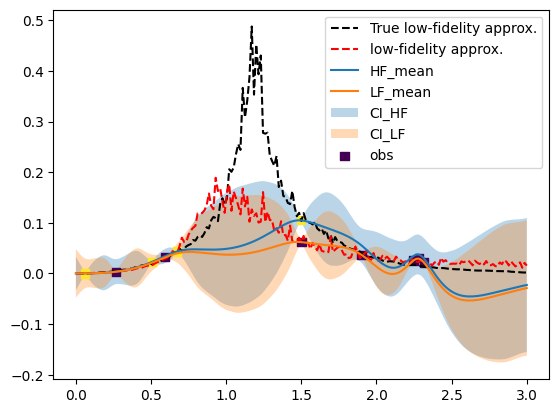

(402,)


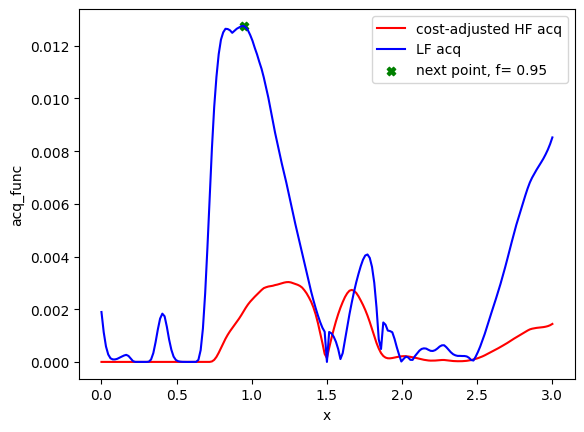

[100  63]
[0.945 0.95 ] 0.945
Evaluation 12 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.39it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 3: 50.477922439575195


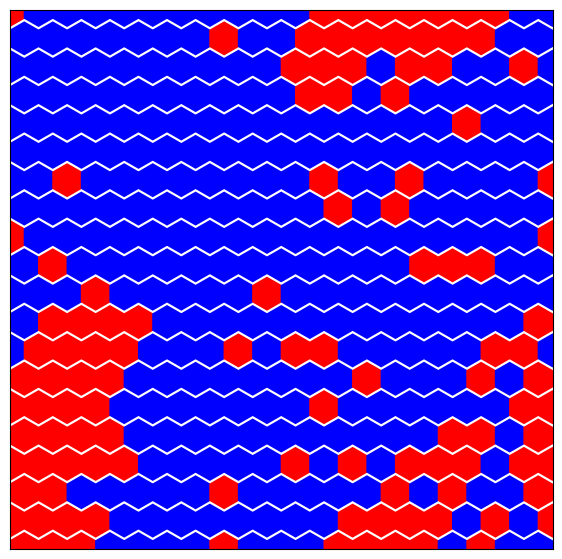

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:3


sample: 100%|██████████| 1000/1000 [00:13<00:00, 76.25it/s, 7 steps of size 5.62e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.60      0.24      0.60      0.24      1.00    301.44      1.00
  k_length      0.11      0.04      0.10      0.05      0.16    370.33      1.00
   k_scale      0.03      0.03      0.02      0.01      0.05    349.58      1.00
     noise      0.03      0.02      0.02      0.00      0.05    364.12      1.00



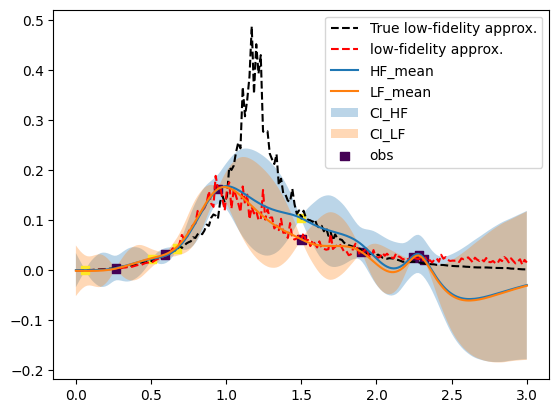

(402,)


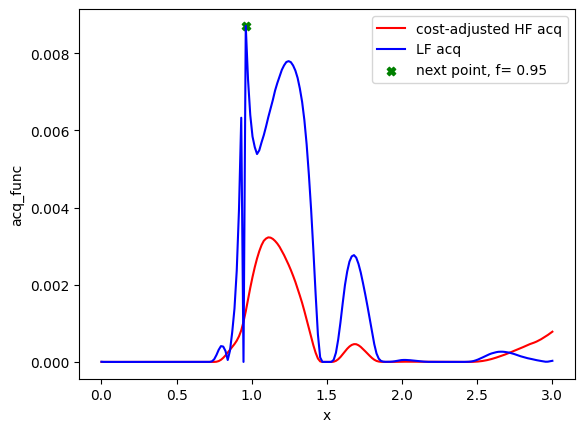

[100  63  64]
[0.96 0.95] 0.96
Evaluation 13 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.37it/s]

Completed. Saving
Time (s) to complete simulation 4: 50.45817518234253



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


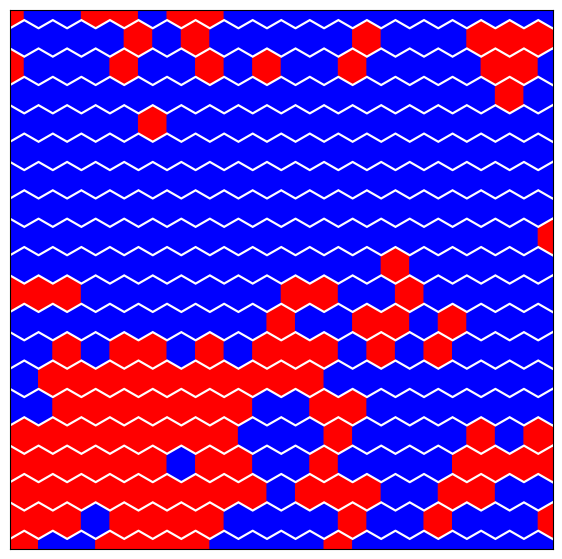

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:4


sample: 100%|██████████| 1000/1000 [00:13<00:00, 71.51it/s, 15 steps of size 5.09e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.58      0.24      0.59      0.19      0.95    272.60      1.00
  k_length      0.11      0.04      0.11      0.05      0.16    364.79      1.00
   k_scale      0.03      0.03      0.02      0.01      0.05    371.43      1.00
     noise      0.02      0.02      0.02      0.00      0.05    367.66      1.00



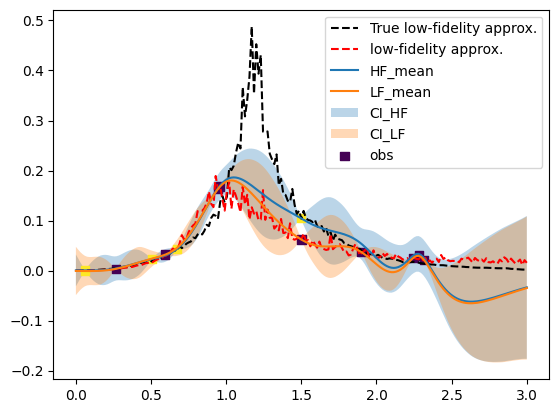

(402,)


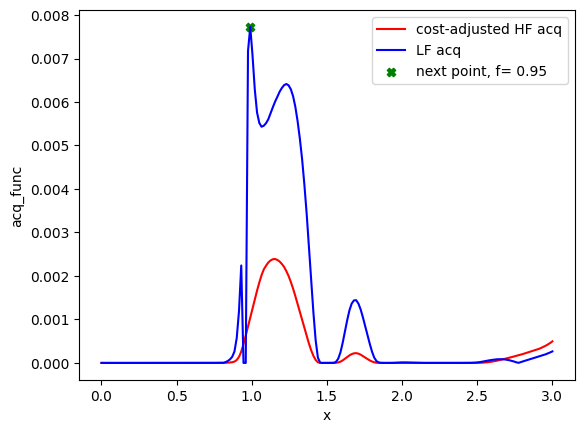

[100  63  64  66]
[0.99 0.95] 0.99
Evaluation 14 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:22<00:00, 21.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.29it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 5: 50.34863543510437


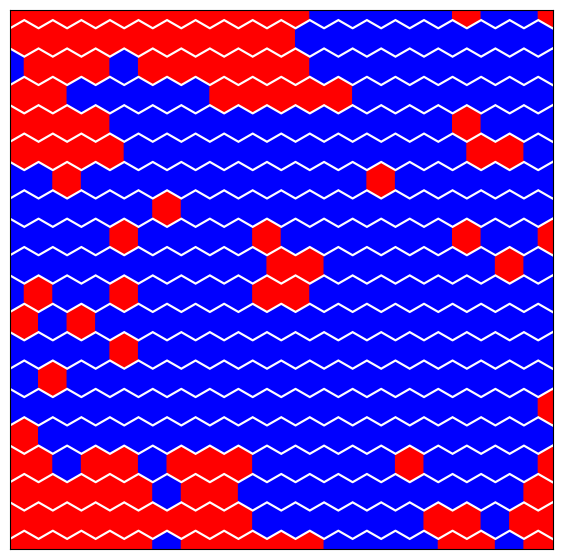

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:5


sample: 100%|██████████| 1000/1000 [00:15<00:00, 64.39it/s, 7 steps of size 4.72e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.65      0.23      0.67      0.31      1.00    307.10      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    260.43      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    412.93      1.00
     noise      0.02      0.02      0.02      0.00      0.05    197.20      1.00



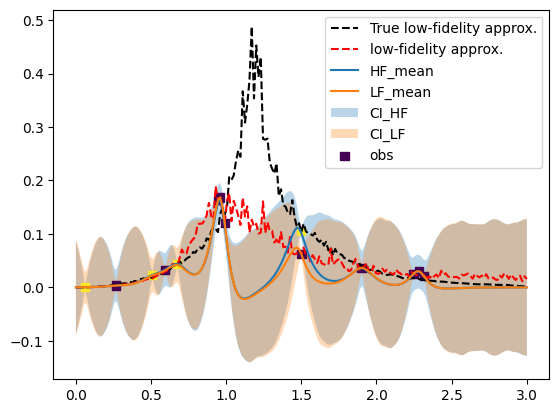

(402,)


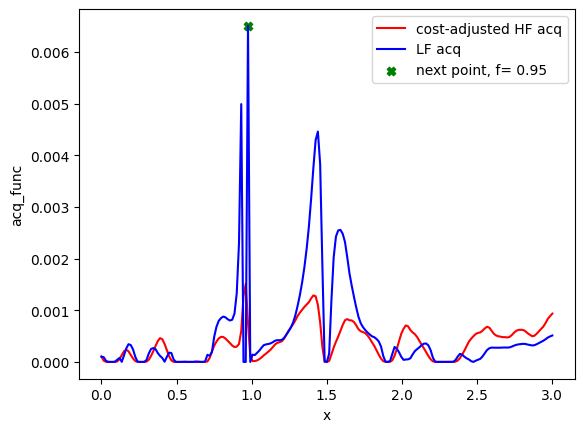

[100  63  64  66  65]
[0.975 0.95 ] 0.975
Evaluation 15 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.31it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 6: 50.34282398223877


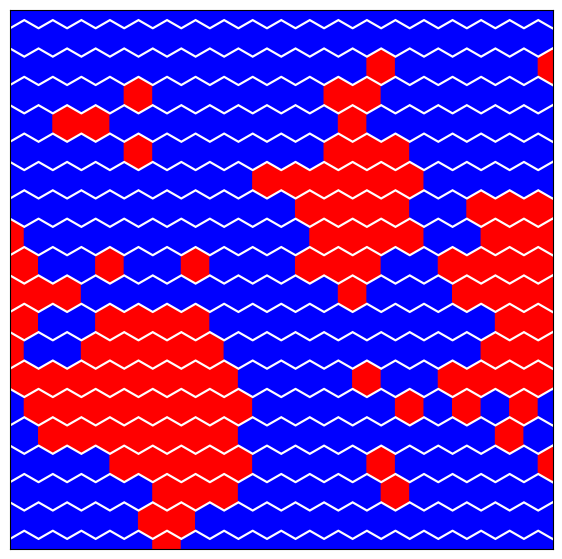

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:6


sample: 100%|██████████| 1000/1000 [00:16<00:00, 60.81it/s, 7 steps of size 4.40e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.63      0.23      0.64      0.31      1.00    323.03      1.00
  k_length      0.02      0.01      0.02      0.02      0.03    191.91      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    368.75      1.00
     noise      0.02      0.02      0.02      0.00      0.05    226.29      1.00



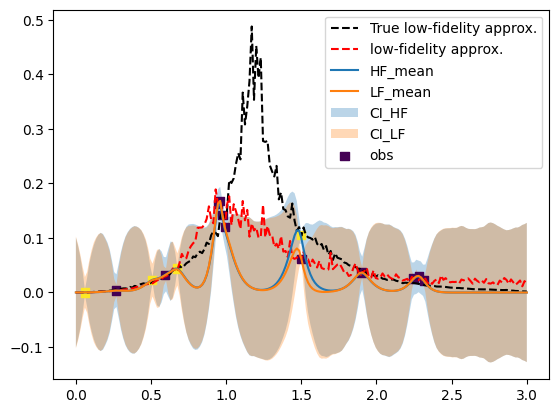

(402,)


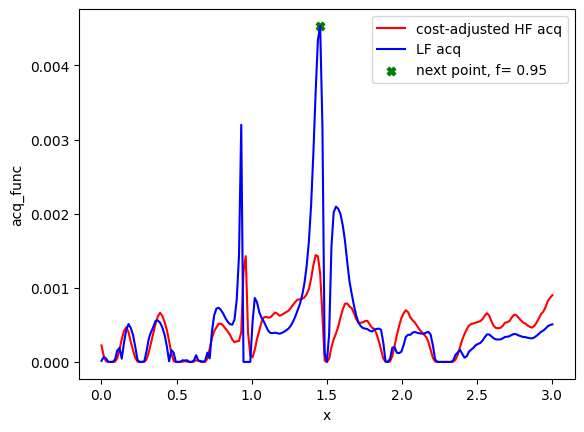

[100  63  64  66  65  97]
[1.455 0.95 ] 1.4549999999999998
Evaluation 16 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.16it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 7: 50.68229293823242


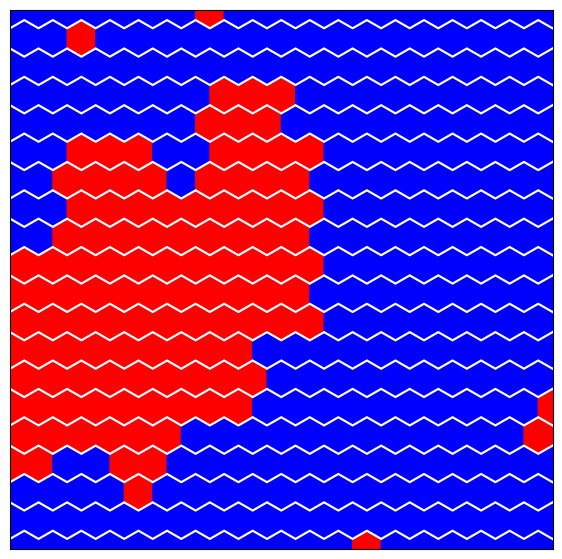

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:7


sample: 100%|██████████| 1000/1000 [00:09<00:00, 110.66it/s, 7 steps of size 4.26e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.65      0.23      0.67      0.31      1.00    355.13      1.00
  k_length      0.02      0.01      0.02      0.02      0.03    189.60      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    388.11      1.00
     noise      0.02      0.02      0.02      0.00      0.05    232.49      1.00



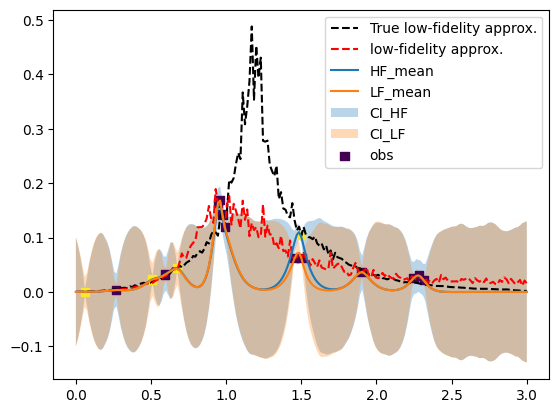

(402,)


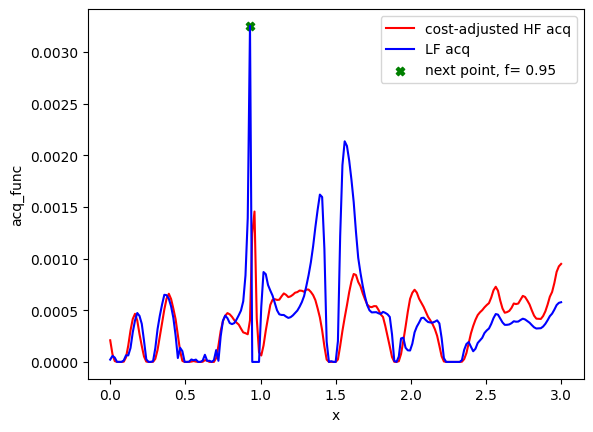

[100  63  64  66  65  97  62]
[0.93 0.95] 0.9299999999999999
Evaluation 17 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.22it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 8: 50.73713135719299


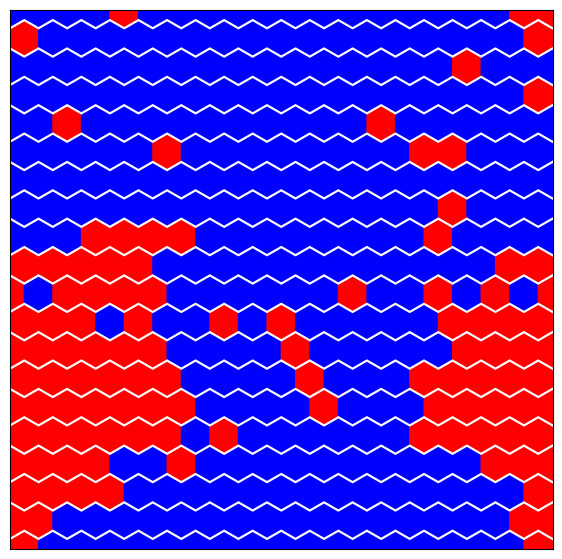

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:8


sample: 100%|██████████| 1000/1000 [00:19<00:00, 52.16it/s, 7 steps of size 4.39e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.63      0.25      0.66      0.22      0.97    525.33      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    266.90      1.00
   k_scale      0.02      0.01      0.01      0.01      0.02    358.81      1.00
     noise      0.02      0.02      0.02      0.00      0.05    217.12      1.00



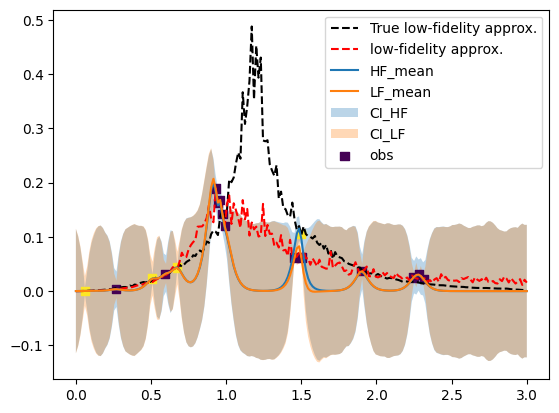

(402,)


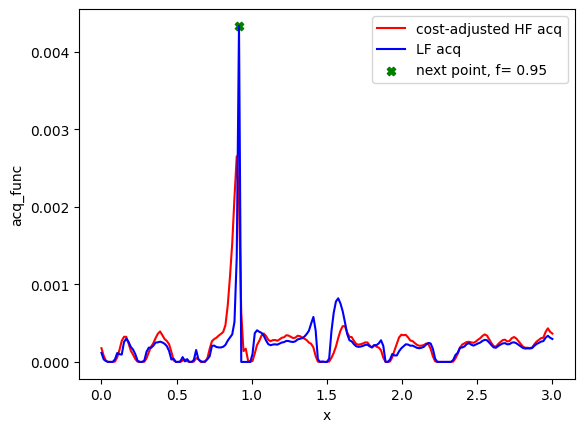

[100  63  64  66  65  97  62  61]
[0.915 0.95 ] 0.9149999999999999
Evaluation 18 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.40it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 9: 50.329246044158936


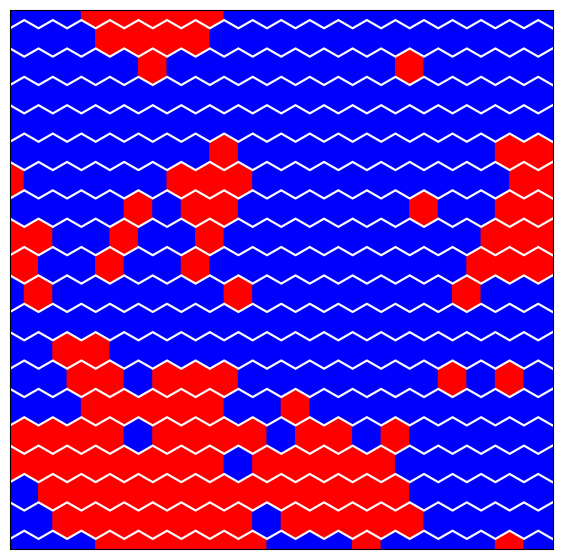

Step:9


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 45.56it/s, 7 steps of size 4.32e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.58      0.25      0.60      0.22      1.00    418.59      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    288.28      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    295.32      1.00
     noise      0.02      0.02      0.02      0.00      0.05    290.65      1.00



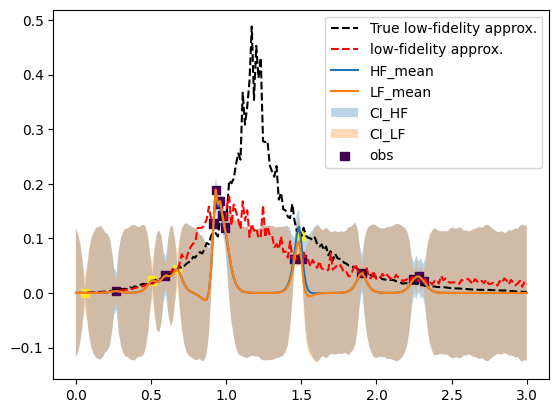

(402,)


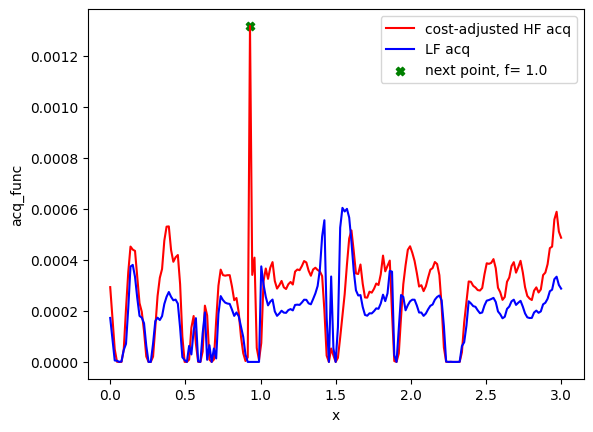

[100  63  64  66  65  97  62  61 263]
[0.93 1.  ] 0.9299999999999999
Evaluation 19 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 10: 201.02388429641724


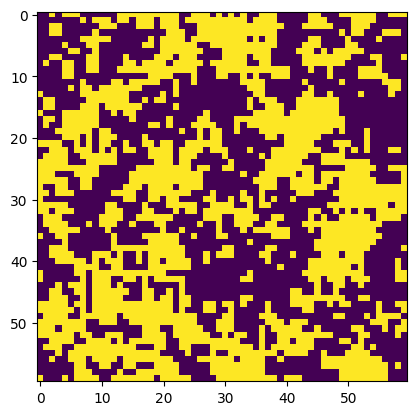

Step:10


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 46.25it/s, 7 steps of size 4.67e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.18      0.79      0.47      1.00    311.98      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    156.50      1.03
   k_scale      0.02      0.01      0.01      0.01      0.02    248.75      1.02
     noise      0.02      0.02      0.02      0.00      0.05    266.87      1.00



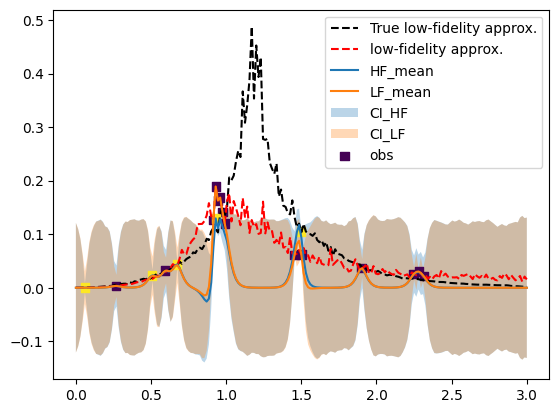

(402,)


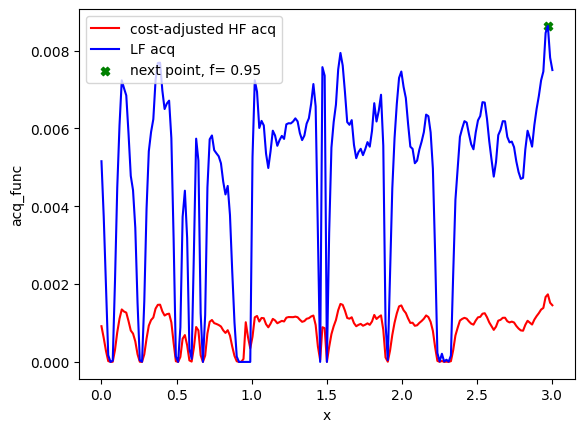

[100  63  64  66  65  97  62  61 263 198]
[2.97 0.95] 2.9699999999999998
Evaluation 20 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.07it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 11: 50.84876227378845


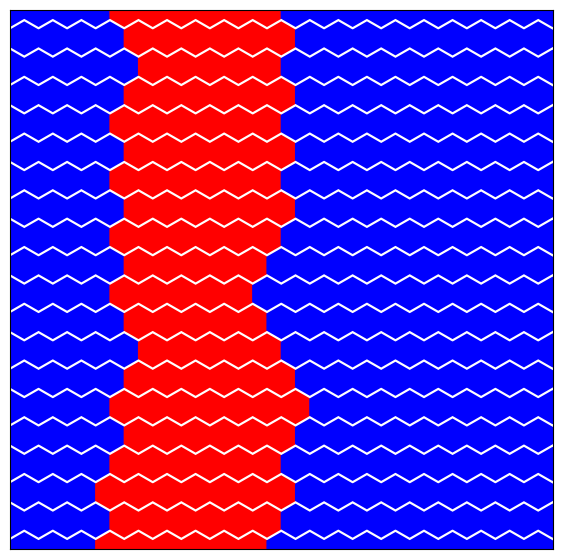

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:11


sample: 100%|██████████| 1000/1000 [00:21<00:00, 46.63it/s, 7 steps of size 4.38e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.73      0.18      0.76      0.46      1.00    344.79      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    167.10      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    373.29      1.00
     noise      0.02      0.02      0.02      0.00      0.05    398.68      1.00



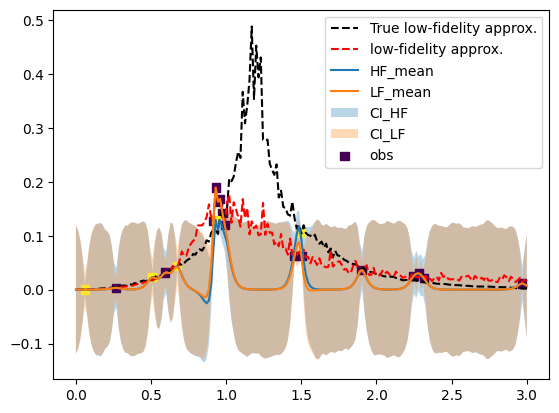

(402,)


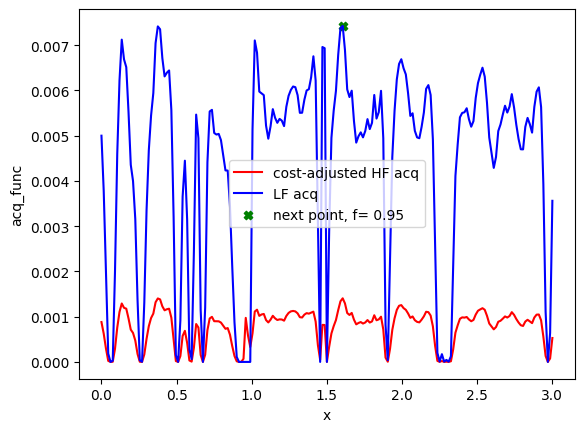

[100  63  64  66  65  97  62  61 263 198 107]
[1.605 0.95 ] 1.605
Evaluation 21 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.13it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 12: 51.304845571517944


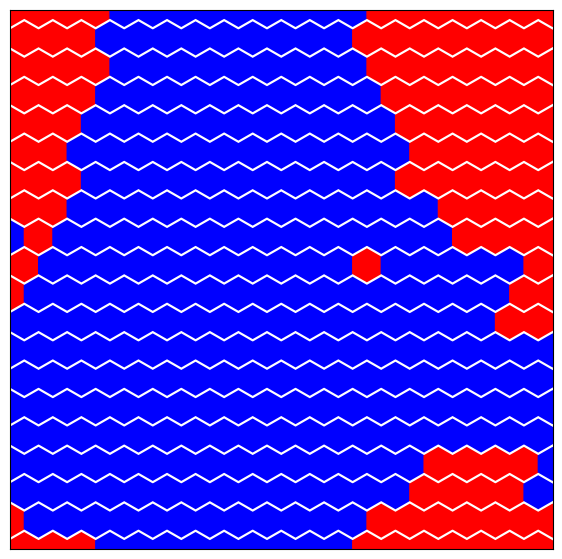

User interraction for policy change
Do you want to update current policy? y- Yes or press ENTER- No
Answer: y
What policies you want to change? Options: 1-parameter space, 2-surrogate model, 3-acq. func., 4-convergence
Enter multiple choices each followed by a space: 2 4
choices made:  [2, 4]
Provide choice of model: 1-standard 2-structured
enter choice: 2
choices made:  2
Provide new number of total iterations.
enter value: 35
iteration:  35
Step:12


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:59<00:00, 16.88it/s, 31 steps of size 1.39e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.13      0.07      0.00      0.22     24.58      1.06
         b      1.01      0.71      1.02      0.01      1.81    136.57      1.00
         c      1.31      1.20      0.97      0.01      3.02    172.23      1.01
     delta      0.77      0.17      0.80      0.49      1.00    251.32      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    165.92      1.00
   k_scale      0.01      0.01      0.01      0.01      0.02    367.22      1.00
     noise      0.02      0.02      0.02      0.00      0.05    317.71      1.00



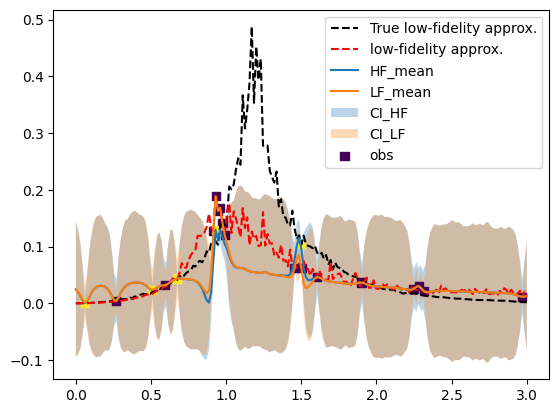

(402,)


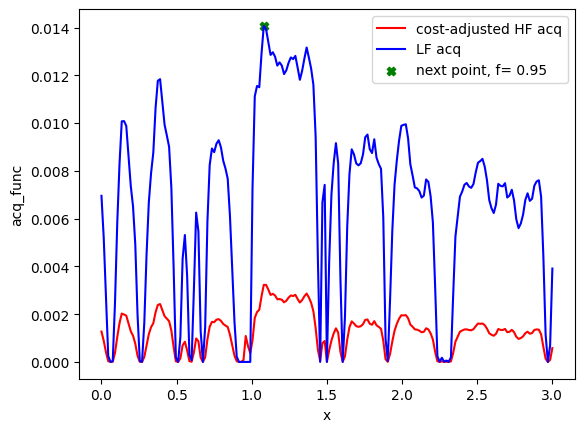

[100  63  64  66  65  97  62  61 263 198 107  72]
[1.08 0.95] 1.08
Evaluation 22 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.05it/s]

Completed. Saving
Time (s) to complete simulation 13: 51.103798151016235



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


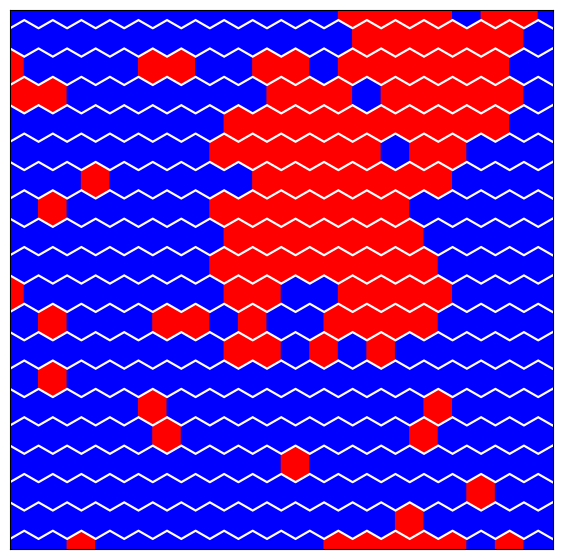

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:13


sample: 100%|██████████| 1000/1000 [00:41<00:00, 23.98it/s, 15 steps of size 1.95e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.07      0.05      0.06      0.00      0.14     81.38      1.02
         b      0.97      0.60      0.93      0.01      1.73    239.25      1.00
         c      1.43      1.17      1.09      0.03      3.08    250.33      1.00
     delta      0.75      0.17      0.78      0.51      1.00    358.95      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    279.77      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    552.04      1.00
     noise      0.02      0.02      0.02      0.00      0.05    658.93      1.00



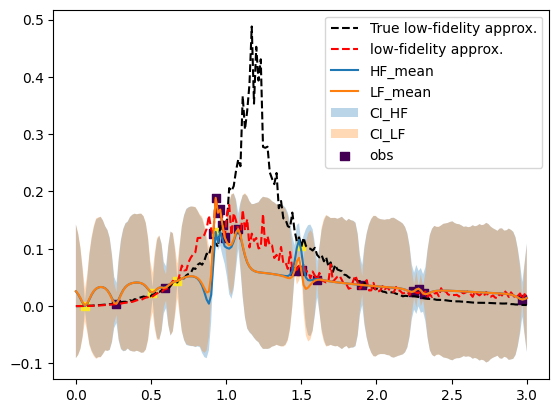

(402,)


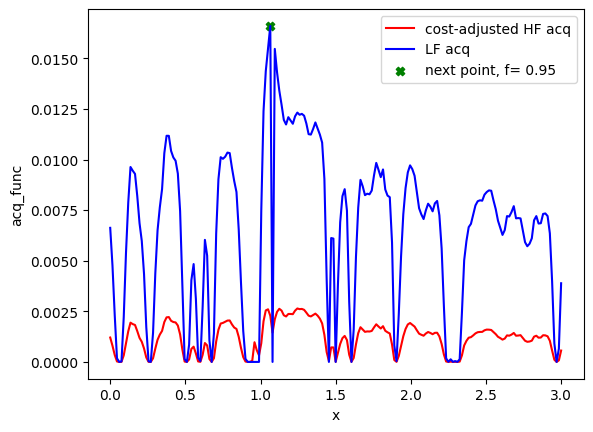

[100  63  64  66  65  97  62  61 263 198 107  72  71]
[1.065 0.95 ] 1.065
Evaluation 23 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.13it/s]

Completed. Saving
Time (s) to complete simulation 14: 50.89572739601135



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


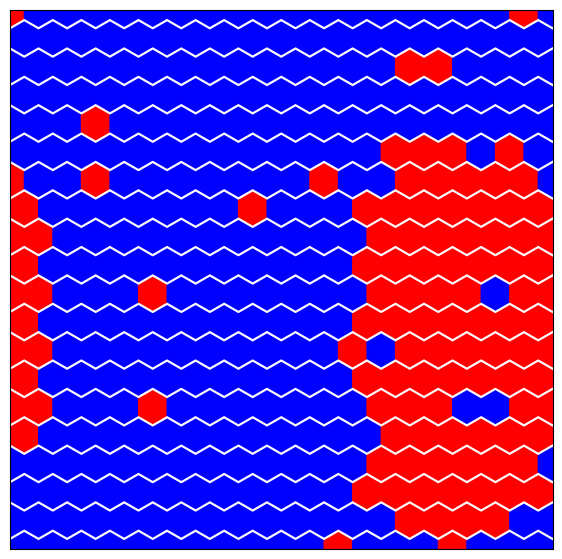

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:14


sample: 100%|██████████| 1000/1000 [00:48<00:00, 20.57it/s, 7 steps of size 2.09e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.07      0.04      0.07      0.00      0.12    205.40      1.02
         b      0.96      0.66      0.92      0.01      1.74    185.93      1.00
         c      1.51      1.10      1.29      0.07      3.16    295.58      1.00
     delta      0.76      0.17      0.80      0.50      1.00    415.02      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    277.25      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    488.85      1.00
     noise      0.03      0.02      0.02      0.00      0.05    476.34      1.00



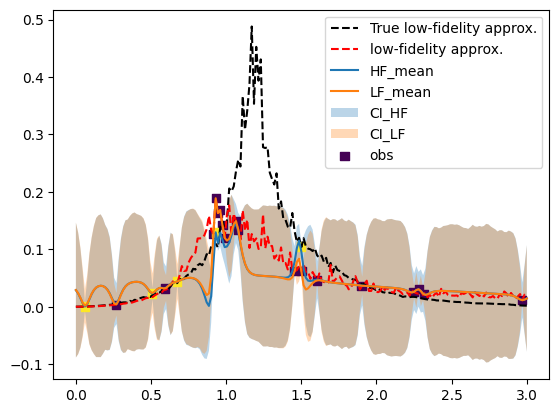

(402,)


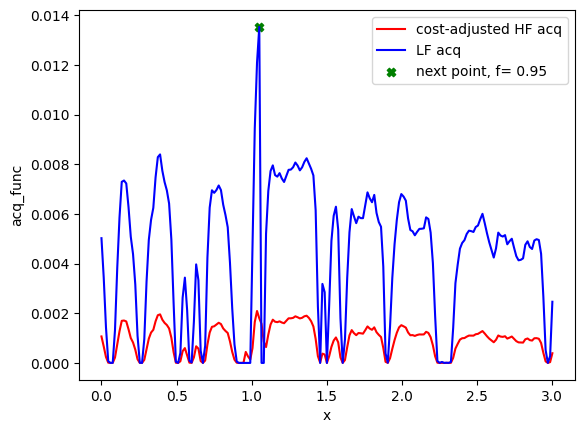

[100  63  64  66  65  97  62  61 263 198 107  72  71  70]
[1.05 0.95] 1.05
Evaluation 24 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.19it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.12it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 15: 51.20293998718262


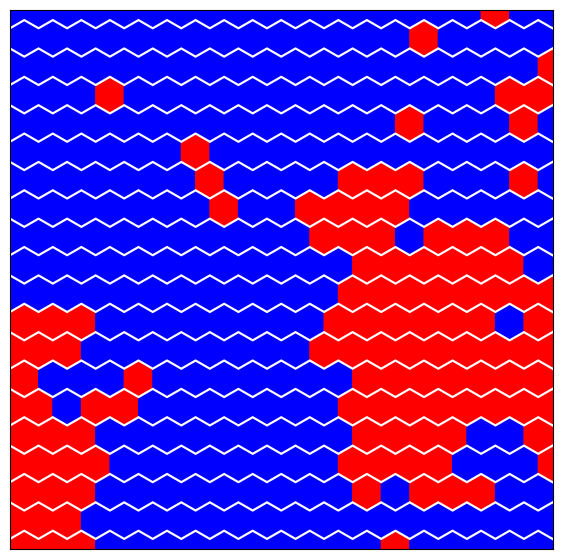

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:15


sample: 100%|██████████| 1000/1000 [00:45<00:00, 22.02it/s, 15 steps of size 2.79e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.06      0.04      0.06      0.00      0.12    131.35      1.02
         b      0.95      0.67      0.85      0.00      1.86    406.21      1.00
         c      1.57      1.10      1.34      0.05      3.17    413.92      1.00
     delta      0.74      0.17      0.77      0.47      0.97    449.32      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    312.58      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    485.79      1.00
     noise      0.02      0.02      0.02      0.00      0.05    363.07      1.00



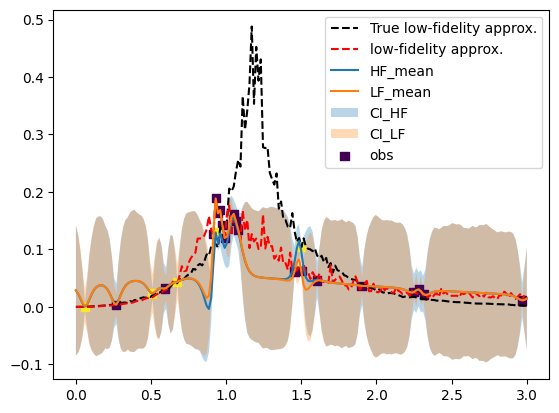

(402,)


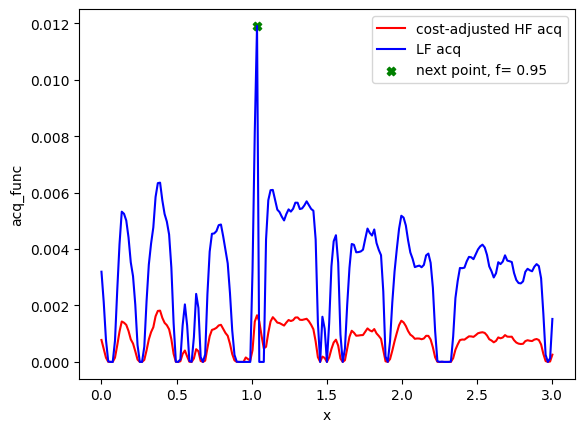

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69]
[1.035 0.95 ] 1.035
Evaluation 25 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.07it/s]

Completed. Saving
Time (s) to complete simulation 16: 51.15276312828064



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


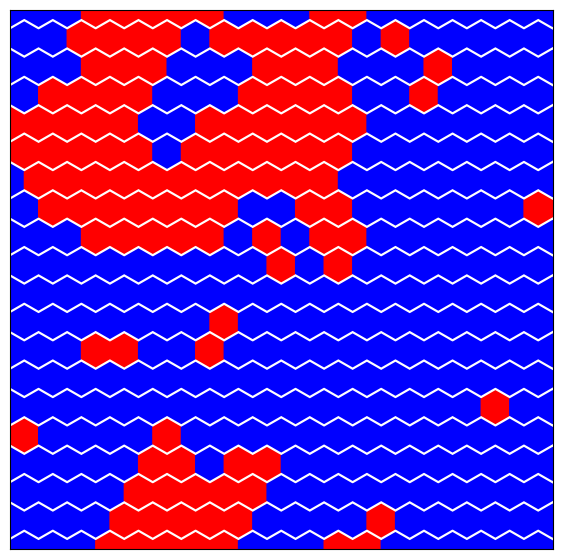

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:16


sample: 100%|██████████| 1000/1000 [00:51<00:00, 19.57it/s, 7 steps of size 2.27e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.07      0.05      0.06      0.00      0.14    198.35      1.00
         b      0.99      0.65      0.93      0.00      1.87    183.04      1.00
         c      1.49      1.13      1.20      0.05      3.28    348.70      1.00
     delta      0.76      0.17      0.80      0.50      0.99    399.79      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    297.17      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    353.66      1.00
     noise      0.02      0.02      0.02      0.00      0.05    292.41      1.00



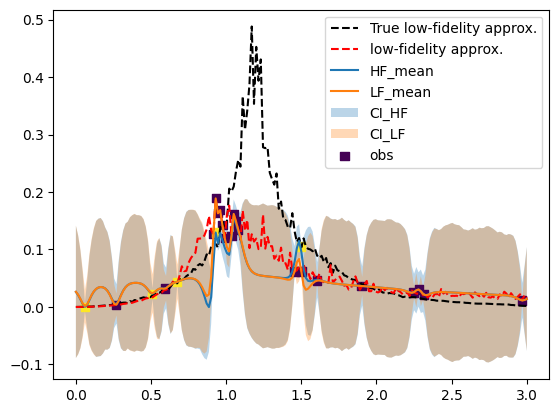

(402,)


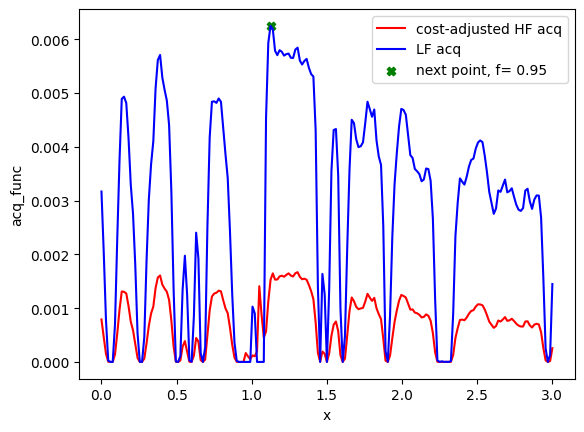

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75]
[1.125 0.95 ] 1.125
Evaluation 26 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.30it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 17: 50.74511218070984


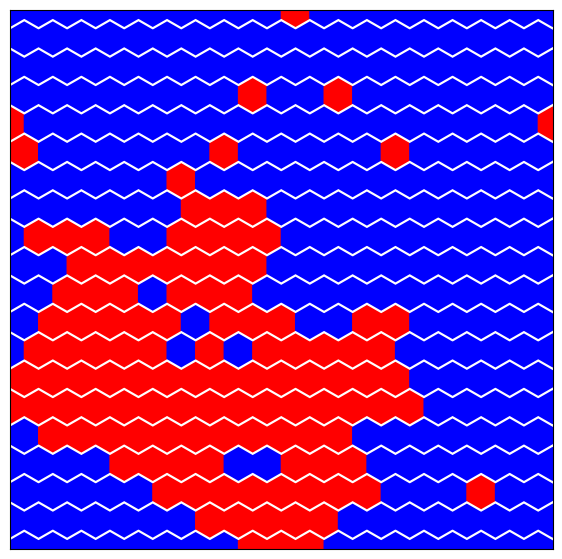

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:17


sample: 100%|██████████| 1000/1000 [00:58<00:00, 17.23it/s, 15 steps of size 2.45e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.07      0.04      0.07      0.00      0.12    187.90      1.03
         b      0.97      0.64      0.89      0.01      1.88    231.89      1.00
         c      1.58      1.06      1.36      0.11      3.17    398.97      1.00
     delta      0.75      0.17      0.78      0.50      0.99    401.94      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    273.66      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    424.86      1.00
     noise      0.02      0.02      0.02      0.00      0.05    333.00      1.00



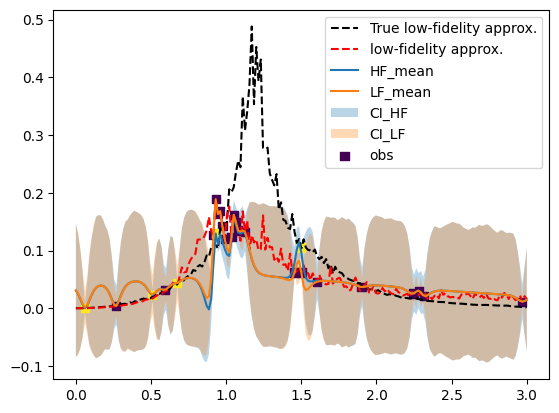

(402,)


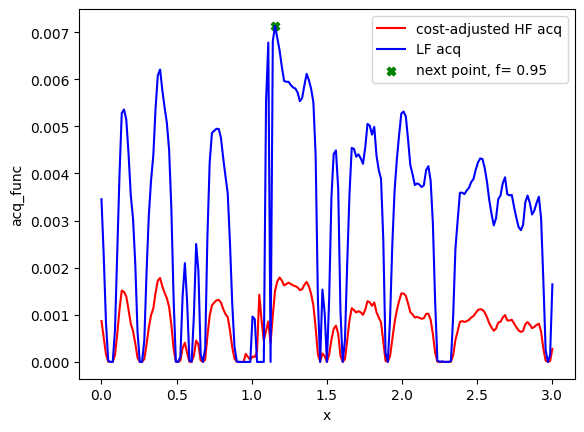

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77]
[1.155 0.95 ] 1.155
Evaluation 27 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.13it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 18: 50.81122660636902


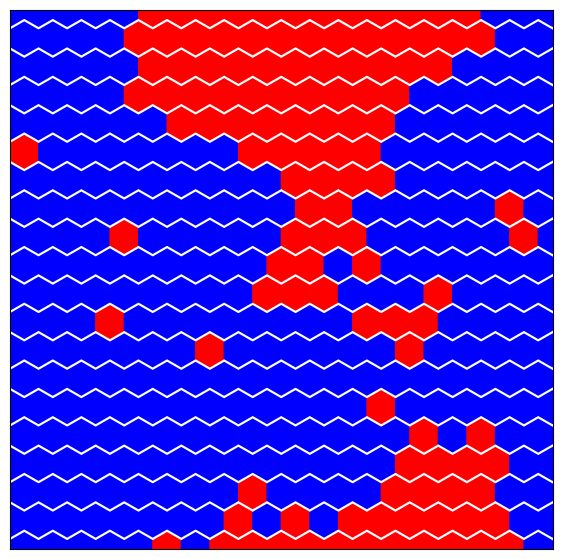

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:18


sample: 100%|██████████| 1000/1000 [00:53<00:00, 18.61it/s, 15 steps of size 2.73e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.08      0.05      0.07      0.00      0.14    195.17      1.02
         b      1.00      0.65      0.94      0.01      1.81    361.43      1.00
         c      1.51      1.16      1.24      0.08      3.11    309.64      1.00
     delta      0.76      0.17      0.79      0.50      1.00    439.46      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    365.69      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    413.12      1.00
     noise      0.02      0.02      0.02      0.00      0.05    346.52      1.00



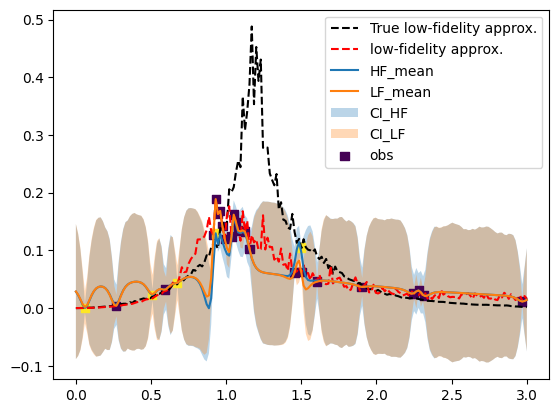

(402,)


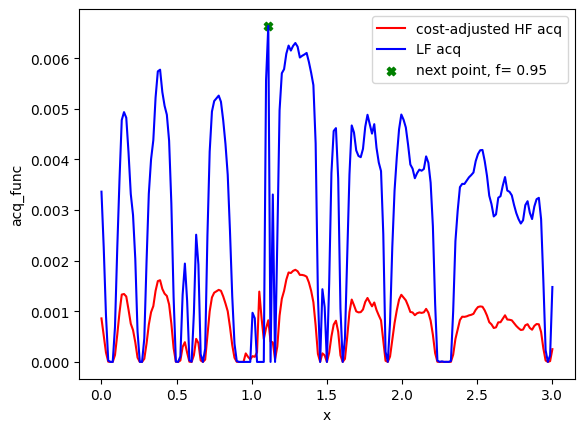

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74]
[1.11 0.95] 1.1099999999999999
Evaluation 28 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.13it/s]

Completed. Saving
Time (s) to complete simulation 19: 51.40729904174805



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


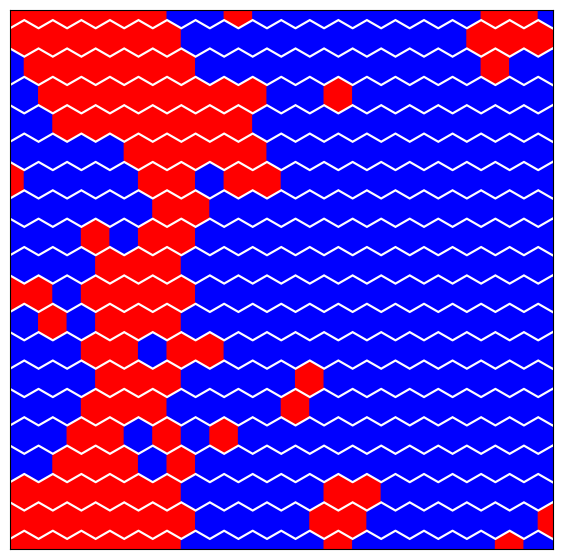

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:19


sample: 100%|██████████| 1000/1000 [01:00<00:00, 16.44it/s, 15 steps of size 2.76e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.07      0.04      0.07      0.00      0.12    177.51      1.01
         b      0.92      0.61      0.86      0.01      1.75    213.60      1.01
         c      1.63      1.16      1.36      0.10      3.28    398.27      1.00
     delta      0.77      0.16      0.79      0.54      0.99    383.85      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    269.61      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    494.14      1.00
     noise      0.03      0.02      0.02      0.00      0.05    552.05      1.00



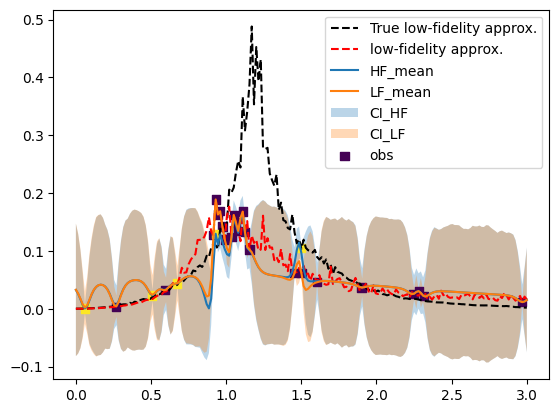

(402,)


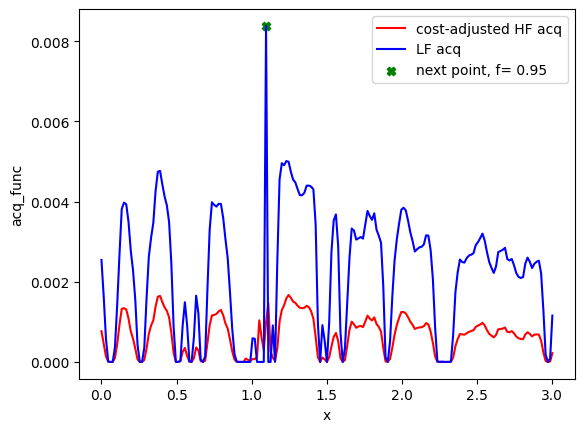

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73]
[1.095 0.95 ] 1.095
Evaluation 29 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.85it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 20: 51.78594660758972


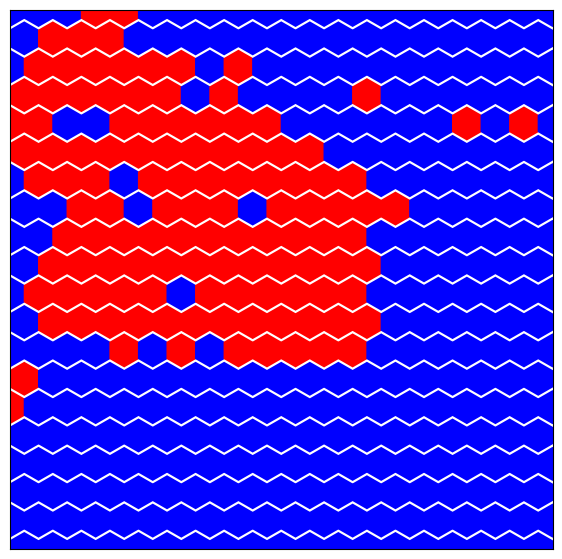

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:20


sample: 100%|██████████| 1000/1000 [01:00<00:00, 16.51it/s, 7 steps of size 2.50e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.07      0.04      0.07      0.01      0.13    162.19      1.05
         b      0.92      0.60      0.83      0.01      1.76    209.75      1.00
         c      1.62      1.15      1.39      0.06      3.19    327.62      1.03
     delta      0.76      0.16      0.78      0.51      1.00    481.34      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    400.43      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    486.85      1.00
     noise      0.03      0.02      0.02      0.00      0.05    509.82      1.00



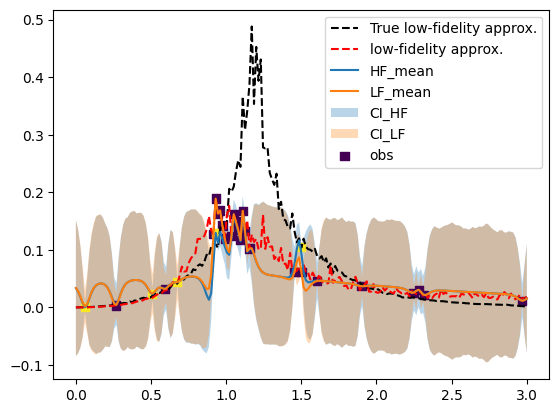

(402,)


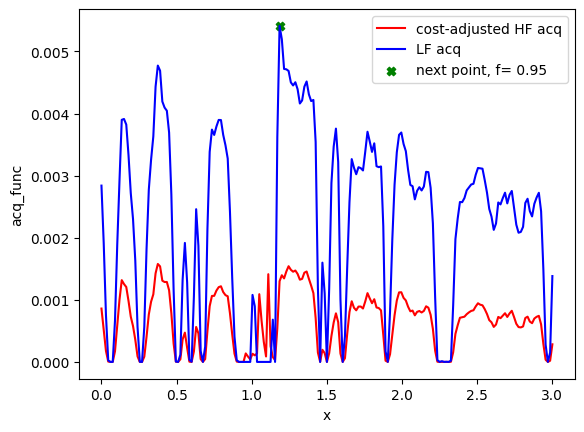

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79]
[1.185 0.95 ] 1.185
Evaluation 30 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 20.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.13it/s]

Completed. Saving
Time (s) to complete simulation 21: 51.528281450271606



<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


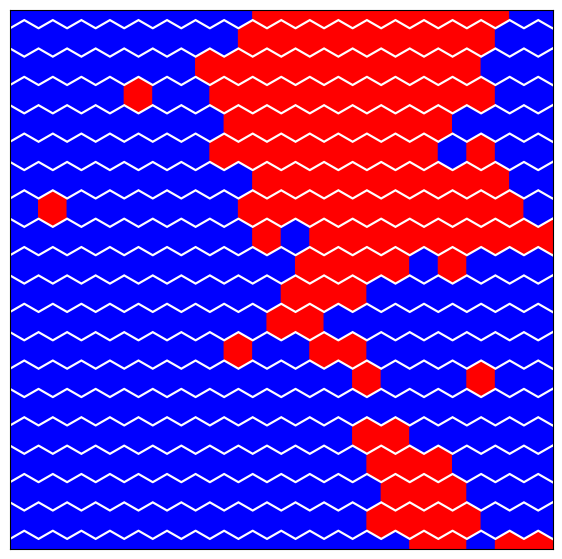

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:21


sample: 100%|██████████| 1000/1000 [01:00<00:00, 16.64it/s, 31 steps of size 2.55e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.13      0.22      0.07      0.00      0.17     16.43      1.09
         b      1.06      0.78      0.96      0.02      2.14     24.47      1.03
         c      1.55      1.21      1.32      0.02      3.36     70.71      1.02
     delta      0.77      0.17      0.80      0.53      1.00    213.19      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    389.69      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    259.53      1.01
     noise      0.02      0.02      0.02      0.00      0.05     94.97      1.01



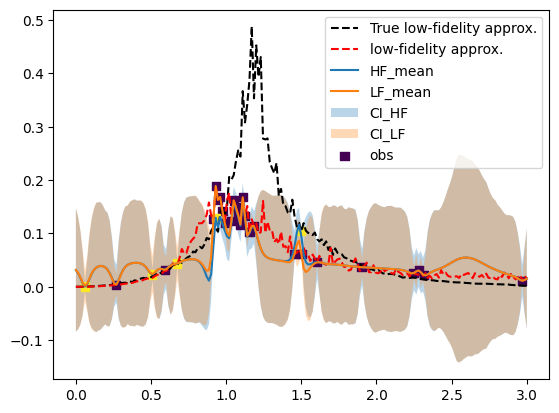

(402,)


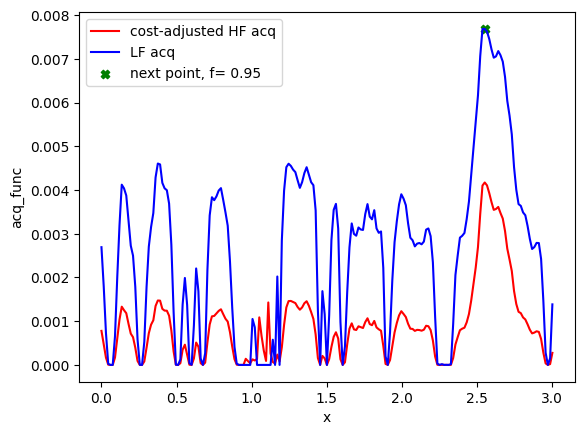

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170]
[2.55 0.95] 2.55
Evaluation 31 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 18.04it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 22: 51.304357051849365


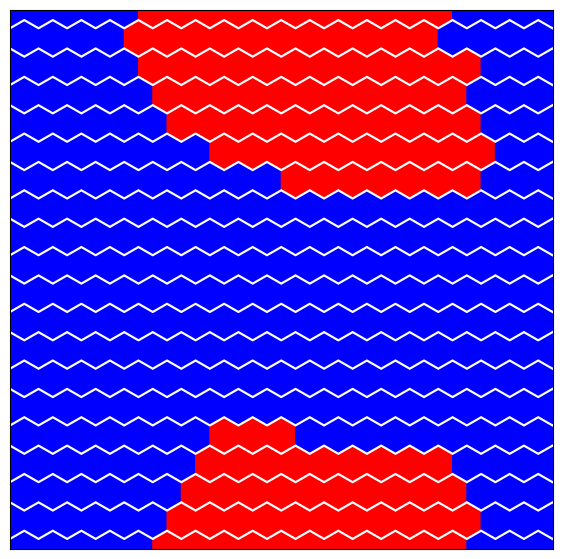

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:22


sample: 100%|██████████| 1000/1000 [01:06<00:00, 15.05it/s, 7 steps of size 2.68e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.08      0.04      0.07      0.02      0.14    142.44      1.04
         b      0.92      0.58      0.93      0.01      1.64    185.03      1.00
         c      1.44      1.06      1.21      0.13      3.02    452.06      1.01
     delta      0.76      0.16      0.79      0.49      0.99    305.64      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    356.26      1.01
   k_scale      0.01      0.00      0.01      0.01      0.02    281.23      1.00
     noise      0.02      0.02      0.02      0.00      0.05    279.69      1.00



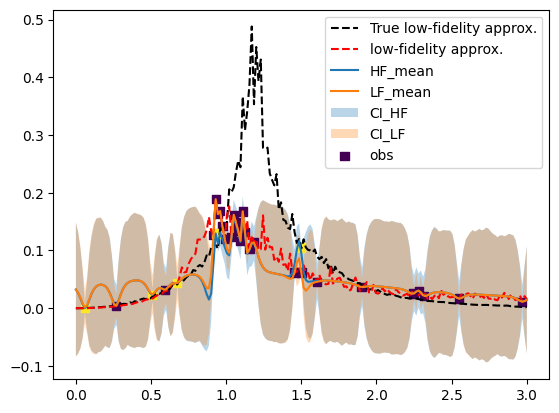

(402,)


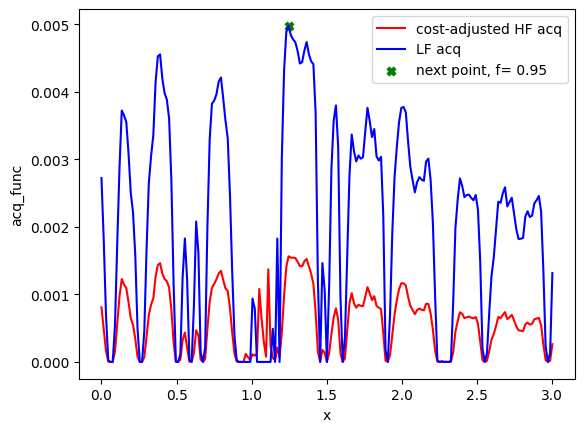

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83]
[1.245 0.95 ] 1.2449999999999999
Evaluation 32 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:24<00:00, 20.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.63it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 23: 52.48137974739075


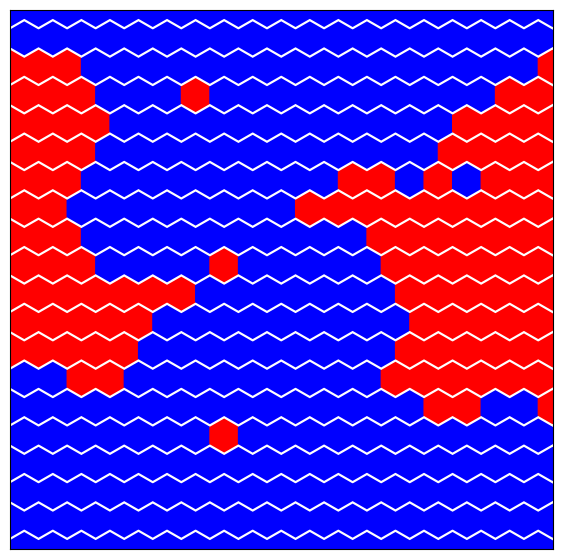

User interraction for policy change
Do you want to update current policy? y- Yes or press ENTER- No
Answer: y
What policies you want to change? Options: 1-parameter space, 2-surrogate model, 3-acq. func., 4-convergence
Enter multiple choices each followed by a space: 3
choices made:  [3]
Provide new cost ratio between high and low fidelities
enter value: 1
cost ratio:  1.0
Step:23


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:15<00:00, 63.38it/s, 15 steps of size 2.30e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.08      0.04      0.08      0.01      0.14    180.01      1.00
         b      0.98      0.56      0.98      0.12      1.77    229.71      1.00
         c      1.47      1.12      1.21      0.08      3.20    238.44      1.00
     delta      0.77      0.16      0.79      0.54      1.00    389.55      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    341.29      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    454.58      1.00
     noise      0.03      0.02      0.02      0.00      0.05    447.31      1.00



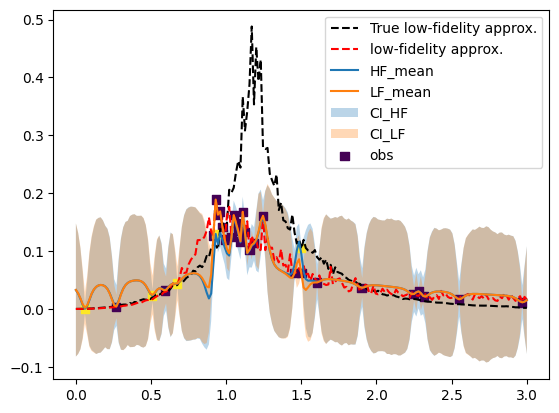

(402,)


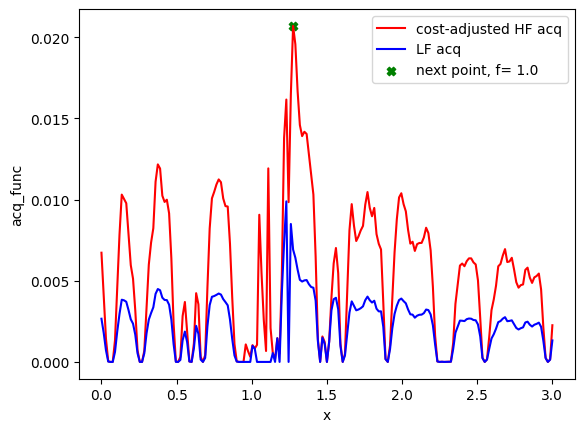

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286]
[1.275 1.   ] 1.275
Evaluation 33 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 24: 200.54269552230835


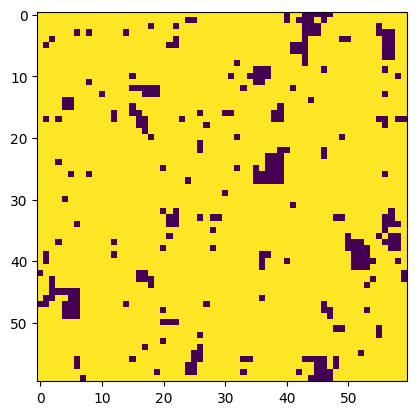

Step:24


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:16<00:00, 59.01it/s, 15 steps of size 2.52e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.09      0.04      0.09      0.03      0.15    182.52      1.01
         b      0.98      0.56      0.95      0.04      1.68    193.08      1.00
         c      1.55      1.12      1.25      0.18      3.18    263.49      1.00
     delta      0.76      0.17      0.79      0.50      0.99    374.21      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    276.43      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    286.84      1.00
     noise      0.03      0.02      0.02      0.00      0.05    460.71      1.00



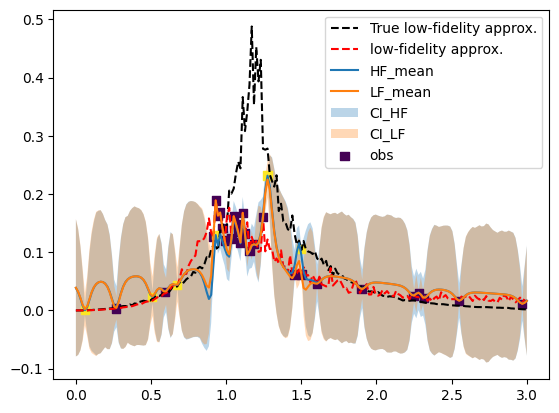

(402,)


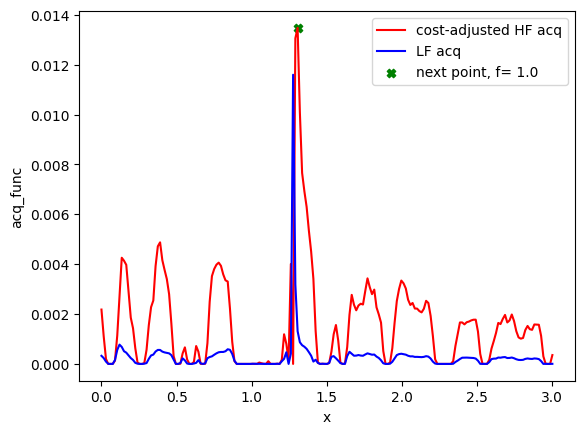

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288]
[1.305 1.   ] 1.305
Evaluation 34 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 25: 200.42514157295227


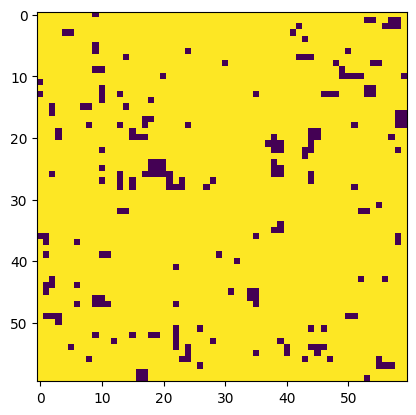

Step:25


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 52.44it/s, 23 steps of size 2.19e-01. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.07      0.09      0.01      0.17     24.68      1.05
         b      1.01      0.54      1.06      0.05      1.68    196.67      1.00
         c      1.44      1.09      1.21      0.07      2.93    143.56      1.00
     delta      0.76      0.16      0.79      0.53      0.99    267.48      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    441.71      1.00
   k_scale      0.01      0.00      0.01      0.01      0.01    382.62      1.00
     noise      0.02      0.02      0.02      0.00      0.05    424.61      1.00



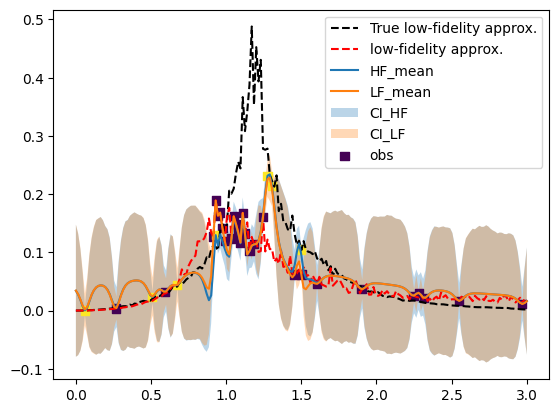

(402,)


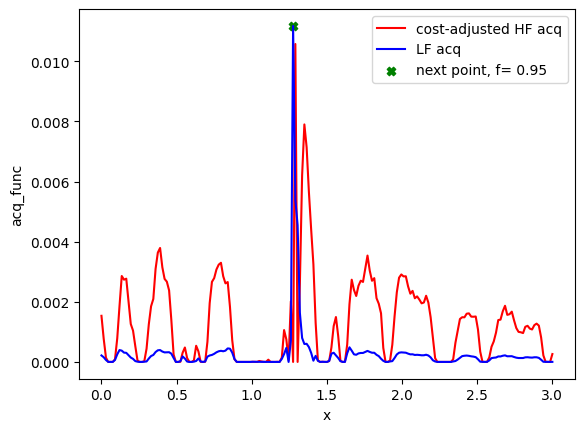

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85]
[1.275 0.95 ] 1.275
Evaluation 35 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 20.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.63it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 26: 52.29549503326416


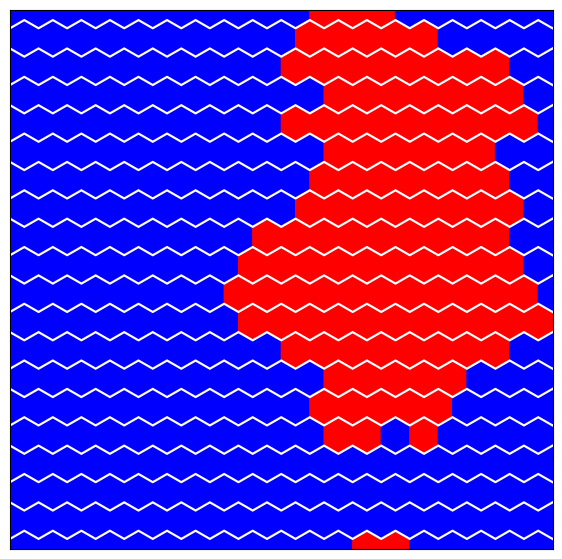

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:26


sample: 100%|██████████| 1000/1000 [00:18<00:00, 53.02it/s, 15 steps of size 2.13e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.04      0.09      0.03      0.17    190.20      1.01
         b      1.03      0.56      1.05      0.01      1.63    204.41      1.00
         c      1.32      1.03      1.06      0.08      2.80    196.56      1.00
     delta      0.87      0.10      0.89      0.72      1.00    409.77      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    289.36      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    349.44      1.00
     noise      0.02      0.02      0.02      0.00      0.05    541.54      1.00



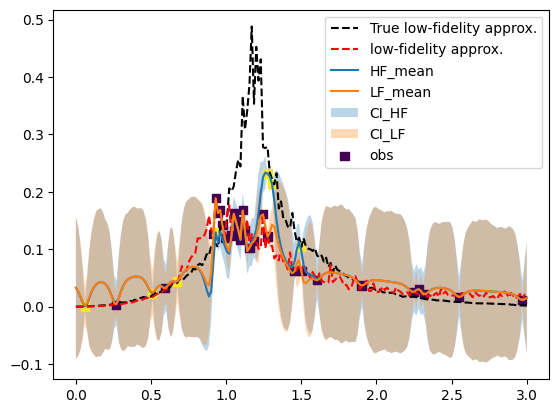

(402,)


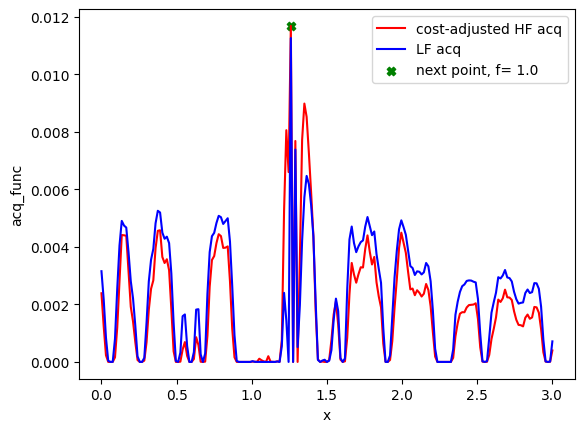

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285]
[1.26 1.  ] 1.26
Evaluation 36 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 27: 202.40624284744263


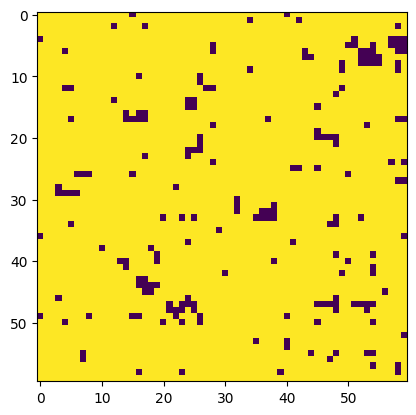

Step:27


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:17<00:00, 57.35it/s, 7 steps of size 2.25e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.09      0.04      0.08      0.02      0.15    152.59      1.02
         b      0.95      0.59      1.01      0.00      1.68     97.07      1.00
         c      1.55      1.13      1.27      0.13      3.06    139.14      1.00
     delta      0.88      0.10      0.91      0.73      1.00    356.00      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    264.21      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    421.74      1.00
     noise      0.03      0.02      0.02      0.00      0.05    555.59      1.00



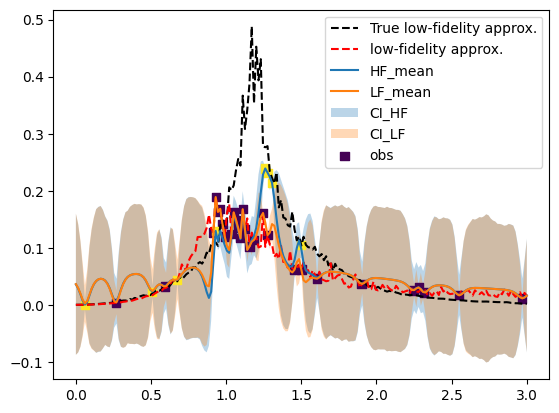

(402,)


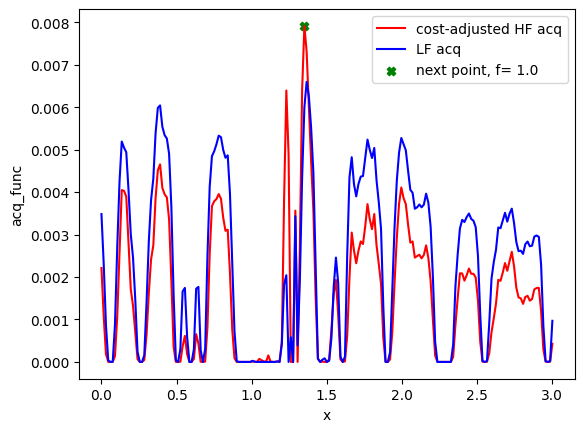

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291]
[1.35 1.  ] 1.3499999999999999
Evaluation 37 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 28: 200.53263354301453


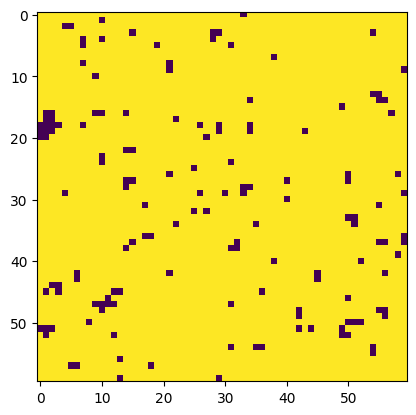

Step:28


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 47.96it/s, 31 steps of size 1.66e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.05      0.09      0.02      0.17    109.52      1.01
         b      1.01      0.55      1.06      0.01      1.65    143.67      1.02
         c      1.42      1.08      1.16      0.12      2.87    118.01      1.01
     delta      0.88      0.10      0.90      0.73      1.00    301.70      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    269.20      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    417.95      1.00
     noise      0.02      0.02      0.02      0.00      0.05    295.98      1.00



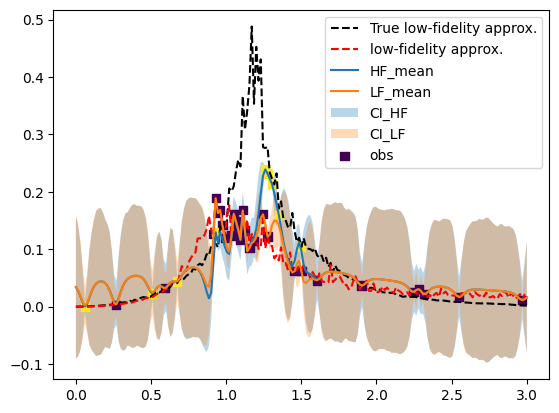

(402,)


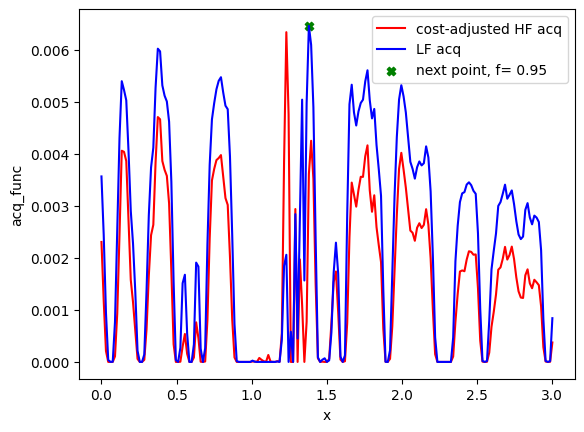

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92]
[1.38 0.95] 1.38
Evaluation 38 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 20.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.43it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 29: 52.510053634643555


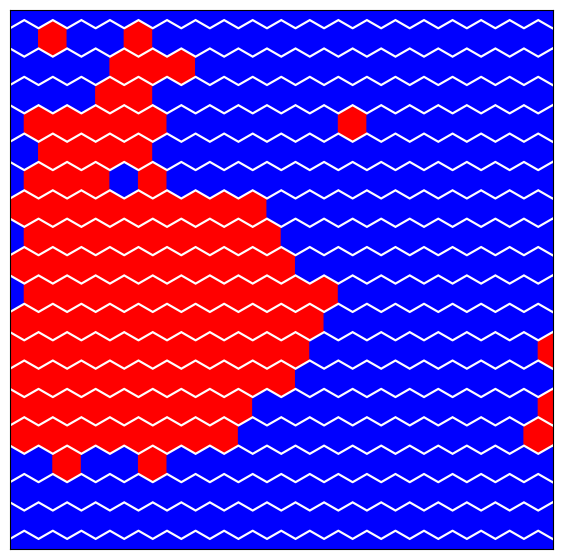

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:29


sample: 100%|██████████| 1000/1000 [00:18<00:00, 55.55it/s, 15 steps of size 2.71e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.08      0.05      0.08      0.00      0.14    169.11      1.02
         b      0.97      0.55      0.96      0.02      1.65    123.82      1.00
         c      1.54      1.09      1.35      0.15      3.17    365.34      1.00
     delta      0.88      0.10      0.91      0.72      1.00    366.67      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    239.06      1.00
   k_scale      0.01      0.00      0.01      0.01      0.02    330.07      1.00
     noise      0.02      0.02      0.02      0.00      0.05    458.36      1.00



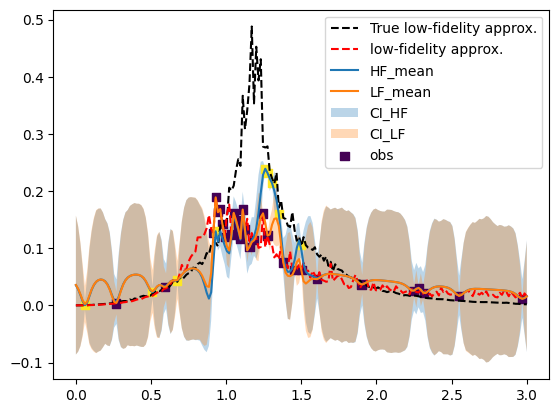

(402,)


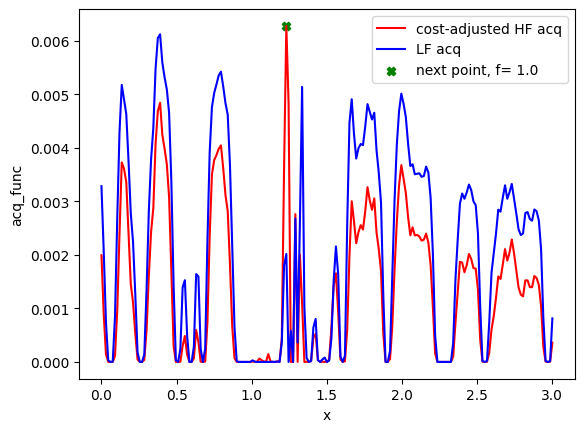

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283]
[1.23 1.  ] 1.23
Evaluation 39 of 45
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 30: 200.247004032135


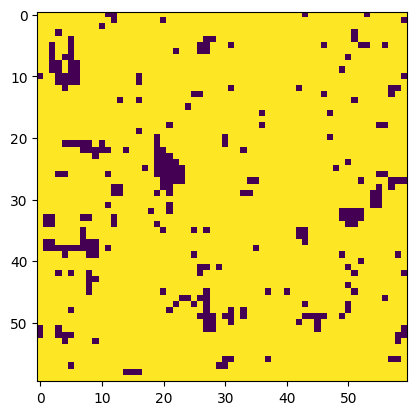

Step:30


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:20<00:00, 49.20it/s, 31 steps of size 1.65e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.11      0.06      0.09      0.03      0.18    171.65      1.01
         b      1.02      0.54      1.04      0.10      1.70    259.65      1.00
         c      1.38      1.05      1.13      0.04      2.96    195.42      1.00
     delta      0.87      0.11      0.91      0.73      1.00    373.32      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    189.09      1.01
   k_scale      0.02      0.01      0.01      0.01      0.02    286.46      1.00
     noise      0.02      0.02      0.02      0.00      0.05    301.48      1.01



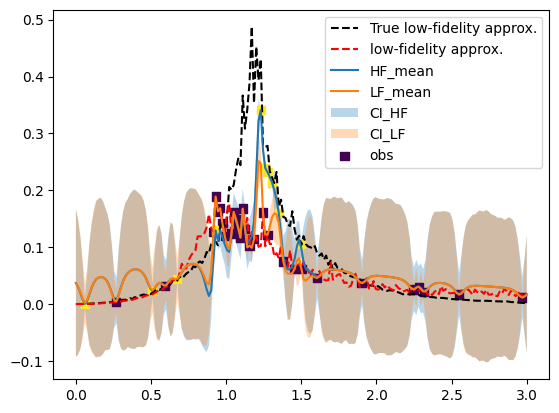

(402,)


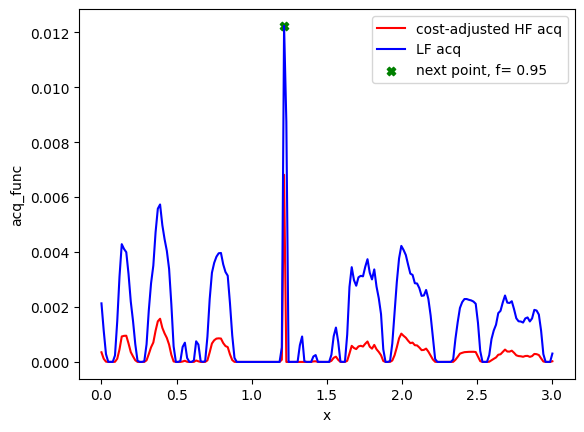

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283  81]
[1.215 0.95 ] 1.2149999999999999
Evaluation 40 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:27<00:00, 17.88it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 31: 51.65727353096008


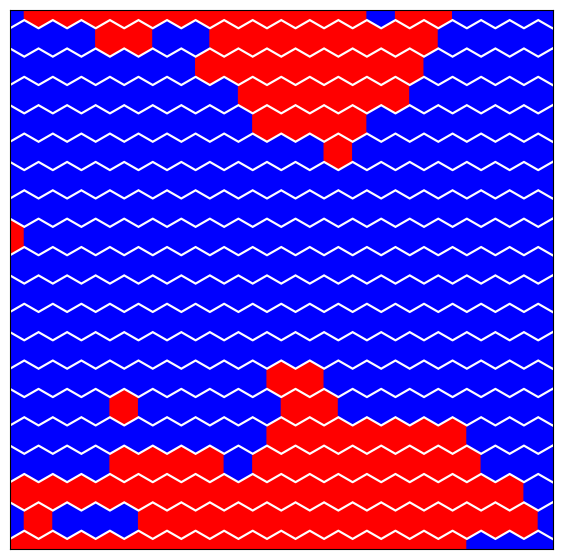

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:31


sample: 100%|██████████| 1000/1000 [00:21<00:00, 47.01it/s, 27 steps of size 1.64e-01. acc. prob=0.97]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.05      0.09      0.02      0.16    191.36      1.01
         b      0.94      0.59      0.91      0.01      1.68    138.65      1.00
         c      1.51      1.07      1.29      0.10      3.03    199.30      1.01
     delta      0.89      0.10      0.92      0.73      1.00    382.16      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    217.06      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    266.57      1.00
     noise      0.02      0.02      0.02      0.00      0.04    321.13      1.00



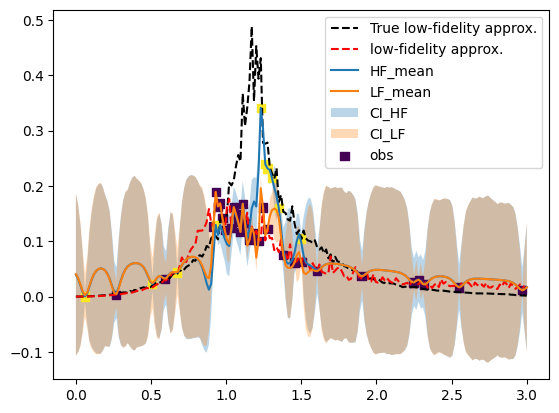

(402,)


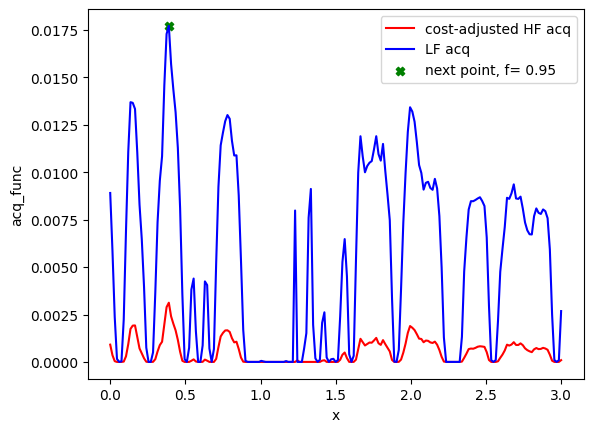

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283  81  26]
[0.39 0.95] 0.39
Evaluation 41 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 20.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.69it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 32: 52.15869331359863


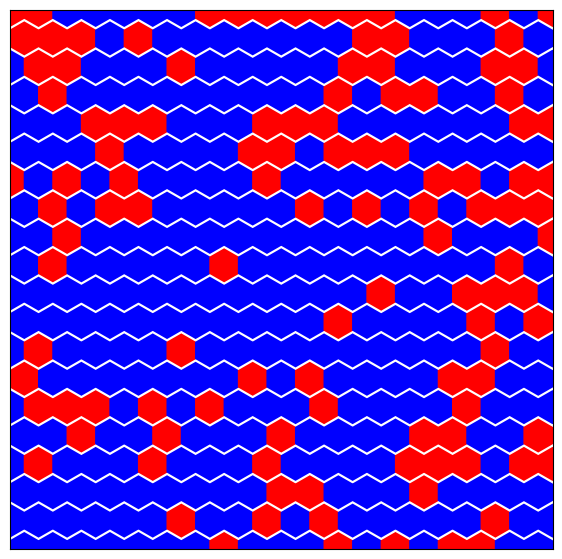

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:32


sample: 100%|██████████| 1000/1000 [00:18<00:00, 53.67it/s, 31 steps of size 2.12e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.05      0.09      0.01      0.18    181.09      1.02
         b      1.06      0.52      1.07      0.10      1.74    197.99      1.00
         c      1.36      1.09      1.02      0.11      3.02    268.37      1.00
     delta      0.89      0.09      0.92      0.76      1.00    235.93      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    260.86      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    263.38      1.00
     noise      0.02      0.02      0.02      0.00      0.05    535.45      1.00



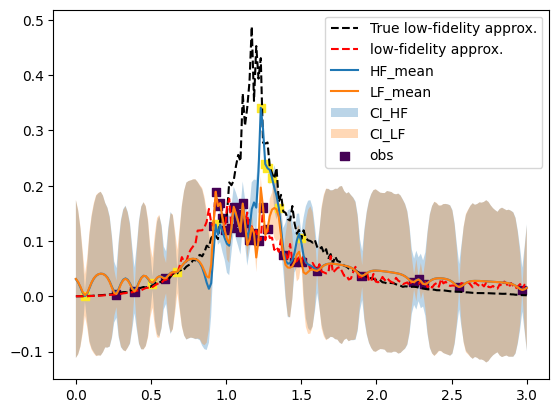

(402,)


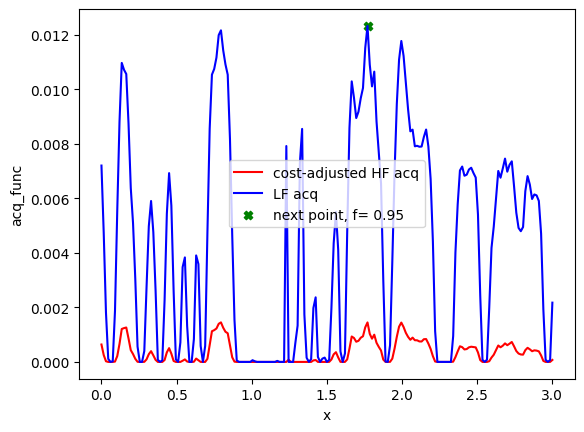

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283  81  26 118]
[1.77 0.95] 1.77
Evaluation 42 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.69it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 33: 52.08511519432068


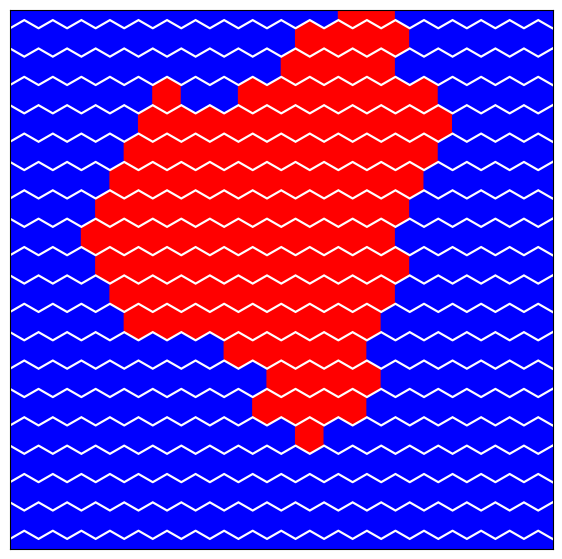

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:33


sample: 100%|██████████| 1000/1000 [00:17<00:00, 56.28it/s, 15 steps of size 2.46e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.09      0.05      0.08      0.02      0.17    154.55      1.05
         b      1.08      0.59      1.11      0.03      1.74    201.86      1.00
         c      1.51      1.10      1.22      0.14      3.16    235.77      1.00
     delta      0.89      0.10      0.91      0.75      1.00    636.27      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    241.16      1.00
   k_scale      0.02      0.01      0.02      0.01      0.03    329.34      1.00
     noise      0.02      0.02      0.02      0.00      0.05    259.70      1.00



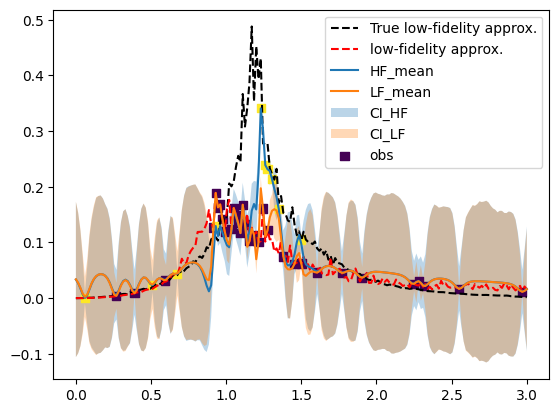

(402,)


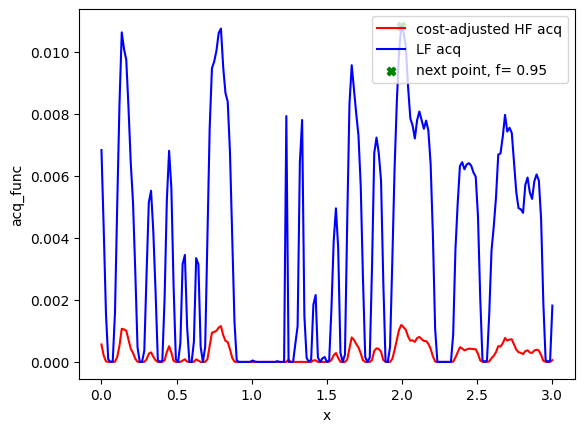

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283  81  26 118 133]
[1.995 0.95 ] 1.9949999999999999
Evaluation 43 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.58it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 34: 52.02093267440796


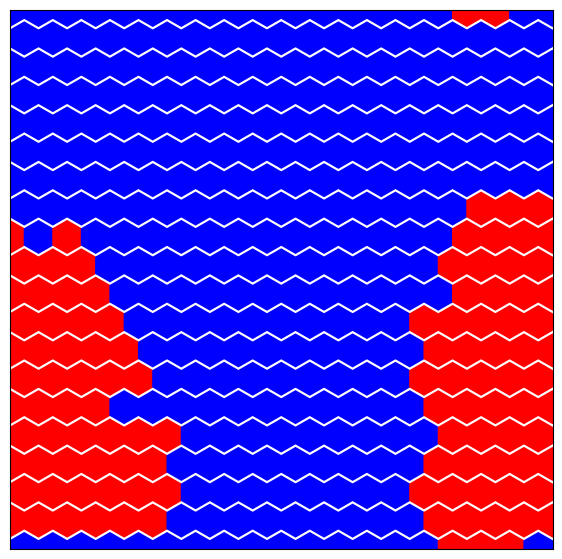

User interraction for policy change
Do you want to update current policy? y- Yes or press ENTER- No
Answer: 
Step:34


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:21<00:00, 47.24it/s, 15 steps of size 1.70e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.09      0.05      0.08      0.00      0.15    168.56      1.00
         b      1.03      0.53      1.06      0.07      1.72    262.01      1.00
         c      1.48      1.13      1.14      0.10      3.09    242.78      1.00
     delta      0.90      0.09      0.92      0.76      1.00    363.24      1.01
  k_length      0.01      0.00      0.01      0.01      0.01    240.65      1.01
   k_scale      0.02      0.01      0.02      0.01      0.03    310.89      1.00
     noise      0.02      0.02      0.02      0.00      0.05    299.65      1.00



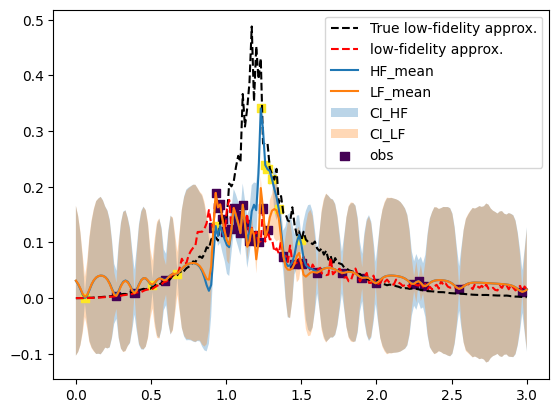

(402,)


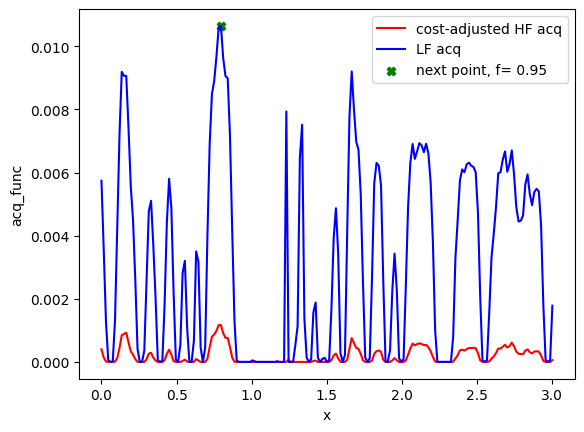

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283  81  26 118 133  53]
[0.795 0.95 ] 0.7949999999999999
Evaluation 44 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:24<00:00, 20.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.94it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 35: 53.88809943199158


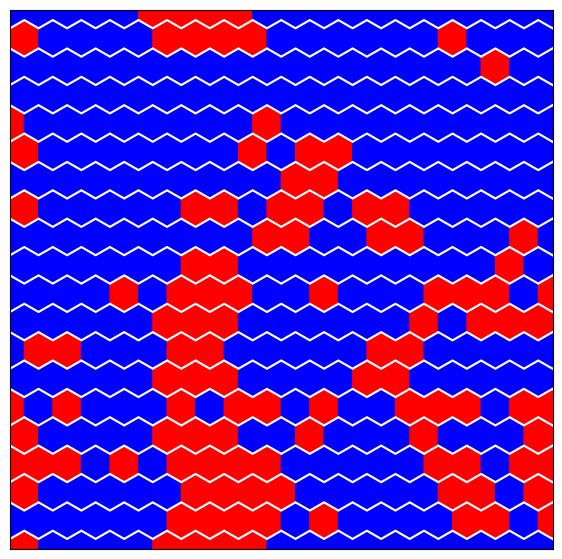

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(


Step:35


sample: 100%|██████████| 1000/1000 [00:20<00:00, 48.97it/s, 31 steps of size 1.98e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.05      0.09      0.02      0.17    153.71      1.00
         b      1.04      0.55      1.07      0.05      1.78    216.20      1.01
         c      1.39      1.13      1.02      0.12      3.02    180.34      1.01
     delta      0.90      0.09      0.93      0.77      1.00    430.05      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    311.46      1.00
   k_scale      0.02      0.01      0.02      0.01      0.02    355.17      1.00
     noise      0.02      0.02      0.02      0.00      0.05    369.92      1.00



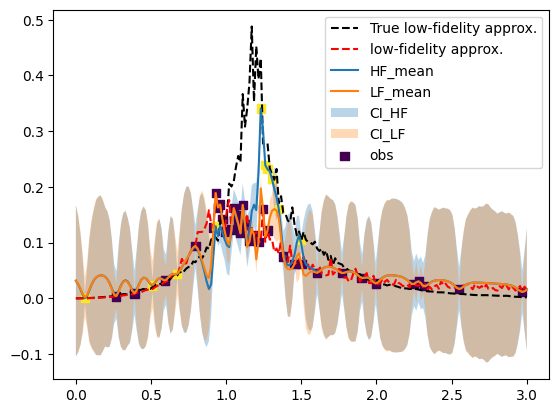

(402,)


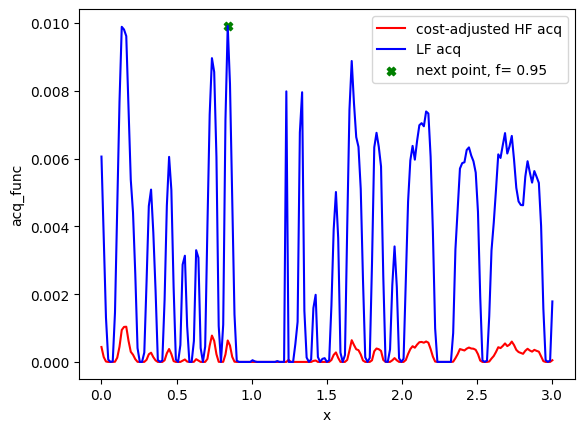

[100  63  64  66  65  97  62  61 263 198 107  72  71  70  69  75  77  74
  73  79 170  83 286 288  85 285 291  92 283  81  26 118 133  53  56]
[0.84 0.95] 0.84
Evaluation 45 of 45
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:24<00:00, 20.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.53it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 36: 52.66114640235901


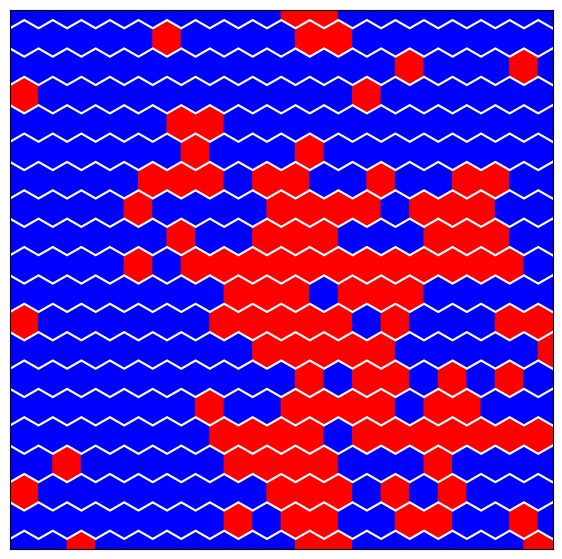

In [20]:
N = 25
cost_ratio = 8.6/1
imodel = 1 # Structured GP
npol = 5 #Number of max iterations without finding better solutions before asking for policy change
f = np.array([1.0, 2.0])

idx = []
p = 0
j = 1
i = 1
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_lf, X_test_hf))
X_test_full = np.vstack((X_test_lf, X_test_hf))
X_test_norm = np.vstack((X_test_lf, X_test_hf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
while (i < N+1):
    print("Step:"+str(i))

    # Multi-fidelity structured GP
    if imodel == 2:
        # Initialize MF model
        gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                                noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
        # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
        gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)
    else:
        gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior,
                                noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
        # Run MCMC to obtain posterior samples
        gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions

        approx_ys_tri = approx_ys_tri[xs<=np.max(X_test[:,0])]
        approx_ys_sq = approx_ys_sq[xs<=np.max(X_test[:,0])]
        xs = xs[xs<=np.max(X_test[:,0])]

        approx_ys_tri = approx_ys_tri[xs>=np.min(X_test[:,0])]
        approx_ys_sq = approx_ys_sq[xs>=np.min(X_test[:,0])]
        xs = xs[xs>=np.min(X_test[:,0])]

        if imodel == 2:
            y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
            y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        else:
            y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
            y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)

        plt.plot(xs, approx_ys_sq, "k--", label="True low-fidelity approx.")
        plt.plot(xs, approx_ys_tri, "r--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(X_test[X_test_lf.shape[0]:, 0], y_pred, label="HF_mean")
        plt.plot(X_test[X_test_lf.shape[0]:, 0], y_pred_lf, label="LF_mean")
        plt.fill_between(
            X_test[X_test_lf.shape[0]:, 0].flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            X_test[X_test_lf.shape[0]:, 0].flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        #Check for the need of policy change
        print("Do you want to update current policy? y- Yes or press ENTER- No")
        ip = str(input("Answer: "))
        if (ip == 'Y' or ip == 'y'):
            print("User interraction for policy change")
            X_test, X_test_norm, imodel, cost_ratio, N, idx = ipolicy(X_test, X_test_norm, imodel, cost_ratio, N, i, idx)
        else:
            break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            J_mat = np.array([[0,Jx[-1],0,Jx[-1],0],
                      [Jx[-1],0,0,0,Jx[-1]],
                      [0,Jx[-1],0,Jx[-1],0]])
            tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
            sq_sim = tri_sim
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']

        if train_x_full[-1,1] == 1: #High fidelity
            plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])

        else: #Low fidelity
            sq_sim.plot_config(resultsBO_dict[n+i]['sim']['config'][-1])

        plt.show()
        train_y = np.vstack((train_y, new_y))


    #Check for the need of policy change
    t_y1 = train_y[-npol]
    t_y2 = np.max(train_y[-4:])
    if (j>=npol) & (t_y1 >= t_y2):
    #if (j>=1):
      #Storing training data of earlier policies
        j = 0
        hist_policy[p] = {'train_x': train_x_full, 'train_x_norm': train_x_full_norm, 'train_y': train_y, 'cost_ratio': cost_ratio}
        p = p + 1
        print("User interraction for policy change")
        train_x_full, train_x_full_norm, train_y, X_test, X_test_norm, imodel, cost_ratio, N, idx = ipolicy(train_x_full, train_x_full_norm, train_y, X_test, X_test_norm, imodel, cost_ratio, N, i, idx)
    j = j + 1
    i = i + 1
    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:19<00:00, 52.41it/s, 7 steps of size 2.11e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
         a      0.10      0.05      0.09      0.02      0.16    163.48      1.01
         b      1.02      0.53      1.06      0.05      1.62    125.69      1.03
         c      1.42      1.12      1.11      0.14      2.94    206.99      1.00
     delta      0.90      0.08      0.93      0.79      1.00    259.60      1.00
  k_length      0.01      0.00      0.01      0.01      0.01    277.36      1.01
   k_scale      0.02      0.00      0.02      0.01      0.02    271.76      1.00
     noise      0.02      0.02      0.02      0.00      0.05    360.19      1.00



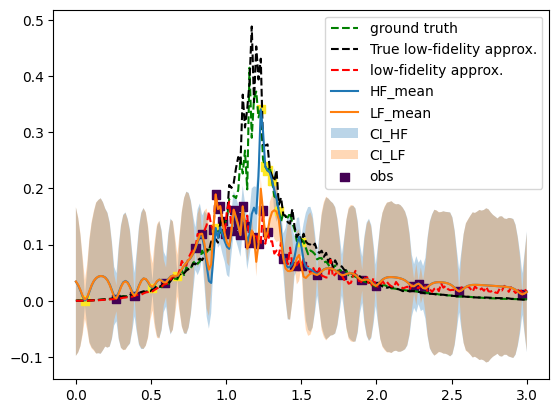

In [24]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, mean_fn=mean_func, mean_fn_prior=mf_priors,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)

plt.plot(xs, true_ys_sq, "g--", label="ground truth")
plt.plot(xs, approx_ys_sq, "k--", label="True low-fidelity approx.")
plt.plot(xs, approx_ys_tri, "r--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

plt.legend(loc="best")
plt.show()

In [22]:
hist_policy, train_x_full, train_y

({0: {'train_x': array([[2.31396193, 0.95      ],
          [0.06225585, 1.        ],
          [1.9009447 , 0.95      ],
          [2.24641165, 0.95      ],
          [1.49552104, 1.        ],
          [0.67438994, 1.        ],
          [0.59418859, 0.95      ],
          [2.28159214, 0.95      ],
          [0.50733251, 1.        ],
          [0.26501944, 0.95      ],
          [1.5       , 0.95      ],
          [0.945     , 0.95      ],
          [0.96      , 0.95      ],
          [0.99      , 0.95      ],
          [0.975     , 0.95      ],
          [1.455     , 0.95      ],
          [0.93      , 0.95      ],
          [0.915     , 0.95      ],
          [0.93      , 1.        ],
          [2.97      , 0.95      ],
          [1.605     , 0.95      ]]),
   'train_x_norm': array([[0.77132064, 0.95      ],
          [0.02075195, 1.        ],
          [0.63364823, 0.95      ],
          [0.74880388, 0.95      ],
          [0.49850701, 1.        ],
          [0.22479665, 1.       

0.0018782924196979055


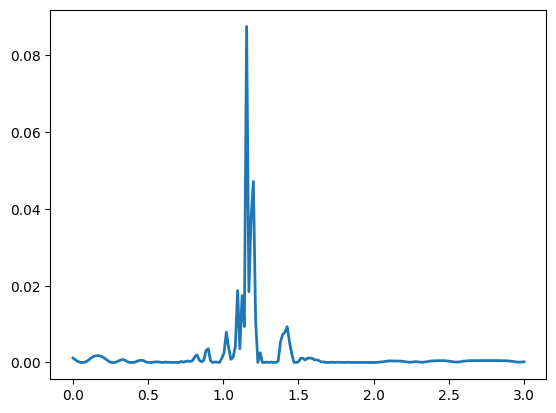

In [23]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

Comparing with single fidelity case- 4 initial points and 4 BO (The same number of HF samples we used in iBO)

- We are not considering any low fidelity data

- We run the single fidelity cases study with 5 different random initializations

# Single fidelity Run 1

In [34]:
def kernel_prior() -> Dict[str, jnp.ndarray]:
    length = numpyro.sample("k_length", numpyro.distributions.Uniform(0.01, 1))
    scale = numpyro.sample("k_scale", numpyro.distributions.Uniform(0.01, 1))
    return {"k_length": length, "k_scale": scale}

In [35]:
n = 4

np.random.seed(0)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = train_x
train_x_full_norm = train_x_norm
train_x_full, train_x_full_norm

(array([[1.64644051],
        [2.1455681 ],
        [1.80829013],
        [1.63464955]]),
 array([[0.5488135 ],
        [0.71518937],
        [0.60276338],
        [0.54488318]]))

Evaluation 1 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.25it/s]

Completed. Saving
Time (s) to complete simulation 1: 212.2698950767517


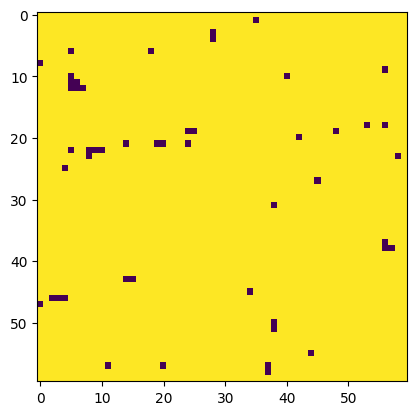

Evaluation 2 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.26it/s]

Completed. Saving
Time (s) to complete simulation 2: 210.4532446861267


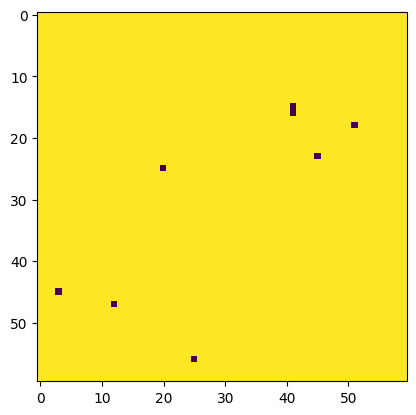

Evaluation 3 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:32<00:00,  3.28it/s]

Completed. Saving
Time (s) to complete simulation 3: 209.77943873405457


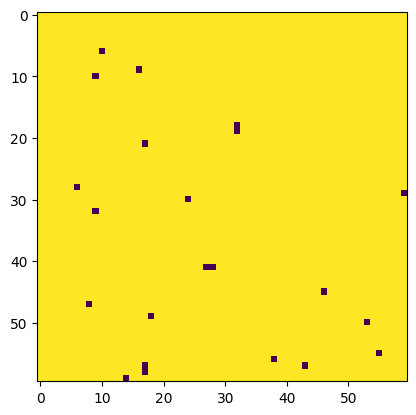

Evaluation 4 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 4: 208.27097964286804


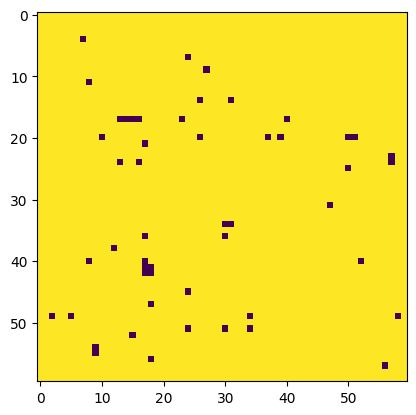

In [36]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i, 0],0,0],
                      [0,Jx[i, 0],0,Jx[i, 0],0],
                      [0,0,Jx[i, 0],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

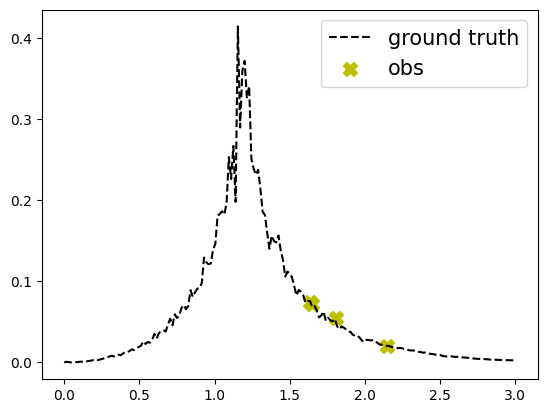

In [37]:
plt.plot(xs, true_ys_sq, "k--", label="ground truth")

plt.scatter(train_x, train_y, c="y", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [38]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[1.64644051],
        [2.1455681 ],
        [1.80829013],
        [1.63464955]]),
 array([[0.5488135 ],
        [0.71518937],
        [0.60276338],
        [0.54488318]]),
 array([[0.07172734],
        [0.02066802],
        [0.054606  ],
        [0.07418545]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 118.81it/s, 5 steps of size 5.51e-01. acc. prob=0.86]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.64      0.23      0.67      0.27      0.99    317.76      1.00
   k_scale      0.25      0.25      0.14      0.01      0.65    313.56      1.00
     noise      0.00      0.01      0.00      0.00      0.01    289.88      1.02



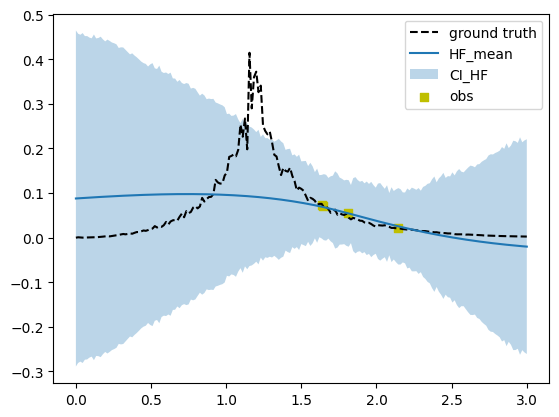

<ipython-input-39-3f6fda6eb5b7>:46: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


0
0.0 0.0
Evaluation 5 of 8

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:39<00:00,  3.14it/s]

Completed. Saving
Time (s) to complete simulation 2: 220.6499650478363


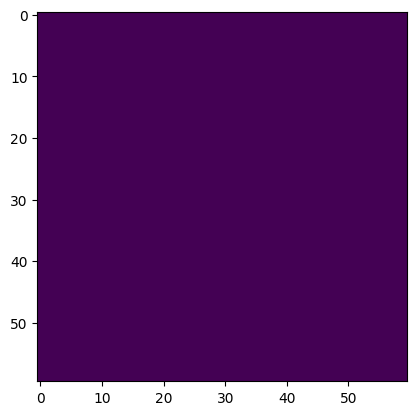

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 108.98it/s, 3 steps of size 5.04e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.64      0.22      0.67      0.32      0.99    186.11      1.01
   k_scale      0.16      0.20      0.07      0.01      0.41    247.77      1.00
     noise      0.00      0.01      0.00      0.00      0.01    263.90      1.00



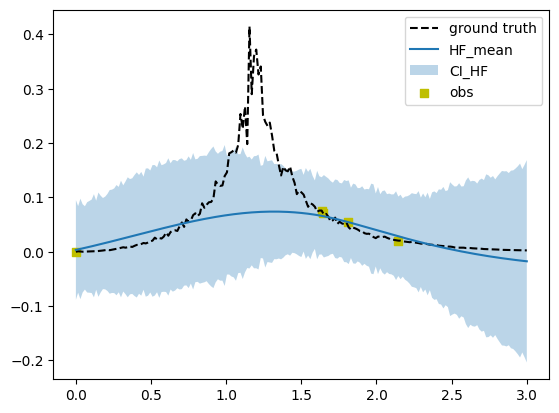

[ 0 66]
0.99 0.99
Evaluation 6 of 8

---Performing Equlibration---



100%|██████████| 500/500 [01:01<00:00,  8.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:32<00:00,  3.28it/s]

Completed. Saving
Time (s) to complete simulation 3: 214.0009787082672


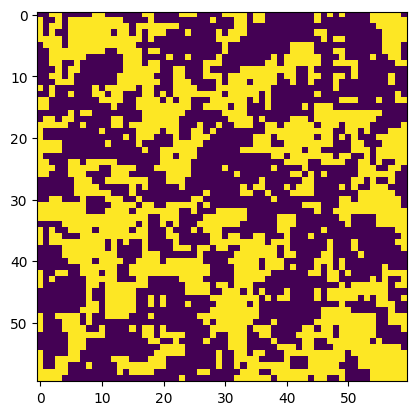

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 108.19it/s, 7 steps of size 4.43e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.65      0.21      0.67      0.36      0.99    260.61      1.00
   k_scale      0.16      0.18      0.09      0.01      0.42    218.95      1.00
     noise      0.00      0.00      0.00      0.00      0.01    386.49      1.00



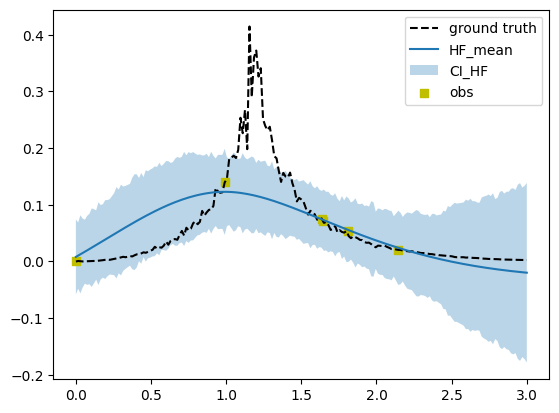

[ 0 66 60]
0.8999999999999999 0.8999999999999999
Evaluation 7 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 4: 208.02773213386536


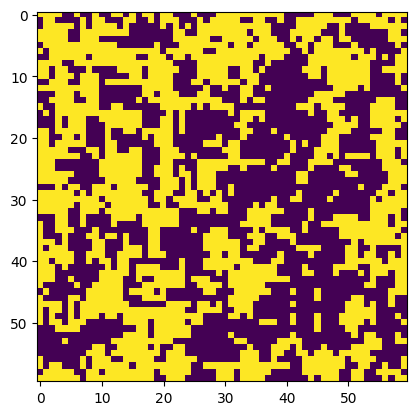

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 115.37it/s, 3 steps of size 5.98e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.66      0.21      0.69      0.36      1.00    391.10      1.00
   k_scale      0.16      0.19      0.08      0.01      0.41    344.33      1.00
     noise      0.00      0.00      0.00      0.00      0.01    202.70      1.00



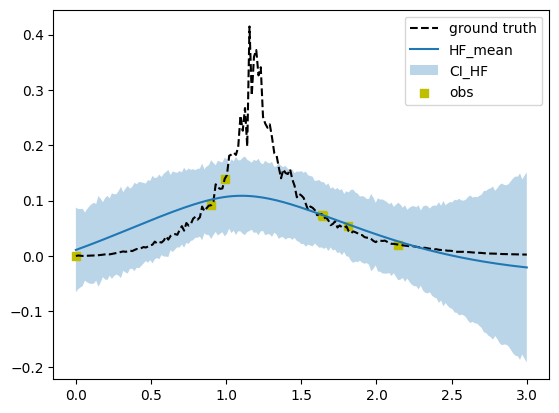

[ 0 66 60 71]
1.065 1.065
Evaluation 8 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 5: 204.65239763259888


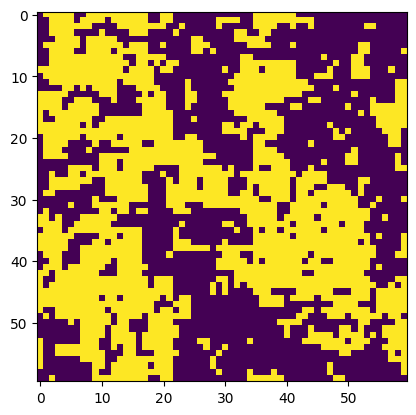

In [39]:
N = 4
X_test =xs
X_test_full = xs
X_test_norm = (X_test-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the EI acq function
    acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test_norm, maximize=True, noiseless=False)
    acq = np.array(acq)
    acq[idx] = -1
    next_point_val = acq.max()
    next_point_idx = acq.argmax()
    idx = np.hstack((idx, next_point_idx))

    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)


    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

Final GP prediction

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 111.31it/s, 7 steps of size 3.66e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.59      0.23      0.60      0.27      0.98    250.64      1.00
   k_scale      0.17      0.20      0.08      0.01      0.44    307.28      1.00
     noise      0.00      0.00      0.00      0.00      0.01    163.05      1.03



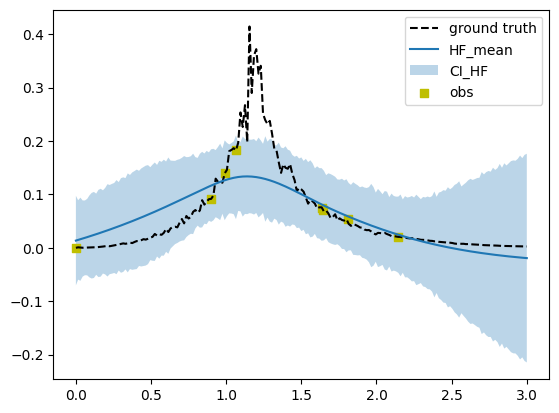

In [40]:
    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

0.0026095985813041687


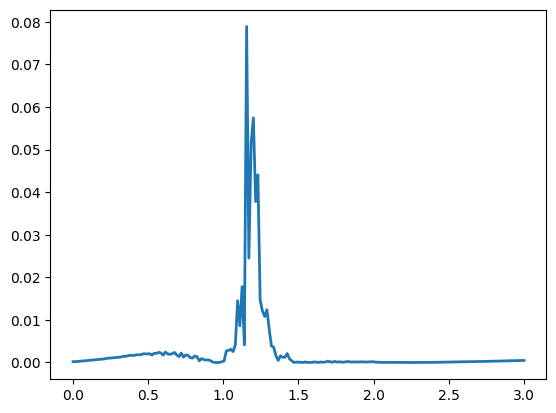

In [41]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# Single fidelity Run 2

In [42]:
n = 4

np.random.seed(10)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = train_x
train_x_full_norm = train_x_norm
train_x_full, train_x_full_norm

(array([[2.31396193],
        [0.06225585],
        [1.9009447 ],
        [2.24641165]]),
 array([[0.77132064],
        [0.02075195],
        [0.63364823],
        [0.74880388]]))

Evaluation 1 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 1: 202.89178800582886


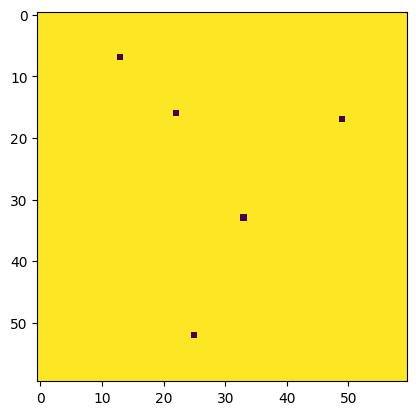

Evaluation 2 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:59<00:00,  8.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.27it/s]

Completed. Saving
Time (s) to complete simulation 2: 212.3809356689453


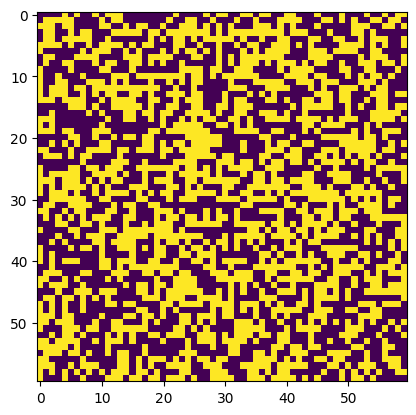

Evaluation 3 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 3: 206.85449481010437


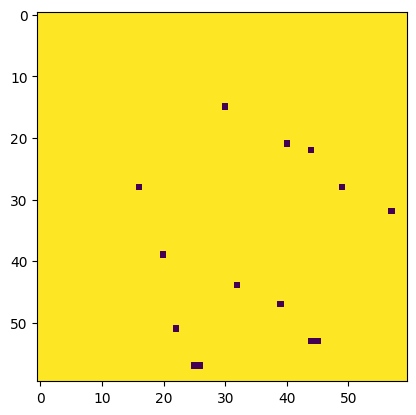

Evaluation 4 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 4: 203.3039355278015


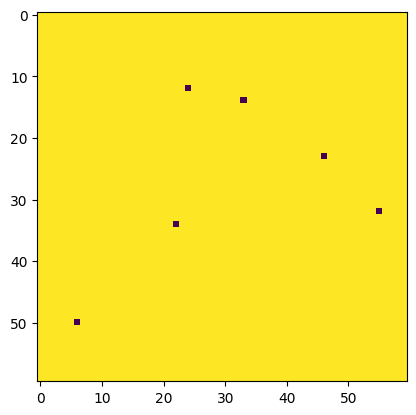

In [43]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i, 0],0,0],
                      [0,Jx[i, 0],0,Jx[i, 0],0],
                      [0,0,Jx[i, 0],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

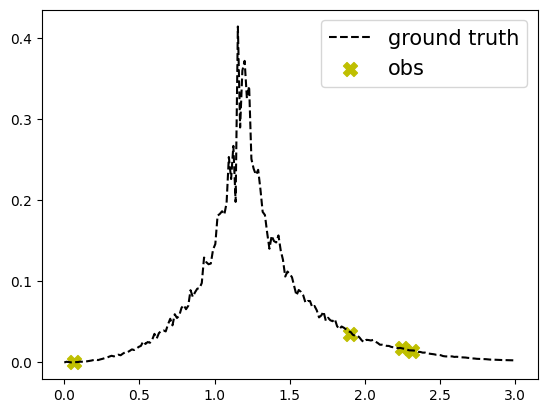

In [44]:
plt.plot(xs, true_ys_sq, "k--", label="ground truth")

plt.scatter(train_x, train_y, c="y", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [45]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[2.31396193],
        [0.06225585],
        [1.9009447 ],
        [2.24641165]]),
 array([[0.77132064],
        [0.02075195],
        [0.63364823],
        [0.74880388]]),
 array([[0.01473524],
        [0.00025922],
        [0.03547815],
        [0.01739954]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 117.48it/s, 5 steps of size 4.45e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.59      0.27      0.63      0.17      0.99    210.95      1.00
   k_scale      0.14      0.18      0.07      0.01      0.37    386.52      1.00
     noise      0.01      0.01      0.00      0.00      0.02    404.68      1.00



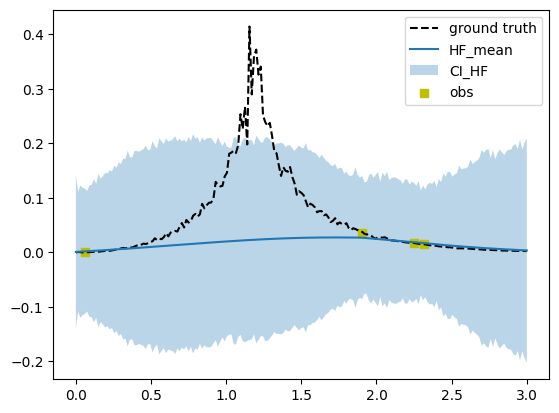

<ipython-input-46-3f6fda6eb5b7>:46: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


42
0.63 0.63
Evaluation 5 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.31it/s]

Completed. Saving
Time (s) to complete simulation 2: 209.45349049568176


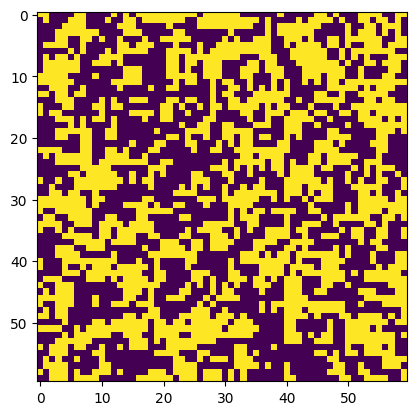

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 117.91it/s, 7 steps of size 4.20e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.70      0.20      0.75      0.40      0.99    368.42      1.00
   k_scale      0.09      0.13      0.04      0.01      0.26    247.23      1.00
     noise      0.00      0.01      0.00      0.00      0.01    296.65      1.01



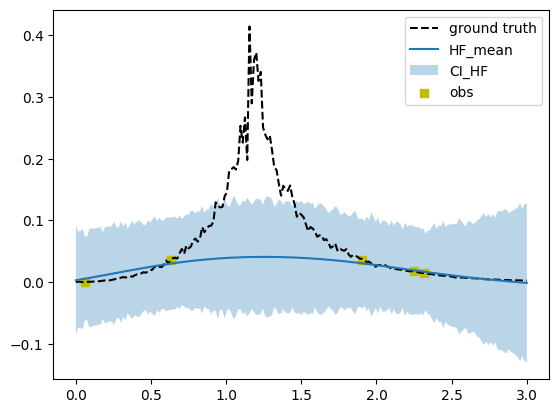

[42 85]
1.275 1.275
Evaluation 6 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 3: 206.56678938865662


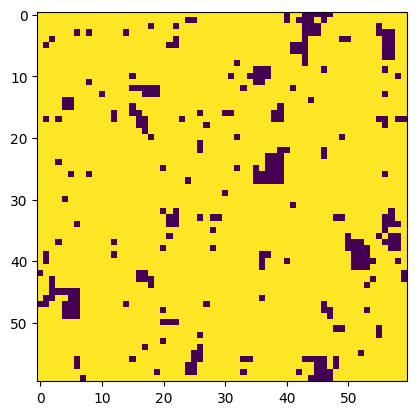

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 113.31it/s, 3 steps of size 5.25e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.58      0.24      0.60      0.23      0.99    397.85      1.00
   k_scale      0.20      0.22      0.12      0.01      0.52    253.39      1.00
     noise      0.01      0.01      0.01      0.00      0.03    343.85      1.00



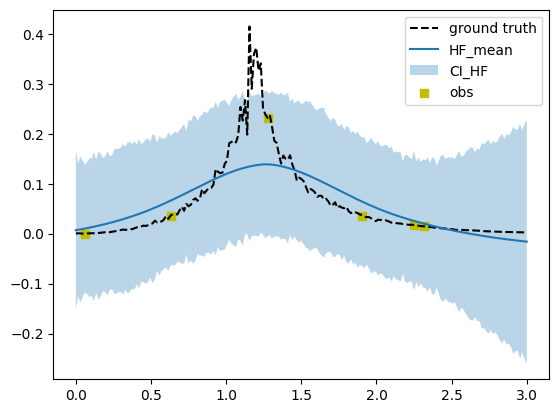

[42 85 84]
1.26 1.26
Evaluation 7 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.34it/s]

Completed. Saving
Time (s) to complete simulation 4: 207.9721555709839


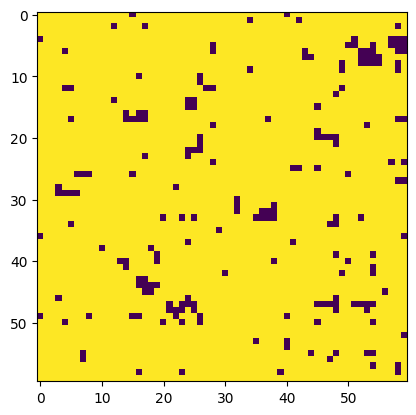

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:10<00:00, 92.68it/s, 3 steps of size 3.79e-01. acc. prob=0.84]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.49      0.25      0.45      0.11      0.90    240.84      1.00
   k_scale      0.20      0.22      0.11      0.01      0.54    252.21      1.00
     noise      0.01      0.01      0.01      0.00      0.02    314.73      1.00



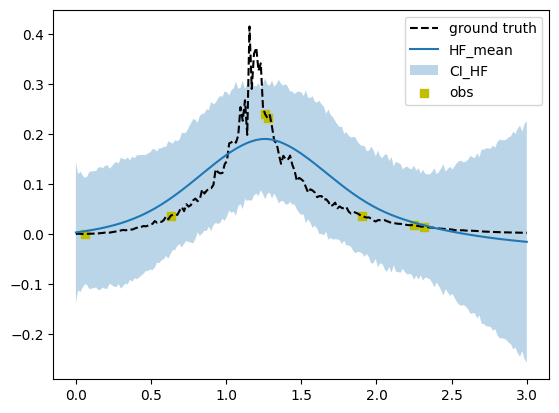

[42 85 84 89]
1.335 1.335
Evaluation 8 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 5: 205.2296507358551


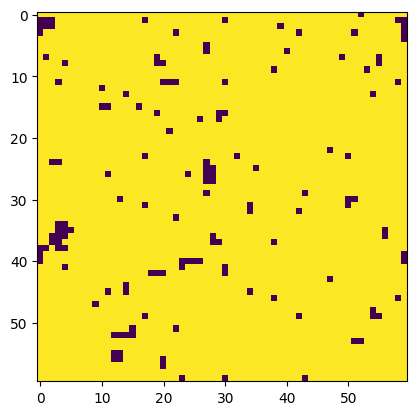

In [46]:
N = 4
X_test =xs
X_test_full = xs
X_test_norm = (X_test-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior,
                        noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the EI acq function
    acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test_norm, maximize=True, noiseless=False)
    acq = np.array(acq)
    acq[idx] = -1
    next_point_val = acq.max()
    next_point_idx = acq.argmax()
    idx = np.hstack((idx, next_point_idx))

    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)


    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 102.04it/s, 15 steps of size 3.45e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.46      0.24      0.41      0.11      0.88    215.89      1.00
   k_scale      0.20      0.24      0.10      0.01      0.57    176.22      1.00
     noise      0.00      0.01      0.00      0.00      0.01    288.73      1.00



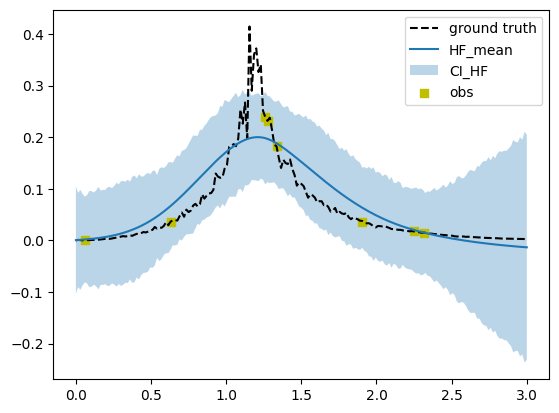

In [47]:
    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))

    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

0.001426536288493446


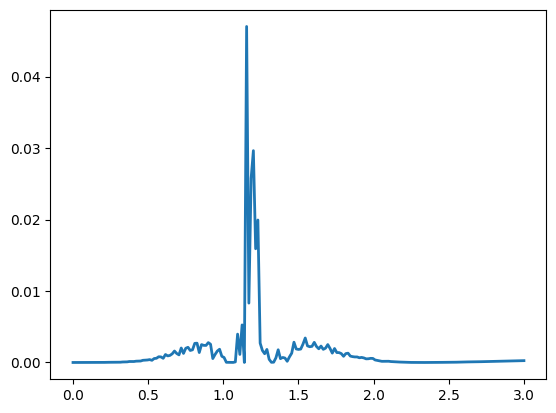

In [48]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# Single fidelity Run 3

In [49]:
n = 4

np.random.seed(100)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = train_x
train_x_full_norm = train_x_norm
train_x_full, train_x_full_norm

(array([[1.63021483],
        [0.83510816],
        [1.27355277],
        [2.5343284 ]]),
 array([[0.54340494],
        [0.27836939],
        [0.42451759],
        [0.84477613]]))

Evaluation 1 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 1: 205.17447471618652


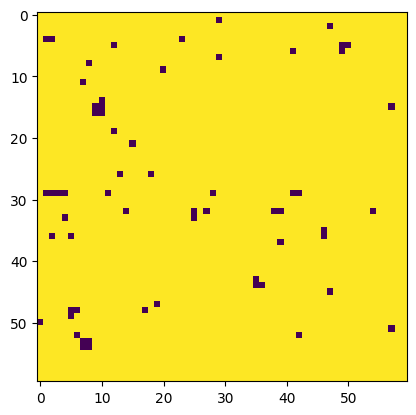

Evaluation 2 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.30it/s]

Completed. Saving
Time (s) to complete simulation 2: 209.53884172439575


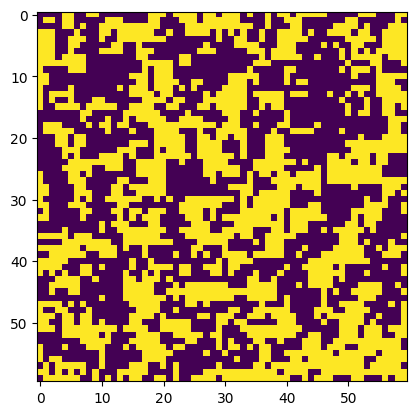

Evaluation 3 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 3: 204.31247115135193


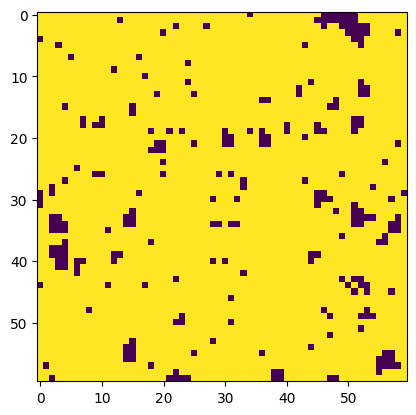

Evaluation 4 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 4: 203.04636764526367


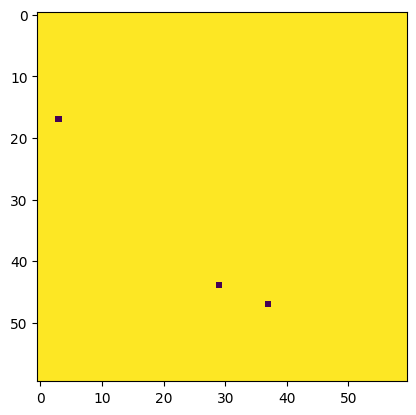

In [50]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i, 0],0,0],
                      [0,Jx[i, 0],0,Jx[i, 0],0],
                      [0,0,Jx[i, 0],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

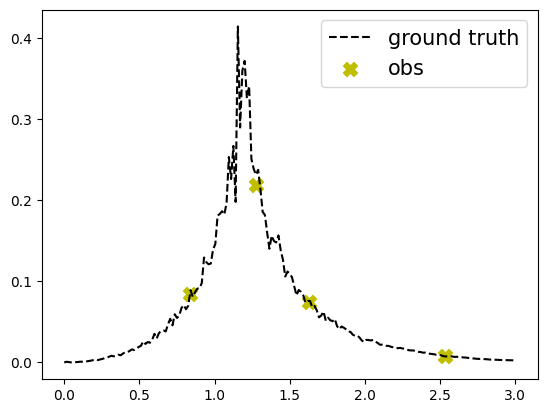

In [51]:
plt.plot(xs, true_ys_sq, "k--", label="ground truth")

plt.scatter(train_x, train_y, c="y", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [52]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[1.63021483],
        [0.83510816],
        [1.27355277],
        [2.5343284 ]]),
 array([[0.54340494],
        [0.27836939],
        [0.42451759],
        [0.84477613]]),
 array([[0.07500626],
        [0.08455452],
        [0.21936277],
        [0.00754245]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 103.24it/s, 7 steps of size 4.58e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.59      0.25      0.62      0.22      0.99    415.66      1.00
   k_scale      0.21      0.22      0.12      0.01      0.52    382.49      1.00
     noise      0.02      0.01      0.01      0.00      0.04    481.87      1.00



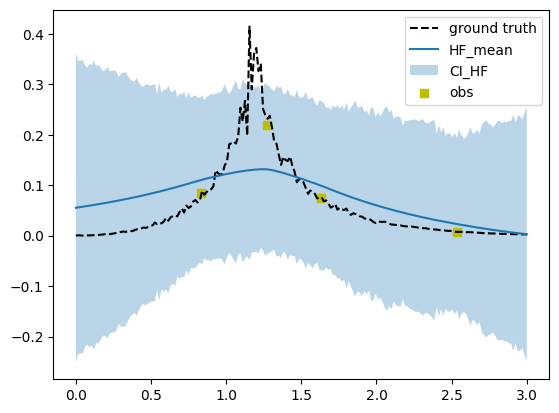

<ipython-input-53-cdd9630e7a0a>:45: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


0
0.0 0.0
Evaluation 5 of 8

---Performing Equlibration---



100%|██████████| 500/500 [01:00<00:00,  8.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:37<00:00,  3.17it/s]

Completed. Saving
Time (s) to complete simulation 2: 217.92854475975037


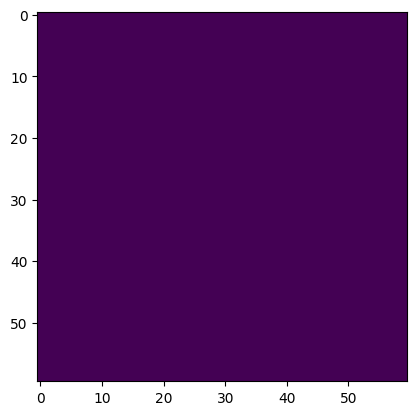

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 114.81it/s, 7 steps of size 6.23e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.60      0.26      0.65      0.21      1.00    472.74      1.00
   k_scale      0.17      0.21      0.09      0.01      0.47    410.06      1.00
     noise      0.02      0.01      0.01      0.00      0.03    424.57      1.00



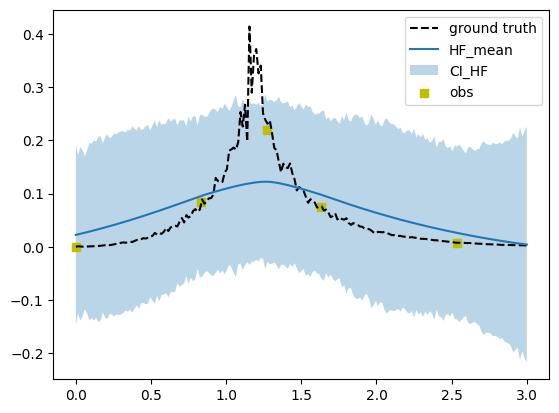

[ 0 89]
1.335 1.335
Evaluation 6 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 3: 208.50444340705872


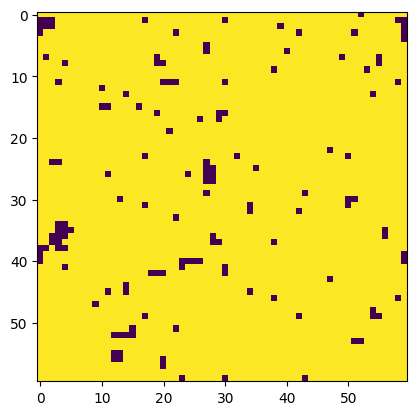

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 118.04it/s, 3 steps of size 5.63e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.62      0.24      0.66      0.27      0.99    311.65      1.00
   k_scale      0.18      0.21      0.10      0.01      0.52    278.78      1.00
     noise      0.01      0.01      0.01      0.00      0.03    306.68      1.00



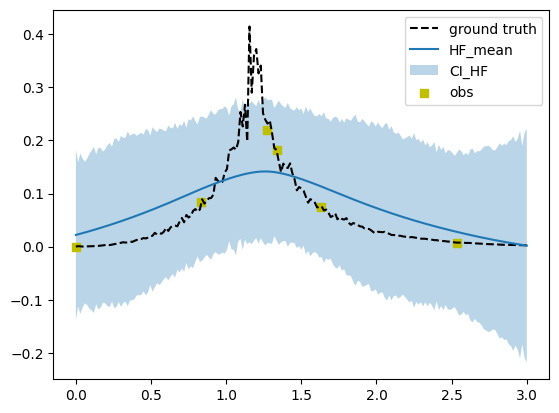

[ 0 89 84]
1.26 1.26
Evaluation 7 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.25it/s]

Completed. Saving
Time (s) to complete simulation 4: 211.2186098098755


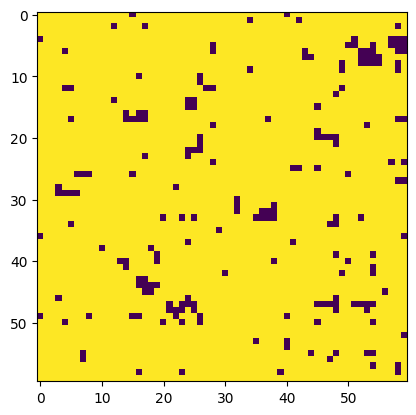

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 110.65it/s, 7 steps of size 4.53e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.53      0.25      0.53      0.15      0.94    258.46      1.00
   k_scale      0.20      0.22      0.12      0.01      0.56    187.15      1.00
     noise      0.01      0.01      0.01      0.00      0.02    371.69      1.00



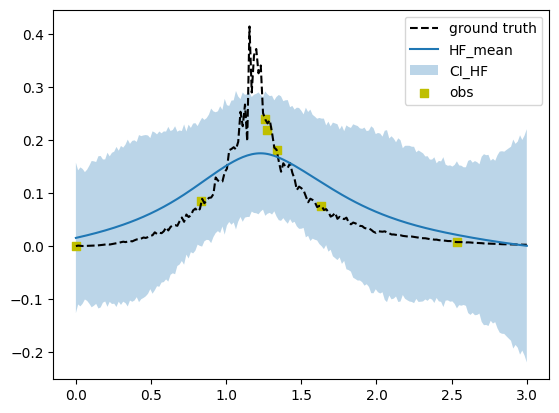

[ 0 89 84 71]
1.065 1.065
Evaluation 8 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.27it/s]

Completed. Saving
Time (s) to complete simulation 5: 210.54593062400818


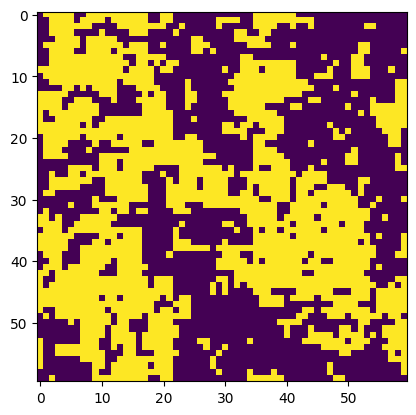

In [53]:
N = 4
X_test =xs
X_test_full = xs
X_test_norm = (X_test-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the EI acq function
    acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test_norm, maximize=True, noiseless=False)
    acq = np.array(acq)
    acq[idx] = -1
    next_point_val = acq.max()
    next_point_idx = acq.argmax()
    idx = np.hstack((idx, next_point_idx))

    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)


    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 104.89it/s, 7 steps of size 4.10e-01. acc. prob=0.86]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.49      0.25      0.47      0.15      0.93    218.29      1.00
   k_scale      0.18      0.21      0.08      0.01      0.51    231.76      1.00
     noise      0.01      0.01      0.00      0.00      0.01    254.55      1.00



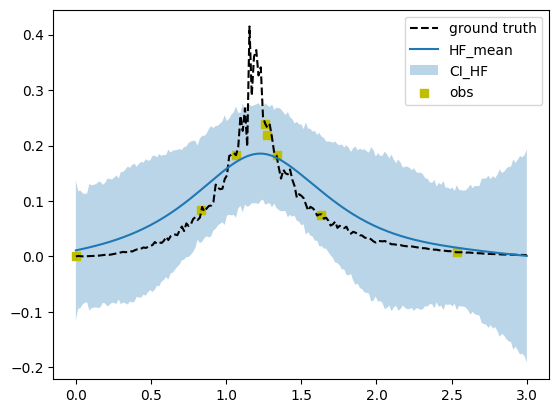

In [54]:
    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

0.0017342390680914288


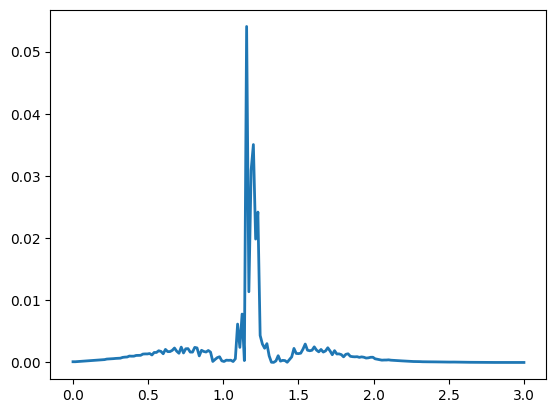

In [55]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# Single fidelity Run 4

In [56]:
n = 4

np.random.seed(1000)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = train_x
train_x_full_norm = train_x_norm
train_x_full, train_x_full_norm

(array([[1.96076876],
        [0.34502083],
        [2.85084859],
        [1.4465742 ]]),
 array([[0.65358959],
        [0.11500694],
        [0.95028286],
        [0.4821914 ]]))

Evaluation 1 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.34it/s]

Completed. Saving
Time (s) to complete simulation 1: 206.45051217079163


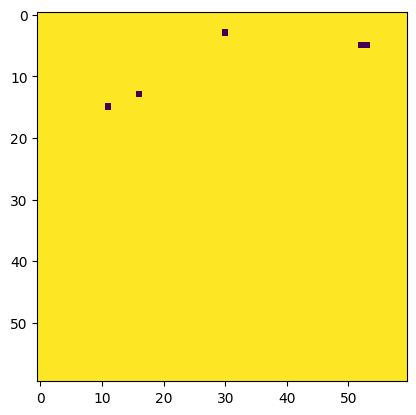

Evaluation 2 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:32<00:00,  3.28it/s]

Completed. Saving
Time (s) to complete simulation 2: 211.20285058021545


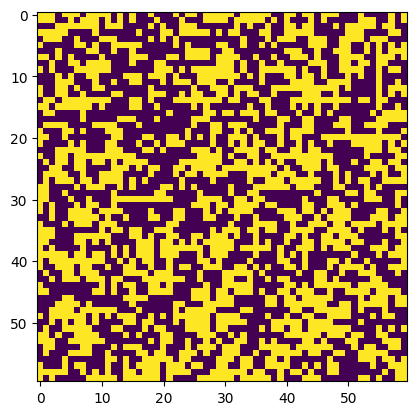

Evaluation 3 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.75it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.31it/s]

Completed. Saving
Time (s) to complete simulation 3: 208.05704998970032


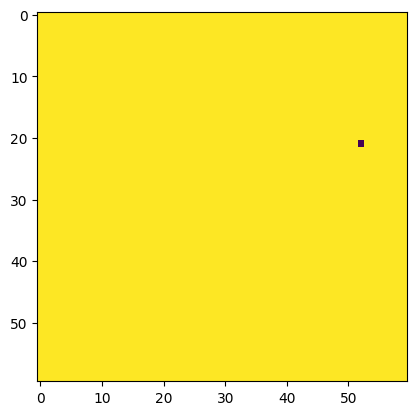

Evaluation 4 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:33<00:00,  3.26it/s]

Completed. Saving
Time (s) to complete simulation 4: 210.5984649658203


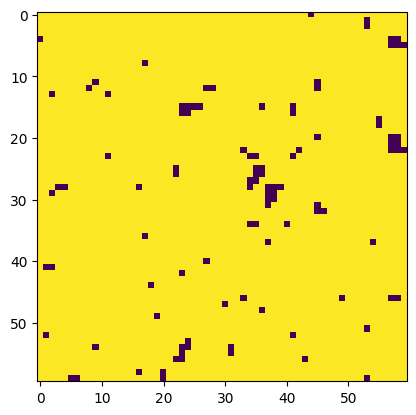

In [57]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i, 0],0,0],
                      [0,Jx[i, 0],0,Jx[i, 0],0],
                      [0,0,Jx[i, 0],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

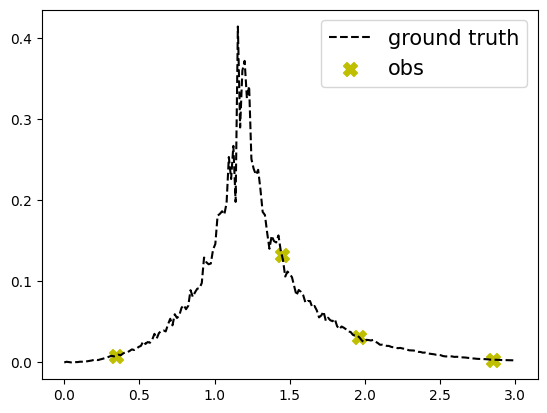

In [58]:
plt.plot(xs, true_ys_sq, "k--", label="ground truth")

plt.scatter(train_x, train_y, c="y", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [59]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[1.96076876],
        [0.34502083],
        [2.85084859],
        [1.4465742 ]]),
 array([[0.65358959],
        [0.11500694],
        [0.95028286],
        [0.4821914 ]]),
 array([[0.03161136],
        [0.00813067],
        [0.00352123],
        [0.1324398 ]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 117.62it/s, 5 steps of size 6.58e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.62      0.26      0.66      0.21      1.00    472.73      1.00
   k_scale      0.18      0.21      0.09      0.01      0.52    330.52      1.00
     noise      0.02      0.01      0.01      0.00      0.03    342.75      1.00



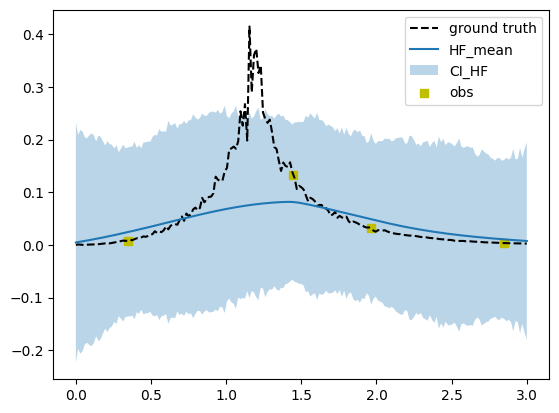

<ipython-input-60-cdd9630e7a0a>:45: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


71
1.065 1.065
Evaluation 5 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.33it/s]

Completed. Saving
Time (s) to complete simulation 2: 208.3668246269226


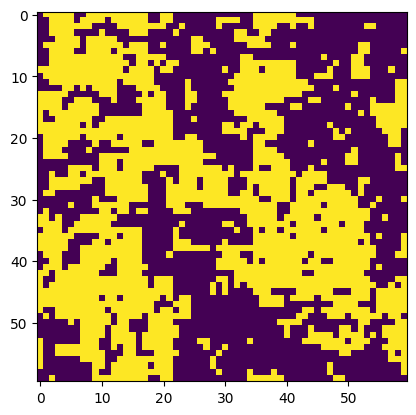

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 119.31it/s, 7 steps of size 5.39e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.61      0.25      0.64      0.23      0.99    307.61      1.00
   k_scale      0.17      0.21      0.08      0.01      0.47    238.80      1.00
     noise      0.01      0.01      0.01      0.00      0.03    265.61      1.00



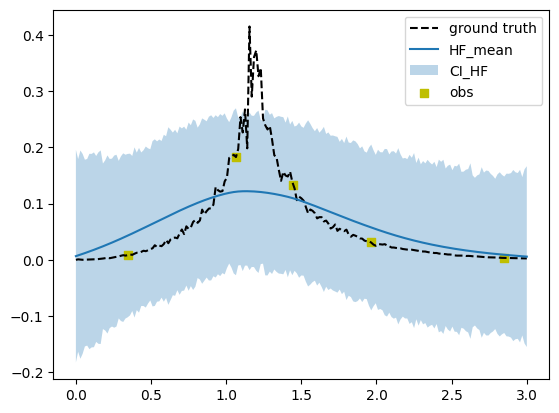

[71 85]
1.275 1.275
Evaluation 6 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.29it/s]

Completed. Saving
Time (s) to complete simulation 3: 209.53917837142944


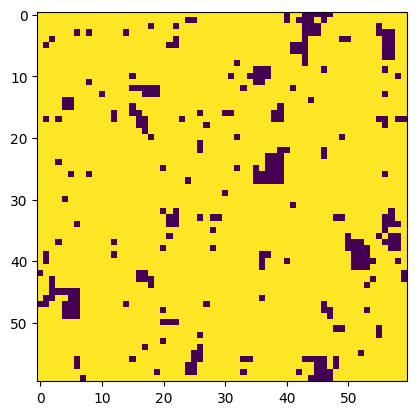

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 115.15it/s, 7 steps of size 6.08e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.60      0.23      0.63      0.24      0.98    280.30      1.00
   k_scale      0.20      0.21      0.11      0.01      0.53    332.08      1.00
     noise      0.01      0.01      0.01      0.00      0.03    254.43      1.00



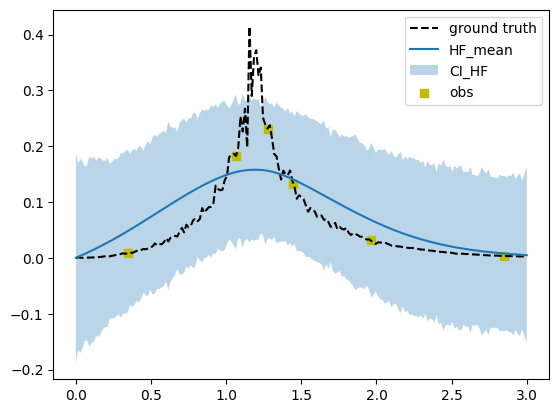

[71 85 74]
1.1099999999999999 1.1099999999999999
Evaluation 7 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 4: 208.219624042511


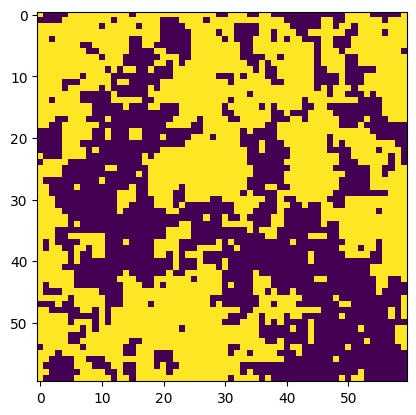

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 108.15it/s, 7 steps of size 4.65e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.56      0.24      0.56      0.22      0.98    273.69      1.00
   k_scale      0.19      0.21      0.10      0.01      0.51    296.18      1.00
     noise      0.01      0.01      0.01      0.00      0.02    327.60      1.00



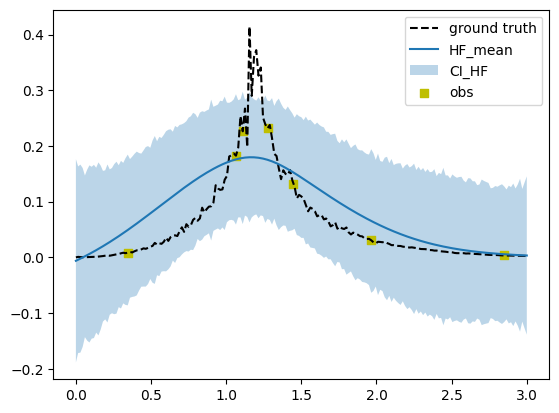

[71 85 74 77]
1.155 1.155
Evaluation 8 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 5: 206.6306595802307


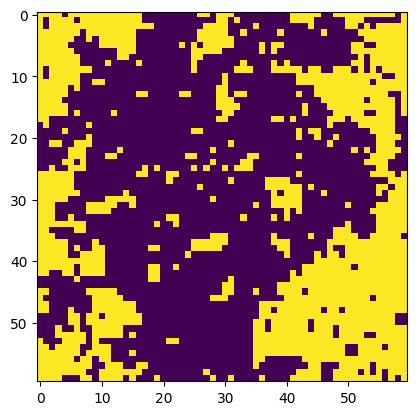

In [60]:
N = 4
X_test =xs
X_test_full = xs
X_test_norm = (X_test-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the EI acq function
    acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test_norm, maximize=True, noiseless=False)
    acq = np.array(acq)
    acq[idx] = -1
    next_point_val = acq.max()
    next_point_idx = acq.argmax()
    idx = np.hstack((idx, next_point_idx))

    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)


    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 120.66it/s, 7 steps of size 5.55e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.55      0.26      0.57      0.16      0.98    319.38      1.01
   k_scale      0.24      0.23      0.15      0.01      0.62    247.15      1.00
     noise      0.02      0.01      0.02      0.00      0.04    286.85      1.00



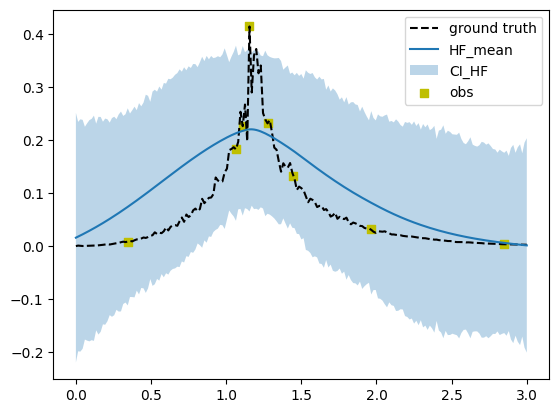

In [61]:
    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

0.003527469813888602


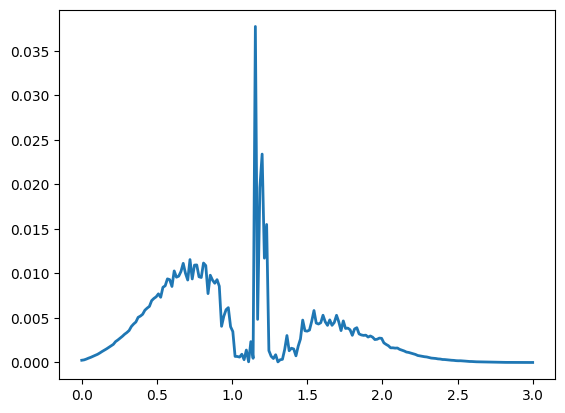

In [62]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

# Single fidelity Run 5

In [63]:
n = 4

np.random.seed(10000)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = train_x
train_x_full_norm = train_x_norm
train_x_full, train_x_full_norm

(array([[1.63641045],
        [0.51559595],
        [2.55879543],
        [0.54067023]]),
 array([[0.54547015],
        [0.17186532],
        [0.85293181],
        [0.18022341]]))

Evaluation 1 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 1: 202.32344436645508


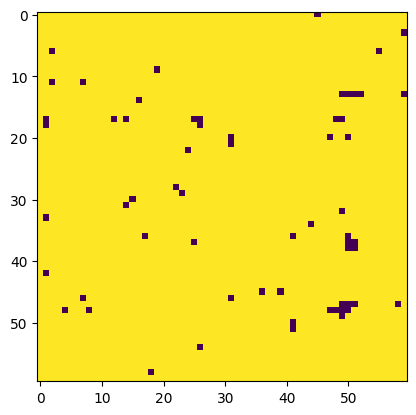

Evaluation 2 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 2: 208.25400114059448


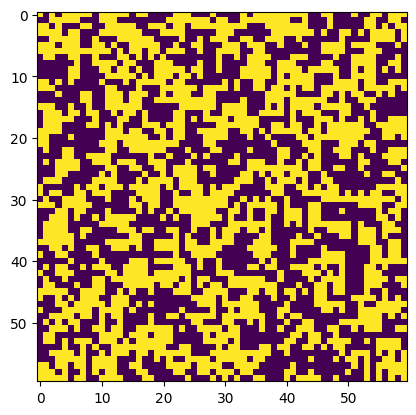

Evaluation 3 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 3: 202.8300473690033


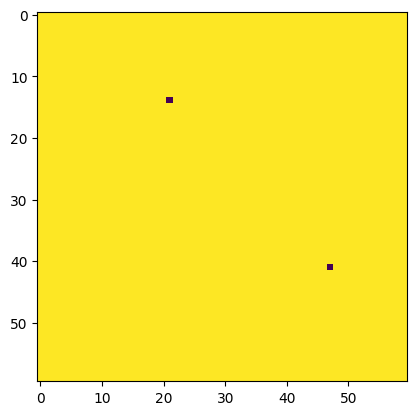

Evaluation 4 of 4

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 4: 207.3505482673645


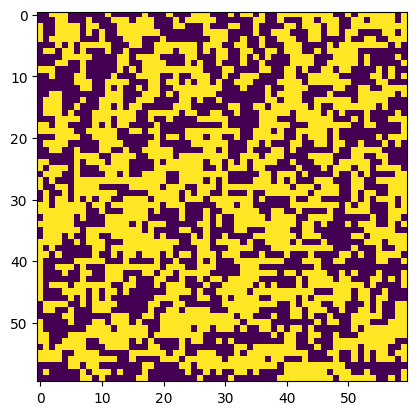

In [64]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i, 0],0,0],
                      [0,Jx[i, 0],0,Jx[i, 0],0],
                      [0,0,Jx[i, 0],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

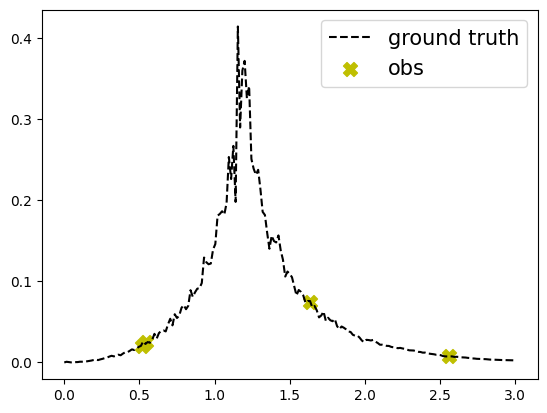

In [65]:
plt.plot(xs, true_ys_sq, "k--", label="ground truth")

plt.scatter(train_x, train_y, c="y", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [66]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[1.63641045],
        [0.51559595],
        [2.55879543],
        [0.54067023]]),
 array([[0.54547015],
        [0.17186532],
        [0.85293181],
        [0.18022341]]),
 array([[0.07490397],
        [0.0198766 ],
        [0.00738424],
        [0.02572423]]))

Step:1


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 116.57it/s, 7 steps of size 4.45e-01. acc. prob=0.86]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.58      0.26      0.62      0.18      0.96    325.36      1.00
   k_scale      0.15      0.19      0.07      0.01      0.43    248.82      1.00
     noise      0.01      0.01      0.01      0.00      0.03    379.49      1.00



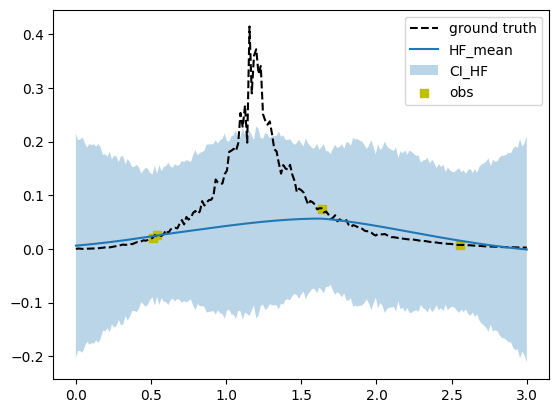

<ipython-input-67-cdd9630e7a0a>:45: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  idx = int(idx)


89
1.335 1.335
Evaluation 5 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.34it/s]

Completed. Saving
Time (s) to complete simulation 2: 205.89000034332275


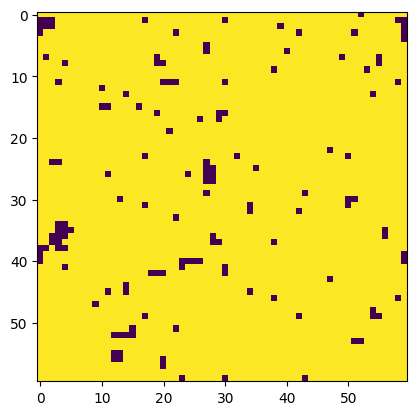

Step:2


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:08<00:00, 117.37it/s, 3 steps of size 4.80e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.59      0.26      0.61      0.23      1.00    189.68      1.00
   k_scale      0.20      0.22      0.12      0.01      0.53    220.79      1.00
     noise      0.01      0.01      0.01      0.00      0.03    321.87      1.00



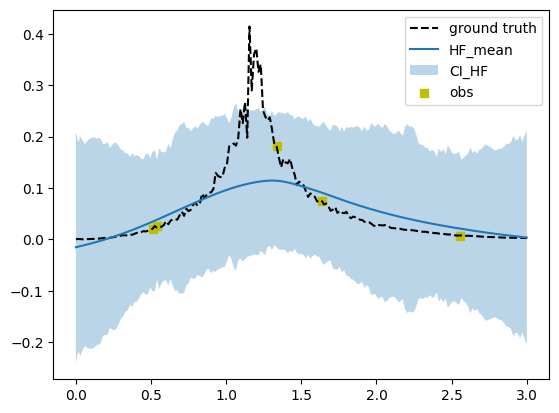

[89 71]
1.065 1.065
Evaluation 6 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.33it/s]


Completed. Saving
Time (s) to complete simulation 3: 207.08593678474426


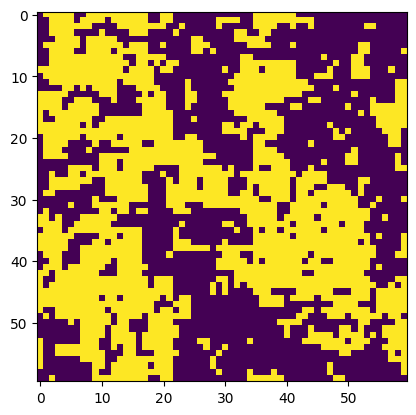

Step:3


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 100.15it/s, 7 steps of size 3.67e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.57      0.24      0.57      0.23      0.99    276.95      1.00
   k_scale      0.21      0.23      0.11      0.01      0.59    286.05      1.00
     noise      0.01      0.01      0.01      0.00      0.02    323.54      1.00



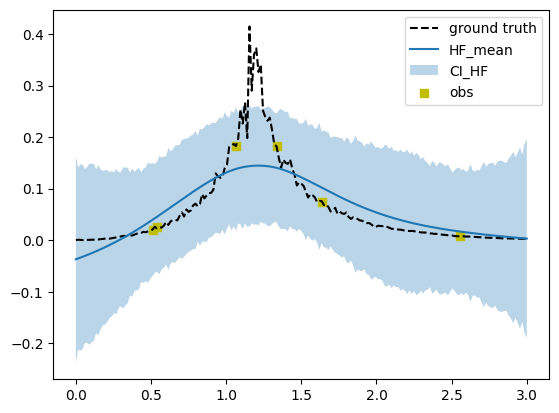

[89 71 86]
1.29 1.29
Evaluation 7 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:30<00:00,  3.32it/s]

Completed. Saving
Time (s) to complete simulation 4: 206.72637701034546


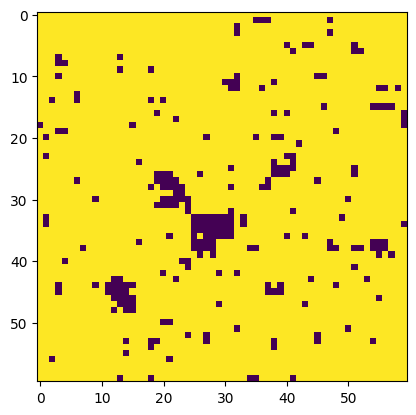

Step:4


/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 100.36it/s, 11 steps of size 3.60e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.52      0.26      0.49      0.20      1.00    197.82      1.00
   k_scale      0.21      0.22      0.11      0.01      0.55    279.44      1.01
     noise      0.01      0.01      0.01      0.00      0.02    209.52      1.00



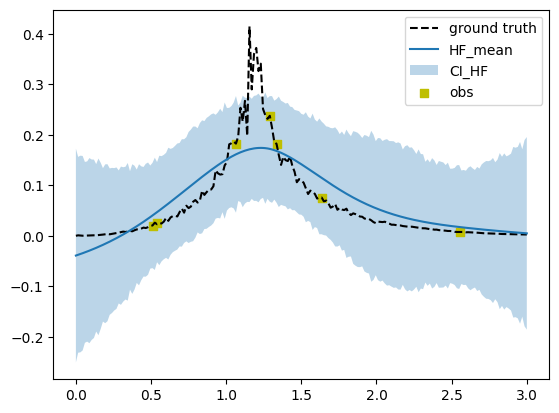

[89 71 86 84]
1.26 1.26
Evaluation 8 of 8

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.81it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:31<00:00,  3.31it/s]

Completed. Saving
Time (s) to complete simulation 5: 207.97122836112976


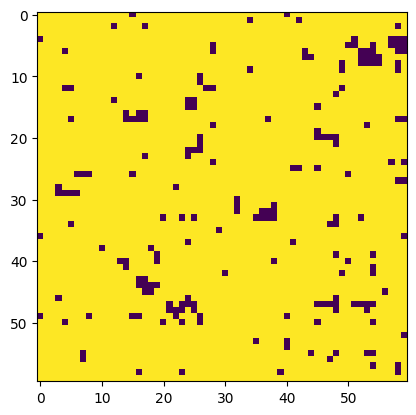

In [67]:
N = 4
X_test =xs
X_test_full = xs
X_test_norm = (X_test-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the EI acq function
    acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test_norm, maximize=True, noiseless=False)
    acq = np.array(acq)
    acq[idx] = -1
    next_point_val = acq.max()
    next_point_idx = acq.argmax()
    idx = np.hstack((idx, next_point_idx))

    if len(idx) == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)


    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:111: FutureWarning: `noise_prior` is deprecated and will be removed in a future version. Please use `noise_prior_dist` instead, which accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.HalfNormal(scale=0.1)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gpax/models/gp.py:119: UserWarning: `kernel_prior` will remain available for complex priors. However, for modifying only the lengthscales, it is recommended to use `lengthscale_prior_dist` instead. `lengthscale_prior_dist` accepts an instance of a numpyro.distributions Distribution object, e.g., `dist.Gamma(2, 5)`, rather than a function that calls `numpyro.sample`.
  warnings.warn(
sample: 100%|██████████| 1000/1000 [00:09<00:00, 103.37it/s, 7 steps of size 3.89e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.44      0.24      0.41      0.08      0.84    217.97      1.00
   k_scale      0.20      0.22      0.11      0.01      0.55    278.51      1.00
     noise      0.01      0.01      0.00      0.00      0.01    297.39      1.00



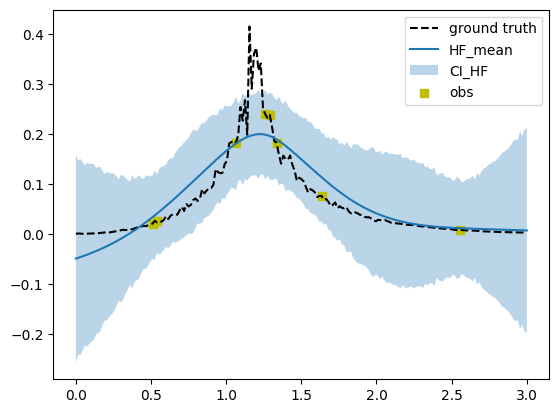

In [68]:
    # Initialize model
    gp_model = gpax.ExactGP(1, kernel='Matern', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.03)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_warmup=500, num_samples=500, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 5 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm)
        plt.plot(xs, true_ys_sq, "k--", label="ground truth")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x_full, train_y, c="y", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()

0.0014077322367784838


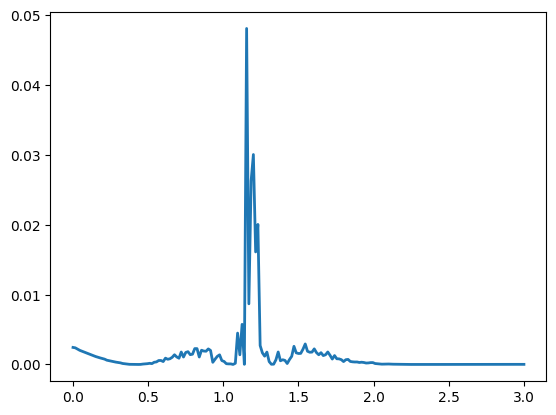

In [69]:
# Calculate MSE between HF ground truth and prediction values
error2 = (true_ys_sq-y_pred)**2
MSE = np.mean(error2)
print(MSE)

plt.plot(xs, error2, linewidth =2)

Generating ground truth data of HF function

Evaluation 1 of 201

---Performing Equlibration---



100%|██████████| 500/500 [01:02<00:00,  7.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:36<00:00,  3.19it/s]

Completed. Saving
Time (s) to complete simulation 1: 219.65644097328186


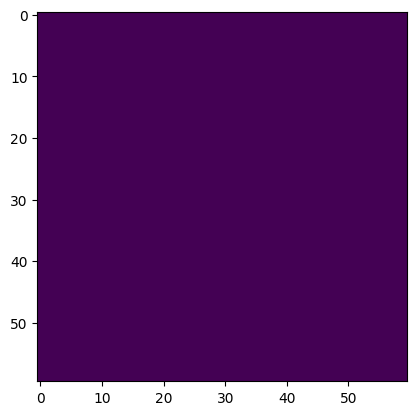

Evaluation 2 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 2: 205.31931495666504


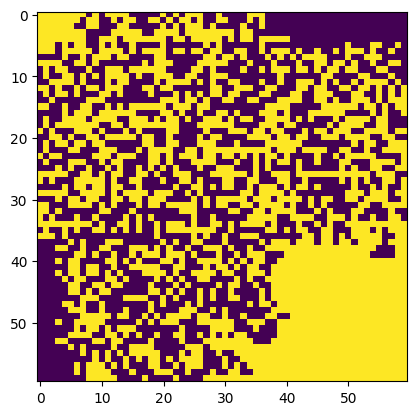

Evaluation 3 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 3: 204.52606415748596


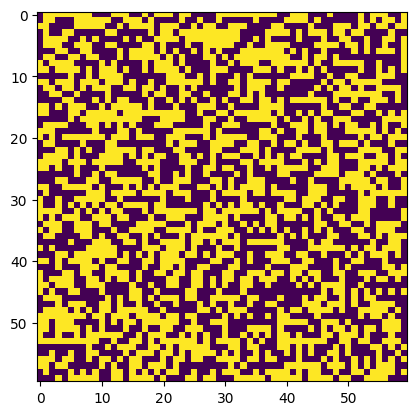

Evaluation 4 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 4: 204.14347672462463


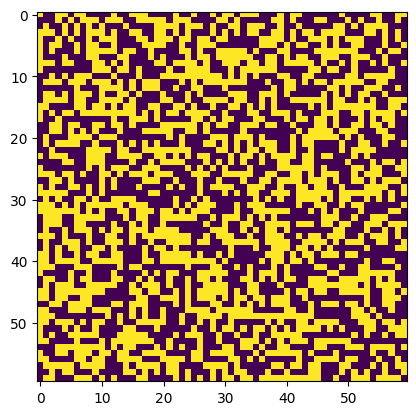

Evaluation 5 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]


Completed. Saving
Time (s) to complete simulation 5: 204.99318504333496


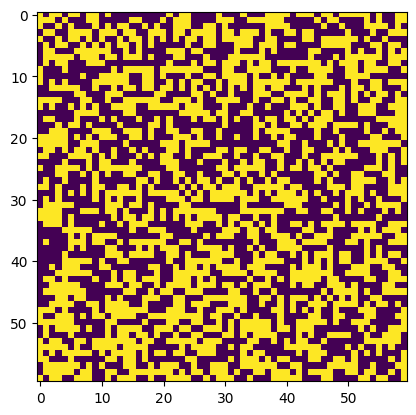

Evaluation 6 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 6: 204.41737937927246


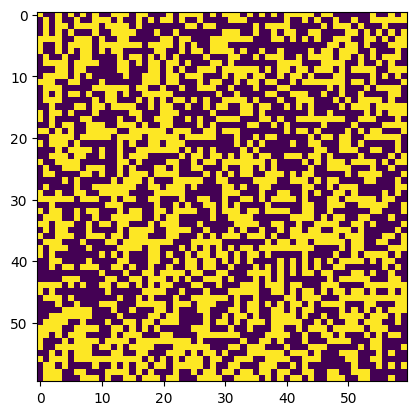

Evaluation 7 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 7: 202.7297010421753


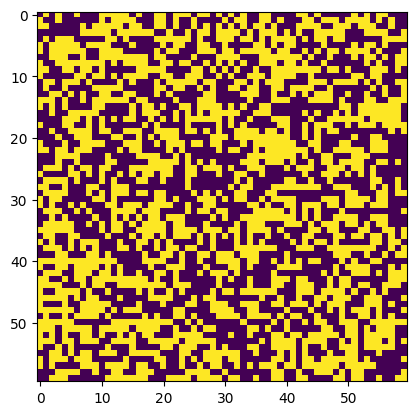

Evaluation 8 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 8: 203.59688782691956


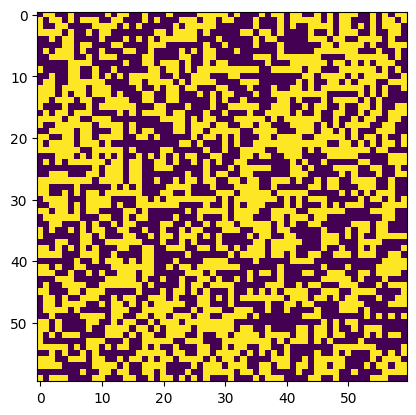

Evaluation 9 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 9: 203.16724753379822


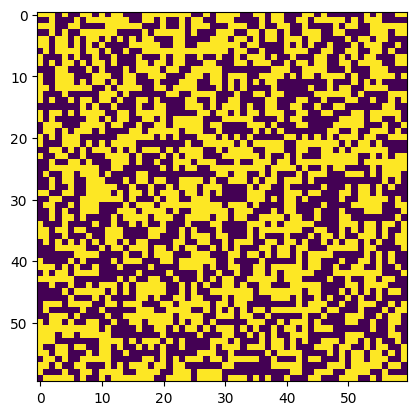

Evaluation 10 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 10: 202.59187173843384


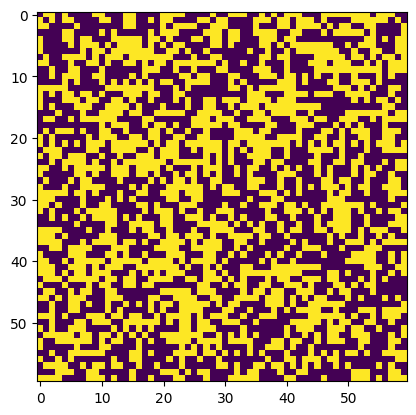

Evaluation 11 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 11: 203.9920084476471


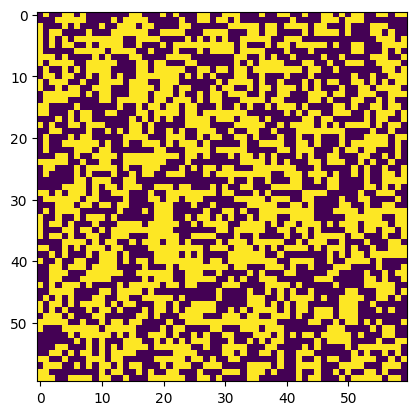

Evaluation 12 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 12: 204.21856474876404


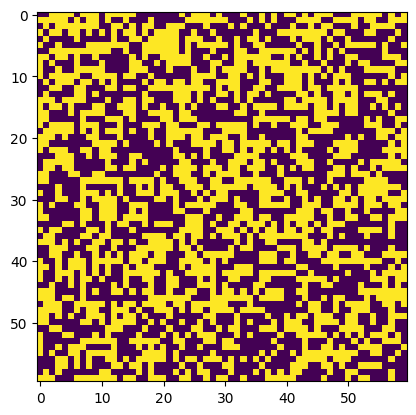

Evaluation 13 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 13: 203.16126322746277


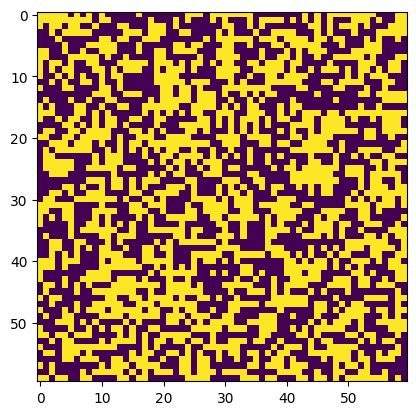

Evaluation 14 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 14: 203.41063499450684


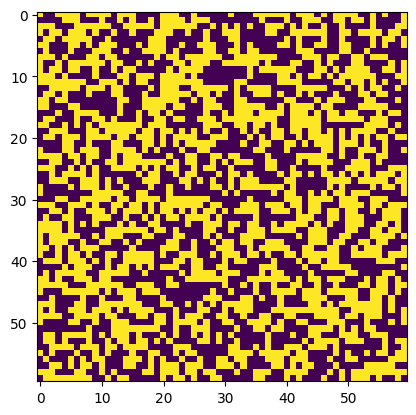

Evaluation 15 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 15: 204.70996928215027


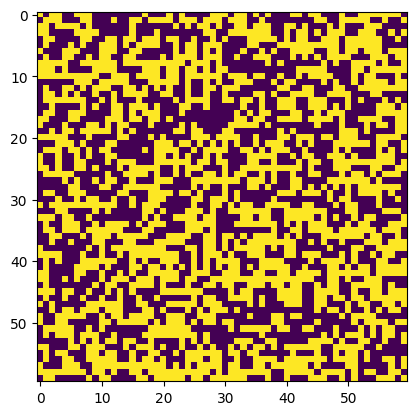

Evaluation 16 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 16: 206.0318145751953


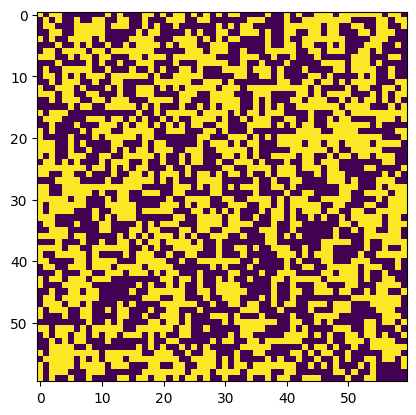

Evaluation 17 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 17: 204.67937660217285


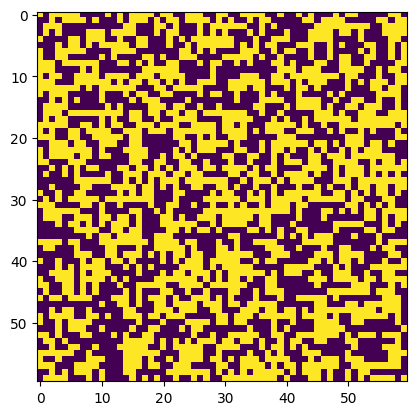

Evaluation 18 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 18: 203.13325190544128


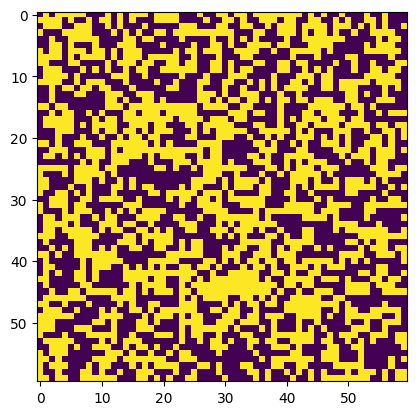

Evaluation 19 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 19: 204.34319758415222


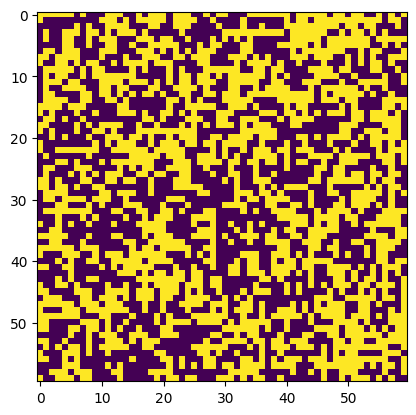

Evaluation 20 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 20: 205.15570640563965


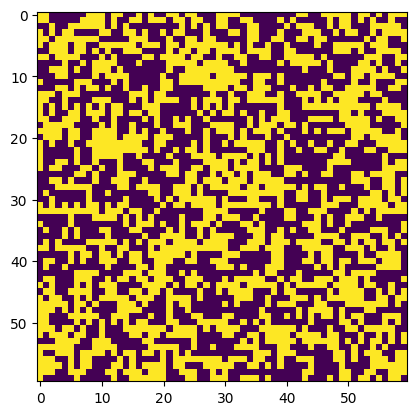

Evaluation 21 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 21: 204.3240294456482


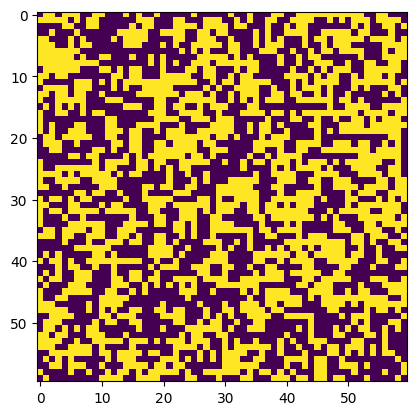

Evaluation 22 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 22: 204.3826858997345


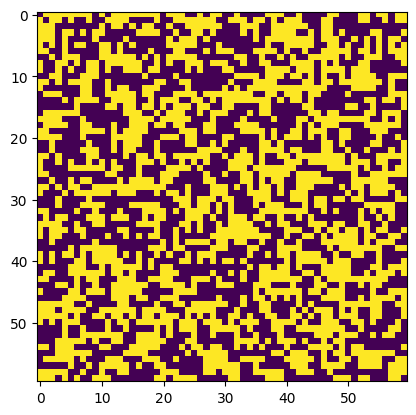

Evaluation 23 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 23: 205.01625537872314


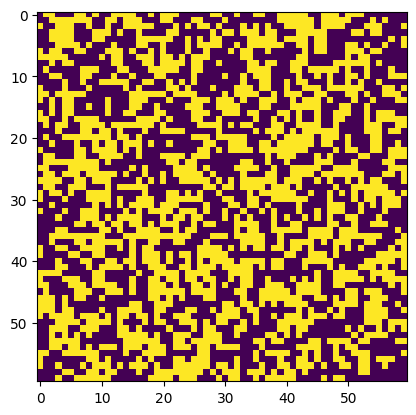

Evaluation 24 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 24: 207.24885821342468


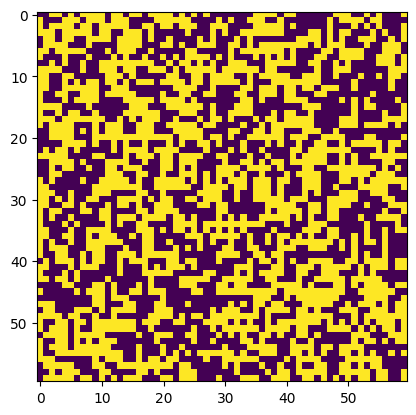

Evaluation 25 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 25: 206.29584002494812


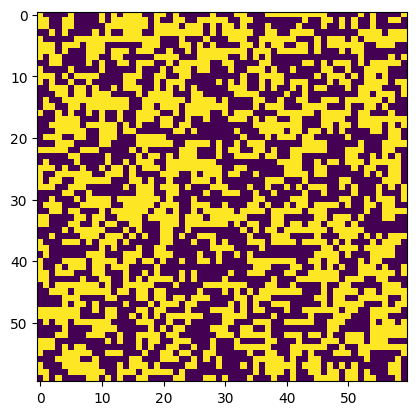

Evaluation 26 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 26: 207.62114095687866


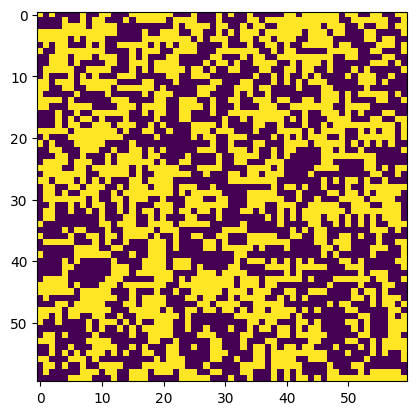

Evaluation 27 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 27: 208.0540895462036


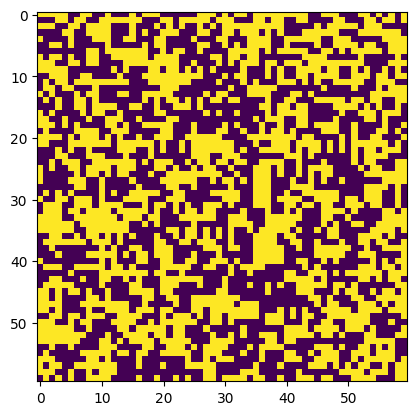

Evaluation 28 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 28: 207.18846154212952


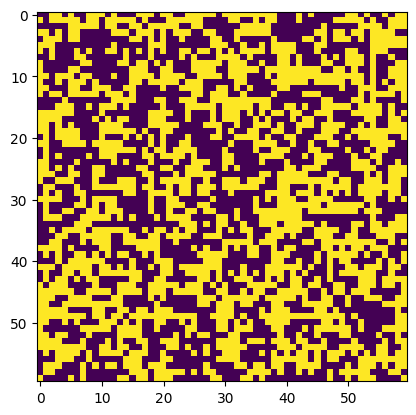

Evaluation 29 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 29: 207.6347095966339


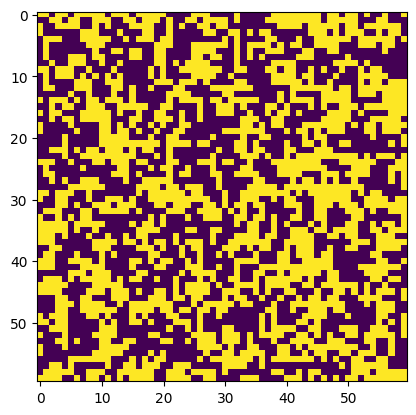

Evaluation 30 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.34it/s]

Completed. Saving
Time (s) to complete simulation 30: 208.24073100090027


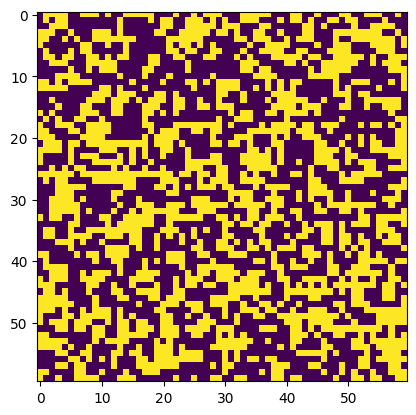

Evaluation 31 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 31: 207.21384072303772


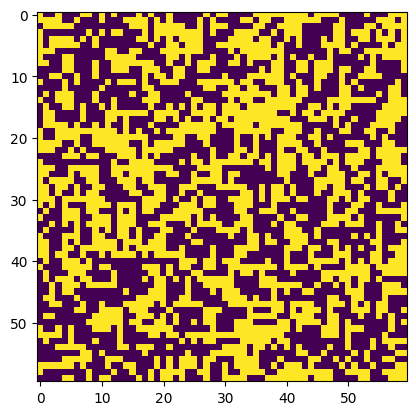

Evaluation 32 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 32: 206.77513194084167


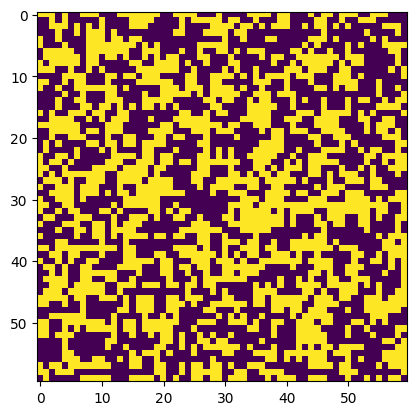

Evaluation 33 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 33: 205.8112301826477


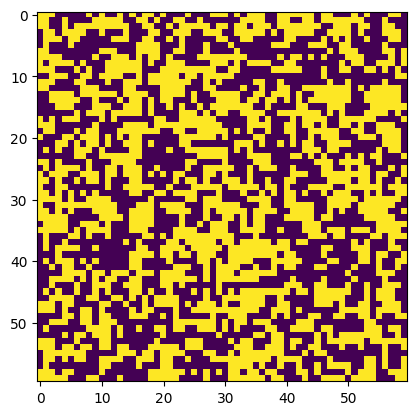

Evaluation 34 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 34: 205.96284461021423


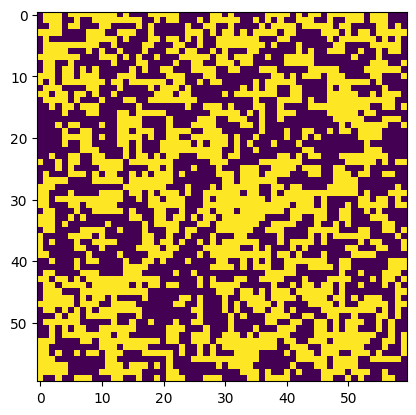

Evaluation 35 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 35: 205.83488821983337


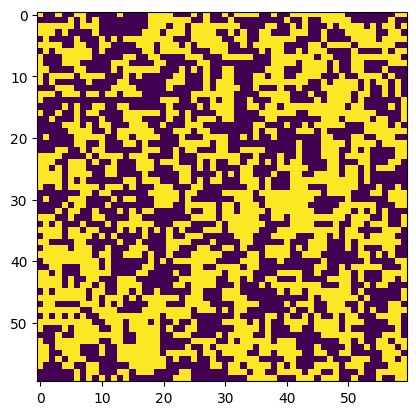

Evaluation 36 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 36: 205.41115355491638


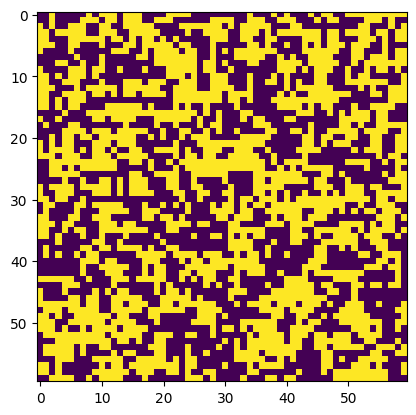

Evaluation 37 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 37: 205.9105725288391


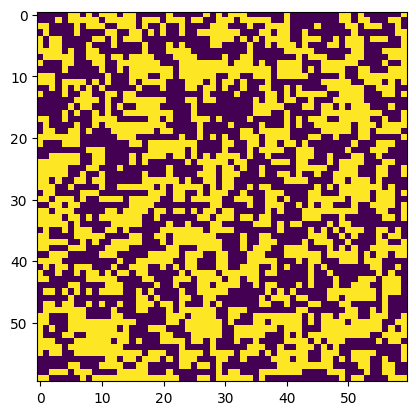

Evaluation 38 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 38: 206.89454126358032


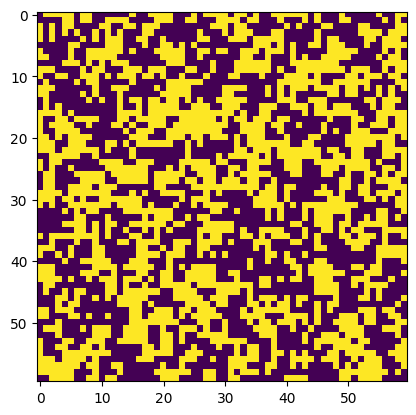

Evaluation 39 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 39: 204.93096613883972


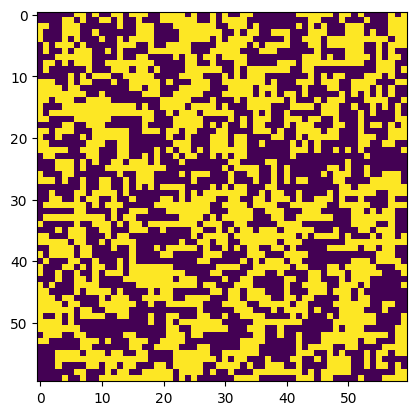

Evaluation 40 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 40: 205.12270665168762


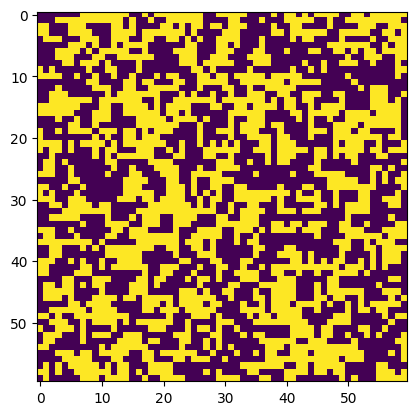

Evaluation 41 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]


Completed. Saving
Time (s) to complete simulation 41: 206.259770154953


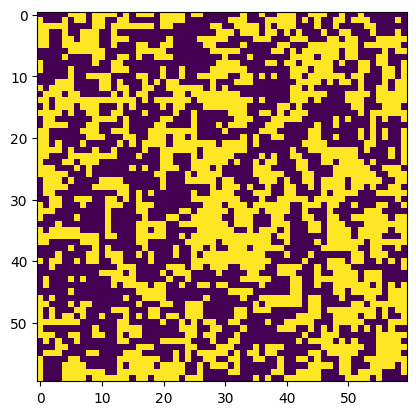

Evaluation 42 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 42: 205.66759872436523


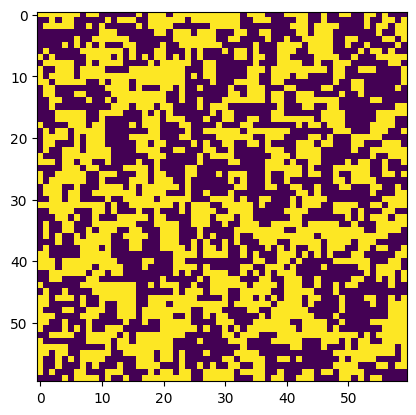

Evaluation 43 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 43: 206.28486108779907


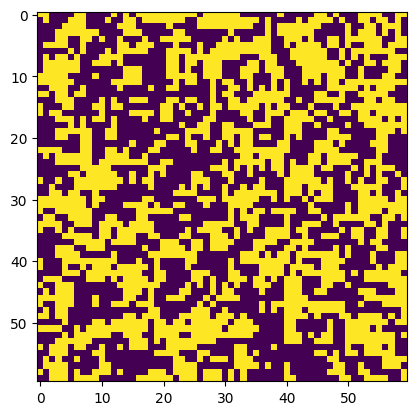

Evaluation 44 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 44: 206.54044008255005


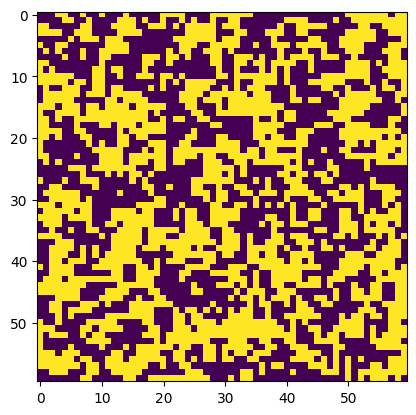

Evaluation 45 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 45: 205.98519325256348


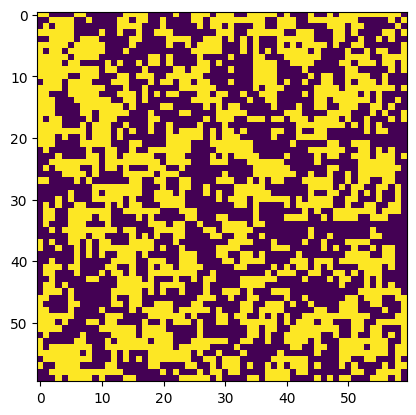

Evaluation 46 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 46: 205.72157263755798


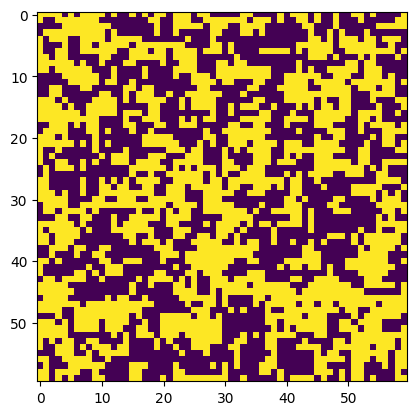

Evaluation 47 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:58<00:00,  8.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.34it/s]

Completed. Saving
Time (s) to complete simulation 47: 207.83597087860107


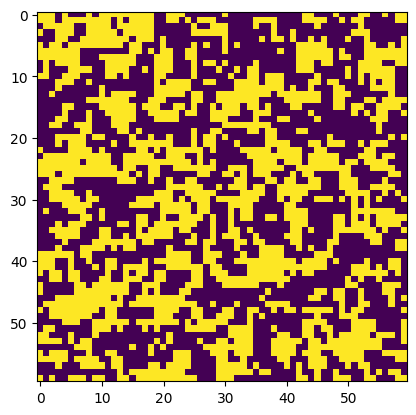

Evaluation 48 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 48: 205.89973831176758


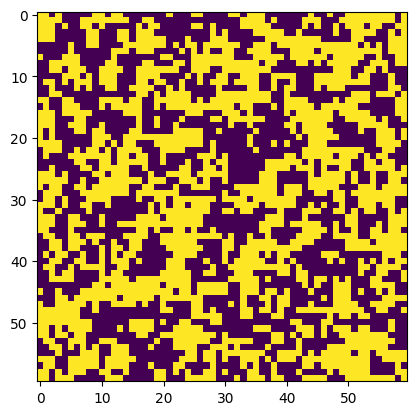

Evaluation 49 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.70it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 49: 205.20763182640076


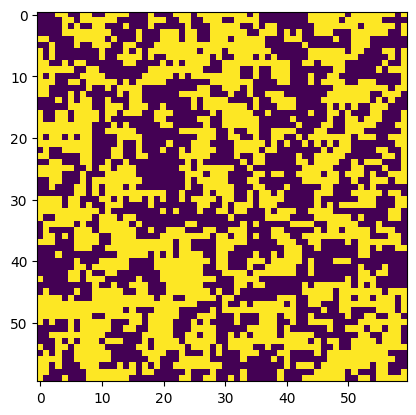

Evaluation 50 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 50: 204.5396752357483


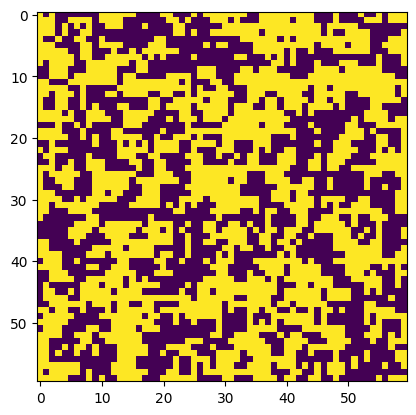

Evaluation 51 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:32<00:00,  3.29it/s]

Completed. Saving
Time (s) to complete simulation 51: 209.6895911693573


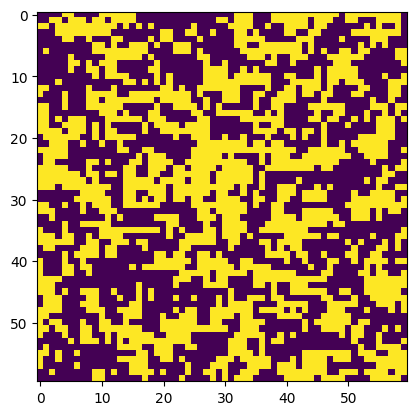

Evaluation 52 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 52: 204.85674786567688


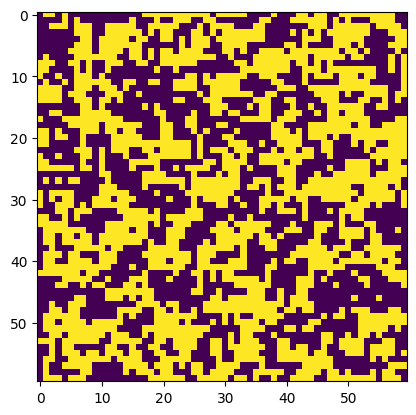

Evaluation 53 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 53: 205.74225306510925


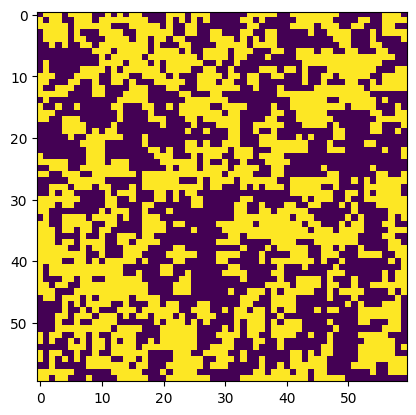

Evaluation 54 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 54: 205.0348801612854


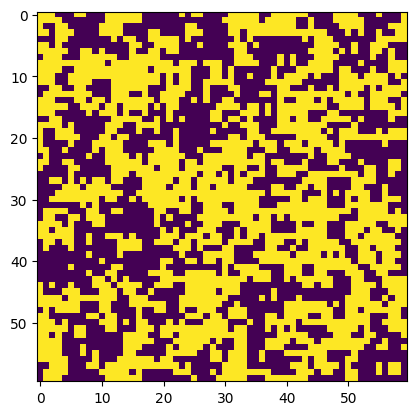

Evaluation 55 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.70it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 55: 205.24640560150146


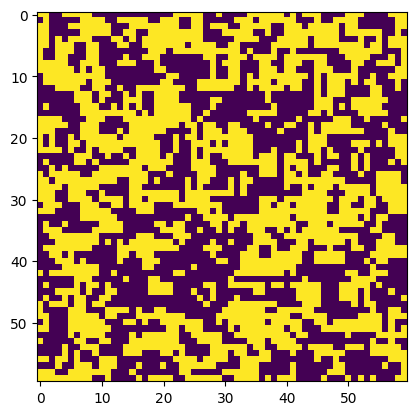

Evaluation 56 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 56: 205.74612069129944


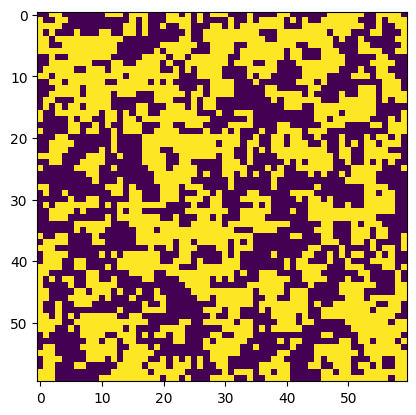

Evaluation 57 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 57: 205.68239378929138


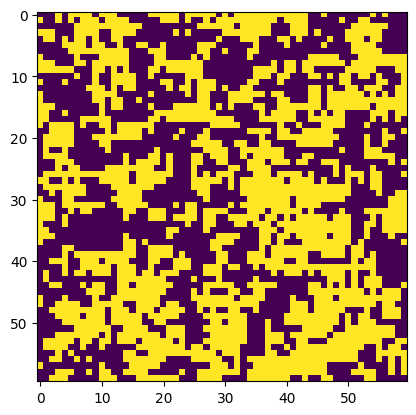

Evaluation 58 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 58: 205.56611895561218


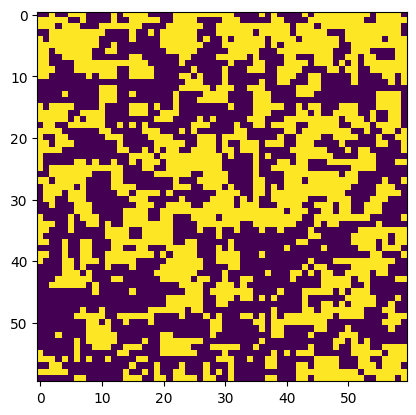

Evaluation 59 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 59: 205.81415605545044


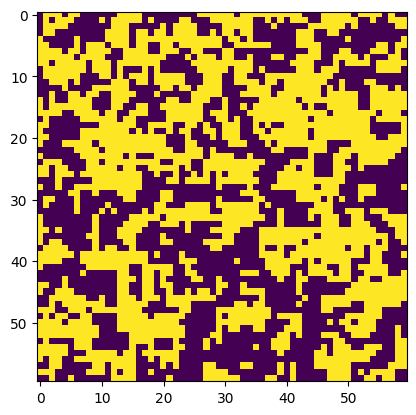

Evaluation 60 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 60: 204.8313479423523


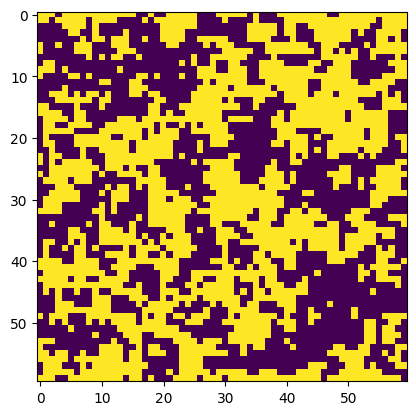

Evaluation 61 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.76it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 61: 204.1823697090149


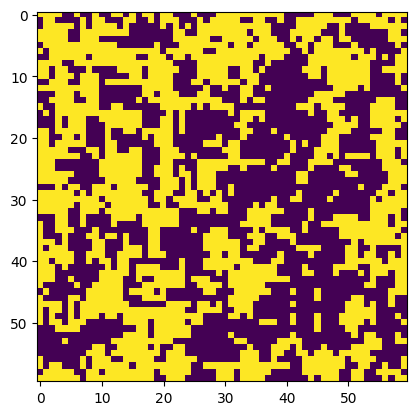

Evaluation 62 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:57<00:00,  8.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 62: 204.69037652015686


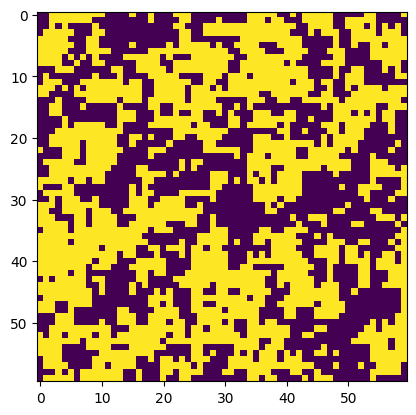

Evaluation 63 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.82it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 63: 204.24664545059204


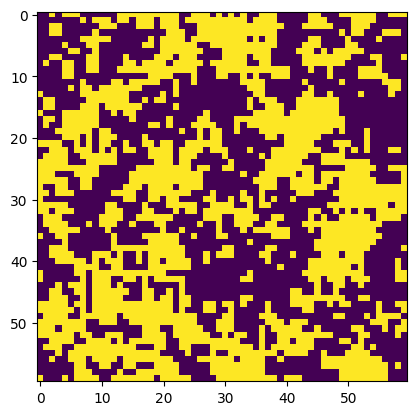

Evaluation 64 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 64: 203.60490679740906


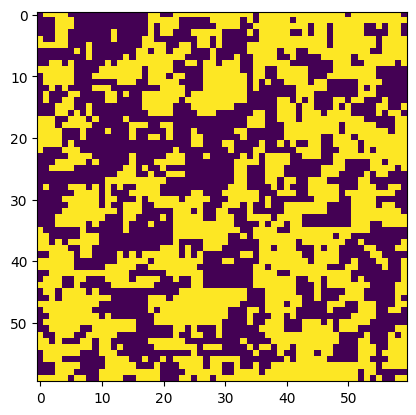

Evaluation 65 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 65: 203.9015519618988


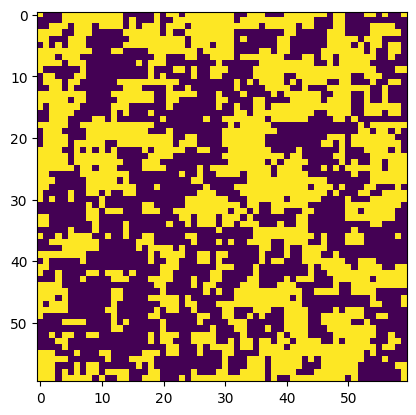

Evaluation 66 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 66: 202.20010352134705


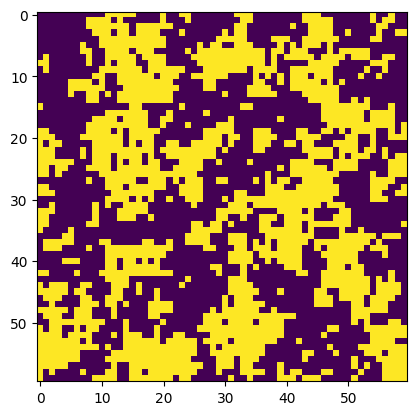

Evaluation 67 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 67: 203.72090649604797


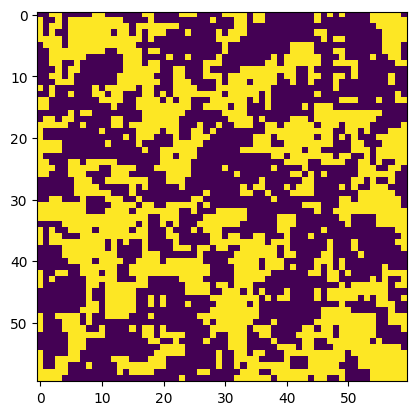

Evaluation 68 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.81it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 68: 203.12820959091187


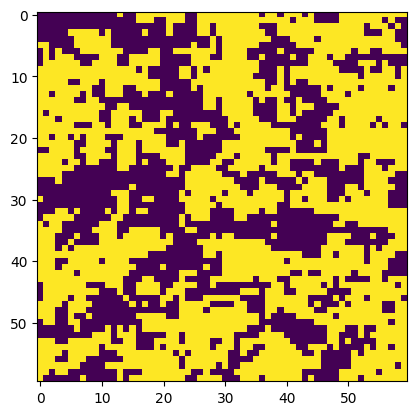

Evaluation 69 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.82it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 69: 203.89210724830627


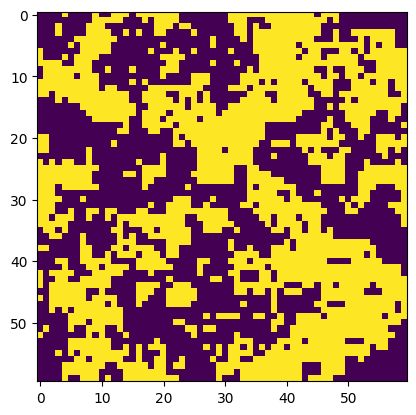

Evaluation 70 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 70: 202.42152547836304


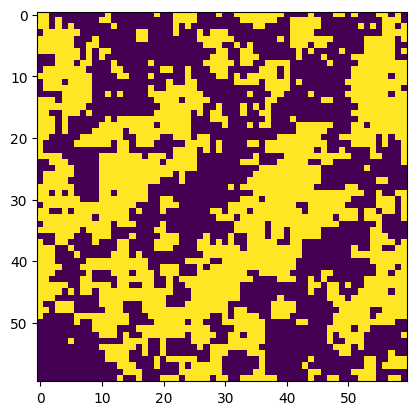

Evaluation 71 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 71: 202.36873078346252


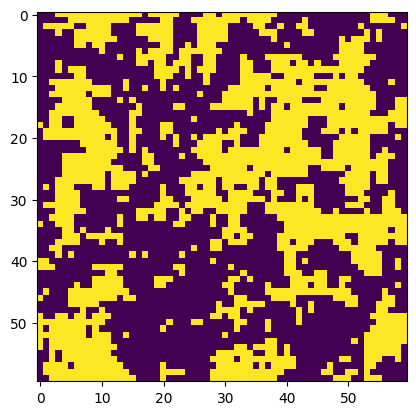

Evaluation 72 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 72: 202.52552914619446


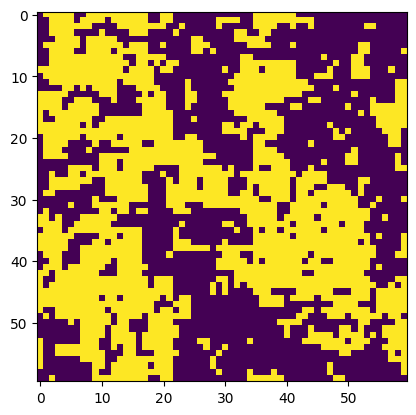

Evaluation 73 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 73: 202.84584736824036


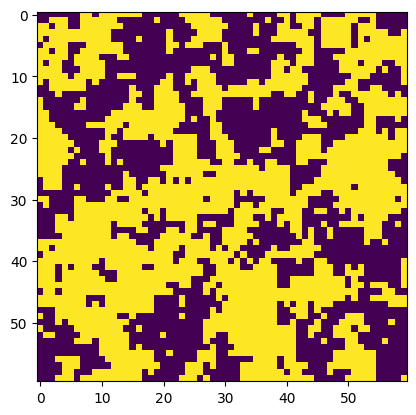

Evaluation 74 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]


Completed. Saving
Time (s) to complete simulation 74: 202.91670870780945


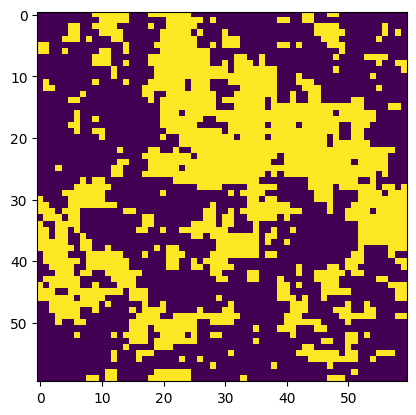

Evaluation 75 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 75: 202.71078252792358


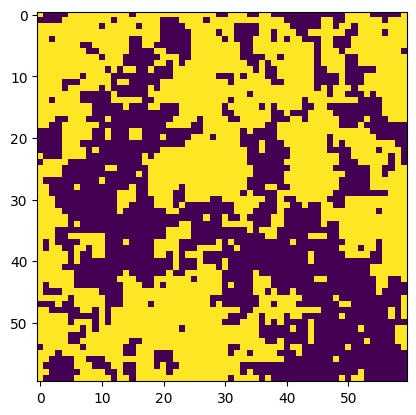

Evaluation 76 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 76: 203.29326343536377


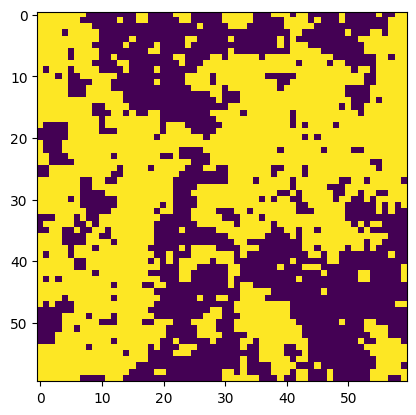

Evaluation 77 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 77: 204.0416202545166


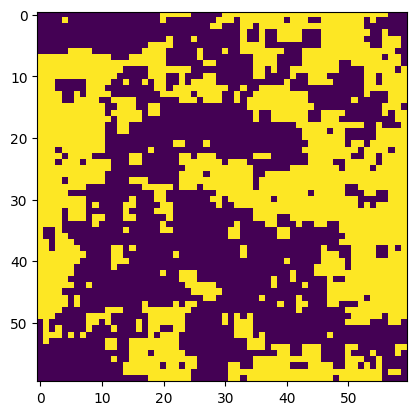

Evaluation 78 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 78: 202.9742887020111


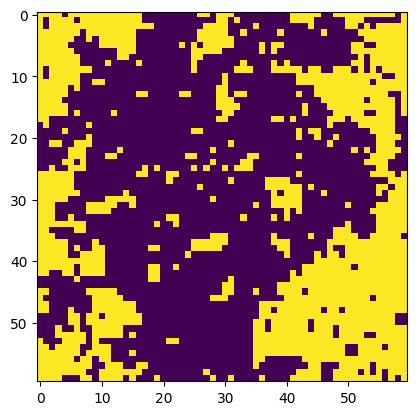

Evaluation 79 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 79: 204.2457103729248


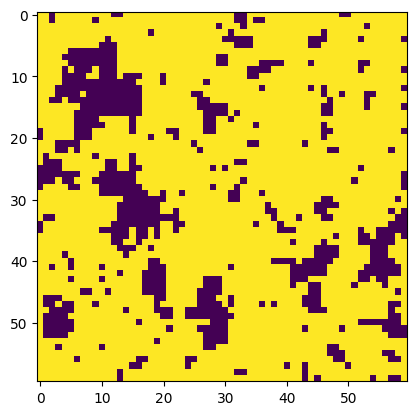

Evaluation 80 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 80: 204.09767603874207


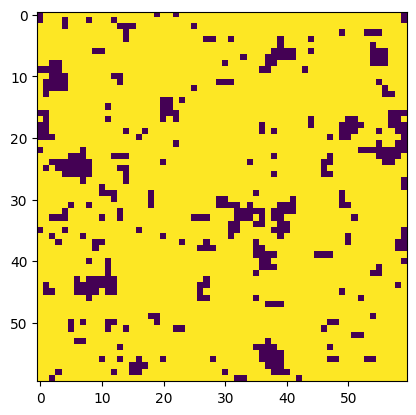

Evaluation 81 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.96it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 81: 201.47728157043457


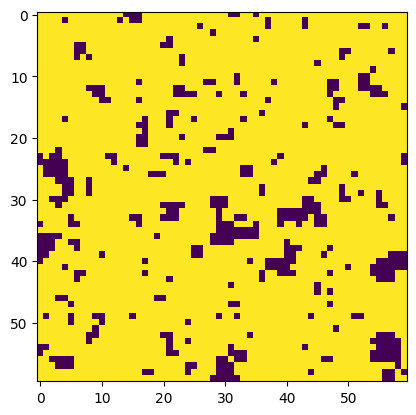

Evaluation 82 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 82: 201.5885832309723


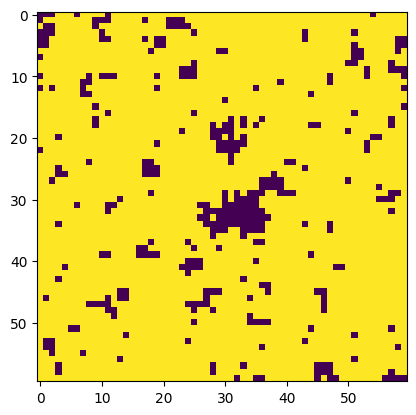

Evaluation 83 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 83: 200.7884452342987


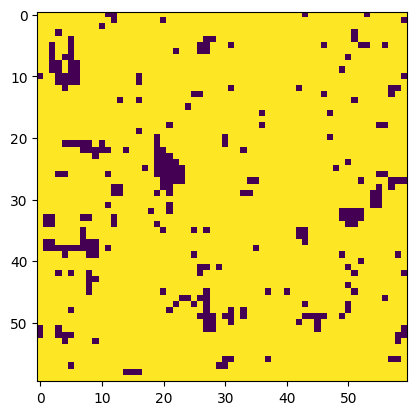

Evaluation 84 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 84: 201.54002785682678


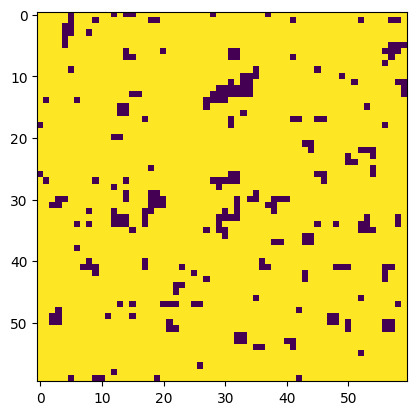

Evaluation 85 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 85: 202.025869846344


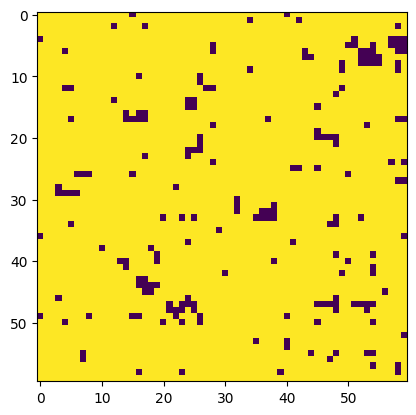

Evaluation 86 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 86: 201.73725748062134


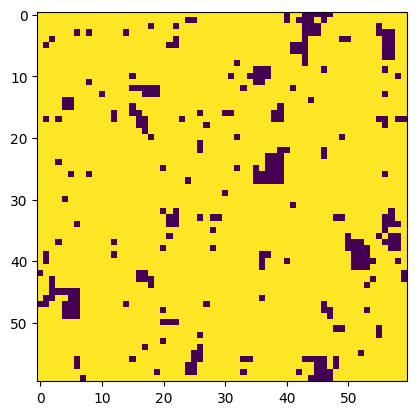

Evaluation 87 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 87: 201.30521845817566


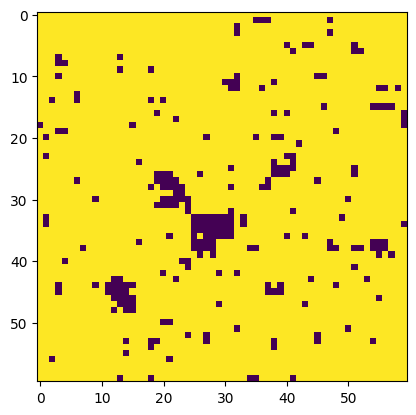

Evaluation 88 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 88: 201.63224959373474


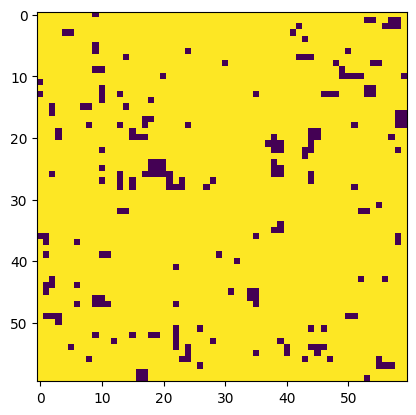

Evaluation 89 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 89: 200.5999984741211


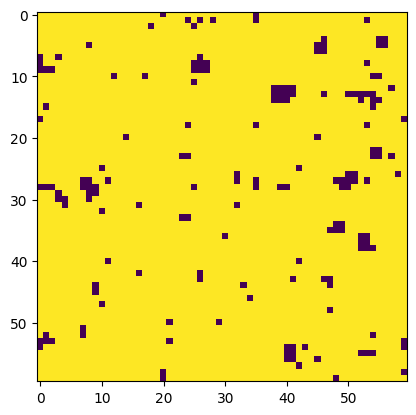

Evaluation 90 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 90: 201.39869141578674


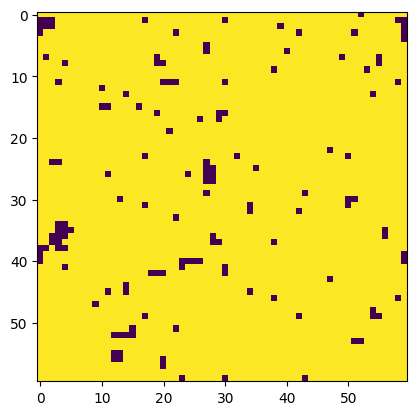

Evaluation 91 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 91: 201.26239466667175


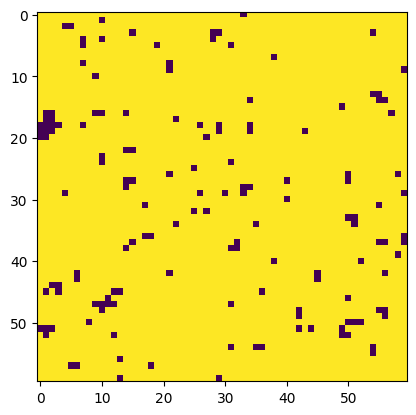

Evaluation 92 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 92: 201.09622740745544


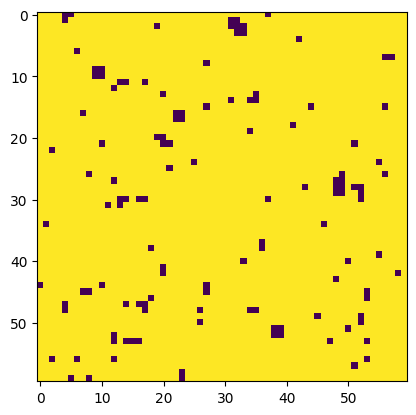

Evaluation 93 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 93: 202.14755606651306


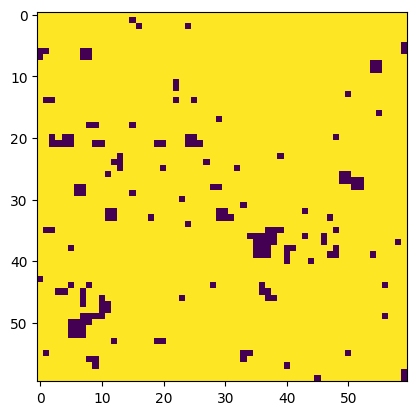

Evaluation 94 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 94: 201.25167798995972


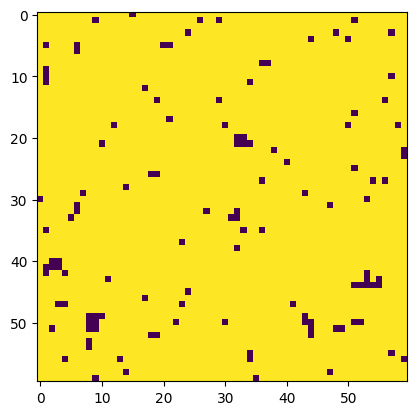

Evaluation 95 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 95: 200.78437495231628


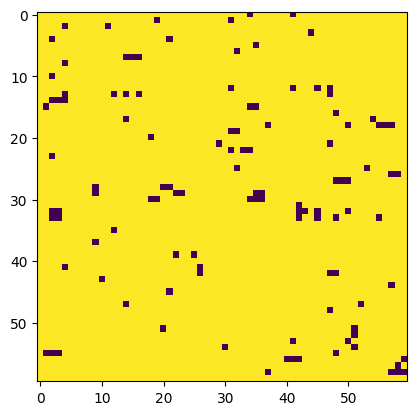

Evaluation 96 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 96: 199.9566731452942


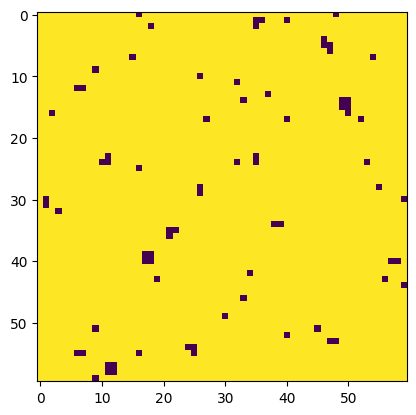

Evaluation 97 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 97: 200.0620822906494


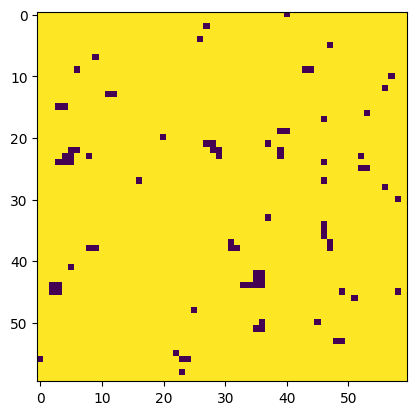

Evaluation 98 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 98: 199.54677176475525


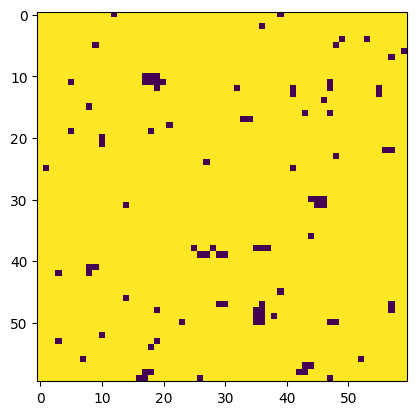

Evaluation 99 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 99: 200.79154539108276


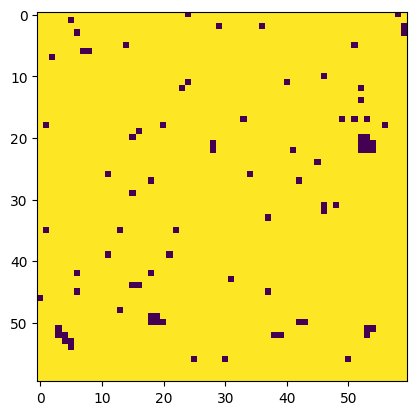

Evaluation 100 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 100: 202.04746842384338


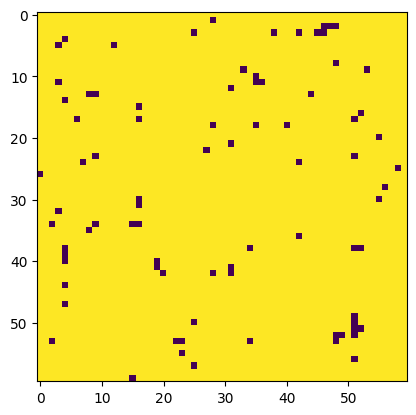

Evaluation 101 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.96it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 101: 202.0852451324463


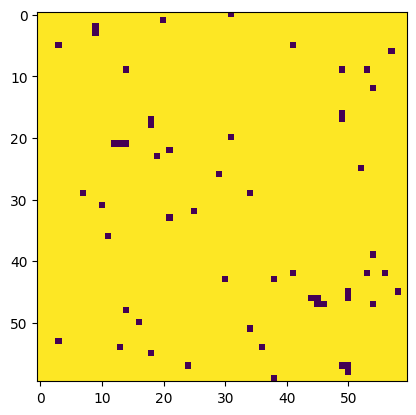

Evaluation 102 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 102: 200.54090070724487


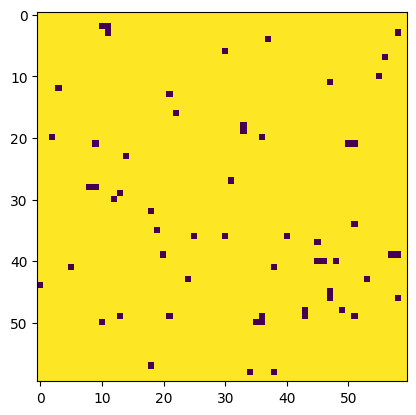

Evaluation 103 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 103: 202.14923071861267


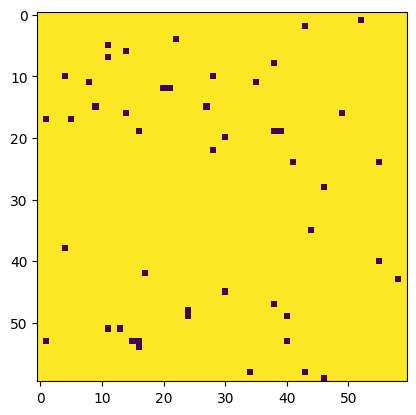

Evaluation 104 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 104: 203.50245428085327


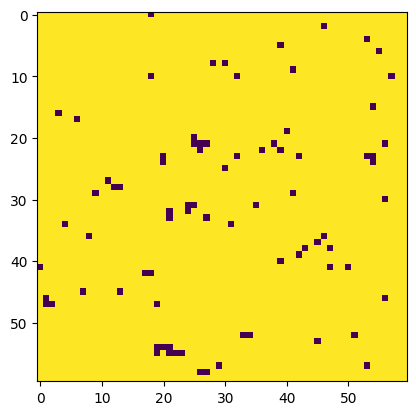

Evaluation 105 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 105: 201.94260358810425


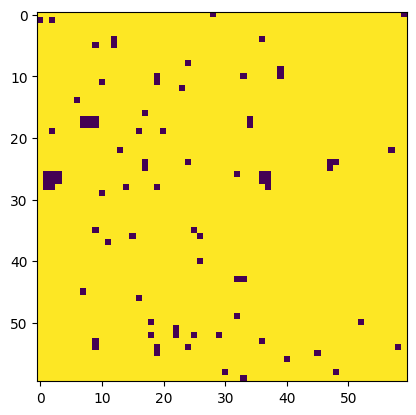

Evaluation 106 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 106: 201.30630111694336


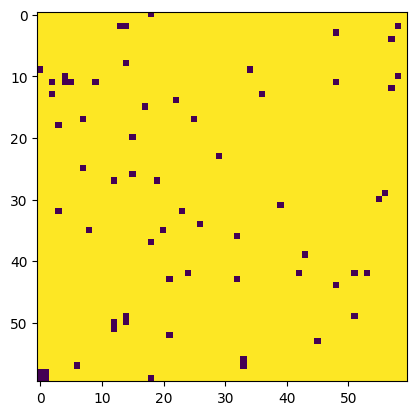

Evaluation 107 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.48it/s]

Completed. Saving
Time (s) to complete simulation 107: 198.42942667007446


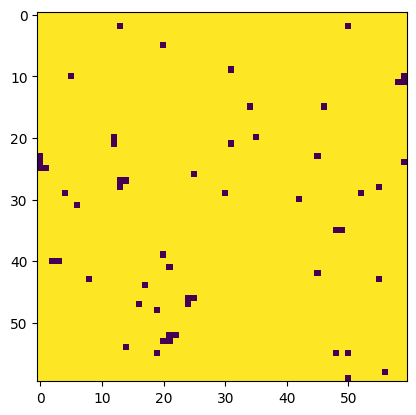

Evaluation 108 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 108: 200.7990801334381


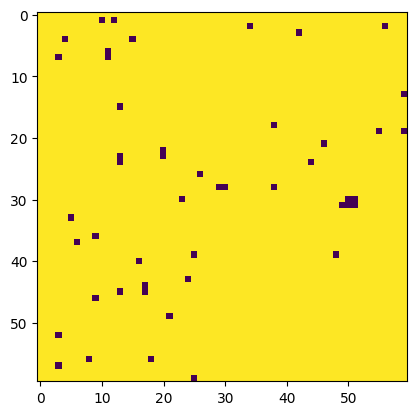

Evaluation 109 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 109: 199.04595613479614


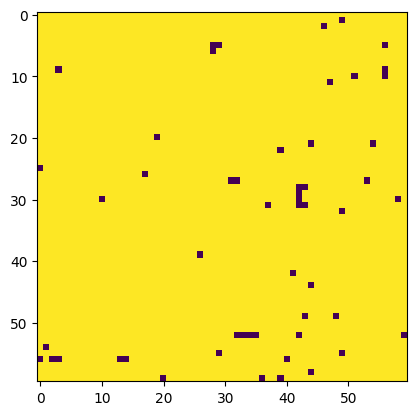

Evaluation 110 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]


Completed. Saving
Time (s) to complete simulation 110: 199.9544928073883


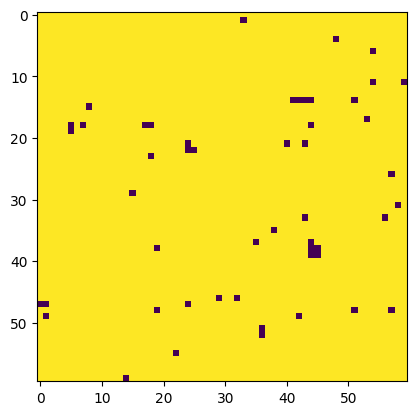

Evaluation 111 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 111: 200.09127354621887


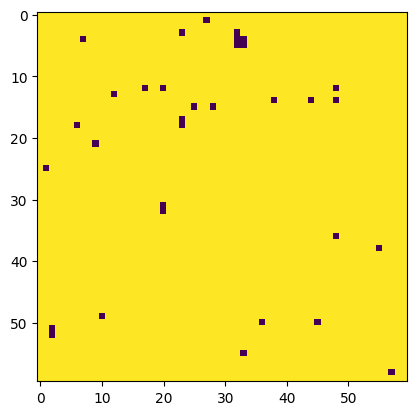

Evaluation 112 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 112: 200.16059470176697


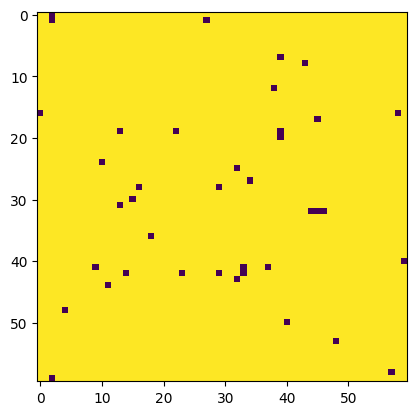

Evaluation 113 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 113: 200.2259876728058


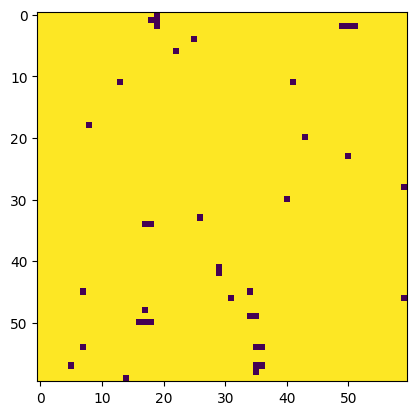

Evaluation 114 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 114: 199.74679708480835


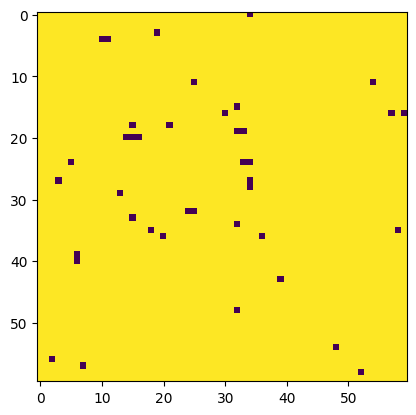

Evaluation 115 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 115: 200.8088936805725


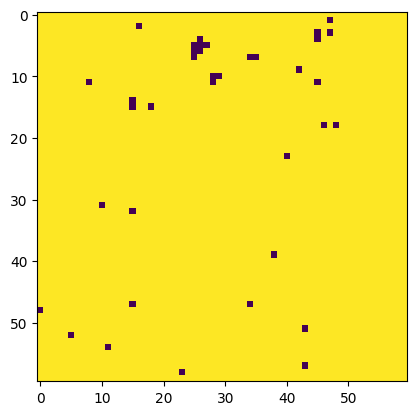

Evaluation 116 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 116: 199.20928740501404


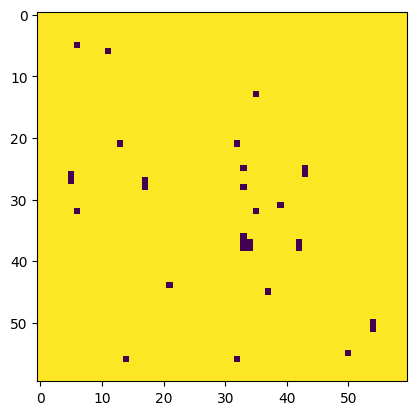

Evaluation 117 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 117: 199.64545440673828


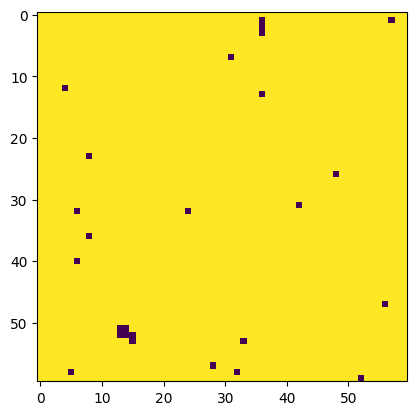

Evaluation 118 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 118: 199.21262073516846


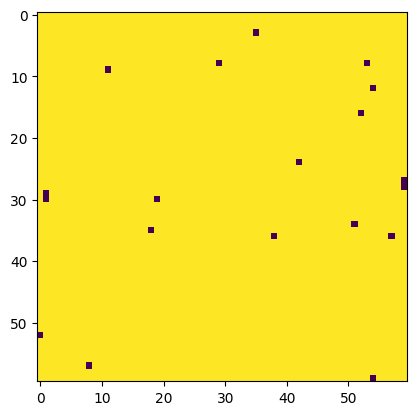

Evaluation 119 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 119: 198.6698398590088


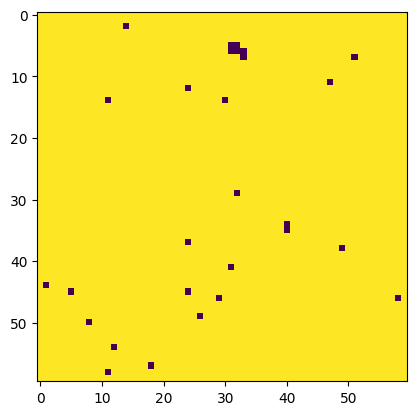

Evaluation 120 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 120: 199.11773657798767


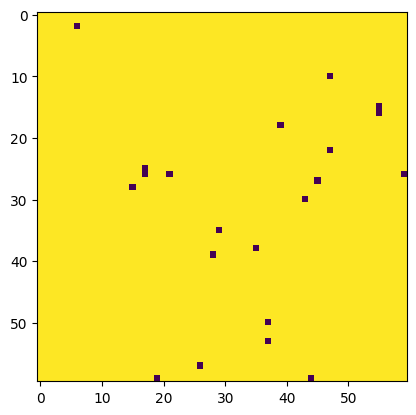

Evaluation 121 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 121: 198.97933888435364


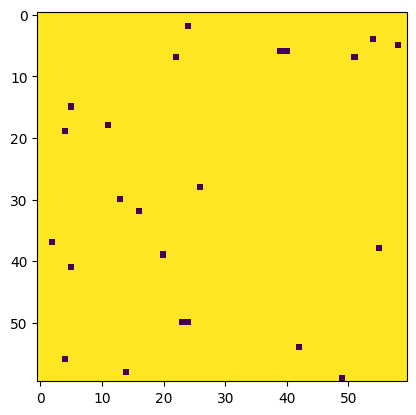

Evaluation 122 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 122: 201.49561548233032


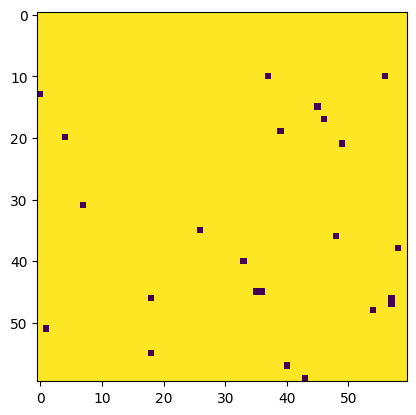

Evaluation 123 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 123: 198.51879262924194


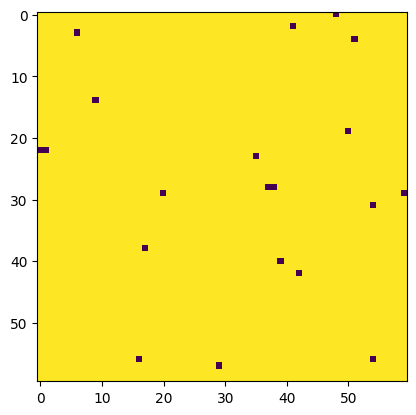

Evaluation 124 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 124: 198.91213726997375


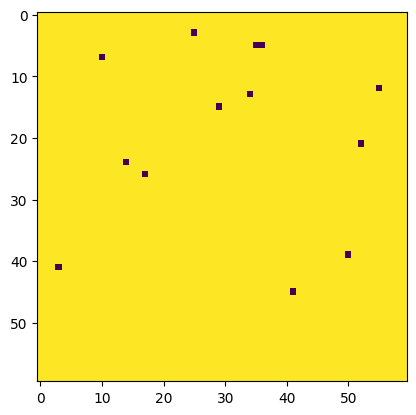

Evaluation 125 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 125: 199.01502180099487


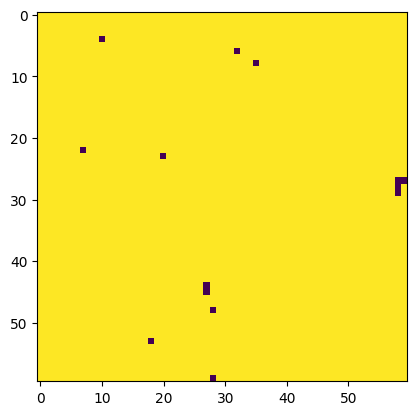

Evaluation 126 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 126: 199.43804287910461


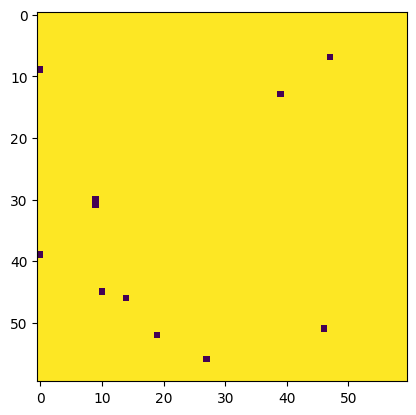

Evaluation 127 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 127: 199.4447193145752


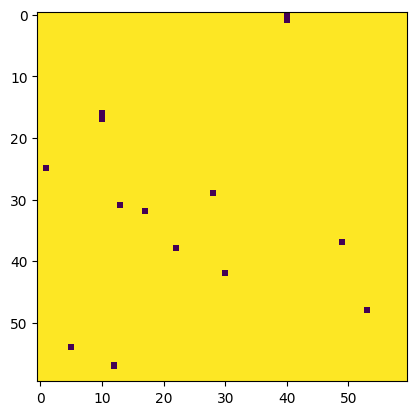

Evaluation 128 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.49it/s]

Completed. Saving
Time (s) to complete simulation 128: 198.3200569152832


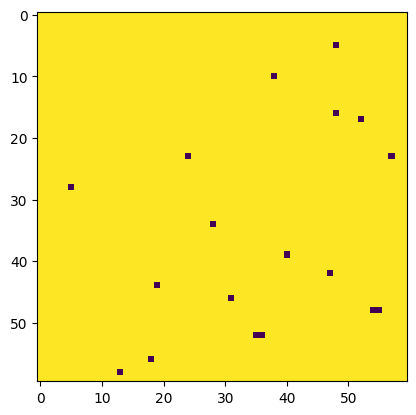

Evaluation 129 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.48it/s]

Completed. Saving
Time (s) to complete simulation 129: 199.02501249313354


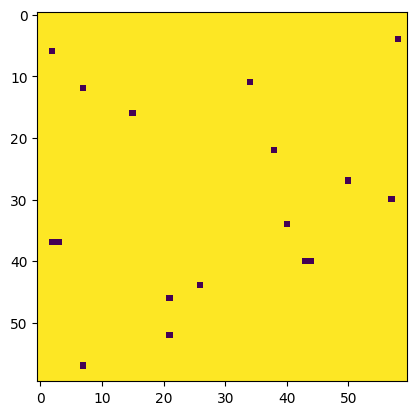

Evaluation 130 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 130: 199.61838293075562


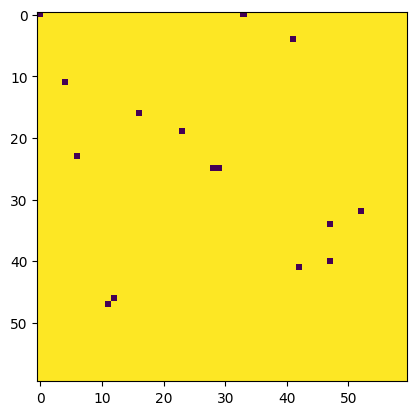

Evaluation 131 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 131: 200.05844521522522


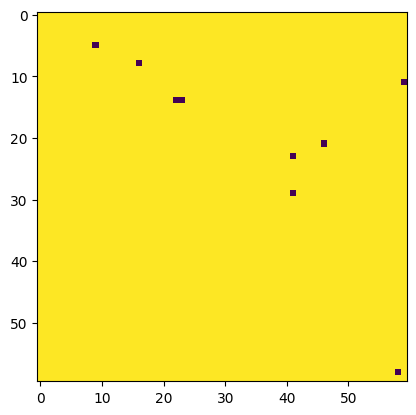

Evaluation 132 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 132: 199.18188095092773


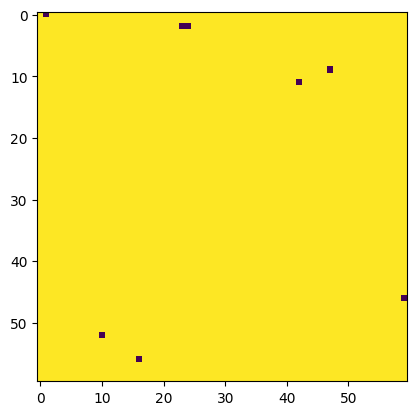

Evaluation 133 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 133: 199.0978934764862


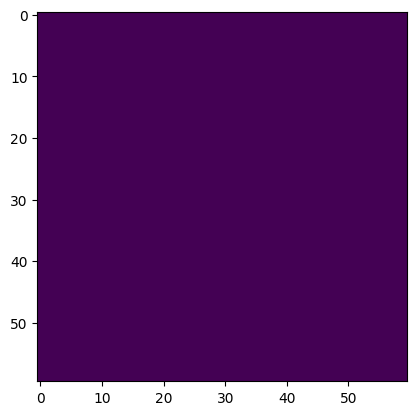

Evaluation 134 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 134: 199.46359586715698


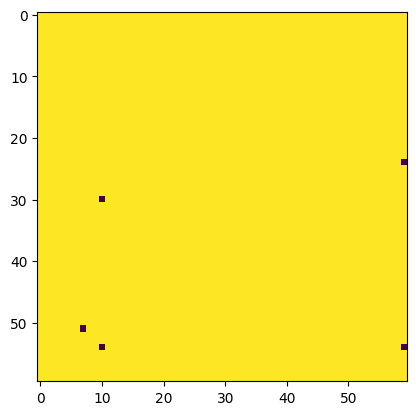

Evaluation 135 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.49it/s]

Completed. Saving
Time (s) to complete simulation 135: 197.61712741851807


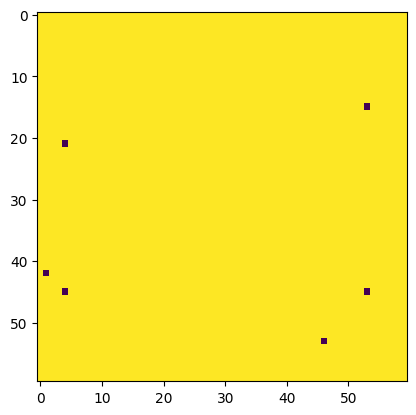

Evaluation 136 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 136: 200.47618436813354


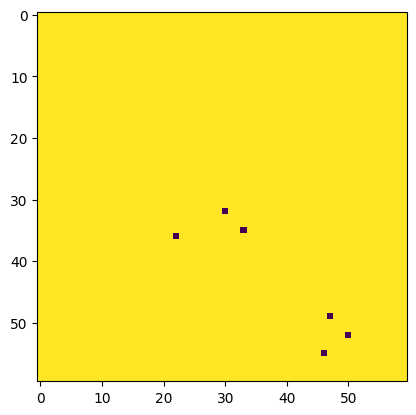

Evaluation 137 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 137: 205.0763337612152


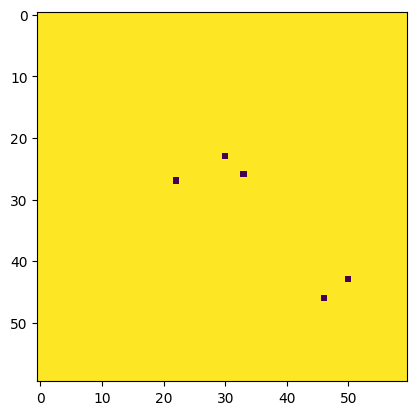

Evaluation 138 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 138: 203.14630222320557


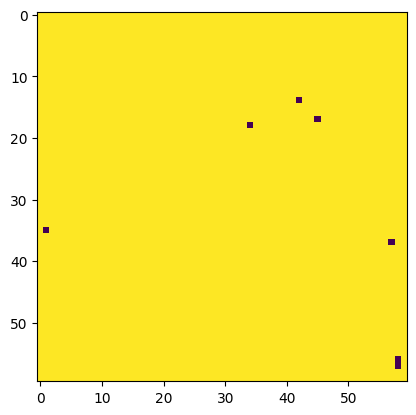

Evaluation 139 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.37it/s]

Completed. Saving
Time (s) to complete simulation 139: 204.73453402519226


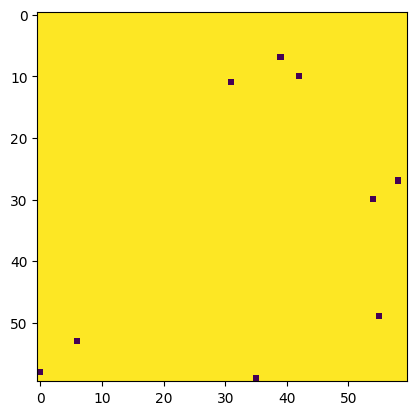

Evaluation 140 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 140: 205.73538541793823


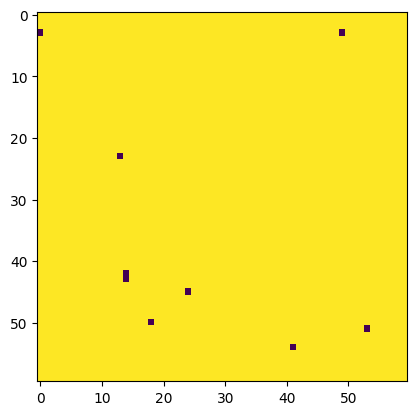

Evaluation 141 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 141: 202.413019657135


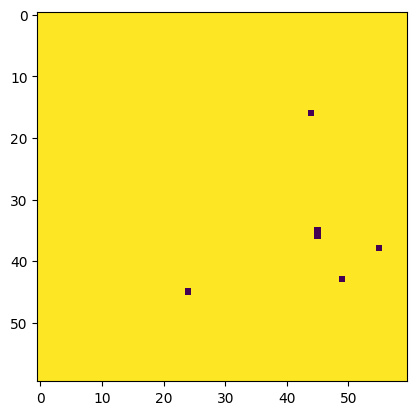

Evaluation 142 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 142: 199.68244314193726


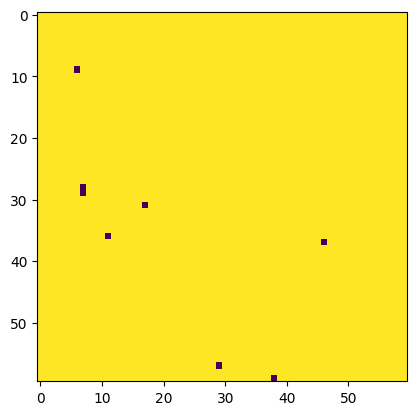

Evaluation 143 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 143: 199.93357229232788


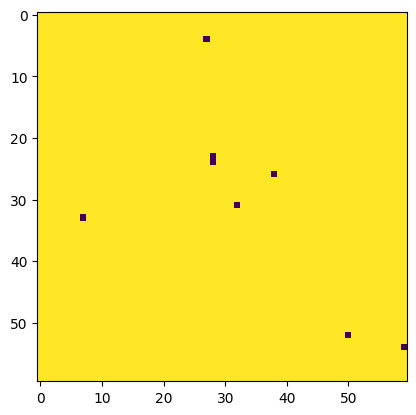

Evaluation 144 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 144: 199.87137007713318


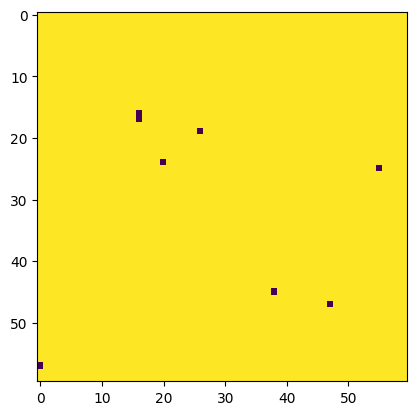

Evaluation 145 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.48it/s]


Completed. Saving
Time (s) to complete simulation 145: 198.74119067192078


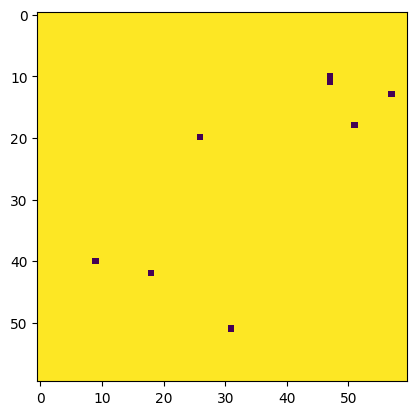

Evaluation 146 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 146: 201.01283955574036


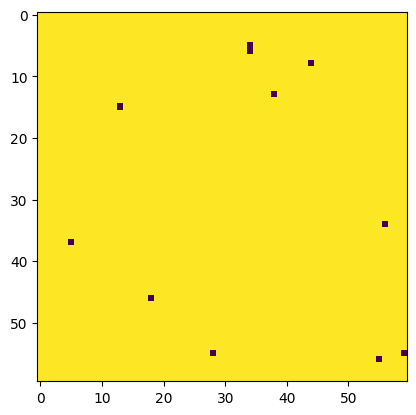

Evaluation 147 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 147: 199.95283770561218


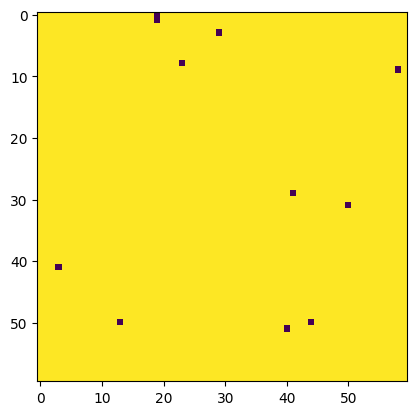

Evaluation 148 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 148: 199.76974964141846


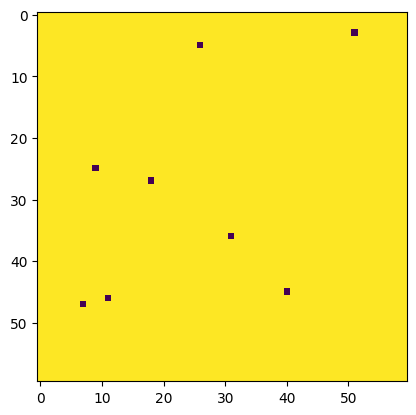

Evaluation 149 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 149: 200.14158535003662


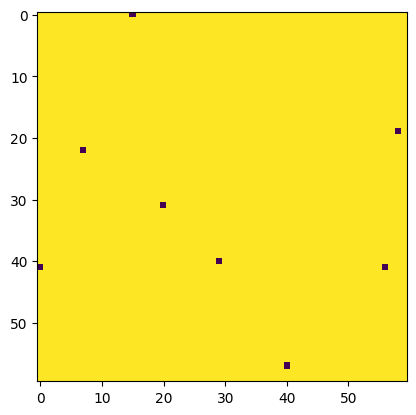

Evaluation 150 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 150: 200.784348487854


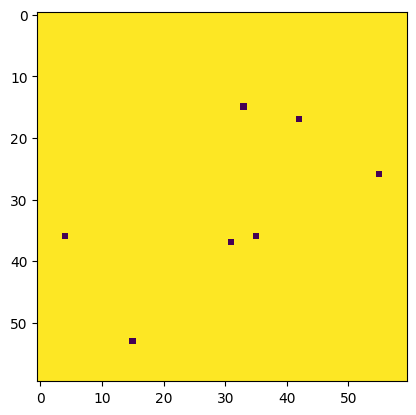

Evaluation 151 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 151: 201.0609152317047


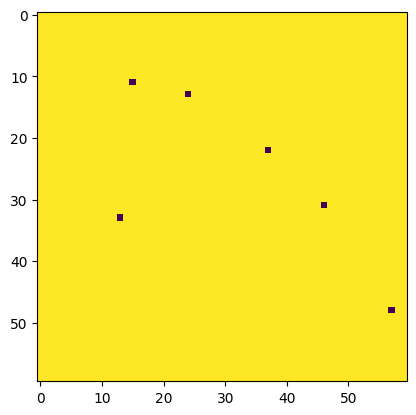

Evaluation 152 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 152: 199.62210536003113


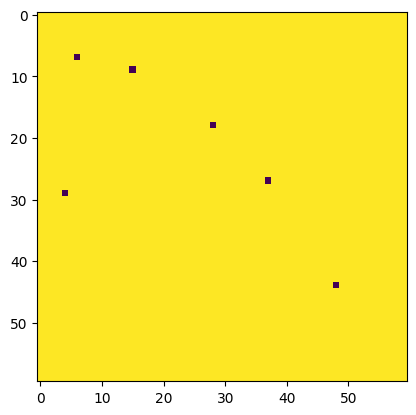

Evaluation 153 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 153: 199.8574423789978


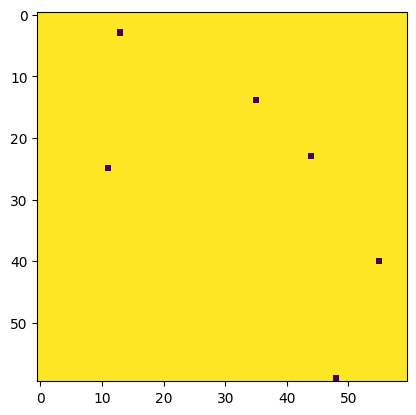

Evaluation 154 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 154: 199.23838686943054


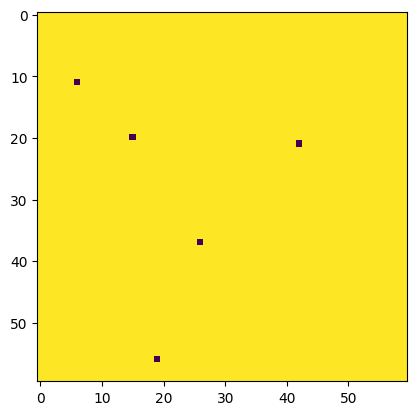

Evaluation 155 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.48it/s]

Completed. Saving
Time (s) to complete simulation 155: 198.77406930923462


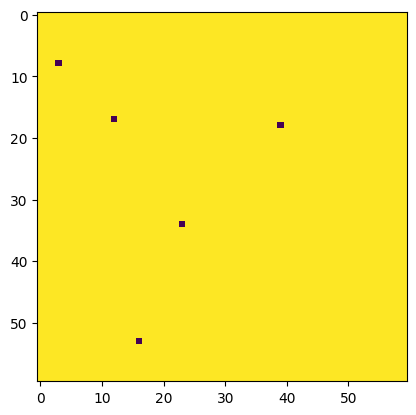

Evaluation 156 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 156: 199.9555058479309


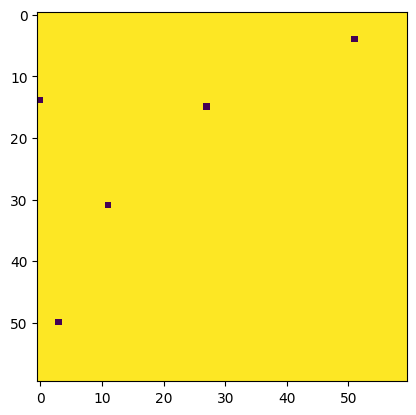

Evaluation 157 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 157: 200.2417151927948


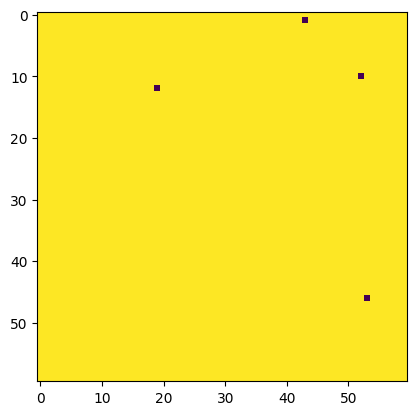

Evaluation 158 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 158: 199.92331433296204


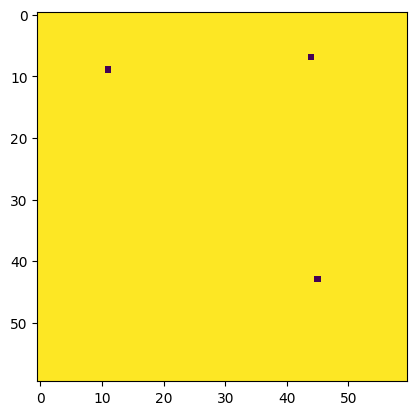

Evaluation 159 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 159: 200.07495546340942


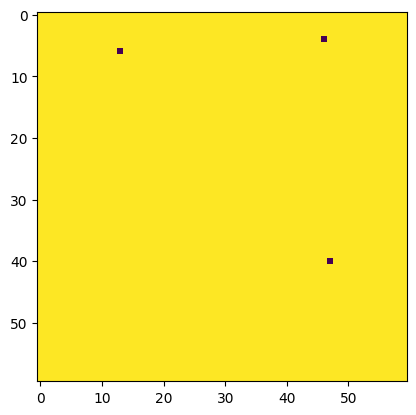

Evaluation 160 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 160: 200.1087327003479


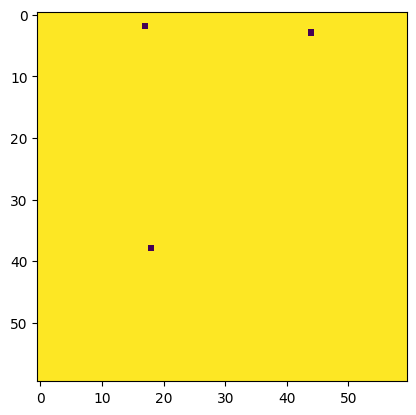

Evaluation 161 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 161: 199.93599677085876


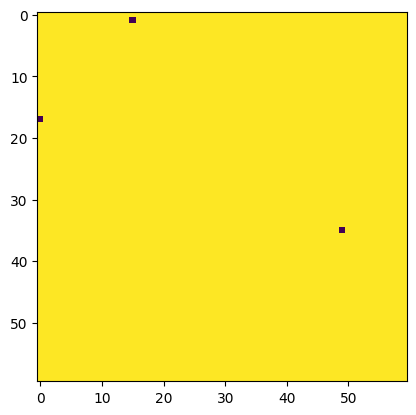

Evaluation 162 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 162: 199.248957157135


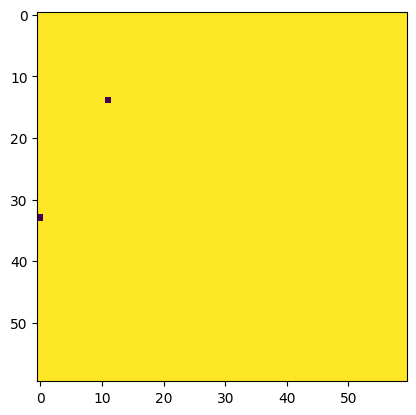

Evaluation 163 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 163: 199.7204475402832


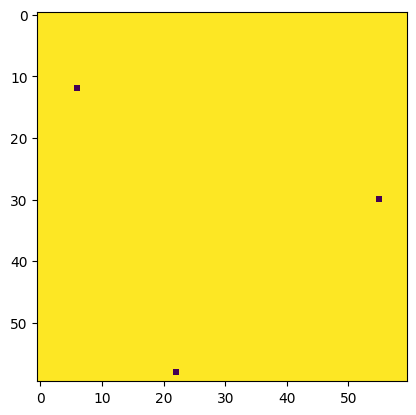

Evaluation 164 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 164: 200.13785529136658


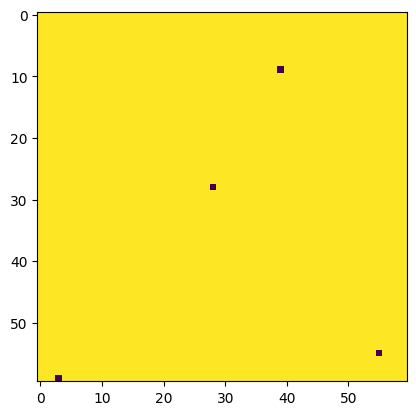

Evaluation 165 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 165: 200.4490041732788


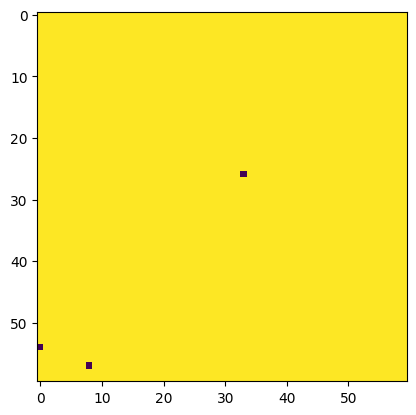

Evaluation 166 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 166: 200.0911774635315


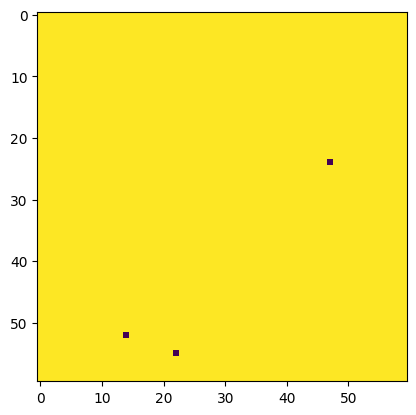

Evaluation 167 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 167: 200.04641485214233


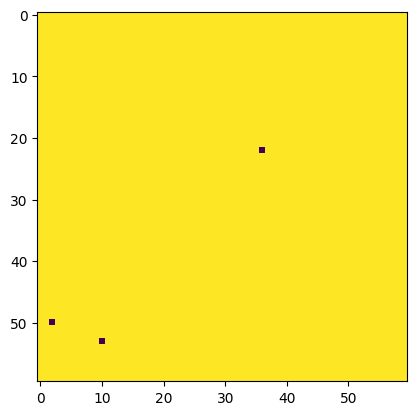

Evaluation 168 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 168: 200.1633222103119


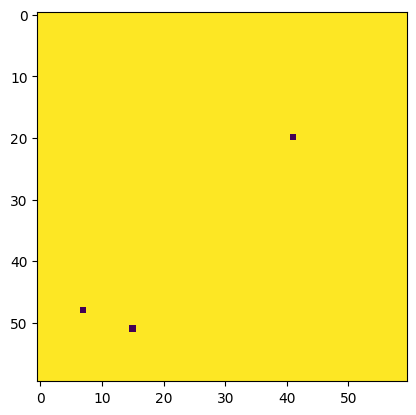

Evaluation 169 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 169: 201.15046906471252


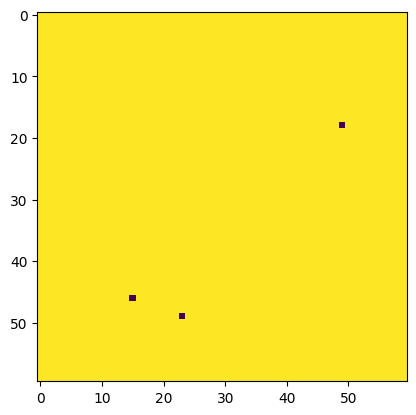

Evaluation 170 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 170: 199.16732740402222


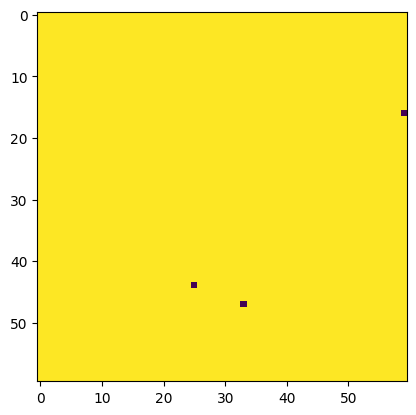

Evaluation 171 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 171: 199.85086226463318


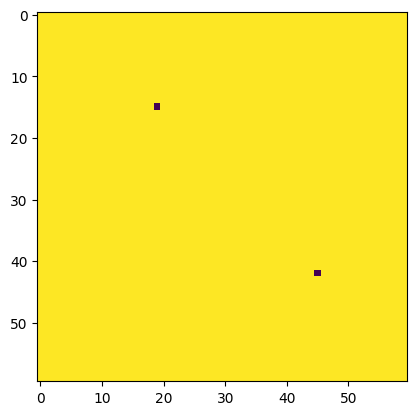

Evaluation 172 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 172: 199.43224096298218


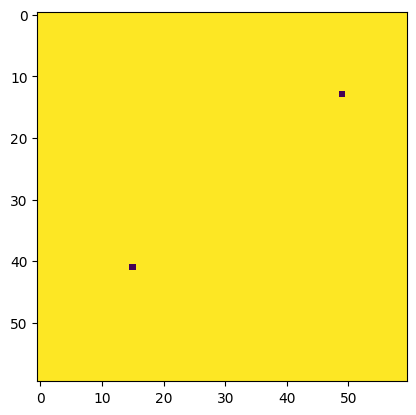

Evaluation 173 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 173: 198.58618354797363


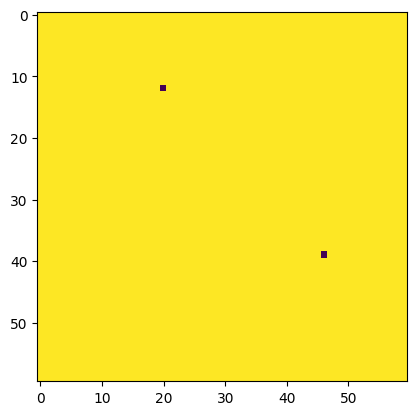

Evaluation 174 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.47it/s]

Completed. Saving
Time (s) to complete simulation 174: 198.55692291259766


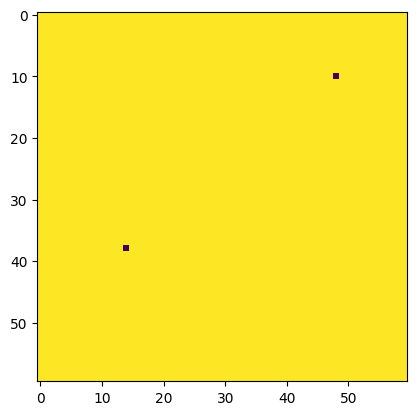

Evaluation 175 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:23<00:00,  3.48it/s]

Completed. Saving
Time (s) to complete simulation 175: 198.81482934951782


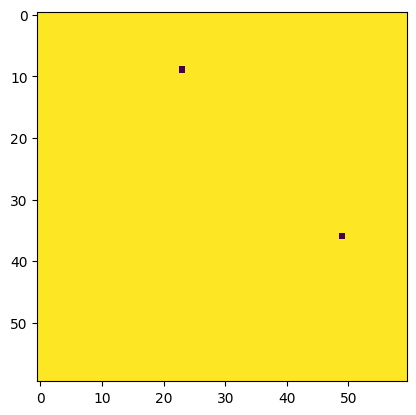

Evaluation 176 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 176: 201.85379719734192


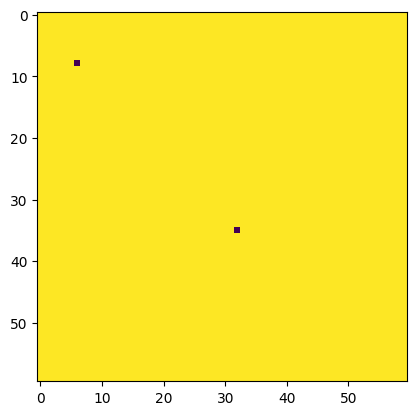

Evaluation 177 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 177: 201.69512677192688


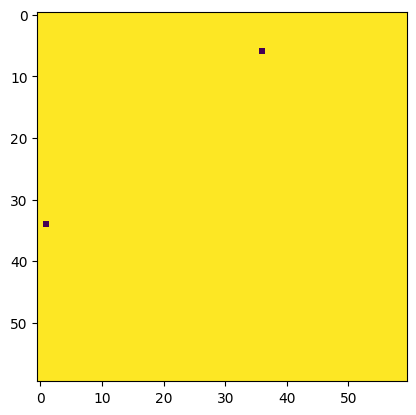

Evaluation 178 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 178: 202.20370244979858


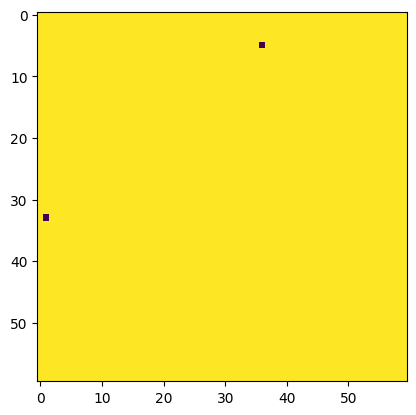

Evaluation 179 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 179: 201.4861159324646


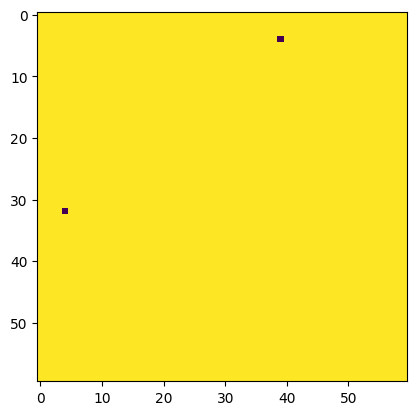

Evaluation 180 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 180: 201.85689425468445


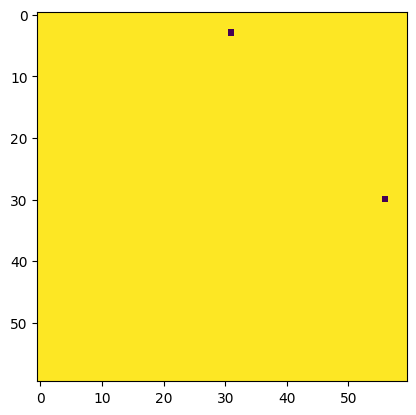

Evaluation 181 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]


Completed. Saving
Time (s) to complete simulation 181: 201.38928818702698


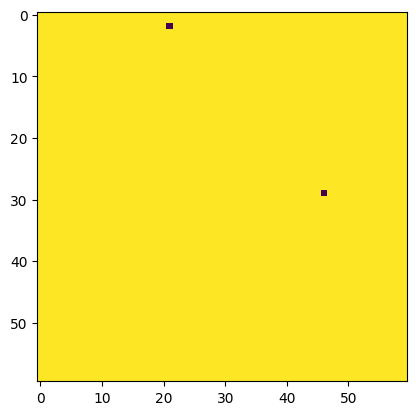

Evaluation 182 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.40it/s]

Completed. Saving
Time (s) to complete simulation 182: 203.120374917984


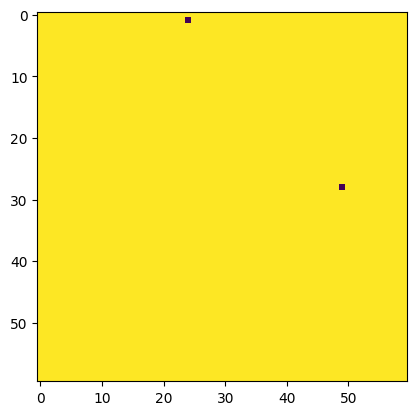

Evaluation 183 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.38it/s]

Completed. Saving
Time (s) to complete simulation 183: 204.15891337394714


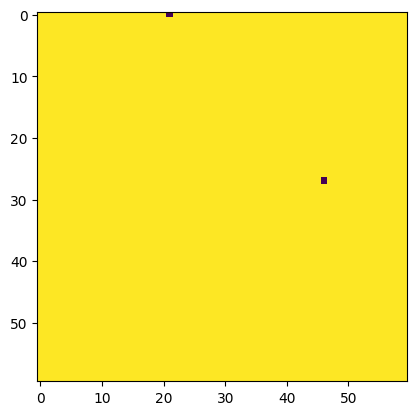

Evaluation 184 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:27<00:00,  3.39it/s]

Completed. Saving
Time (s) to complete simulation 184: 203.67359590530396


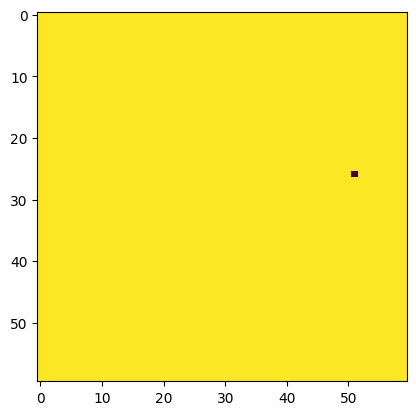

Evaluation 185 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 185: 202.55097651481628


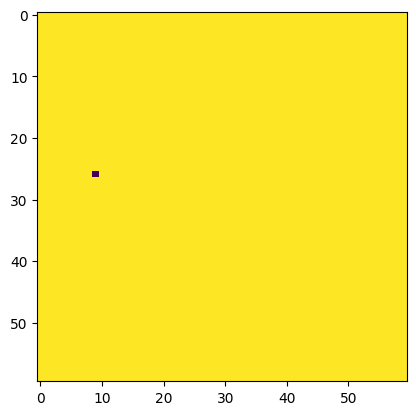

Evaluation 186 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 186: 203.0358374118805


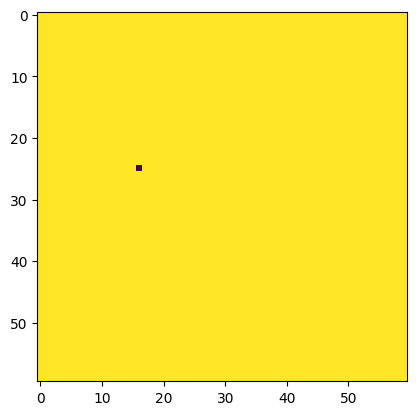

Evaluation 187 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.41it/s]

Completed. Saving
Time (s) to complete simulation 187: 202.8266613483429


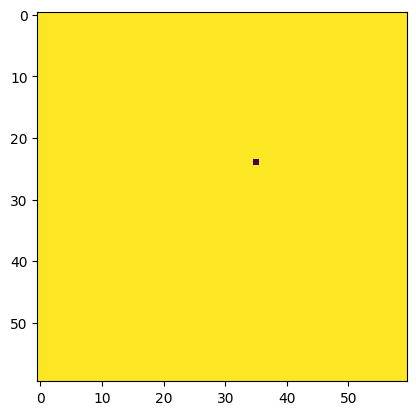

Evaluation 188 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 188: 201.661860704422


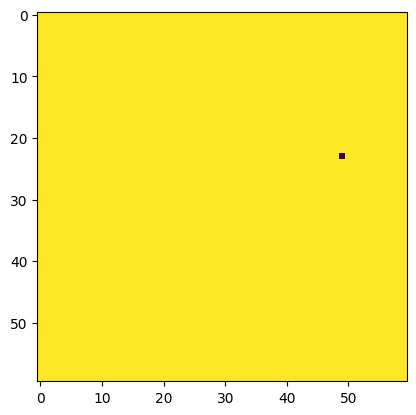

Evaluation 189 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 189: 201.61010336875916


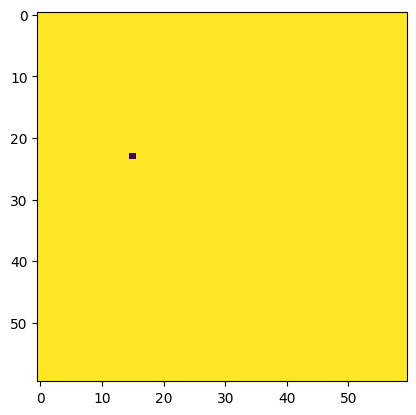

Evaluation 190 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 190: 200.62529492378235


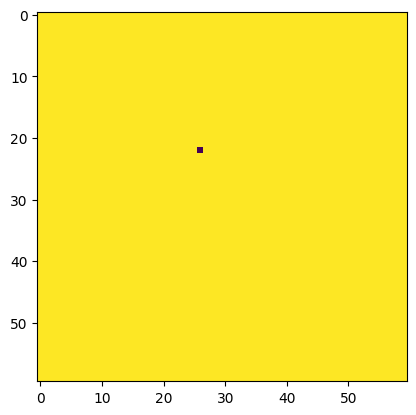

Evaluation 191 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:54<00:00,  9.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:28<00:00,  3.36it/s]

Completed. Saving
Time (s) to complete simulation 191: 203.57179141044617


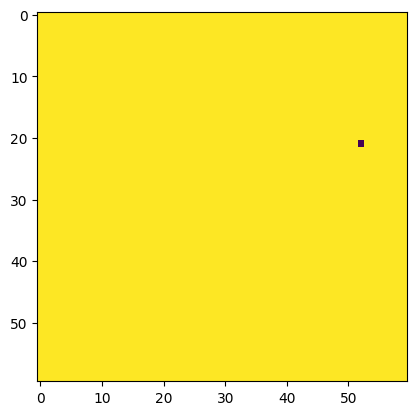

Evaluation 192 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 192: 199.76039457321167


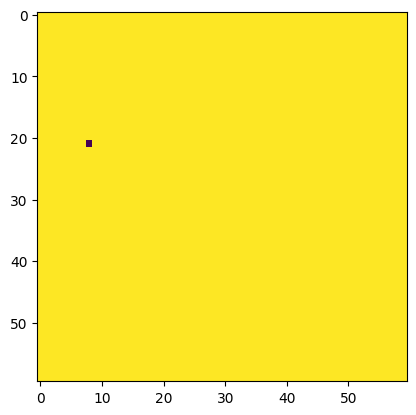

Evaluation 193 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  8.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 193: 200.66806983947754


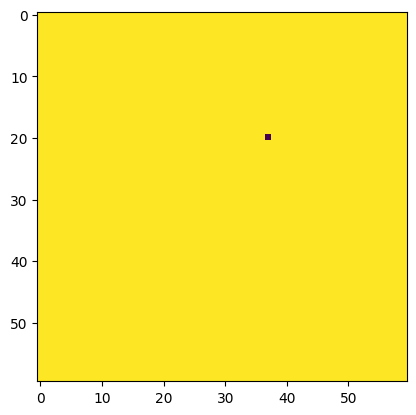

Evaluation 194 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 194: 200.43252420425415


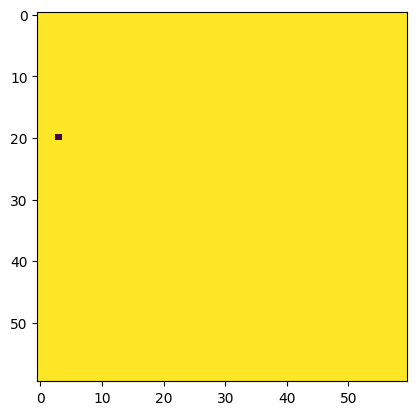

Evaluation 195 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 195: 200.8791582584381


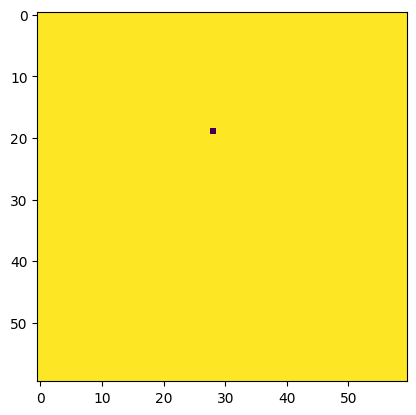

Evaluation 196 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.46it/s]

Completed. Saving
Time (s) to complete simulation 196: 199.95218062400818


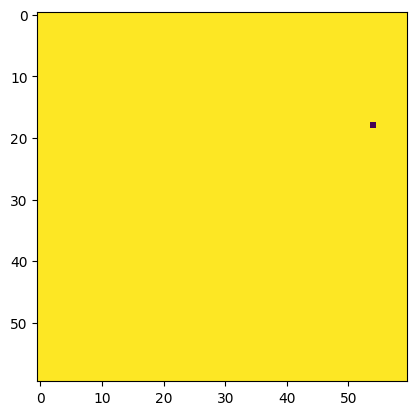

Evaluation 197 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 197: 201.81009602546692


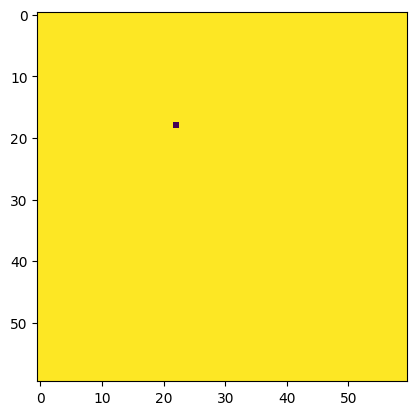

Evaluation 198 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:24<00:00,  3.45it/s]

Completed. Saving
Time (s) to complete simulation 198: 200.14433479309082


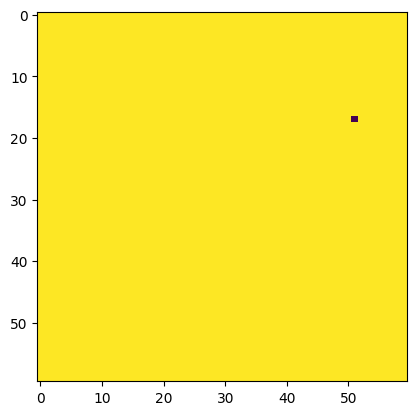

Evaluation 199 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.44it/s]

Completed. Saving
Time (s) to complete simulation 199: 200.66972541809082


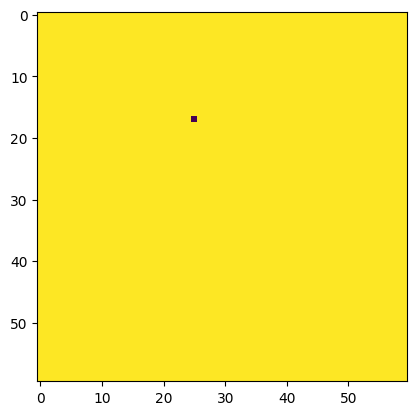

Evaluation 200 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:26<00:00,  3.42it/s]

Completed. Saving
Time (s) to complete simulation 200: 201.04526925086975


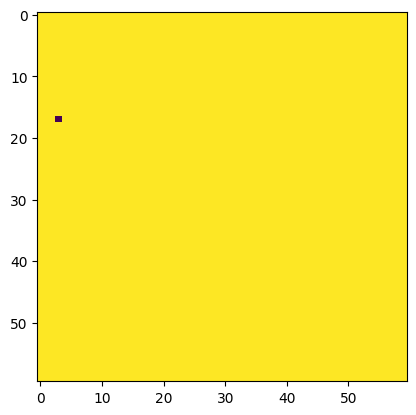

Evaluation 201 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:55<00:00,  9.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:25<00:00,  3.43it/s]

Completed. Saving
Time (s) to complete simulation 201: 200.96201705932617


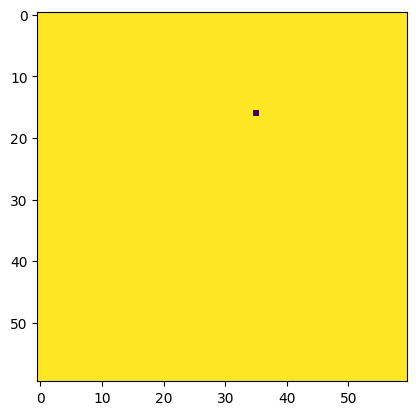

In [ ]:
lb = 0
ub = 3
N_total = 201

Jx = xs
results_dict_high = {}
ys_60 = np.zeros(xs.shape[0])
time_eval = np.zeros(xs.shape[0])
for i in range(0, Jx.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(N_total))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(time_eval[i]))
    results_dict_high[i] = {'sim': sq_sim.results,}
    ys_60[i] = results_dict_high[i]['sim']['SpecificHeat']
    plt.imshow(results_dict_high[i]['sim']['config'][-1])
    plt.show()

    np.save("results_dict_sq_60.npy", results_dict_high)

Estimating noise from the model by running 20 LF simulation at the low fidelity highest heat capacity region.

We know the noise is highest near the phase transition region

Evaluation 1 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 26.76it/s]


Completed. Saving
Time (s) to complete simulation 1: 25.895331382751465


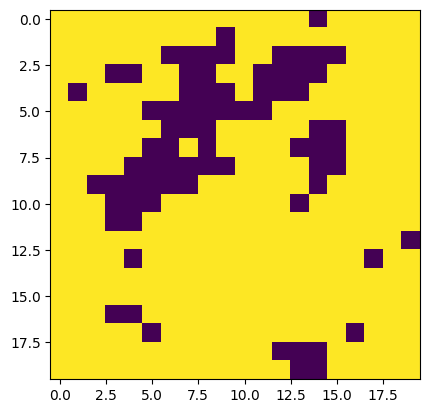

Evaluation 2 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.68it/s]


Completed. Saving
Time (s) to complete simulation 2: 24.893900394439697


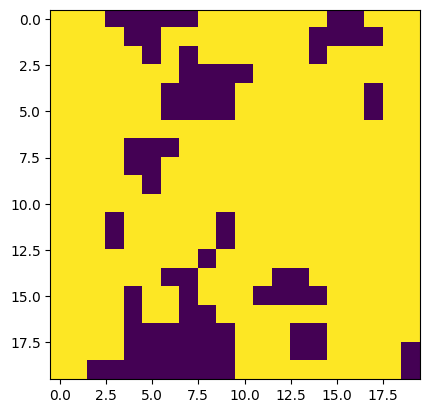

Evaluation 3 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.35it/s]


Completed. Saving
Time (s) to complete simulation 3: 24.437016010284424


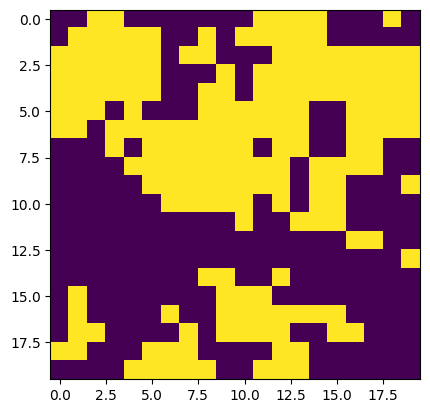

Evaluation 4 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.68it/s]


Completed. Saving
Time (s) to complete simulation 4: 24.00292134284973


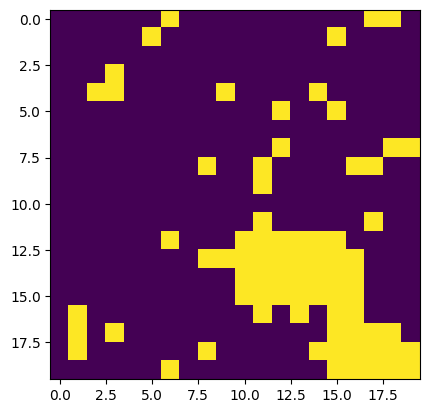

Evaluation 5 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.08it/s]


Completed. Saving
Time (s) to complete simulation 5: 23.6957004070282


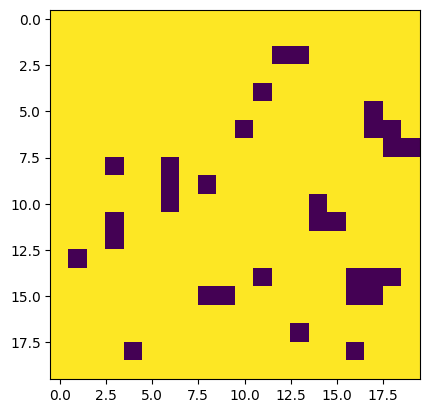

Evaluation 6 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.81it/s]


Completed. Saving
Time (s) to complete simulation 6: 23.806986331939697


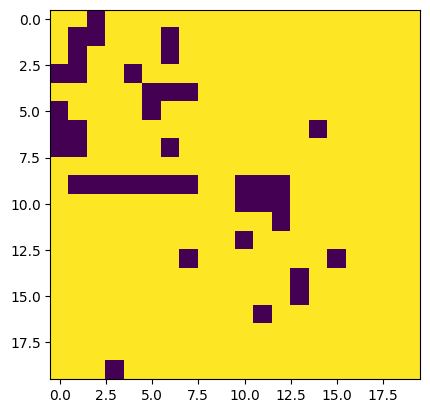

Evaluation 7 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.84it/s]


Completed. Saving
Time (s) to complete simulation 7: 23.795691967010498


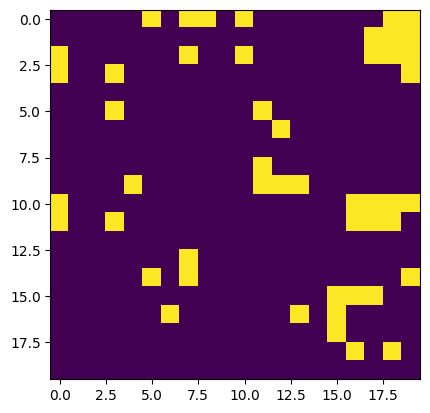

Evaluation 8 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.48it/s]


Completed. Saving
Time (s) to complete simulation 8: 24.04407238960266


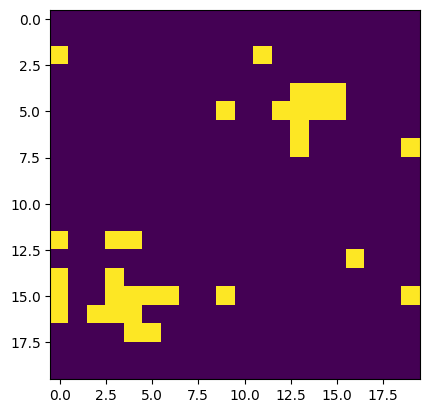

Evaluation 9 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.78it/s]


Completed. Saving
Time (s) to complete simulation 9: 23.836106061935425


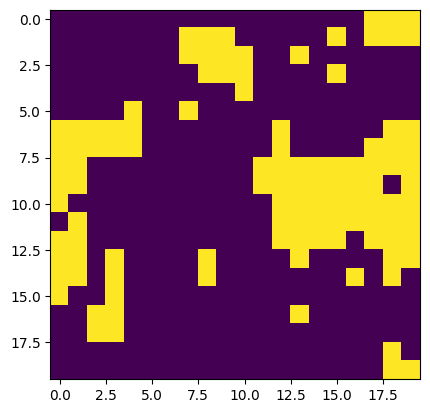

Evaluation 10 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.94it/s]


Completed. Saving
Time (s) to complete simulation 10: 23.981547355651855


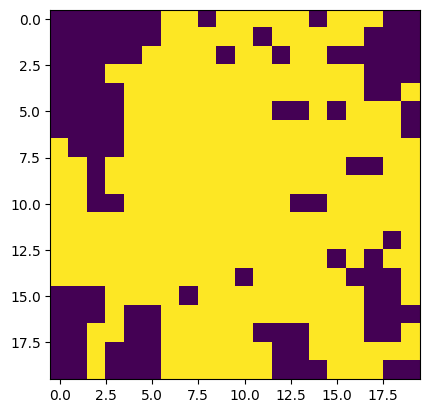

Evaluation 11 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.24it/s]


Completed. Saving
Time (s) to complete simulation 11: 24.19629740715027


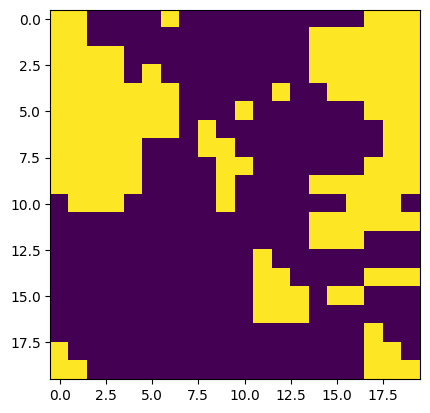

Evaluation 12 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.34it/s]


Completed. Saving
Time (s) to complete simulation 12: 24.17253875732422


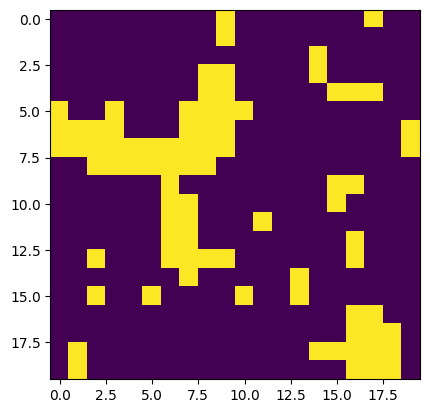

Evaluation 13 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.18it/s]


Completed. Saving
Time (s) to complete simulation 13: 24.42497968673706


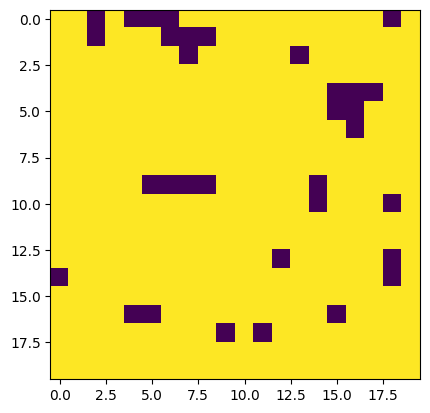

Evaluation 14 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 26.94it/s]


Completed. Saving
Time (s) to complete simulation 14: 25.590022087097168


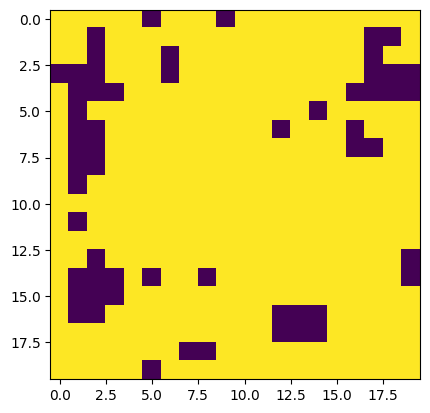

Evaluation 15 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.27it/s]


Completed. Saving
Time (s) to complete simulation 15: 25.676012992858887


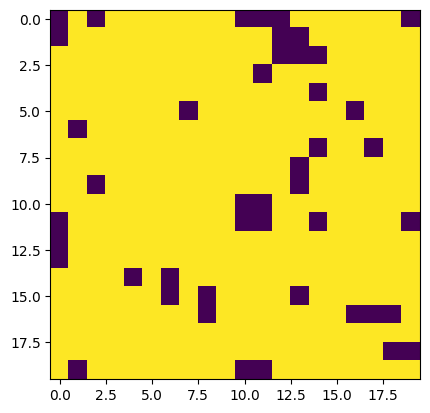

Evaluation 16 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.36it/s]


Completed. Saving
Time (s) to complete simulation 16: 24.62676763534546


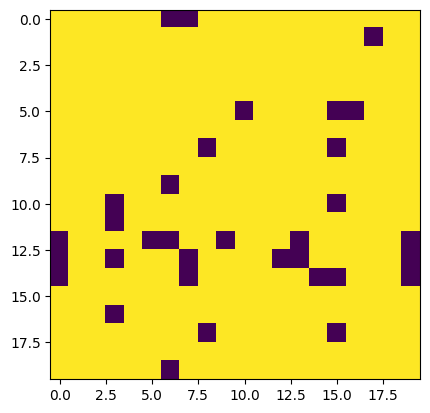

Evaluation 17 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.09it/s]


Completed. Saving
Time (s) to complete simulation 17: 23.7836856842041


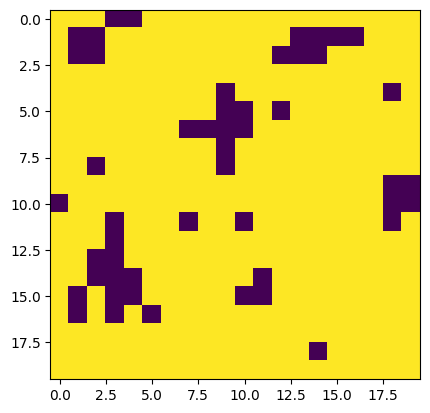

Evaluation 18 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.74it/s]


Completed. Saving
Time (s) to complete simulation 18: 24.53306794166565


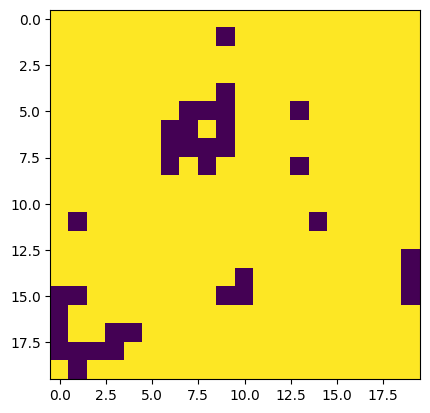

Evaluation 19 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.76it/s]


Completed. Saving
Time (s) to complete simulation 19: 25.139308214187622


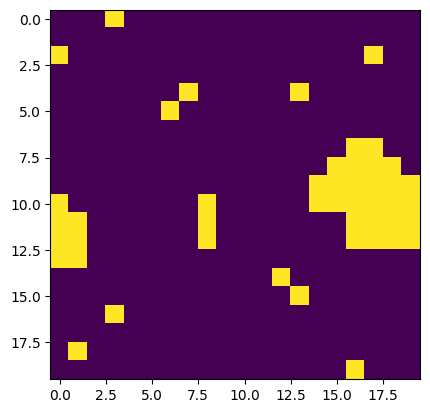

Evaluation 20 of 20

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.41it/s]


Completed. Saving
Time (s) to complete simulation 20: 24.97552490234375


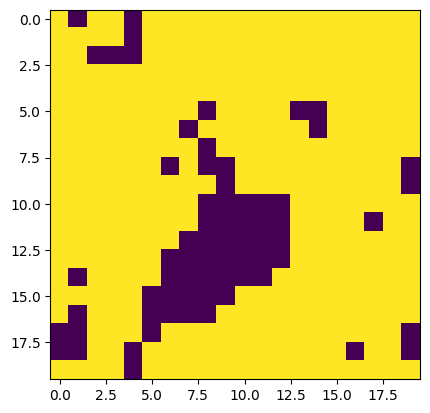

In [ ]:
n_sim = 20

results_dict_high = {}
ys_20_noise = np.zeros(n_sim)
time_eval = np.zeros(n_sim)
for i in range(0, n_sim):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,1.17,0,0],
                      [0,1.17,0,1.17,0],
                      [0,0,1.17,0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n_sim))
    start_time = time.time()
    sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(time_eval[i]))
    results_dict_high[i] = {'sim': sq_sim.results,}
    ys_20_noise[i] = results_dict_high[i]['sim']['SpecificHeat']
    plt.imshow(results_dict_high[i]['sim']['config'][-1])
    plt.show()



In [ ]:
np.mean(ys_20_noise), np.std(ys_20_noise), ys_20_noise


(0.4044929842778462,
 0.030457641805980974,
 array([0.45916061, 0.37087163, 0.43057339, 0.41501727, 0.3943235 ,
        0.3965602 , 0.43122503, 0.40375806, 0.37815268, 0.39038467,
        0.41535149, 0.42720304, 0.32481694, 0.40168758, 0.35443945,
        0.44886018, 0.41866194, 0.4101322 , 0.41727635, 0.40140347]))

(array([1., 0., 1., 2., 1., 5., 5., 3., 0., 2.]),
 array([0.32481694, 0.33825131, 0.35168568, 0.36512004, 0.37855441,
        0.39198878, 0.40542314, 0.41885751, 0.43229188, 0.44572625,
        0.45916061]),
 <BarContainer object of 10 artists>)

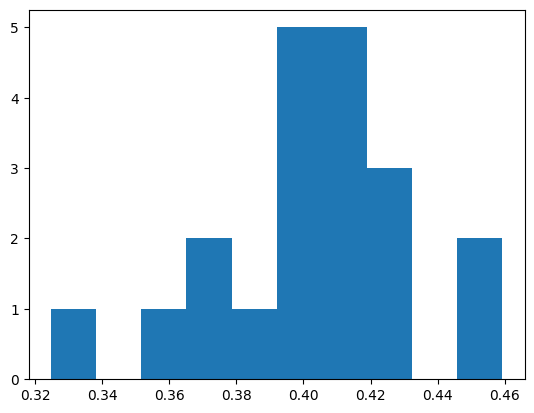

In [ ]:
plt.hist(ys_20_noise)